In [1]:
# Imports

import numpy as np
import matplotlib
from matplotlib import pyplot as plt
%matplotlib inline     
from scipy.stats import gaussian_kde
import pandas as pd
import ast

import tigramite
from tigramite import data_processing as pp
from tigramite.toymodels import structural_causal_processes as toys
from tigramite import plotting as tp
from tigramite.independence_tests.robust_parcorr import RobustParCorr
from tigramite.pcmci import PCMCI
from tigramite.graphs import Graphs
from tigramite.toymodels import surrogate_generator 
from tigramite.models import Models
from tigramite.causal_effects import CausalEffects

import sklearn
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor 
from tigramite.causal_effects import CausalEffects
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.preprocessing import StandardScaler
from tigramite.data_processing import DataFrame

In [2]:
cd

/Users/alondraalvarez


In [3]:
cd Desktop/REU 2025

/Users/alondraalvarez/Desktop/REU 2025


In [4]:
############################### Data ########################################

In [31]:
sites = ["M1", "S2", "S3"]
site = "S2"

path = f"{site}_data/1_min_aerosols/"

# Events
Events = pd.read_csv(path + f"{site}_continuous_rain_periods_aerosols.csv")

morning_events = list(zip(
    pd.to_datetime(Events['extended_start']),
    pd.to_datetime(Events['extended_end'])))


In [32]:
def get_path_effect(graph, X, Y, mediation=None, conf_lev=0.9):
    causal_effects = CausalEffects(graph, graph_type='stationary_dag', 
                                    X=X, Y=Y, 
                                   S=None, 
                                   verbosity=0)

    dox_vals = np.linspace(0., 1., 2)

    # Fit causal effect model from observational data
    causal_effects.fit_wright_effect(
        dataframe=dataframe, 
        mask_type='y',
        mediation=mediation, #'direct',
        method = 'parents',
        data_transform=None #sklearn.preprocessing.StandardScaler(),
    )

    # Predict effect of interventions do(X=0.), ..., do(X=1.) in one go
    intervention_data = np.repeat(dox_vals.reshape(len(dox_vals), 1), axis=1, repeats=len(X))
    pred_Y = causal_effects.predict_wright_effect( 
            intervention_data=intervention_data)

    # Fit causal effect model from observational data
    causal_effects.fit_bootstrap_of(
        method='fit_wright_effect',
        method_args={'dataframe':dataframe,  
        'mask_type':'y',
        'mediation':mediation, #'direct',
        'data_transform':None,
        },
        seed=42
        )

    # Predict effect of interventions do(X=0.), ..., do(X=1.) in one go
    intervention_data = np.repeat(dox_vals.reshape(len(dox_vals), 1), axis=1, repeats=len(X))
    conf = causal_effects.predict_bootstrap_of(
        method='predict_wright_effect',
        method_args={'intervention_data':intervention_data},
        conf_lev=conf_lev)

    print("Wright's path effect    = %.2f [%.2f, %.2f]"
                %(pred_Y[1], conf[0,1], conf[1,1]))
    
    return pred_Y[1], conf[0,1], conf[1,1]

Negative precipitation values in event 0: 151


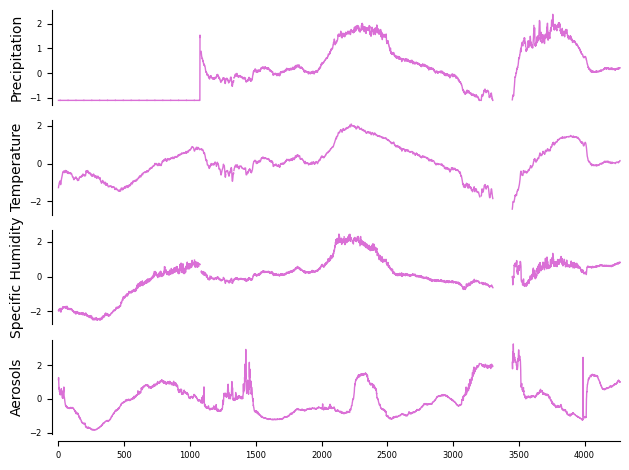

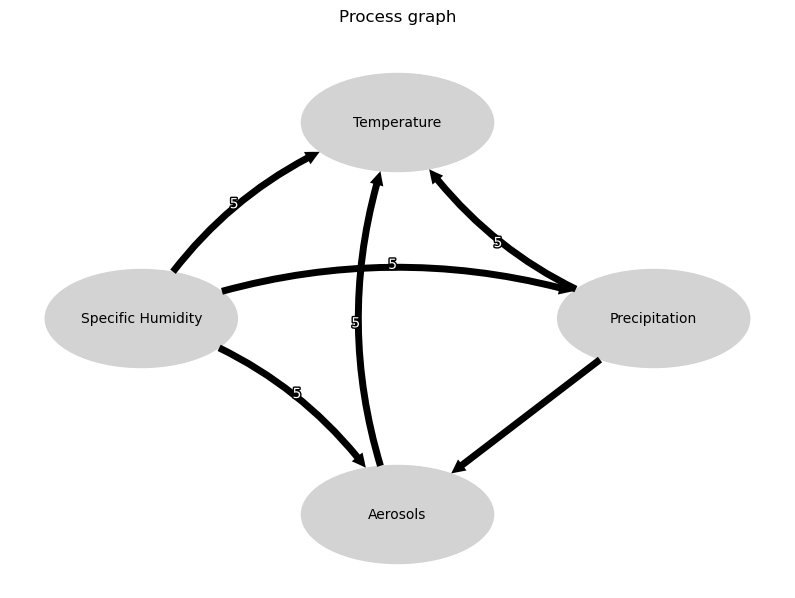

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


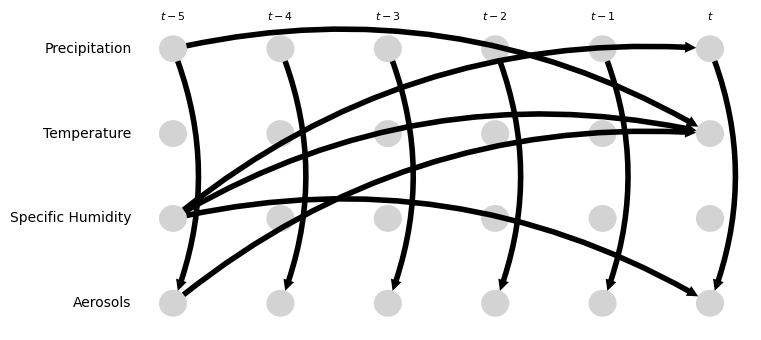

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.57 [-0.60, -0.54]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.20 [0.18, 0.22]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.62 [0.60, 0.64]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.65 [0.62, 0.68]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.70 [0.68, 0.71]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.36 [-0.38, -0.34]
Negative precipitation values in event 1: 49


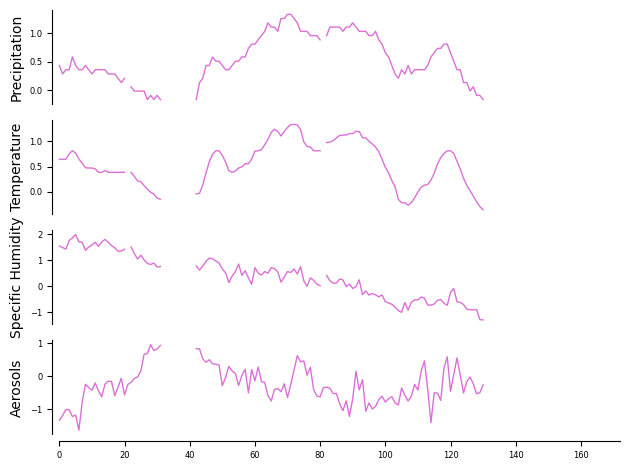

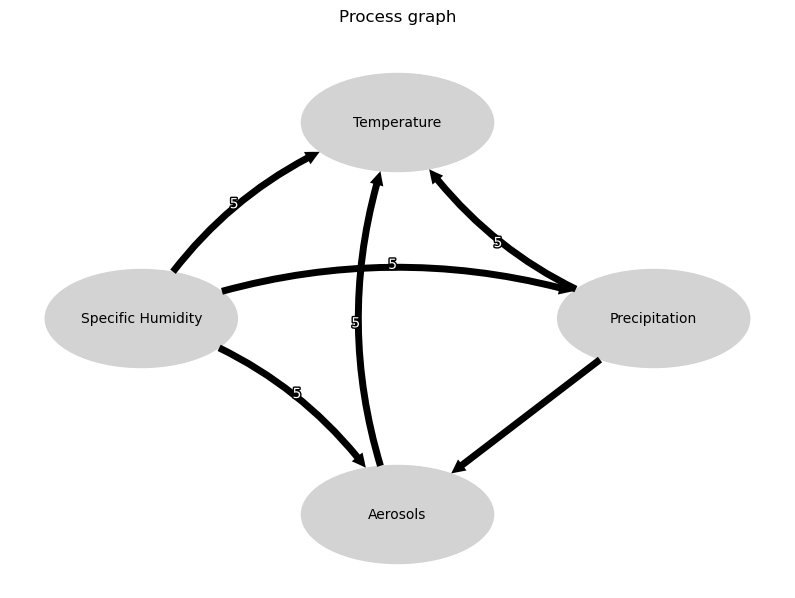

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


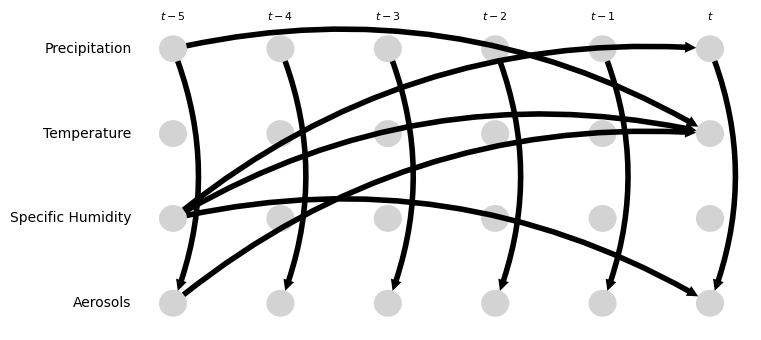

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.29 [-0.48, -0.10]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.95 [0.81, 1.06]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.17 [0.10, 0.24]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.14 [0.06, 0.25]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.08 [-0.15, 0.01]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.12 [0.02, 0.25]
Negative precipitation values in event 2: 1104


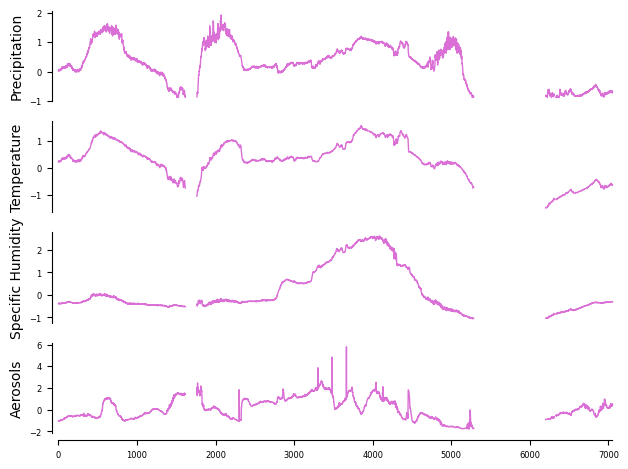

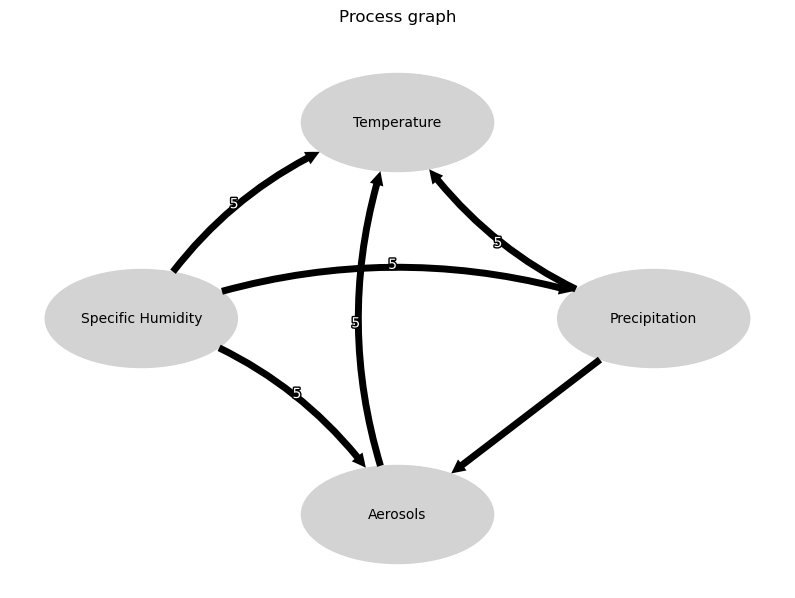

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


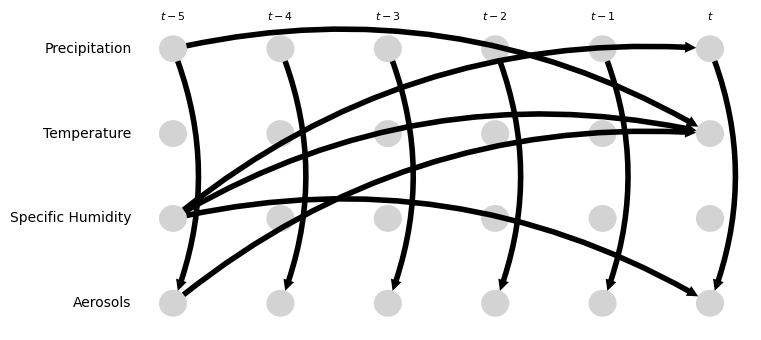

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.45 [-0.48, -0.43]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.74 [0.73, 0.75]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.24 [0.23, 0.24]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.65 [0.62, 0.66]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.29 [0.28, 0.30]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.03 [-0.04, -0.03]
Negative precipitation values in event 3: 72


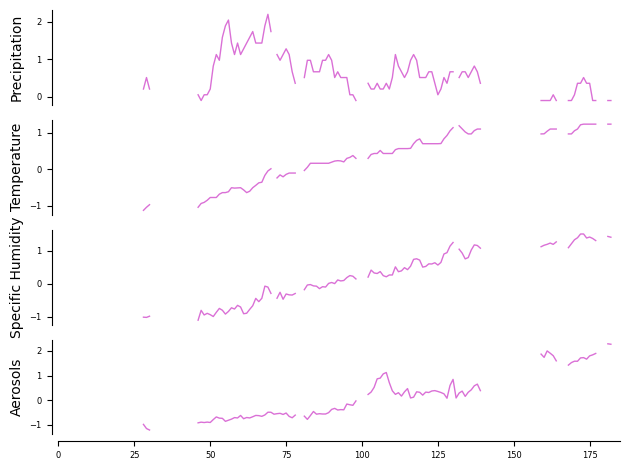

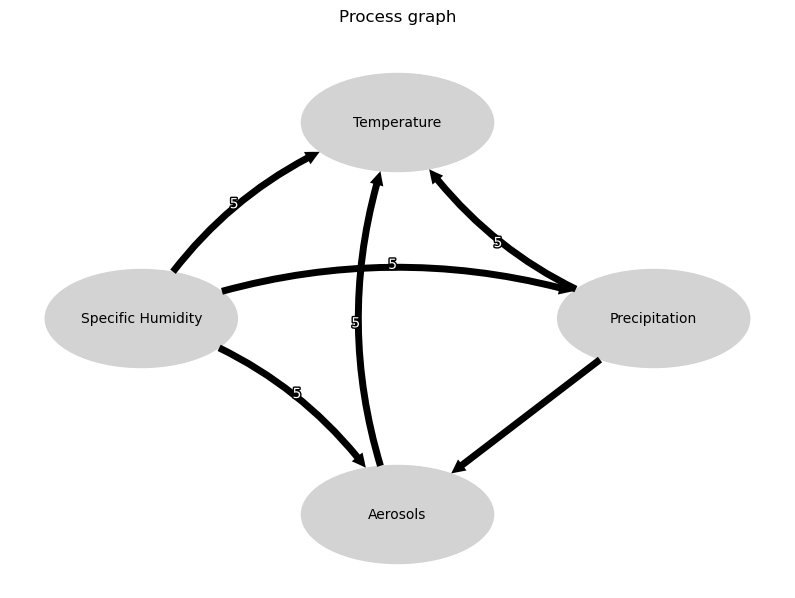

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


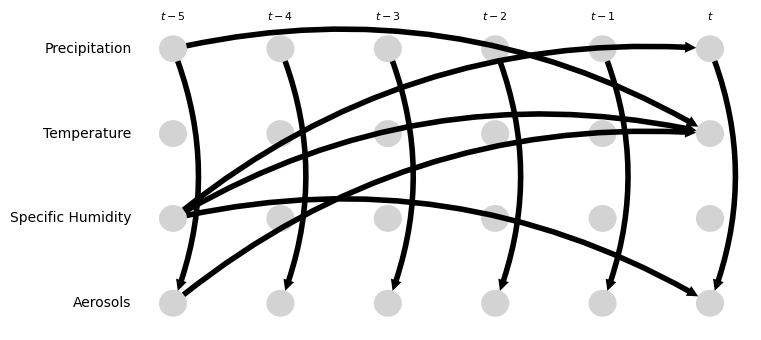

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.16 [-0.38, -0.01]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.13, 0.04]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.87 [0.78, 0.96]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.94 [0.79, 1.11]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.58 [-0.66, -0.49]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.06 [-0.13, 0.02]
Negative precipitation values in event 4: 551


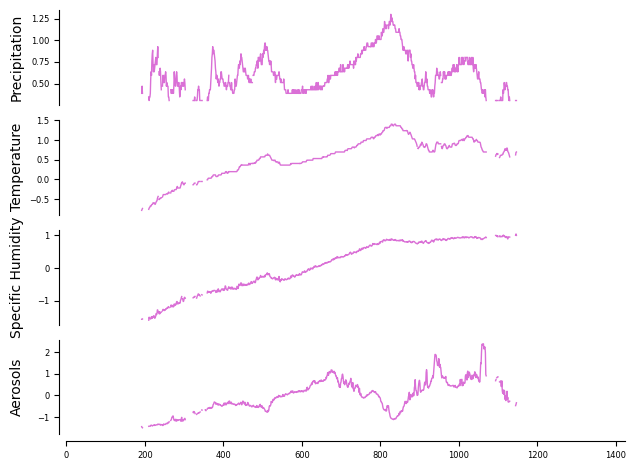

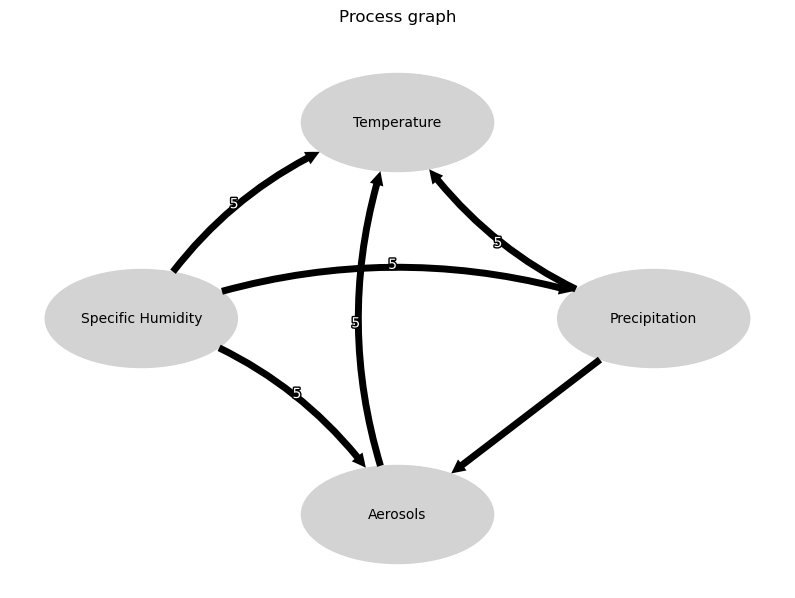

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


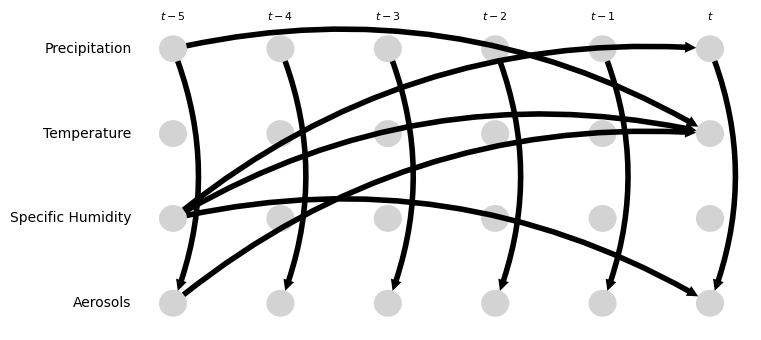

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.74 [-1.91, -1.58]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.62 [0.57, 0.68]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.51 [0.48, 0.53]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.80 [0.76, 0.85]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.09 [0.08, 0.11]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.00, 0.03]
Negative precipitation values in event 5: 11


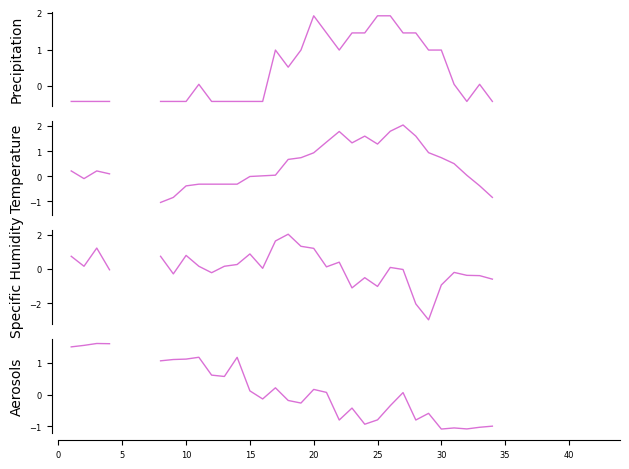

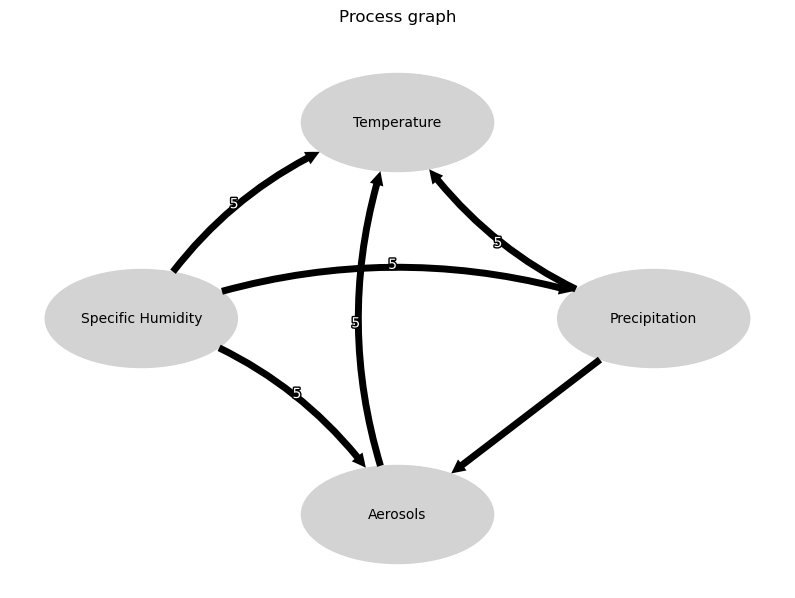

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


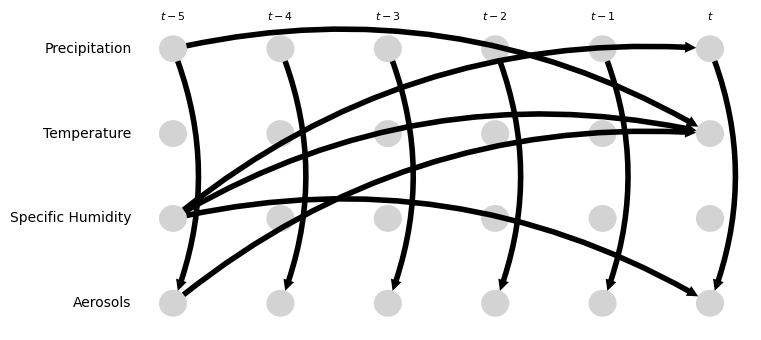

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.44 [-0.67, -0.20]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.04 [-0.24, 0.33]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.51 [0.30, 0.65]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.14 [-0.13, 0.30]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.29 [0.07, 0.42]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.59 [-1.00, -0.25]
Negative precipitation values in event 6: 541


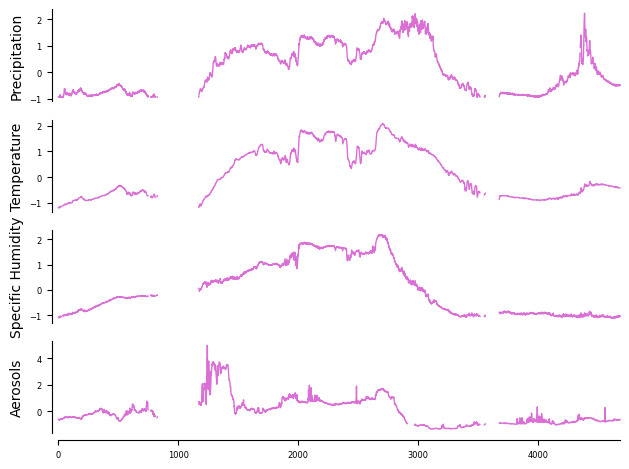

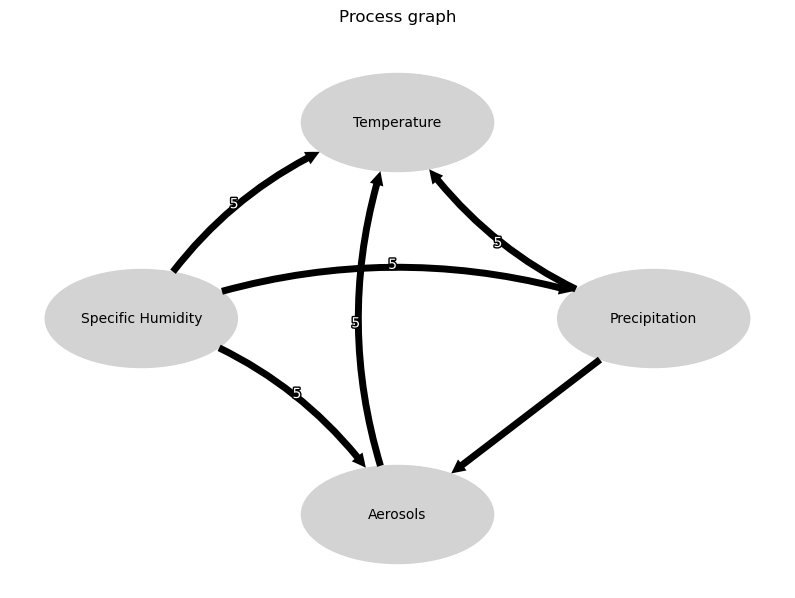

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


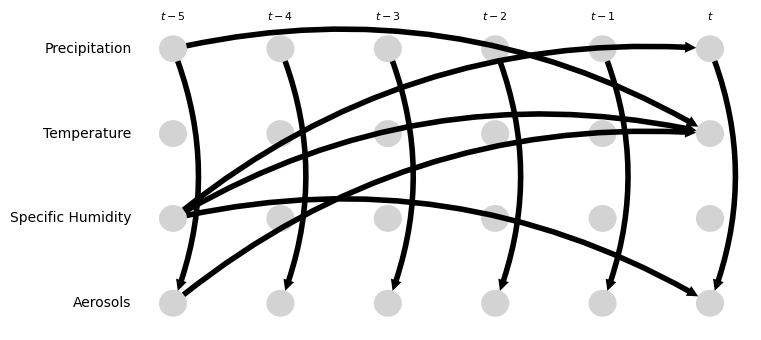

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.38 [-0.40, -0.35]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.55 [0.54, 0.57]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.57 [0.56, 0.58]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.90 [0.88, 0.92]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.65 [0.64, 0.66]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.22 [-0.23, -0.21]
Negative precipitation values in event 7: 477


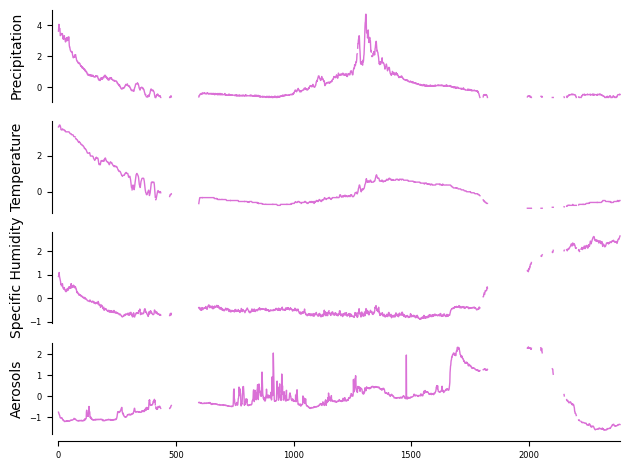

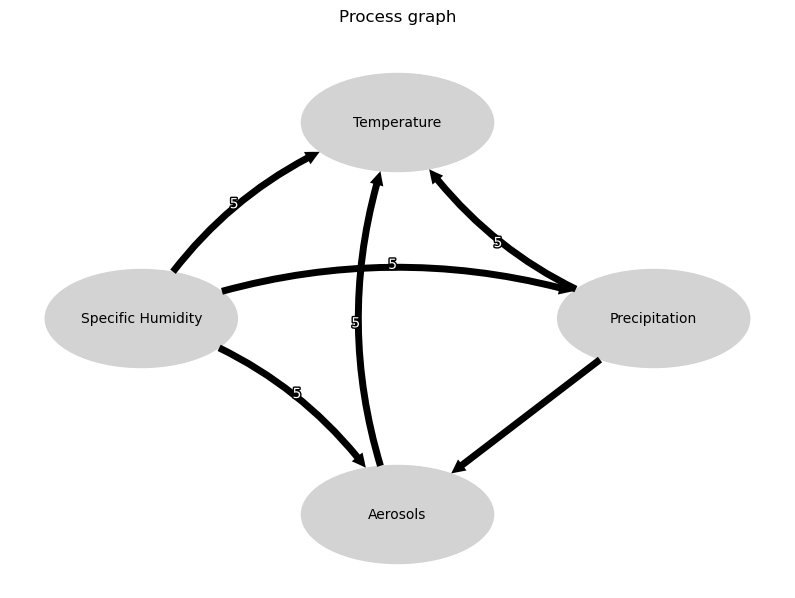

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


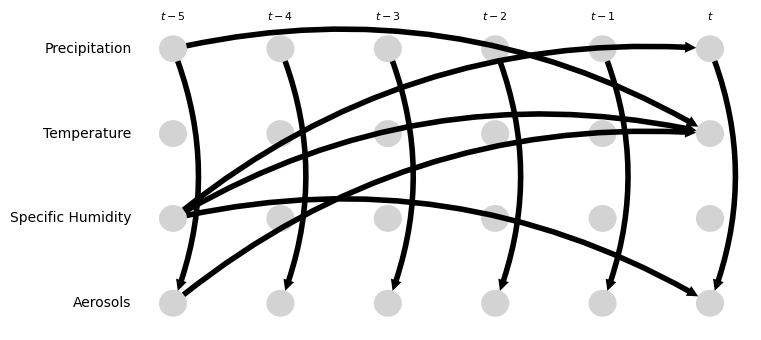

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-0.12, -0.07]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.68 [0.62, 0.72]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.17, -0.12]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.40 [-0.43, -0.38]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.20 [-0.22, -0.17]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.37 [-0.41, -0.32]
Negative precipitation values in event 8: 31


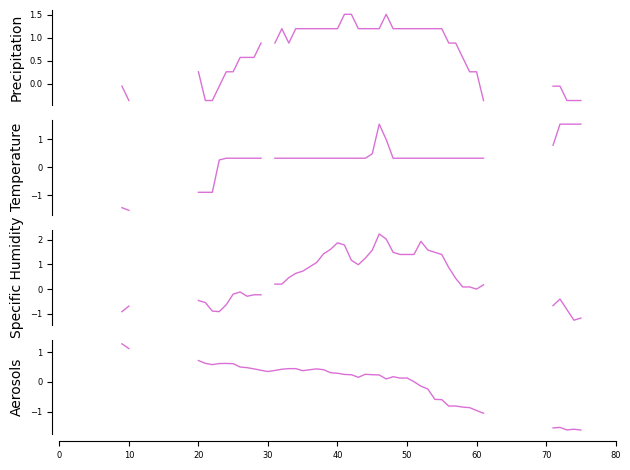

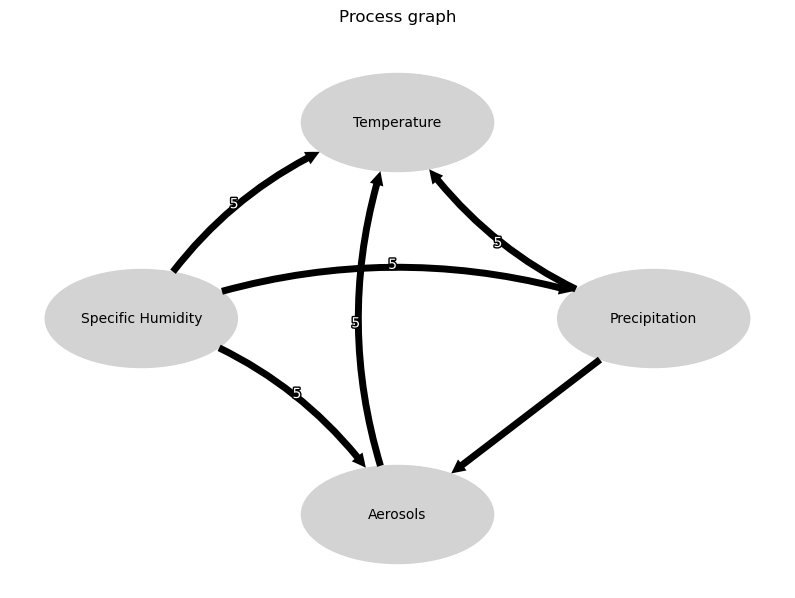

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


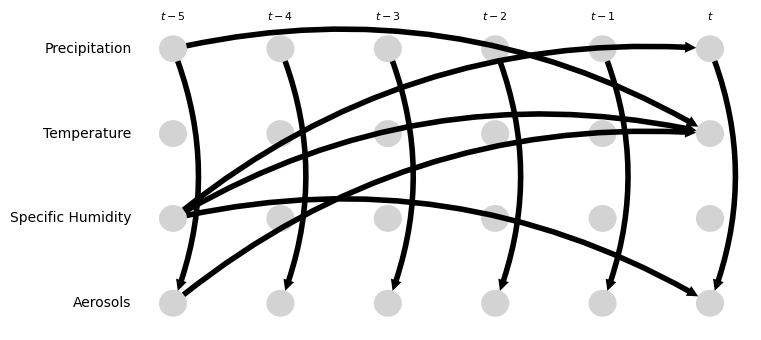

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.73 [0.55, 0.87]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [-0.02, 0.43]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.10, 0.11]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.41 [-0.48, -0.32]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.12 [0.03, 0.21]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.12 [0.00, 0.33]
Negative precipitation values in event 9: 1080


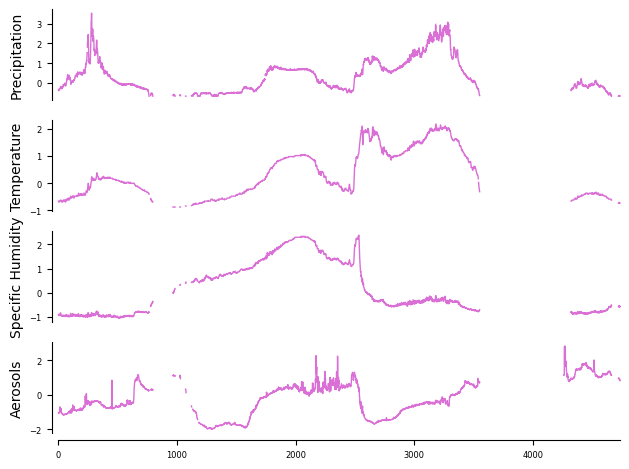

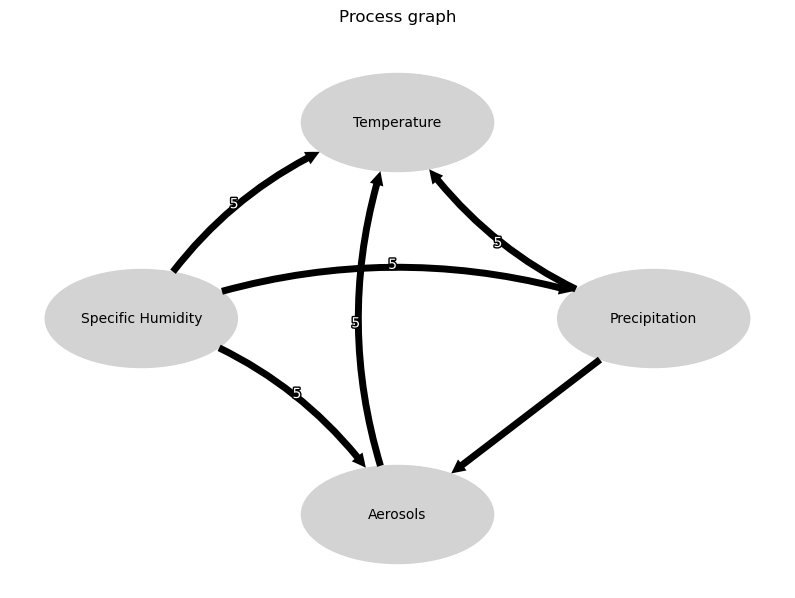

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


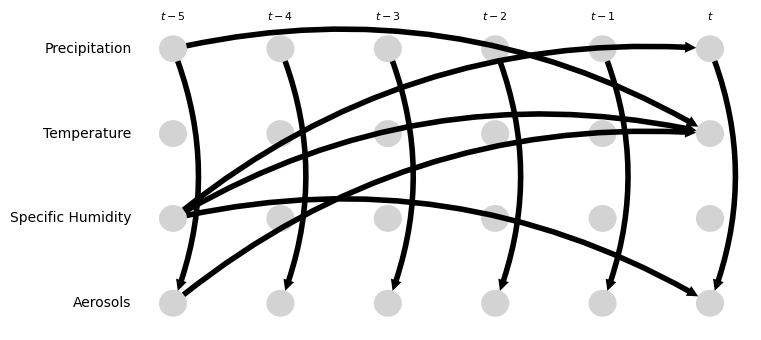

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.10, -0.05]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.87 [0.84, 0.89]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.17 [0.16, 0.18]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [0.03, 0.07]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.11 [-0.13, -0.09]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.02 [-0.03, -0.01]
Negative precipitation values in event 10: 225


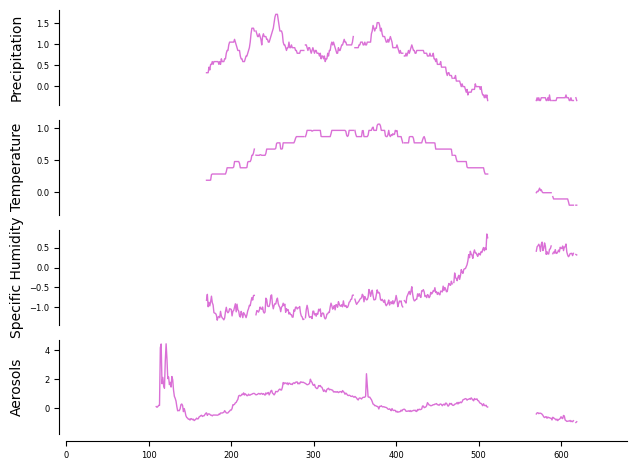

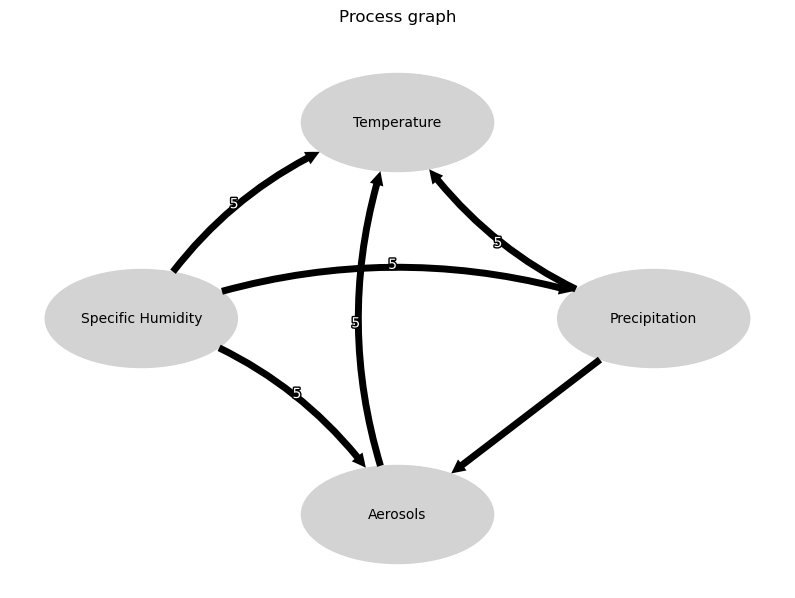

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


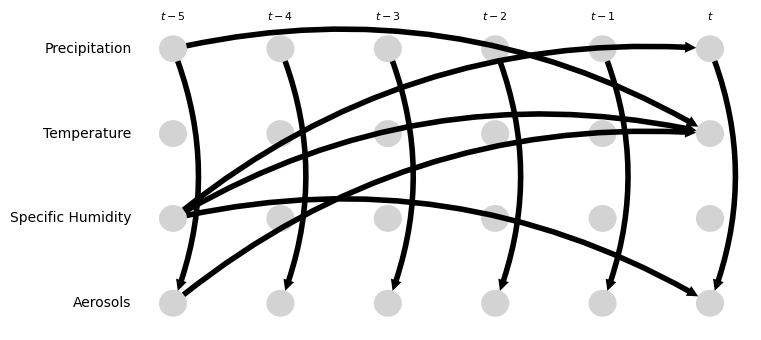

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [0.02, 0.31]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.40 [0.34, 0.46]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.02 [-0.07, 0.04]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.67 [-0.84, -0.53]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.79 [-0.82, -0.75]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.14 [0.12, 0.16]
Negative precipitation values in event 11: 45


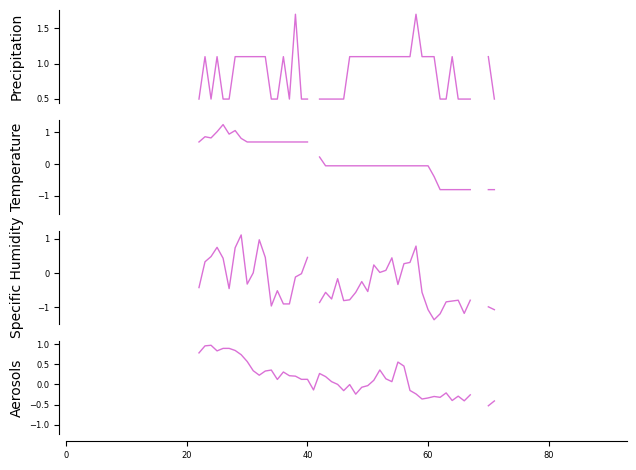

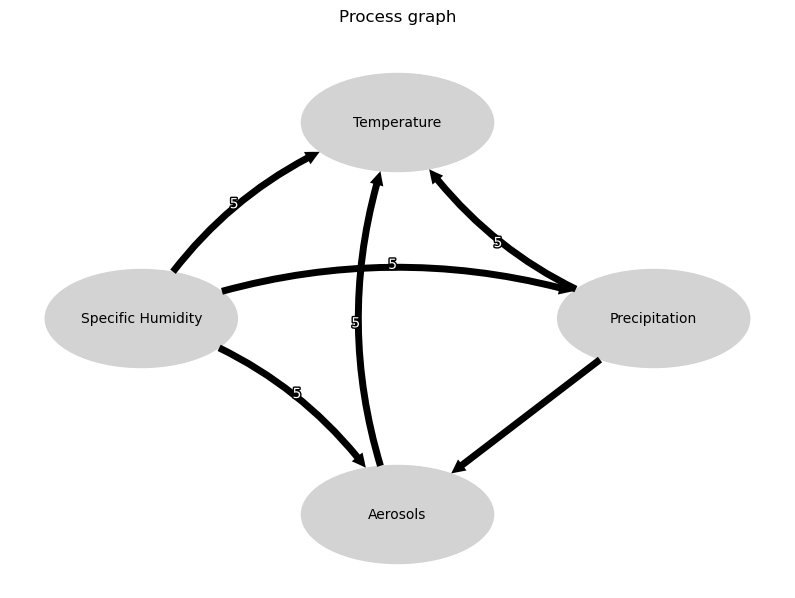

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


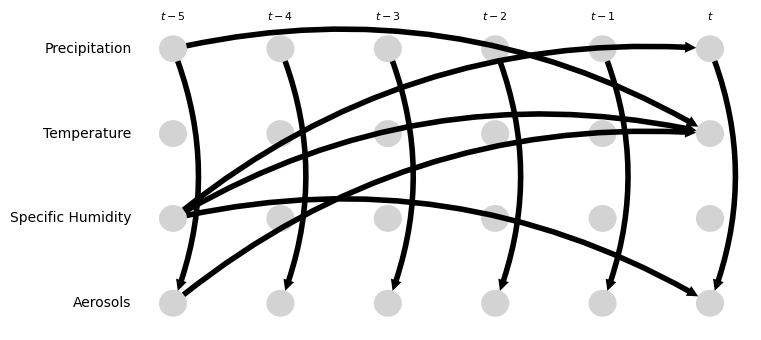

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.22, 0.27]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.15 [-0.44, 0.01]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.04 [-0.09, 0.21]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [0.06, 0.33]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [-0.03, 0.22]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.15 [0.91, 1.31]
Negative precipitation values in event 12: 597


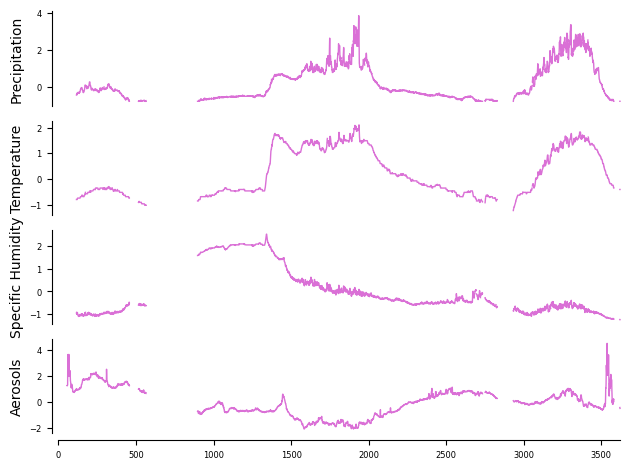

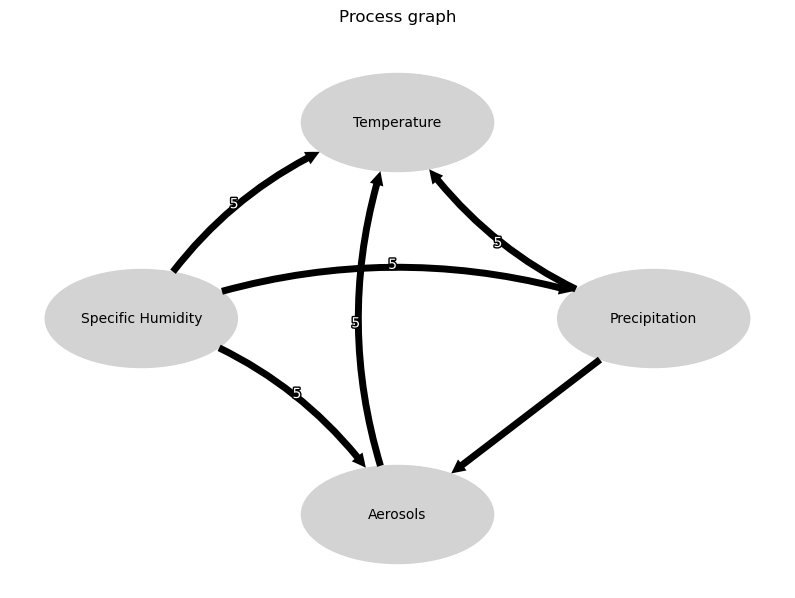

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


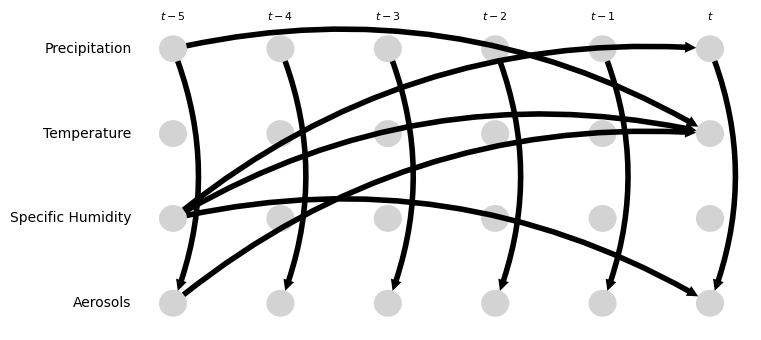

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.48 [-0.51, -0.45]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.73 [0.72, 0.75]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.00 [-0.02, 0.02]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.54 [-0.57, -0.53]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.17 [-0.20, -0.16]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.25 [-0.26, -0.23]
Negative precipitation values in event 13: 62


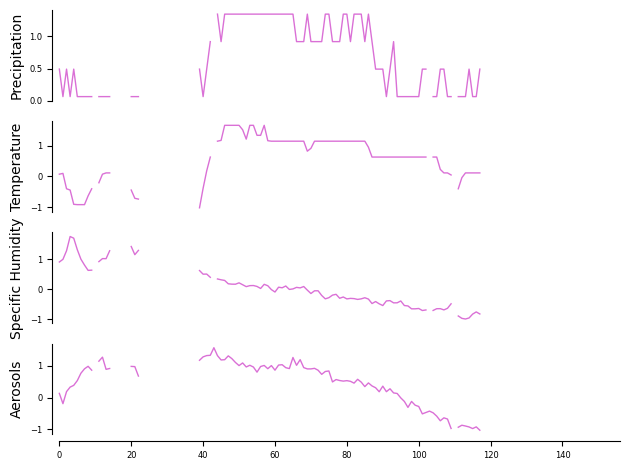

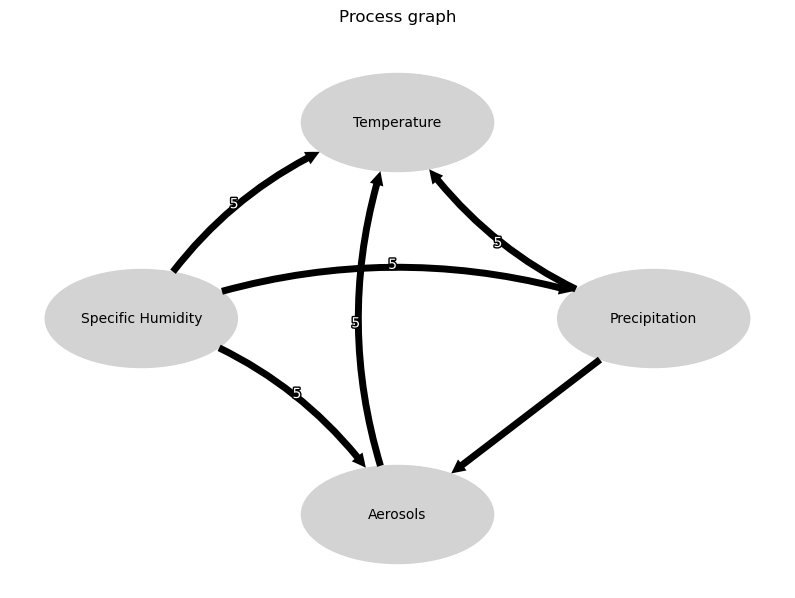

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


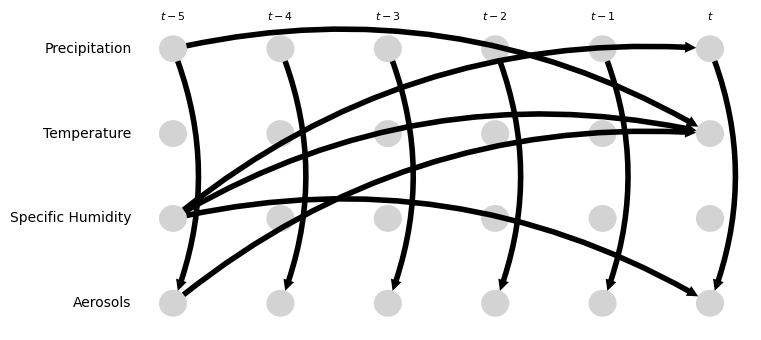

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.67 [0.55, 0.76]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [-0.09, 0.21]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.70 [-0.99, -0.17]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.19 [1.10, 1.31]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.55 [0.25, 1.00]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.96 [0.66, 1.20]
Negative precipitation values in event 14: 320


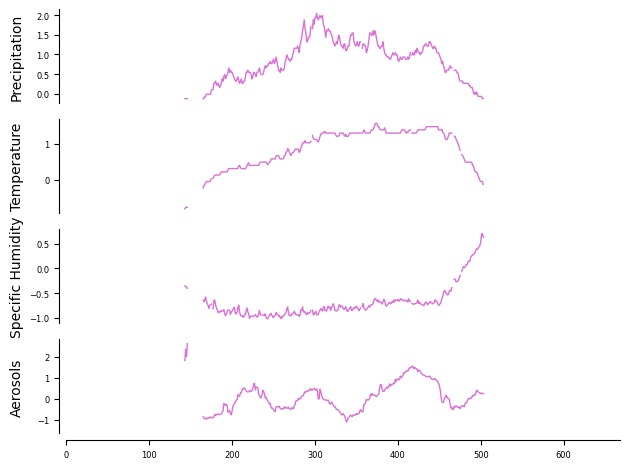

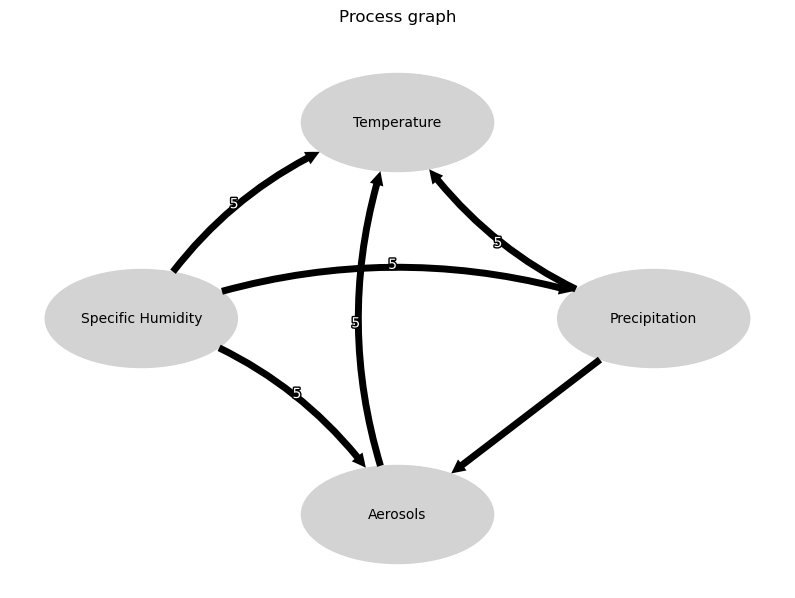

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


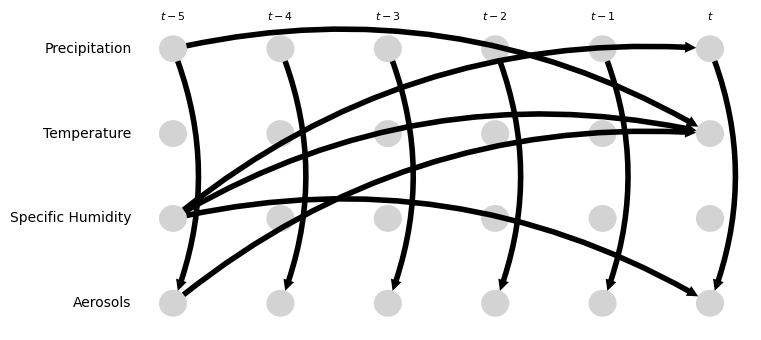

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.35 [0.23, 0.46]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.77 [0.73, 0.83]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.17 [0.07, 0.29]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.55 [0.43, 0.72]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.81 [-0.87, -0.73]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.18 [0.15, 0.20]
Negative precipitation values in event 15: 1867


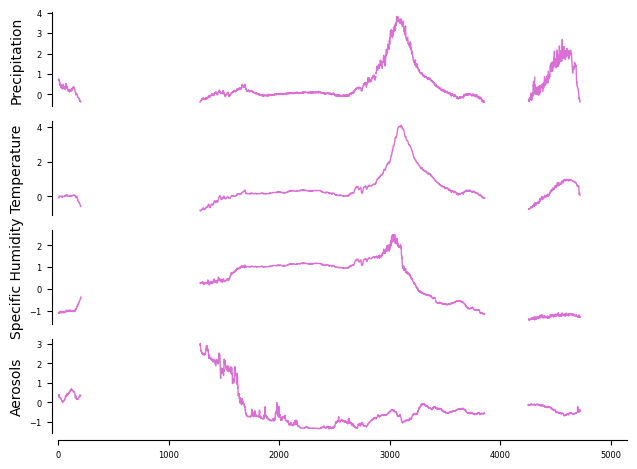

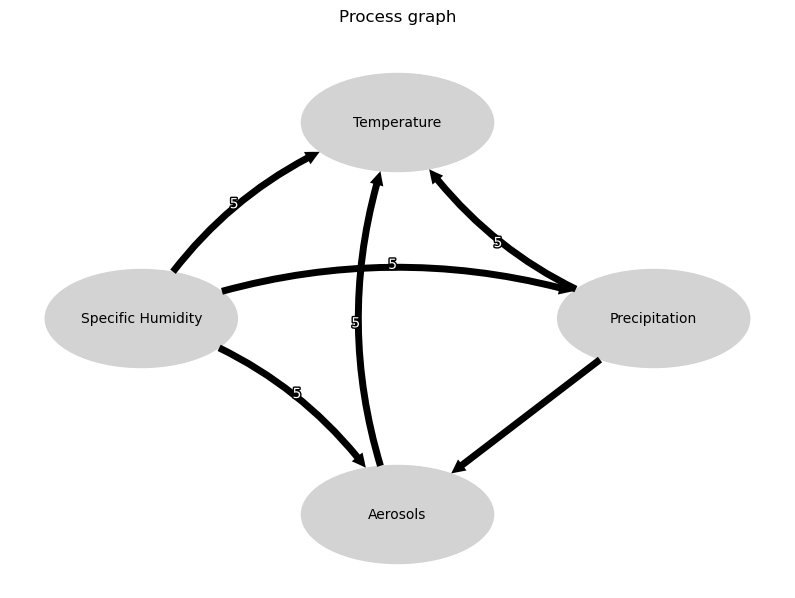

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


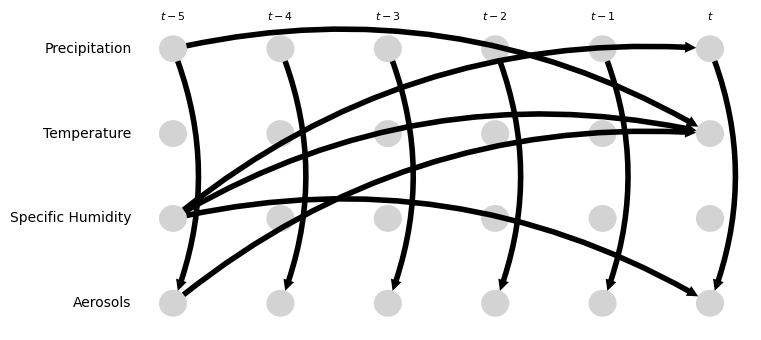

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.13 [-0.15, -0.11]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.86 [0.84, 0.88]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.13 [0.12, 0.15]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.22, -0.20]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.13 [0.10, 0.16]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.13 [-0.14, -0.13]
Negative precipitation values in event 16: 452


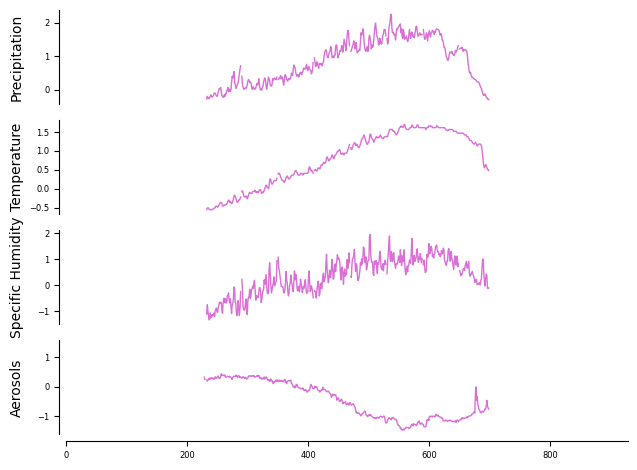

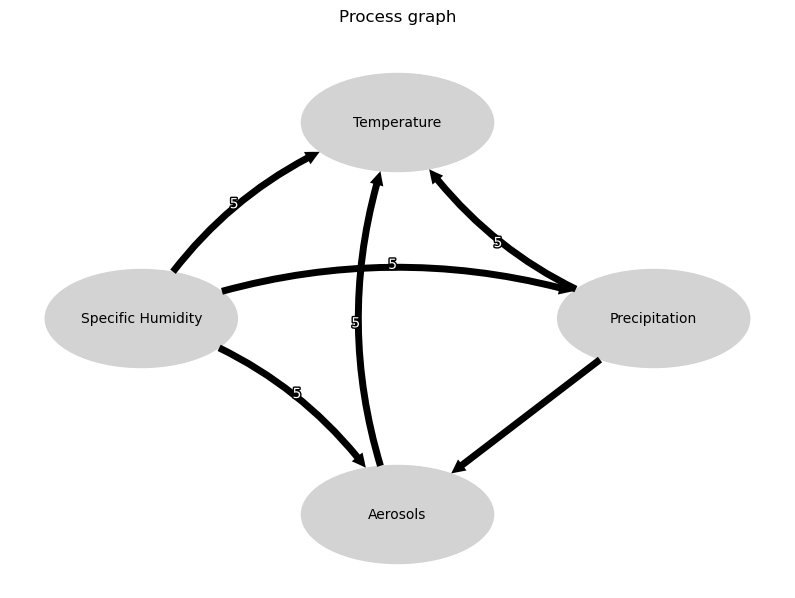

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


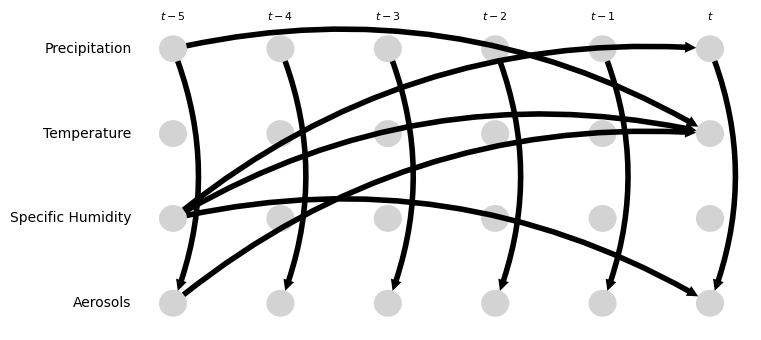

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.40 [-0.49, -0.33]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.26 [0.21, 0.31]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.21 [0.17, 0.24]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.44 [-0.49, -0.37]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.72 [0.69, 0.76]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.65 [-0.70, -0.61]
Negative precipitation values in event 17: 25


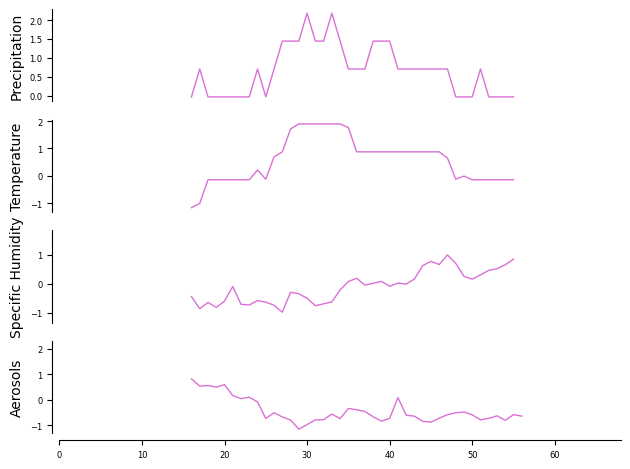

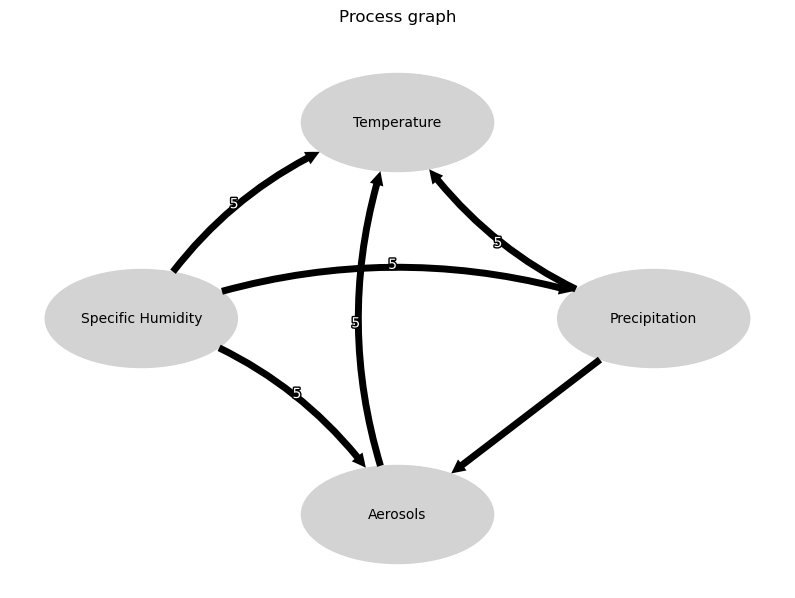

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


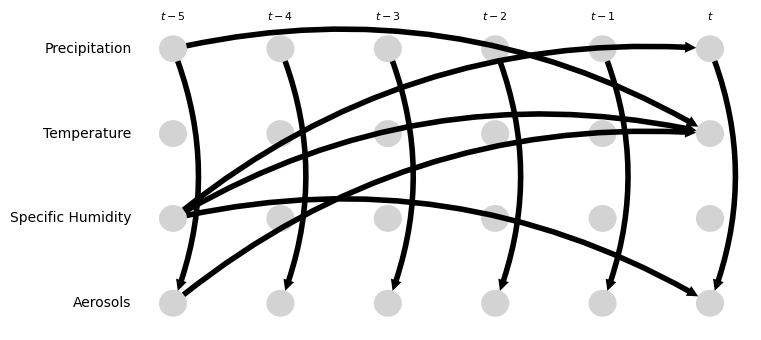

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.38 [-0.57, -0.22]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.08 [-0.31, 0.21]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.11 [-1.48, -0.85]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.35 [-0.54, -0.17]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.55 [-0.89, -0.28]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.08 [-1.42, -0.56]
Negative precipitation values in event 18: 1479


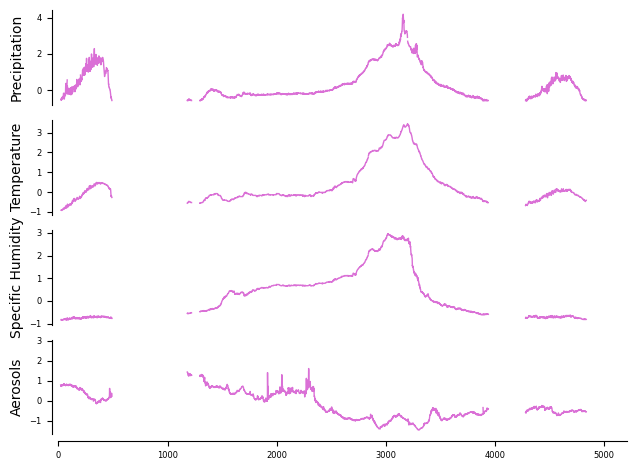

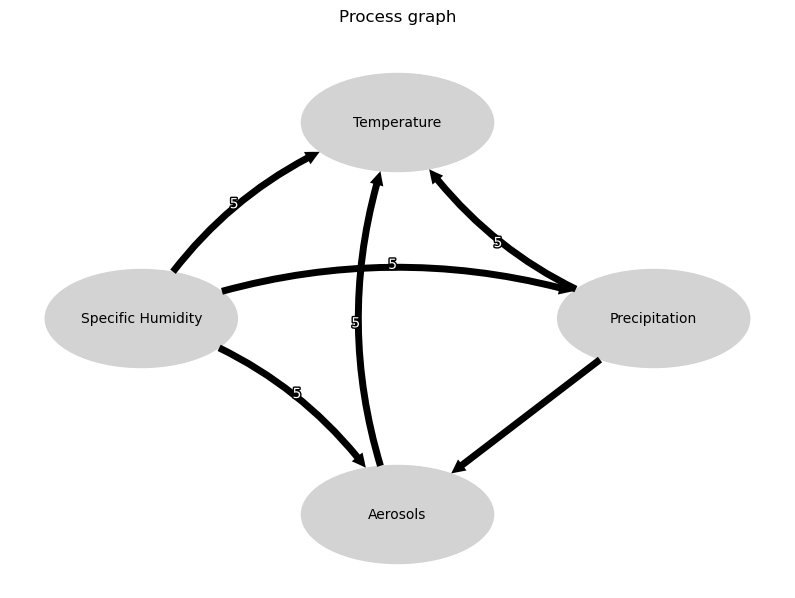

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


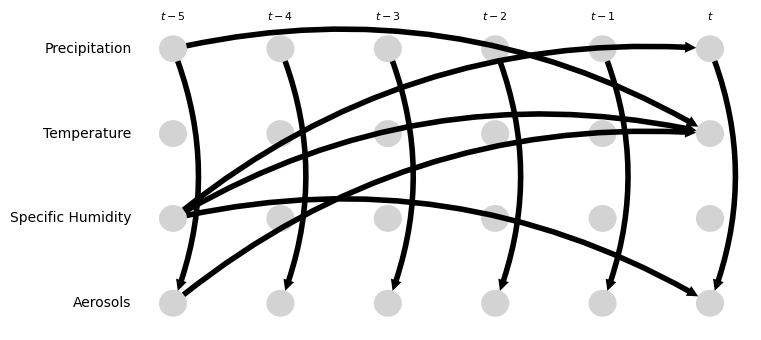

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.34 [-0.36, -0.31]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.64 [0.63, 0.65]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.35 [0.35, 0.36]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.08 [-0.10, -0.07]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.54 [0.52, 0.56]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.25 [-0.26, -0.24]
Negative precipitation values in event 19: 513


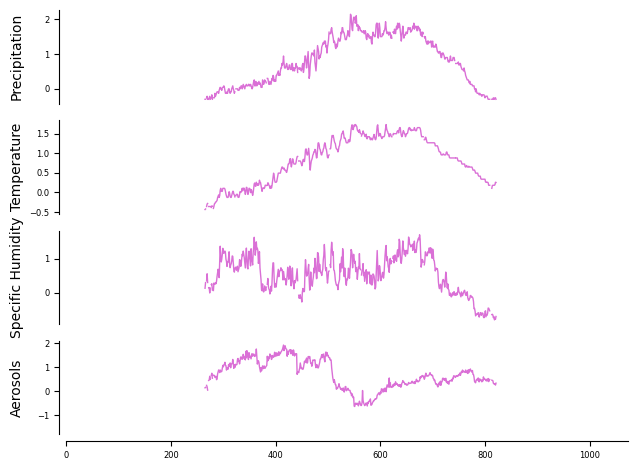

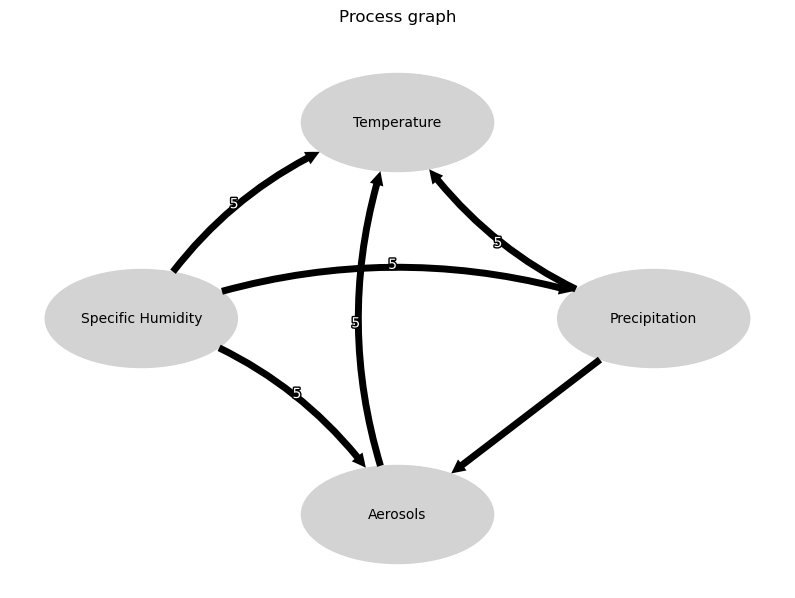

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


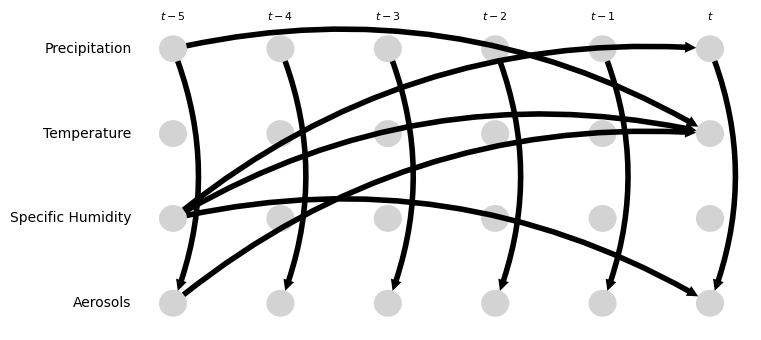

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.61 [-0.68, -0.57]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.88 [0.85, 0.90]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.19 [-0.21, -0.17]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.36 [0.29, 0.42]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.59 [0.51, 0.65]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.01, 0.05]
Negative precipitation values in event 20: 118


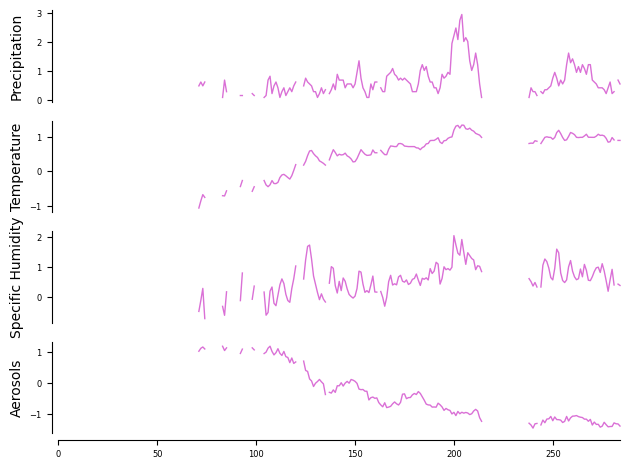

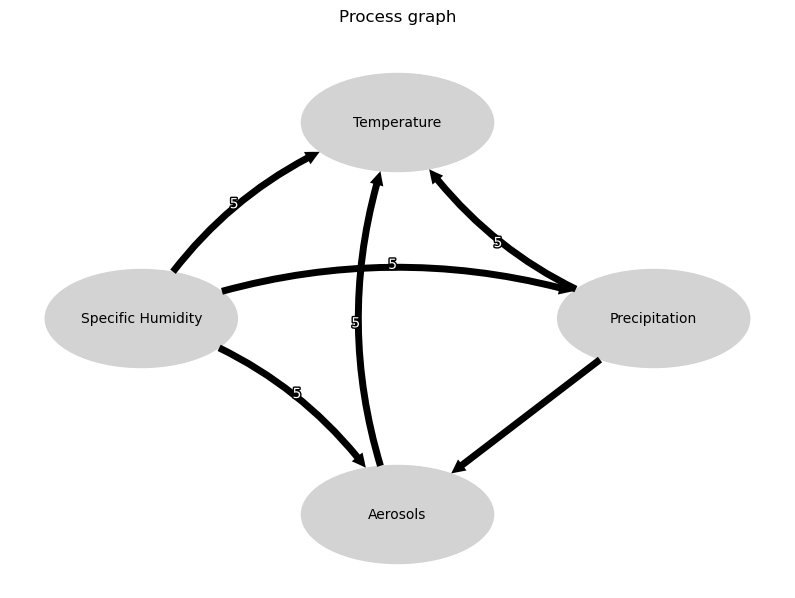

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


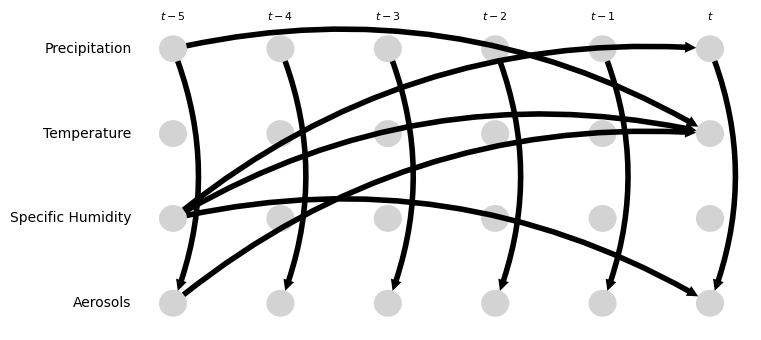

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.26 [-0.39, -0.12]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.15 [0.10, 0.19]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-0.01, 0.11]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.49 [-0.68, -0.31]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.39 [0.24, 0.56]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.48 [-0.52, -0.44]
Negative precipitation values in event 21: 62


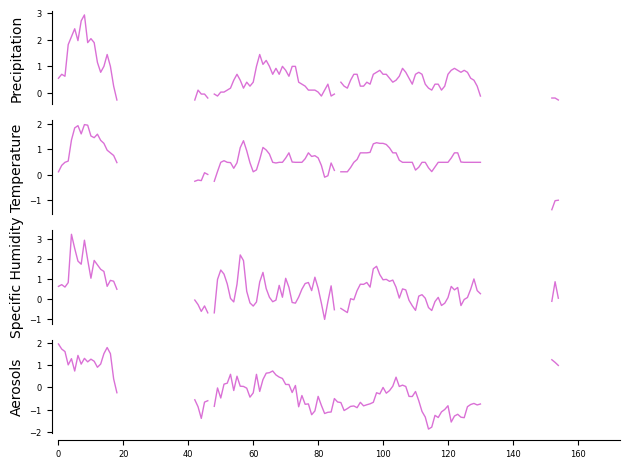

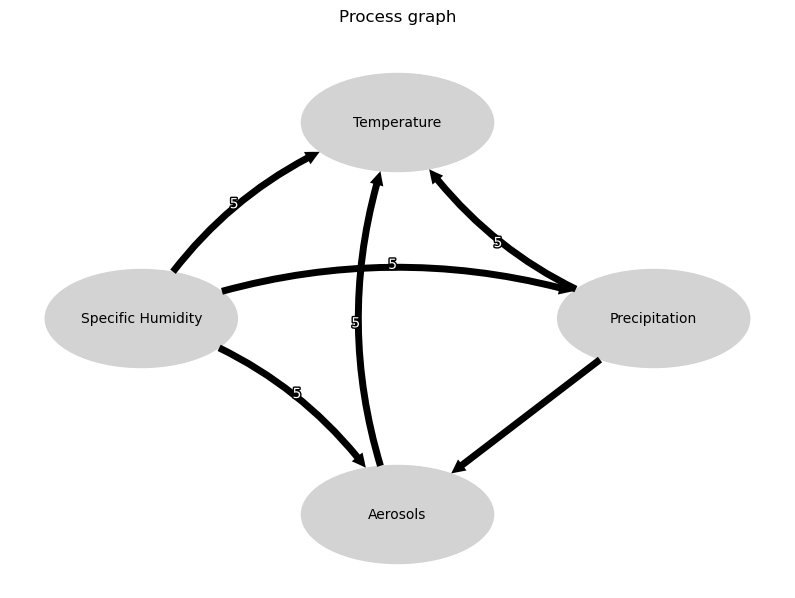

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


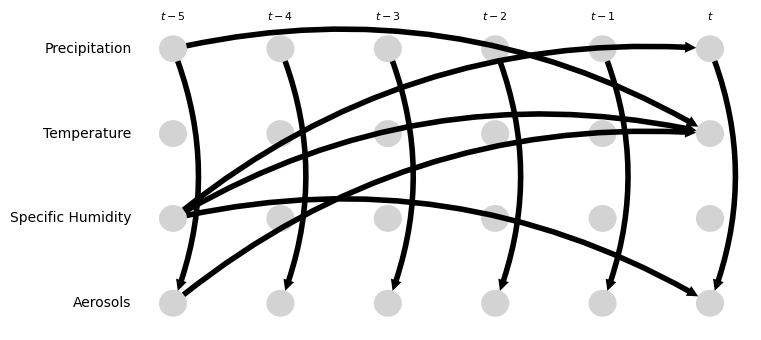

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.66 [0.46, 0.84]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.23 [0.10, 0.34]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [-0.01, 0.18]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.40 [0.25, 0.54]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.22 [0.13, 0.30]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.00 [-0.12, 0.11]
Negative precipitation values in event 22: 45


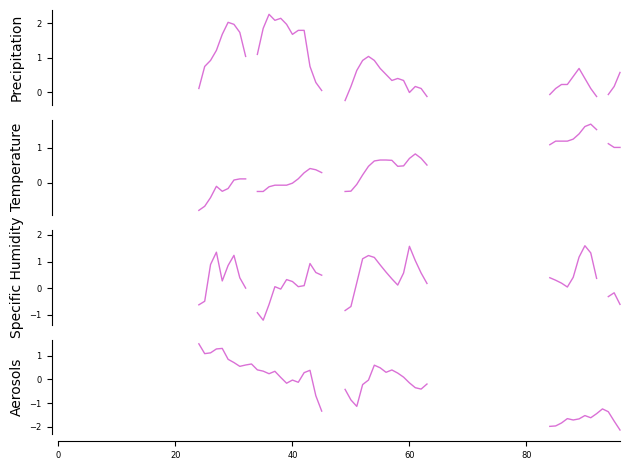

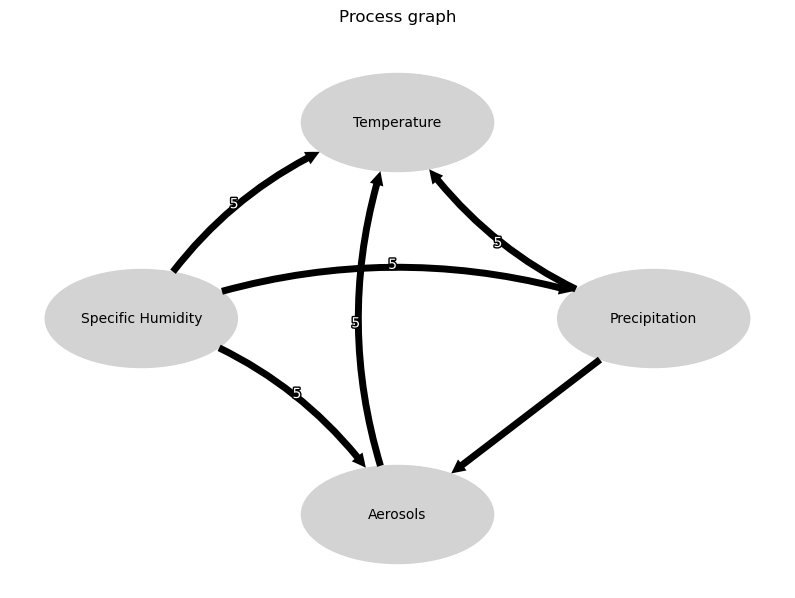

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


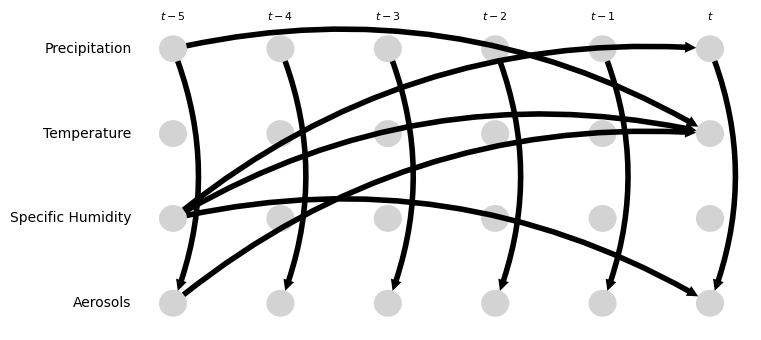

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.58 [0.41, 0.84]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.27, -0.03]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.06 [-0.03, 0.15]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.06 [-0.32, 0.32]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.45 [-0.70, -0.22]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.35 [-0.44, -0.25]
Negative precipitation values in event 23: 77


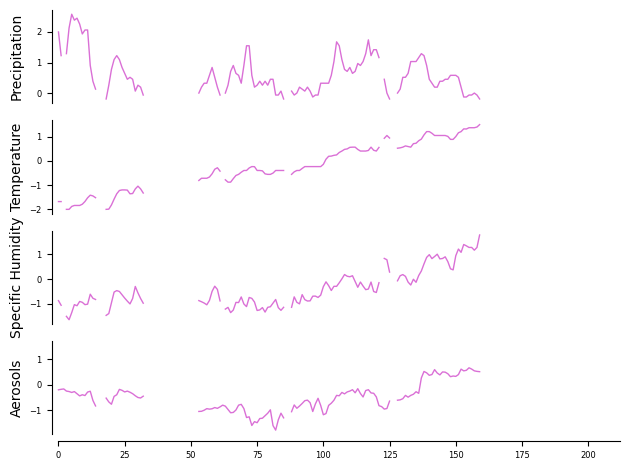

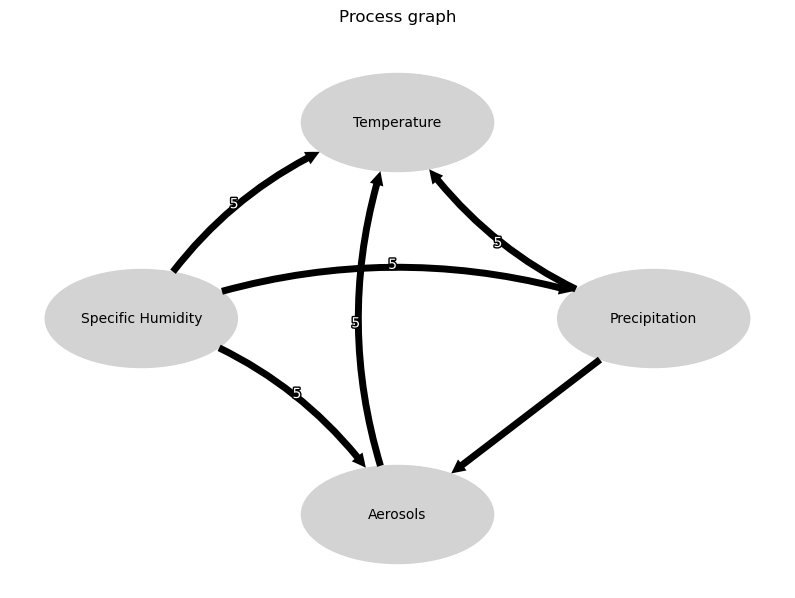

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


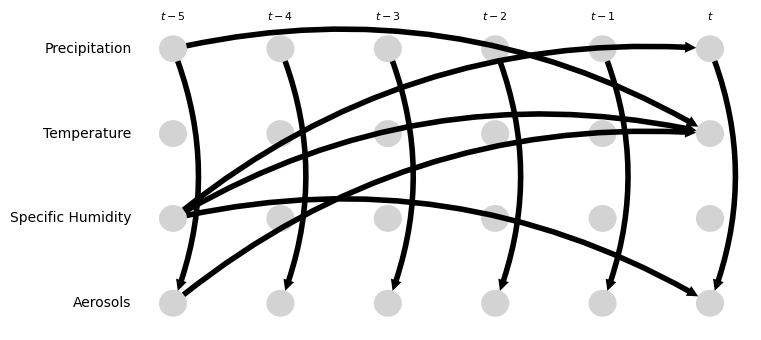

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [0.09, 0.27]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.18, 0.15]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.05 [0.85, 1.24]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.63 [0.53, 0.71]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.15, 0.07]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.49, 0.03]
Negative precipitation values in event 24: 433


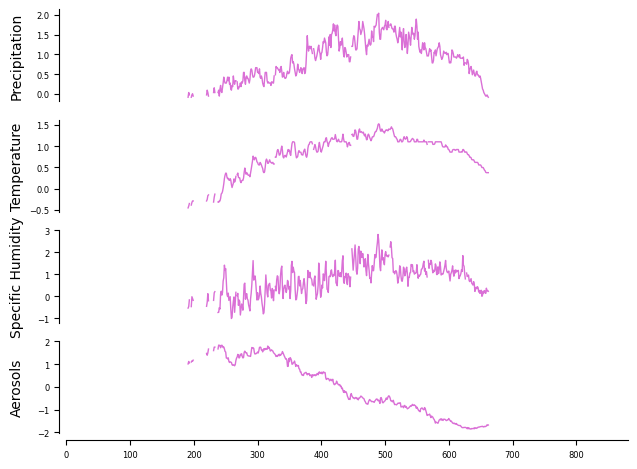

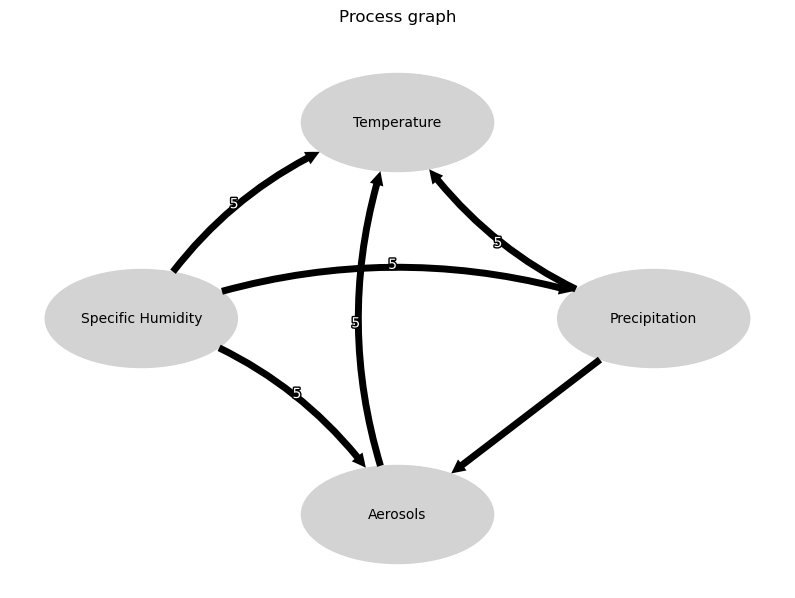

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


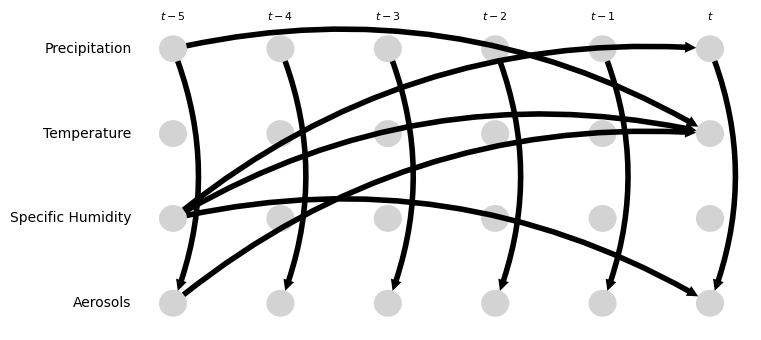

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.17 [-0.41, 0.09]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.56 [0.52, 0.61]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [0.02, 0.09]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.85 [-1.00, -0.73]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.50 [0.47, 0.55]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.02, 0.00]
Negative precipitation values in event 25: 608


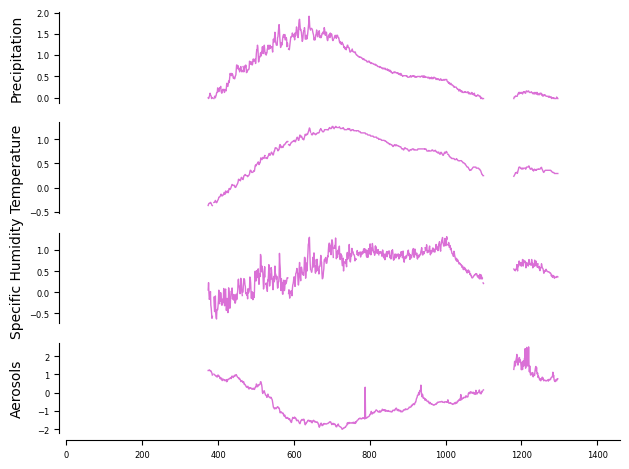

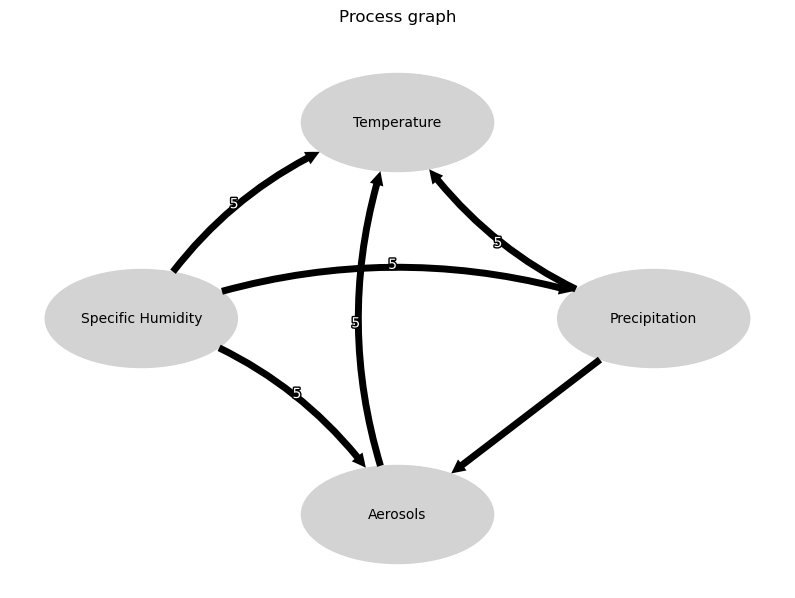

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


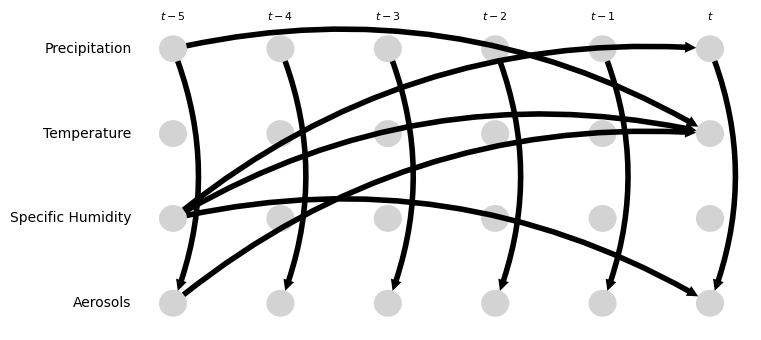

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.42 [-1.48, -1.36]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.32 [0.30, 0.34]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.44 [0.40, 0.46]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.02 [-1.08, -0.98]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [-0.02, 0.12]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.16, -0.13]
Negative precipitation values in event 26: 106


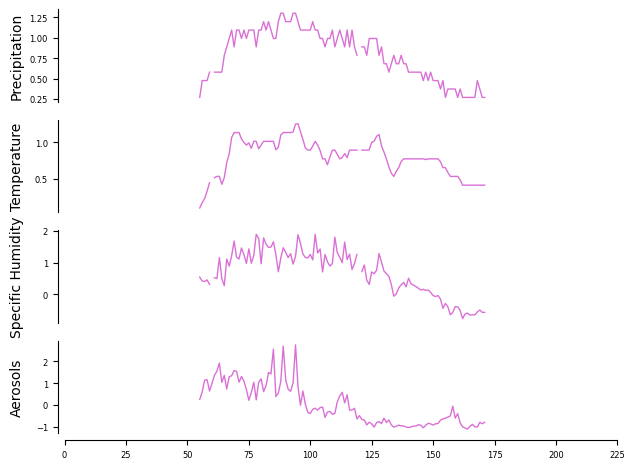

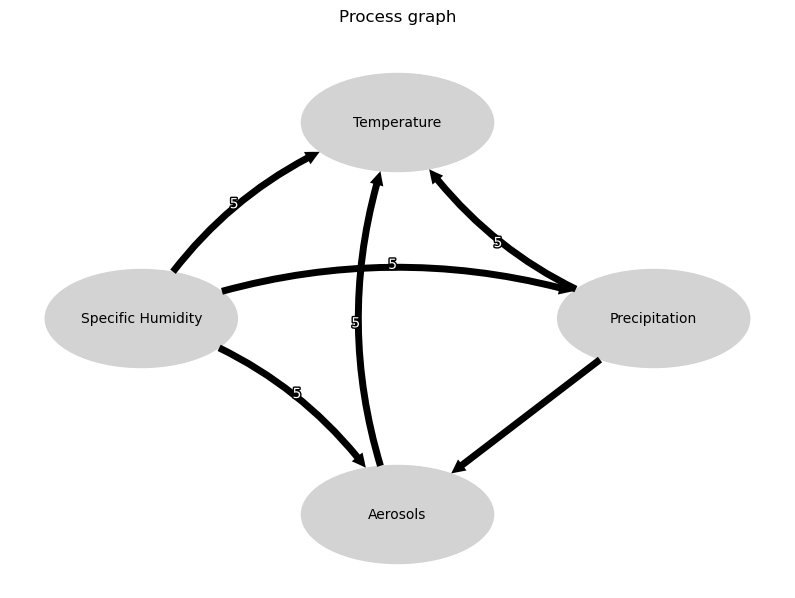

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


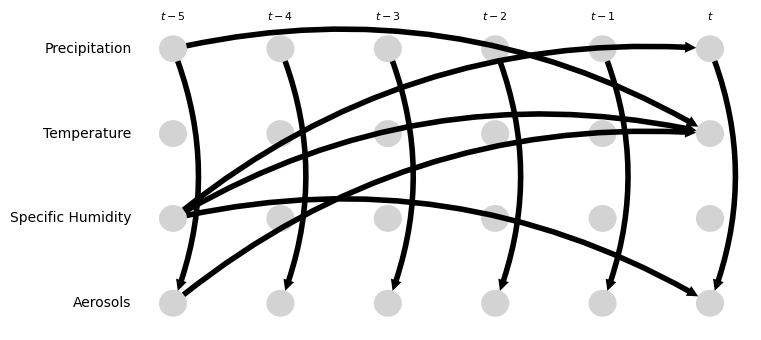

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 2.49 [1.64, 3.18]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.39 [0.25, 0.54]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-0.00, 0.12]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.32 [-0.61, 0.01]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.40 [0.37, 0.43]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [0.01, 0.08]
Negative precipitation values in event 27: 123


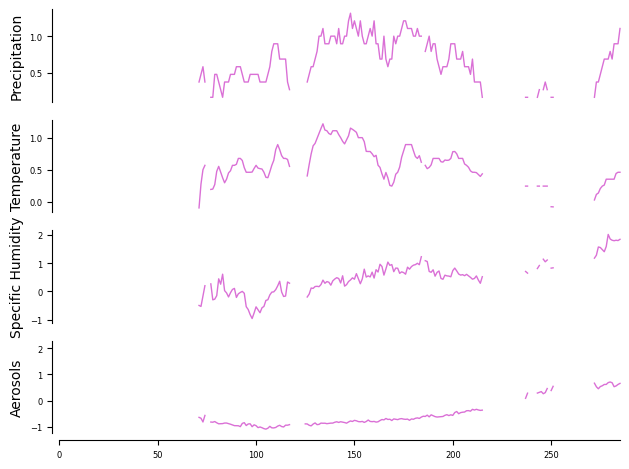

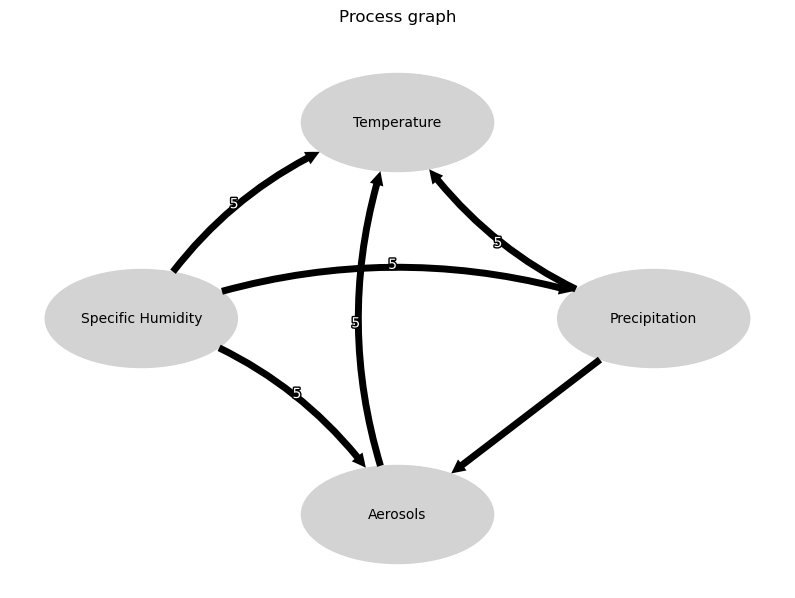

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


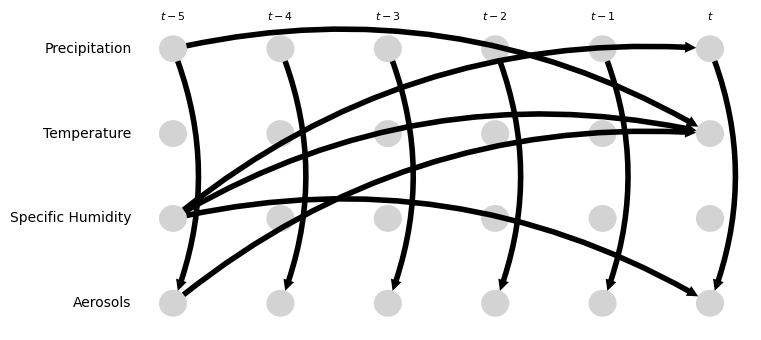

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.49 [-0.64, -0.38]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.41 [0.32, 0.51]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.03 [-0.13, 0.05]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.67 [0.56, 0.75]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.17 [0.09, 0.21]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.19 [-0.28, -0.10]
Negative precipitation values in event 28: 456


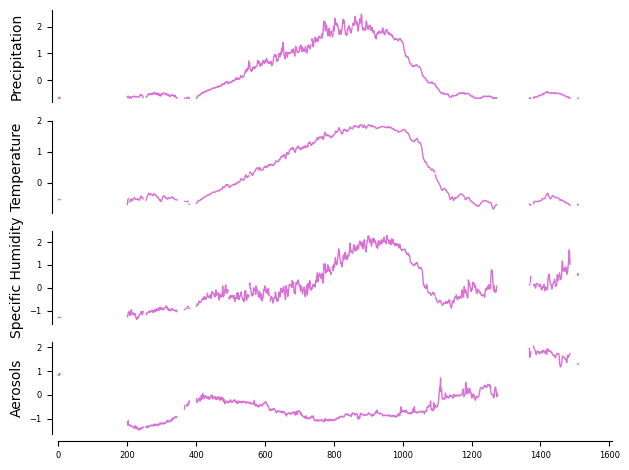

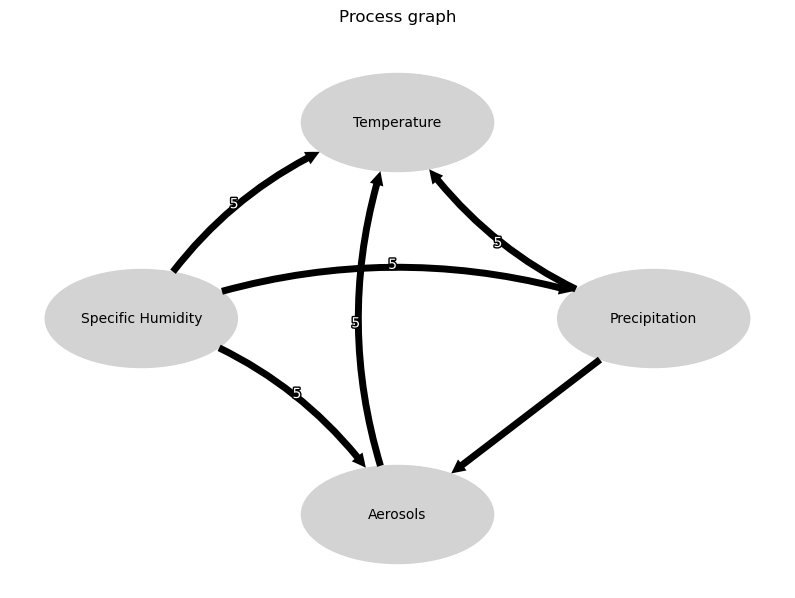

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


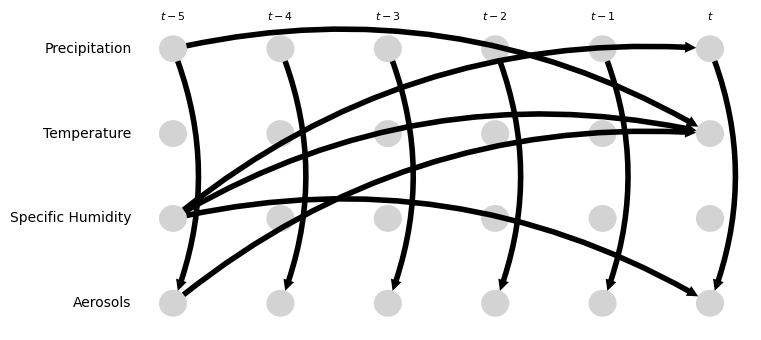

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.79 [-0.84, -0.75]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.73 [0.71, 0.76]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [0.16, 0.21]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.55 [0.50, 0.62]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.77 [0.75, 0.79]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.15 [-0.17, -0.13]
Negative precipitation values in event 29: 21


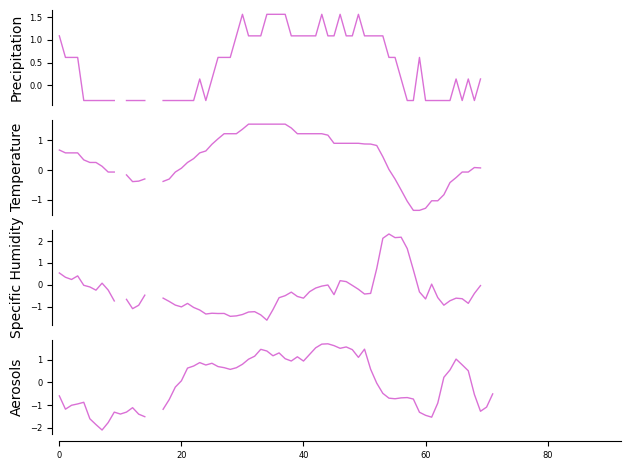

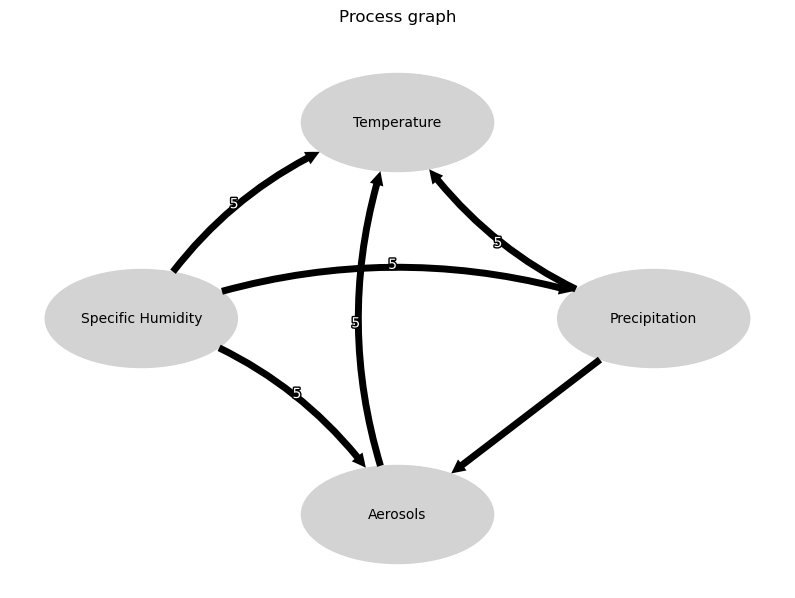

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


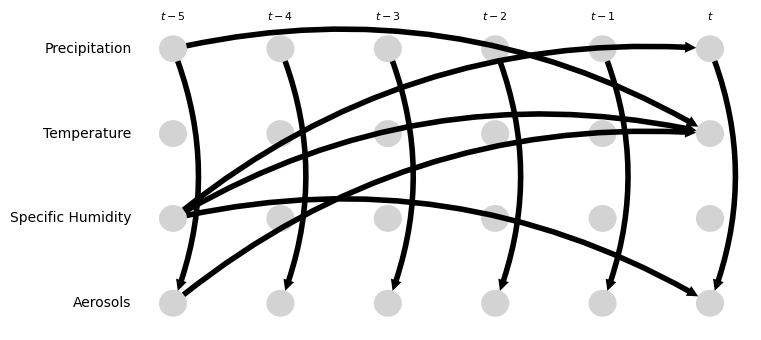

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.95 [0.69, 1.19]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.13 [-0.12, 0.31]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.60 [-0.70, -0.51]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.31 [-0.43, -0.12]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.30 [-0.42, -0.15]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.32 [0.19, 0.45]
Negative precipitation values in event 30: 97


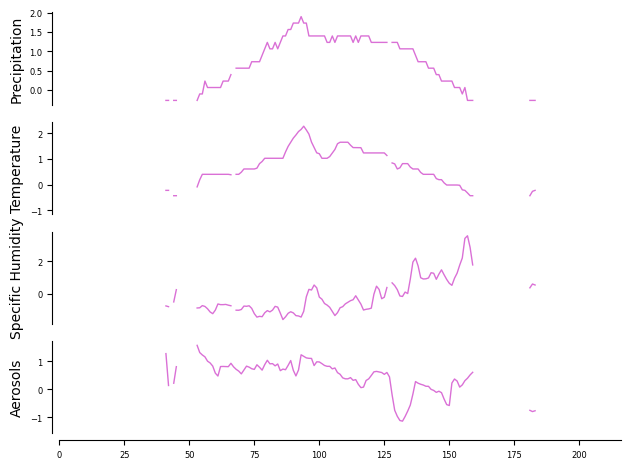

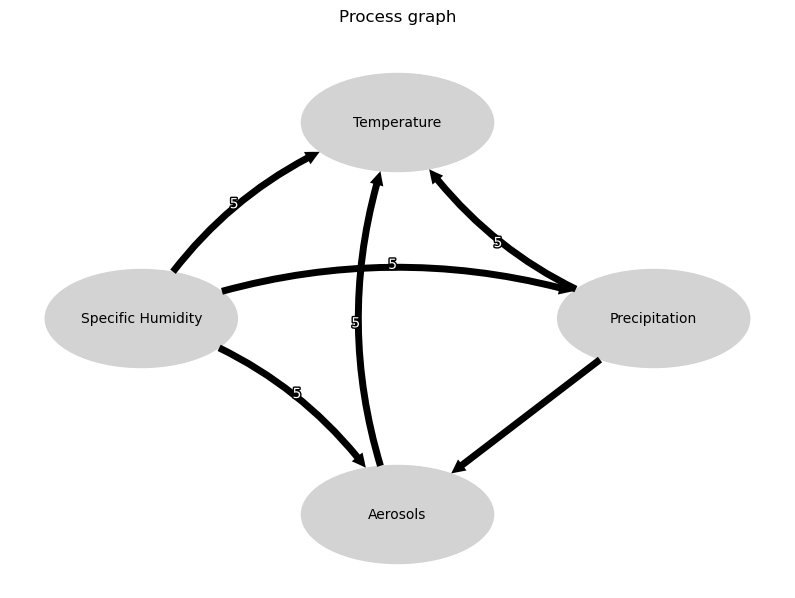

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


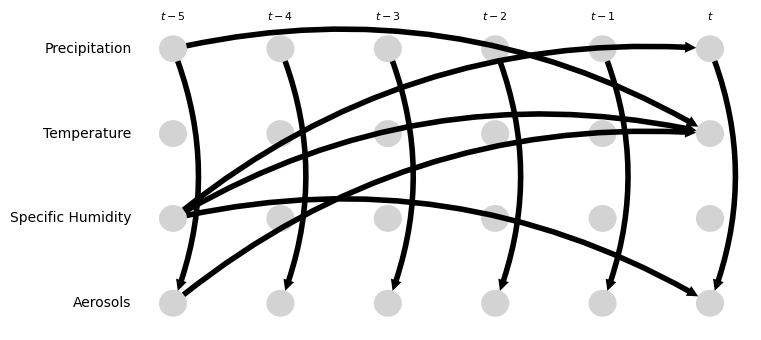

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.08 [-0.27, 0.09]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.77 [0.70, 0.85]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.26 [-0.31, -0.23]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.31 [-0.42, -0.22]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.31 [-0.37, -0.22]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [0.09, 0.22]
Negative precipitation values in event 31: 461


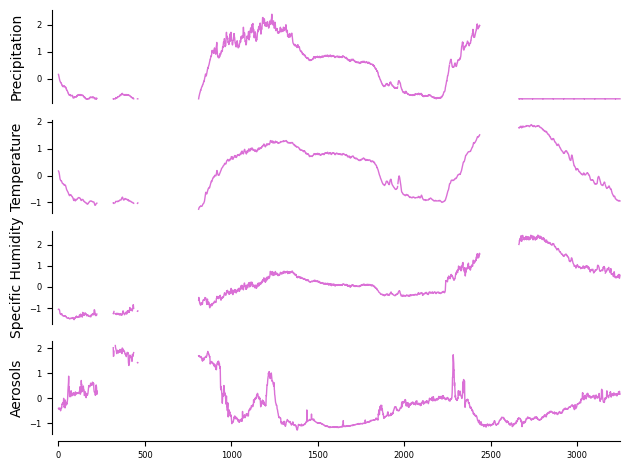

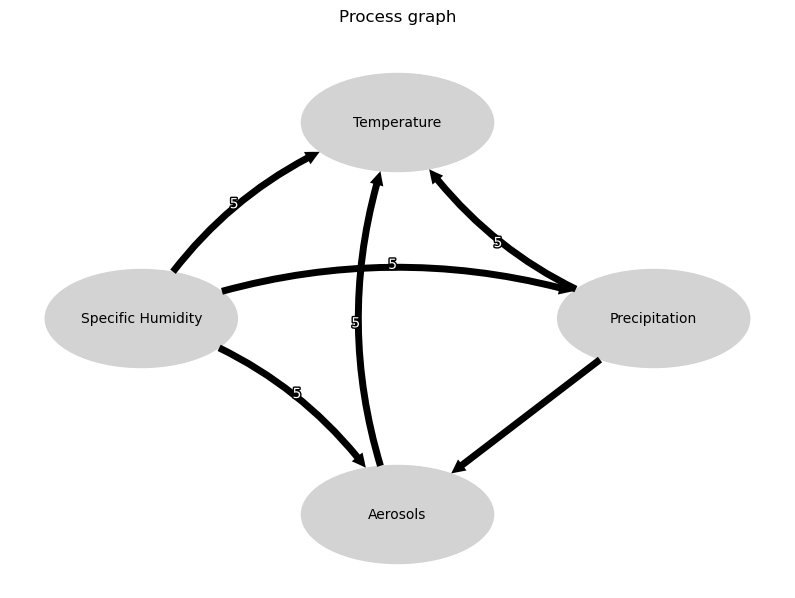

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


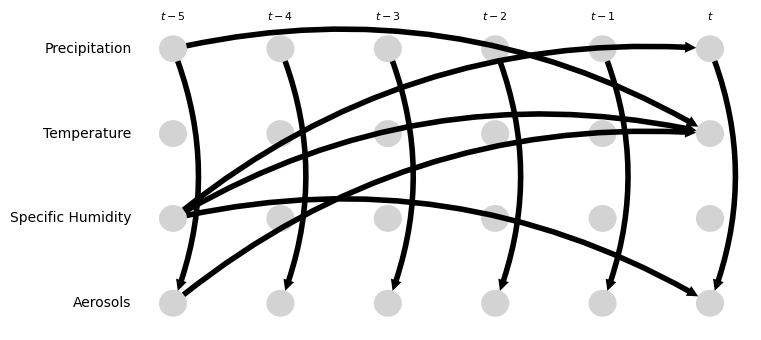

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.20 [-0.22, -0.18]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.43 [0.42, 0.44]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.60 [0.58, 0.61]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.37 [-0.39, -0.35]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.05, 0.01]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.23, -0.20]
Negative precipitation values in event 32: 0


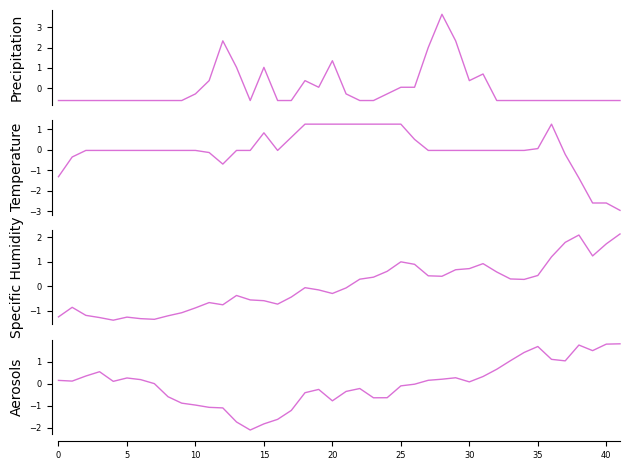

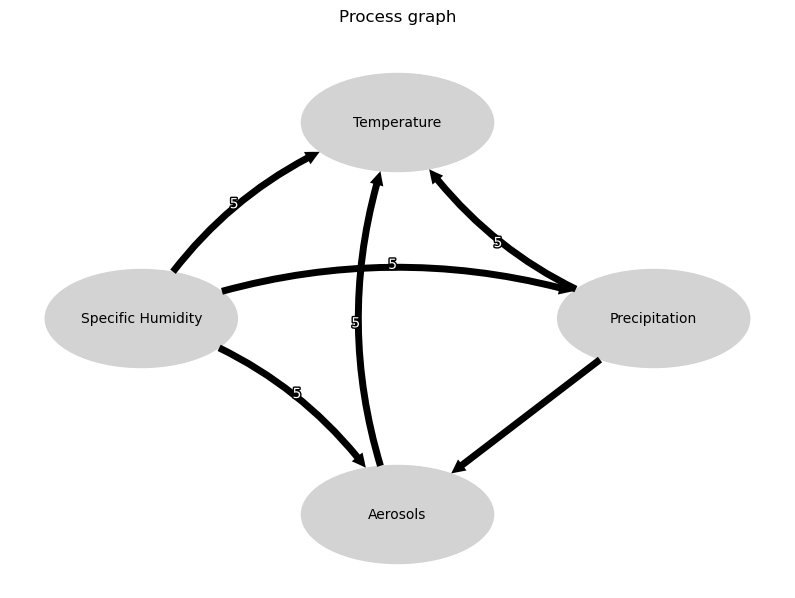

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


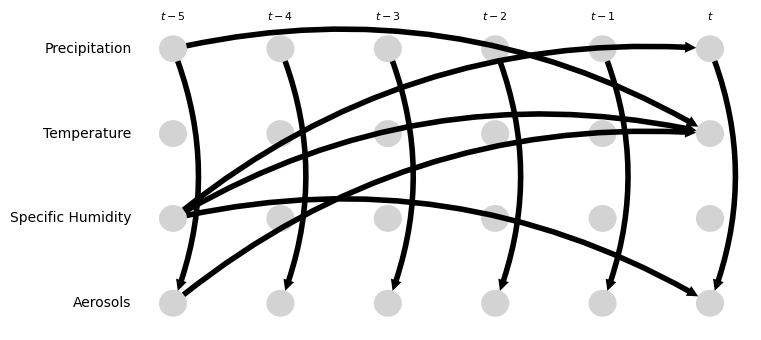

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.25 [-0.46, -0.11]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [0.04, 0.28]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-0.02, 0.43]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.23 [0.99, 1.51]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.18 [-0.58, 0.27]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.98 [-1.15, -0.65]
Negative precipitation values in event 33: 0


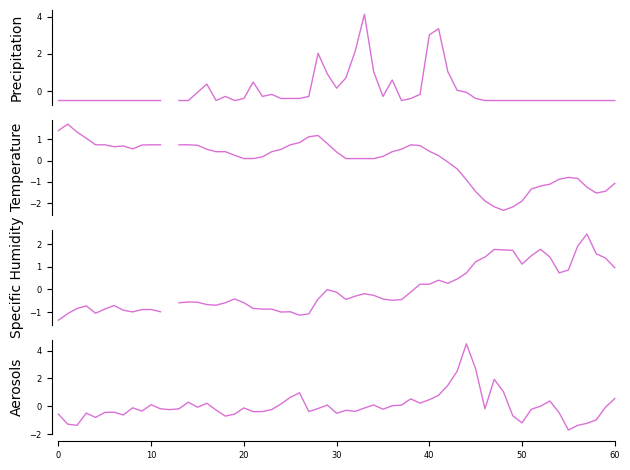

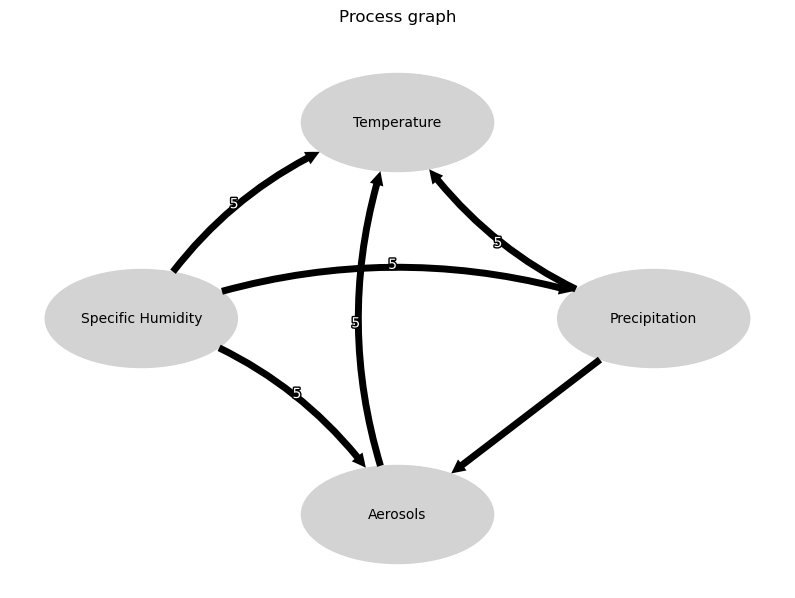

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


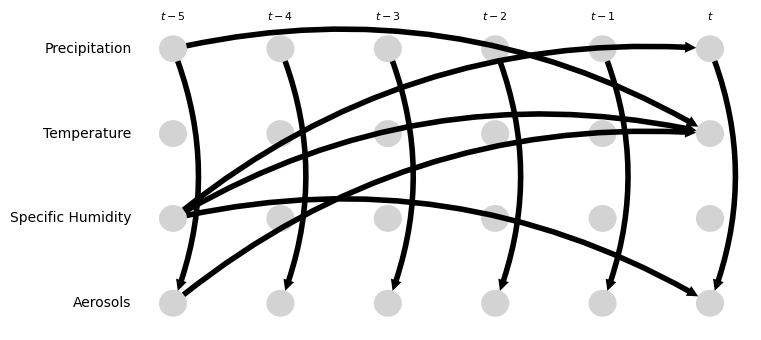

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [-0.02, 0.27]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.22, 0.10]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.76 [-0.86, -0.62]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.16 [-0.37, 0.05]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.42 [-0.61, -0.27]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.37 [-0.57, -0.29]
Negative precipitation values in event 34: 0


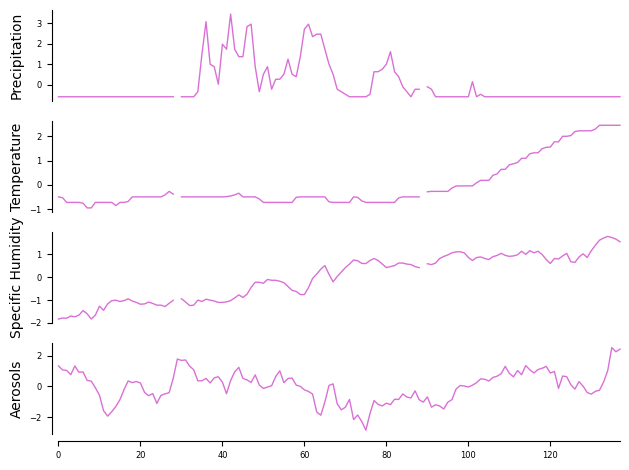

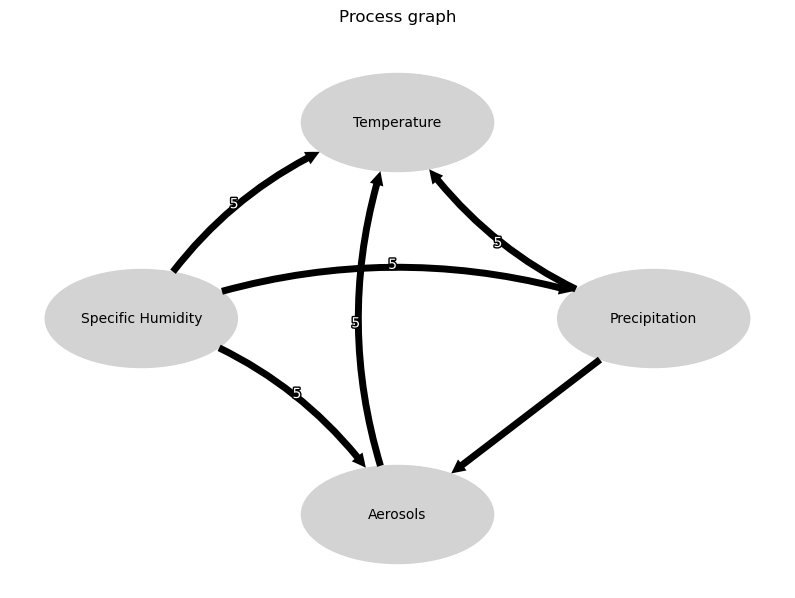

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


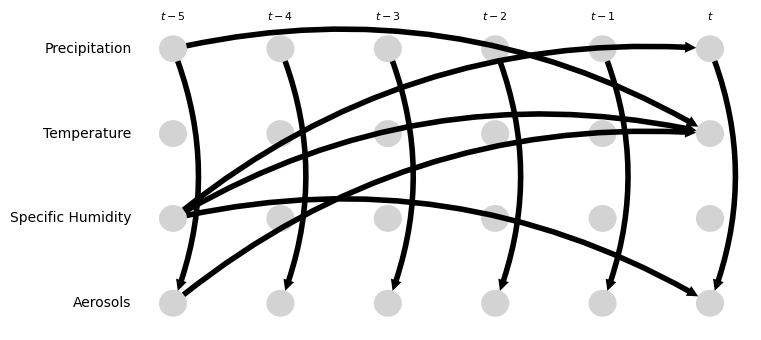

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.16, 0.09]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.22 [-0.30, -0.16]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.70 [0.59, 0.78]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.18 [-0.02, 0.30]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.39 [-0.59, -0.24]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.46 [0.38, 0.58]
Negative precipitation values in event 35: 0


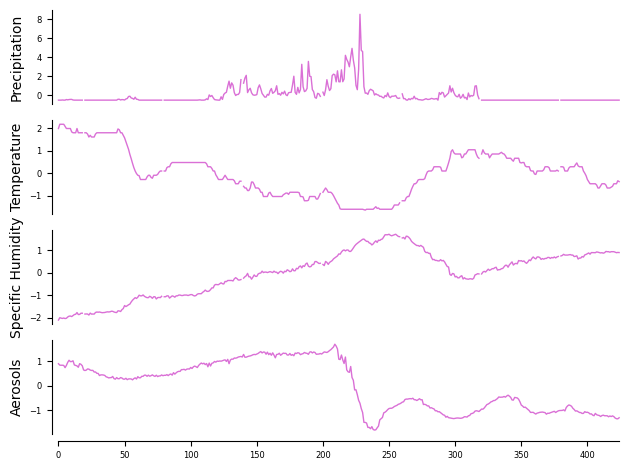

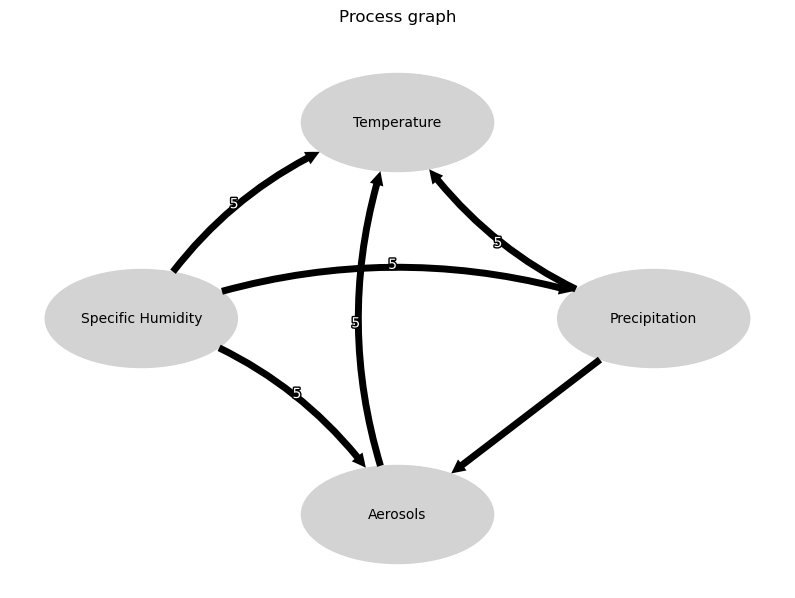

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


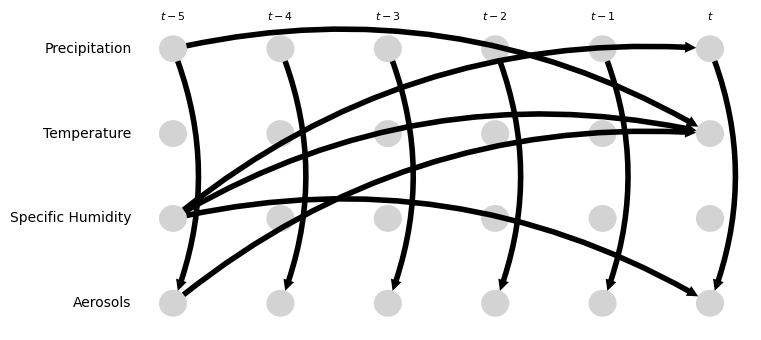

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.39 [0.28, 0.56]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.13 [-0.17, -0.11]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.90 [-0.94, -0.85]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.65 [-0.69, -0.60]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.24 [0.16, 0.32]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.51 [-0.55, -0.47]
Negative precipitation values in event 36: 0


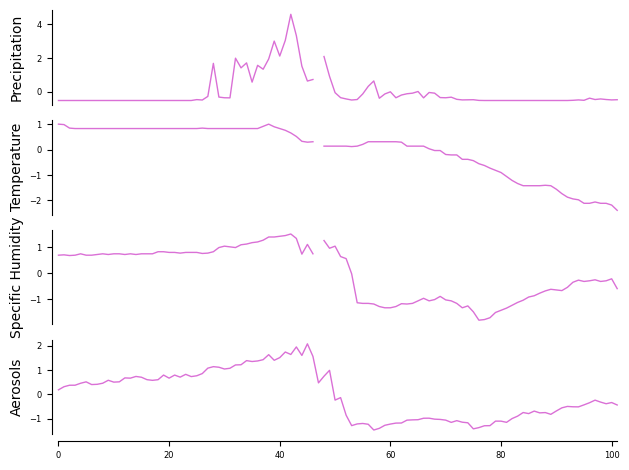

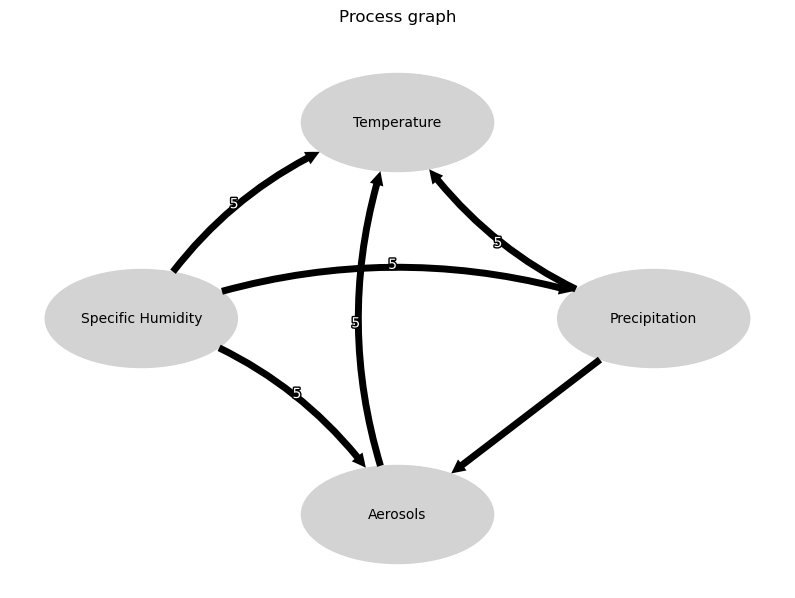

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


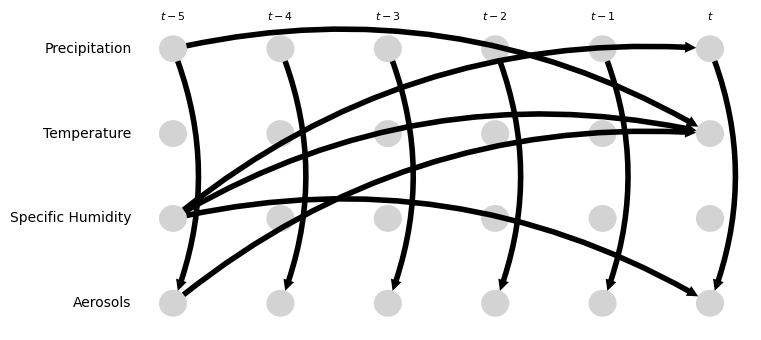

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.24 [0.14, 0.33]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.03 [-0.13, 0.15]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.79 [0.60, 1.11]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.70 [0.54, 0.82]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.51 [0.35, 0.69]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.56, 0.08]
Negative precipitation values in event 37: 0


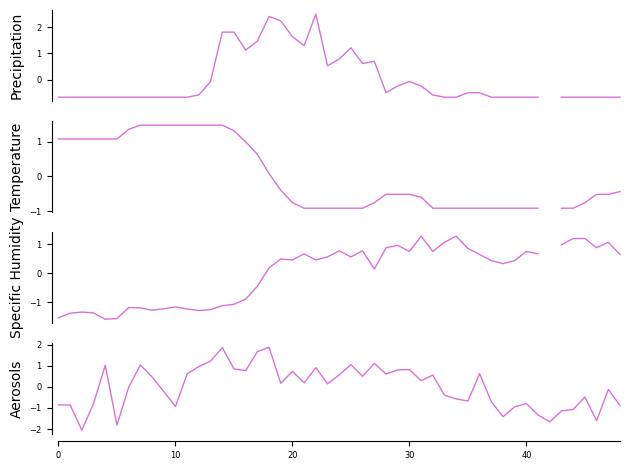

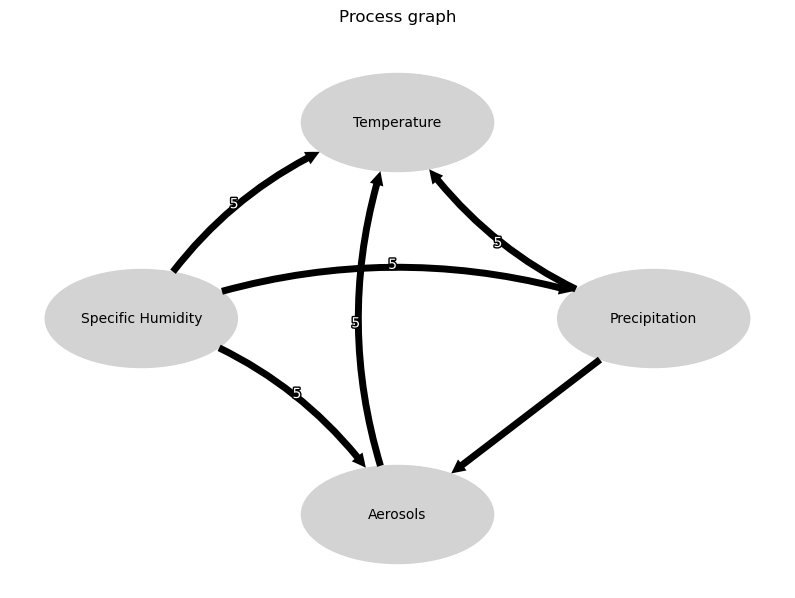

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


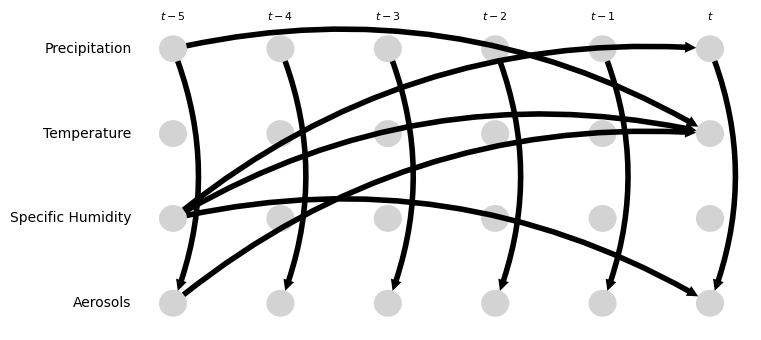

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.51 [0.31, 0.73]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.27 [-0.42, -0.15]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.74 [-0.86, -0.58]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-0.53, 0.06]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.68 [-1.02, -0.43]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-0.21, 0.08]
Negative precipitation values in event 38: 0


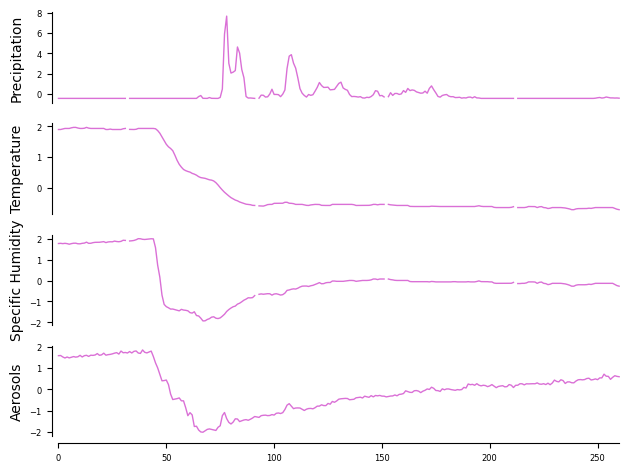

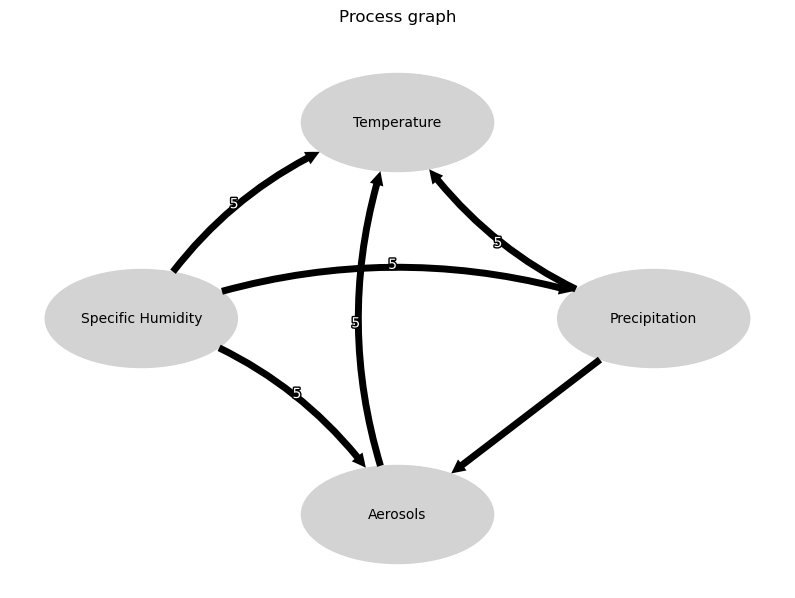

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


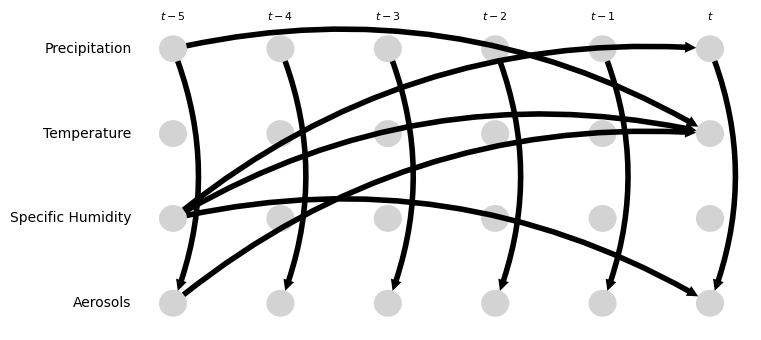

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.15, -0.03]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.10, 0.04]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.42 [0.23, 0.64]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.86 [0.81, 0.91]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.35 [-0.52, -0.24]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.23 [-0.02, 0.41]
Negative precipitation values in event 39: 0


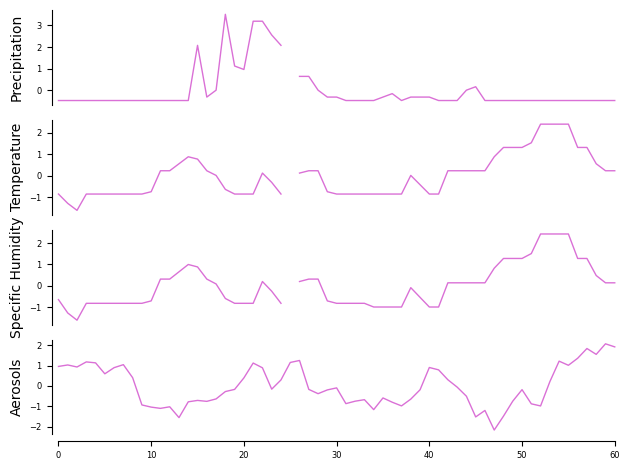

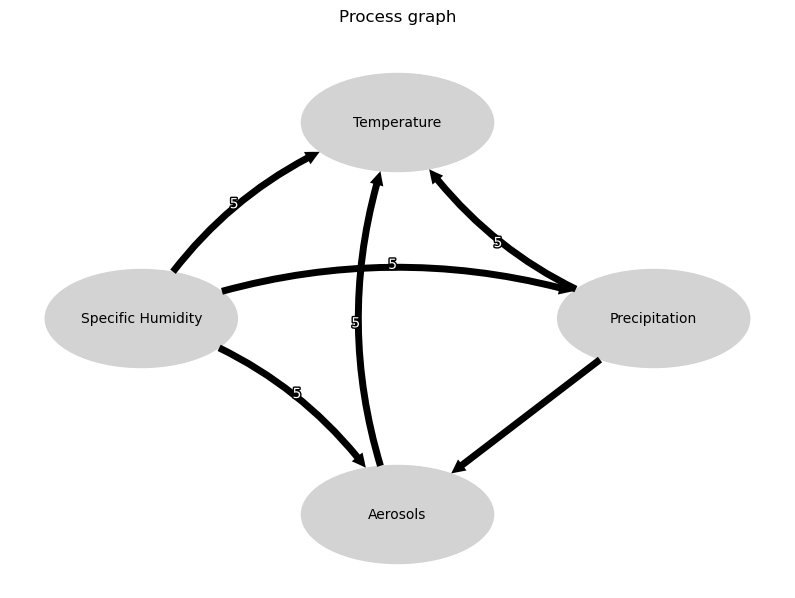

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


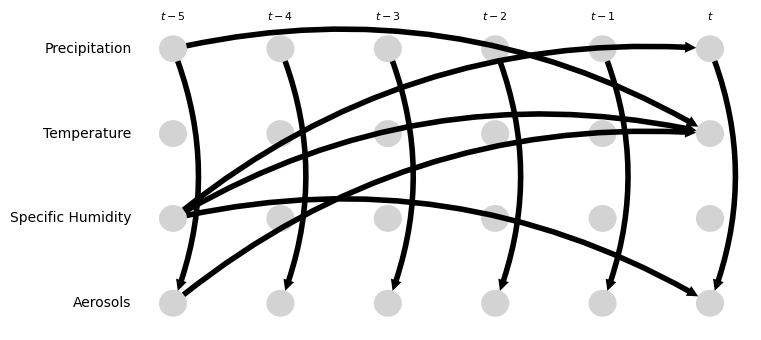

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.12 [-0.03, 0.27]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.11 [-0.33, 0.05]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.37 [0.23, 0.65]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.61 [0.30, 0.73]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.05 [-0.19, 0.22]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.22 [-0.46, 0.12]
Negative precipitation values in event 40: 0


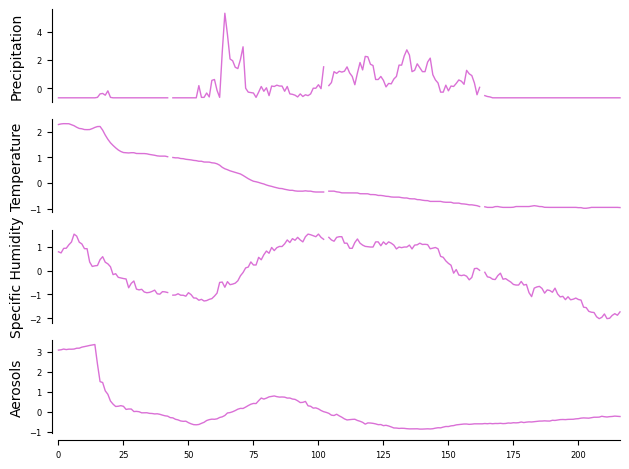

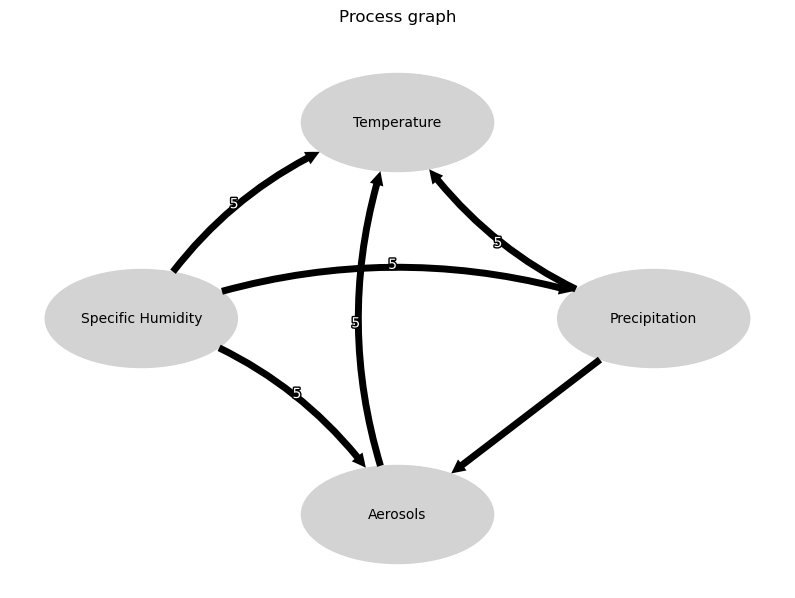

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


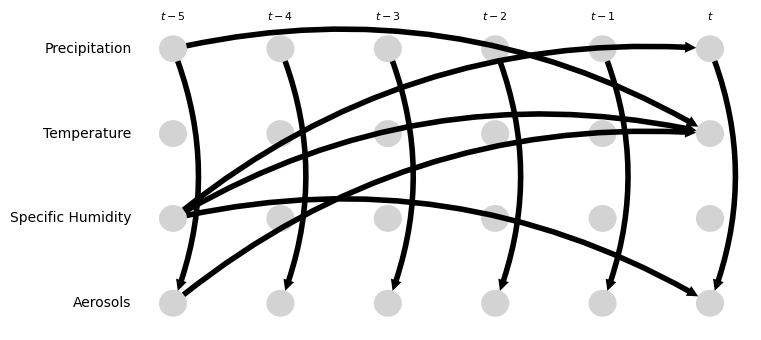

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.34 [-0.58, -0.19]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.09 [0.06, 0.12]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.22 [-0.32, -0.16]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.25 [0.14, 0.42]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.38 [0.26, 0.50]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.75 [0.70, 0.81]
Negative precipitation values in event 41: 0


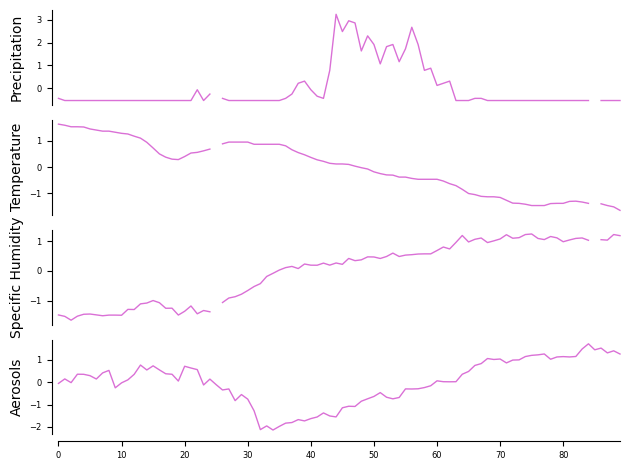

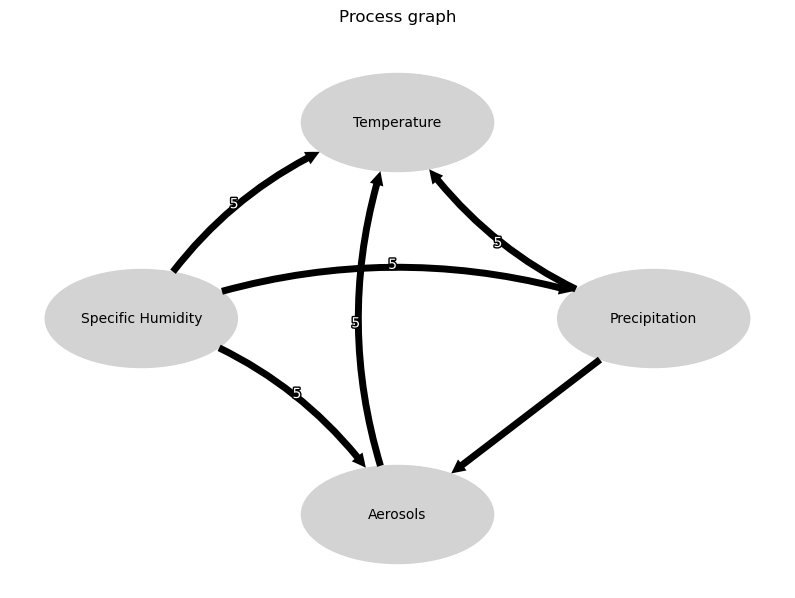

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


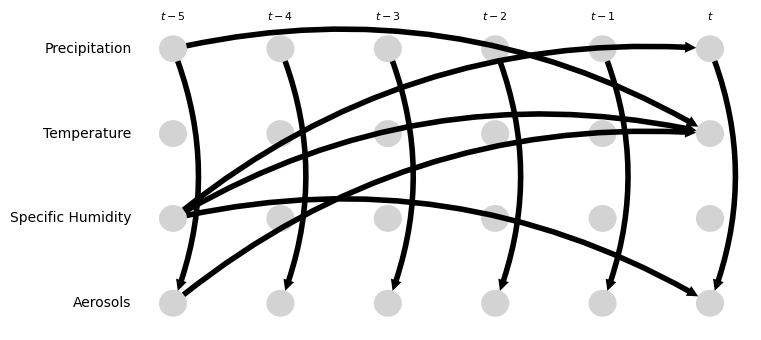

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.50 [-0.58, -0.41]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.03 [-0.04, -0.01]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.83 [-0.86, -0.78]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.53 [0.39, 0.68]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [0.05, 0.32]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.29 [-0.31, -0.27]
Negative precipitation values in event 42: 0


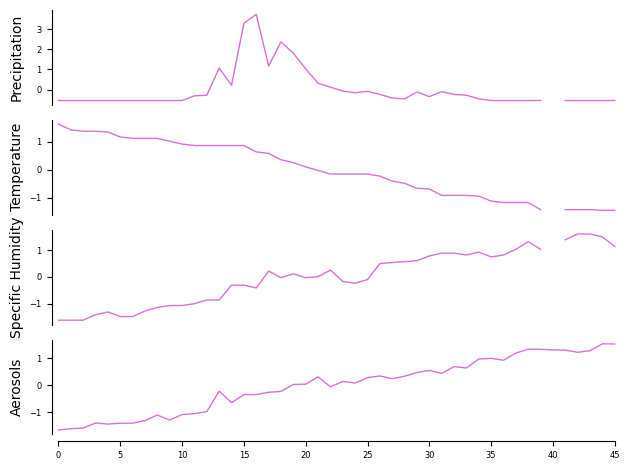

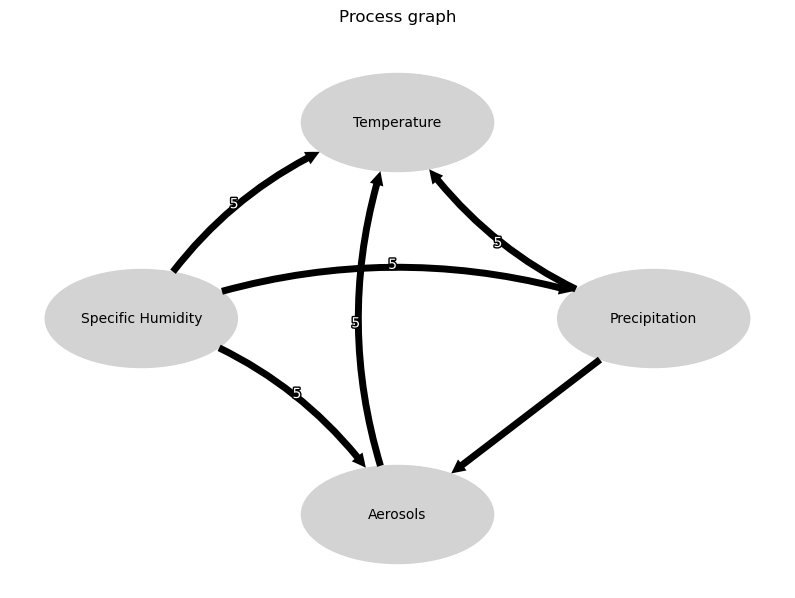

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


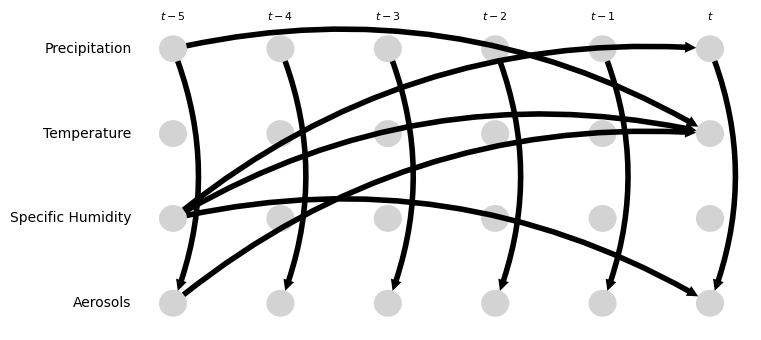

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.10 [0.06, 0.16]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [0.02, 0.11]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.47 [-0.63, -0.22]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.88 [0.79, 0.94]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.73 [-1.25, -0.47]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.52 [-0.83, -0.34]
Negative precipitation values in event 43: 0


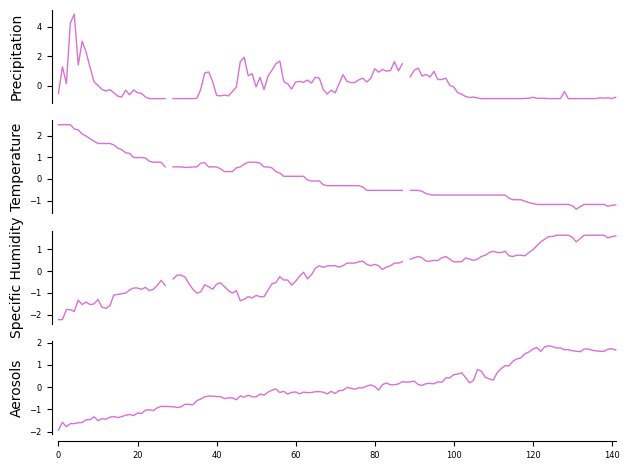

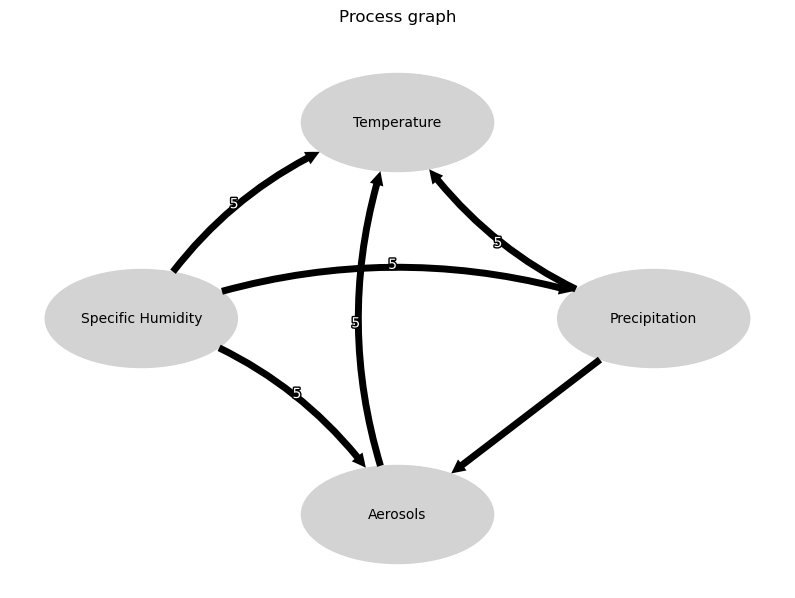

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


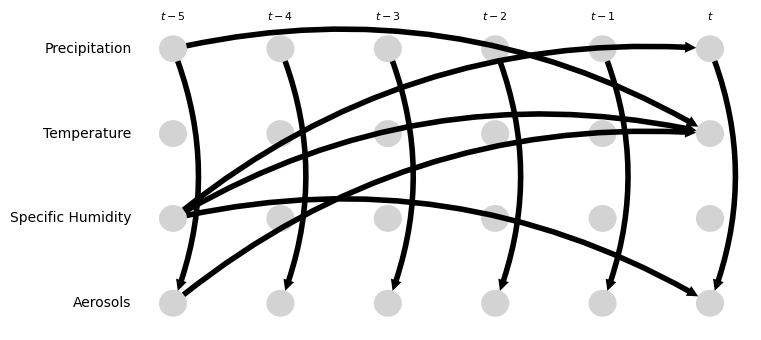

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.10, 0.04]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.13, -0.03]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.55 [-0.65, -0.47]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.91 [0.86, 0.97]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.29, -0.12]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.34 [-0.42, -0.27]
Negative precipitation values in event 44: 0


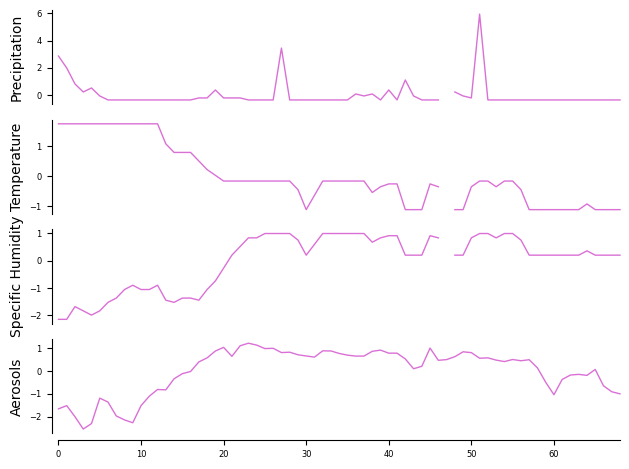

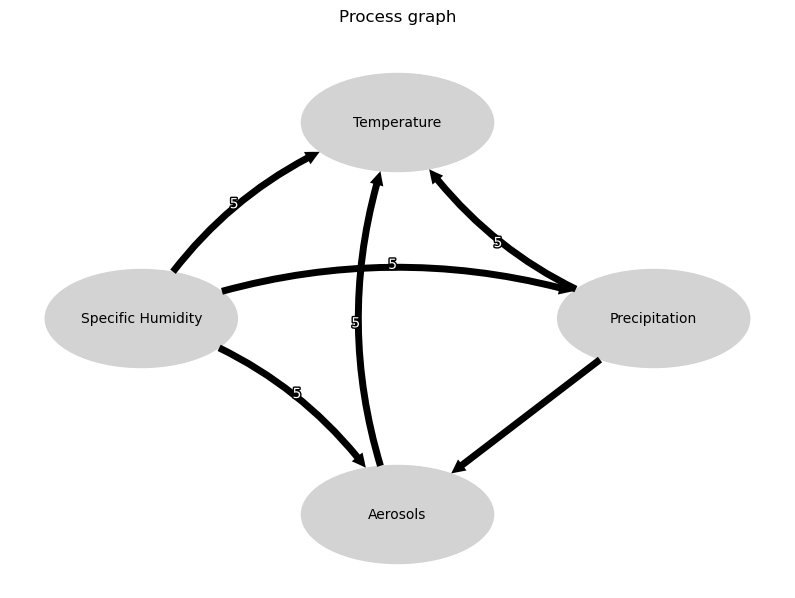

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


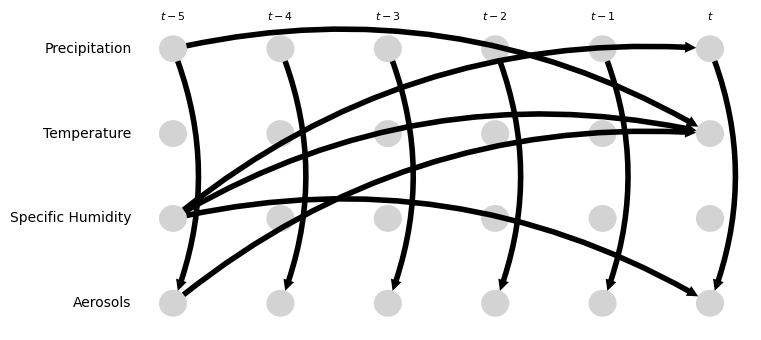

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [0.01, 0.76]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.09 [0.03, 0.29]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.41 [-0.59, -0.23]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [-0.01, 0.31]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.14 [0.00, 0.33]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.41, 0.04]
Negative precipitation values in event 45: 0


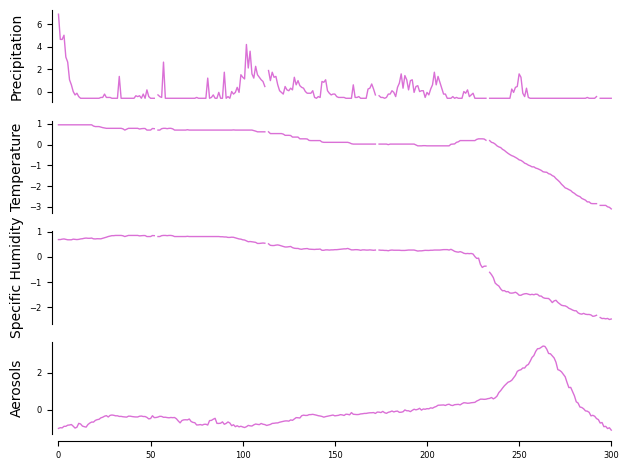

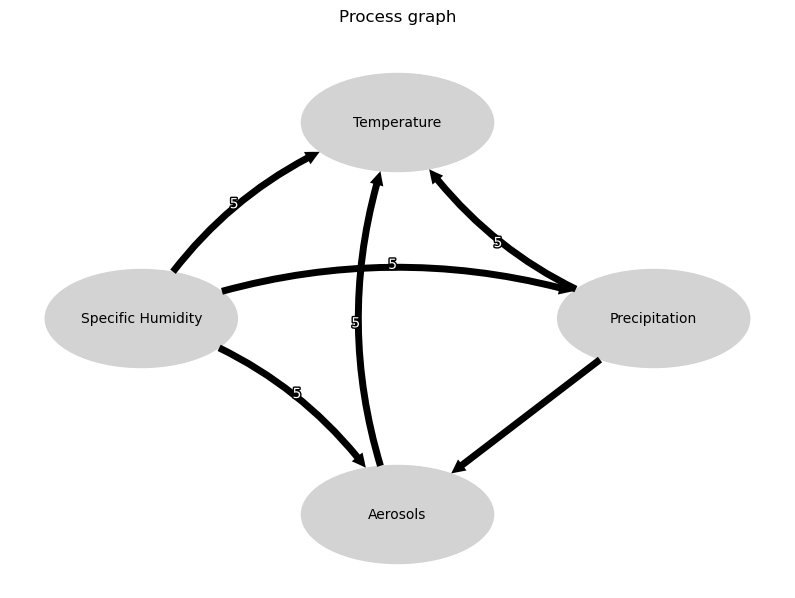

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


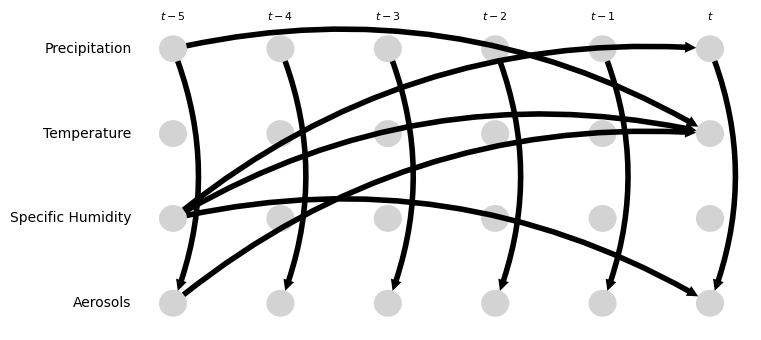

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-0.15, -0.05]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [0.00, 0.05]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.12 [1.08, 1.15]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.68 [-0.83, -0.55]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.17 [0.12, 0.23]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [0.13, 0.19]
Negative precipitation values in event 46: 0


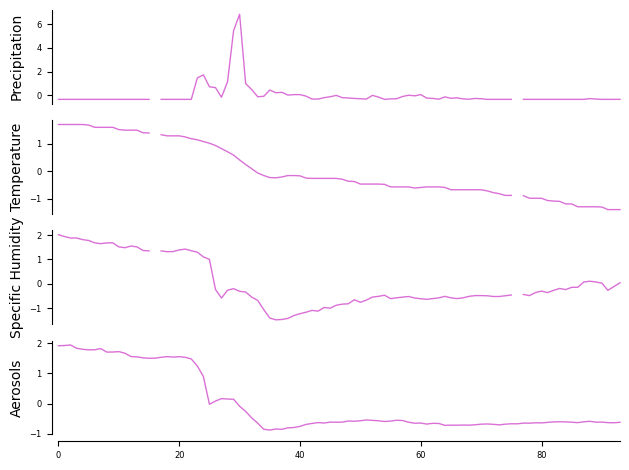

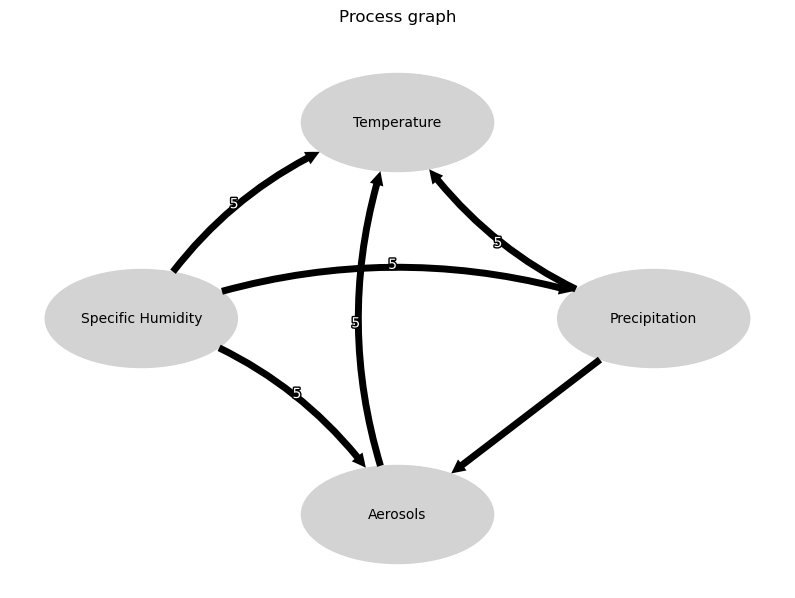

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


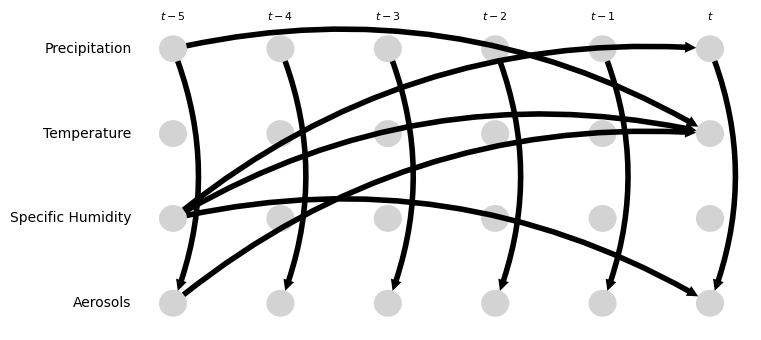

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.22, -0.11]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.05, 0.11]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.74 [-1.04, -0.41]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.78 [0.63, 0.89]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.31 [0.11, 0.72]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.56 [1.22, 1.86]
Negative precipitation values in event 47: 0


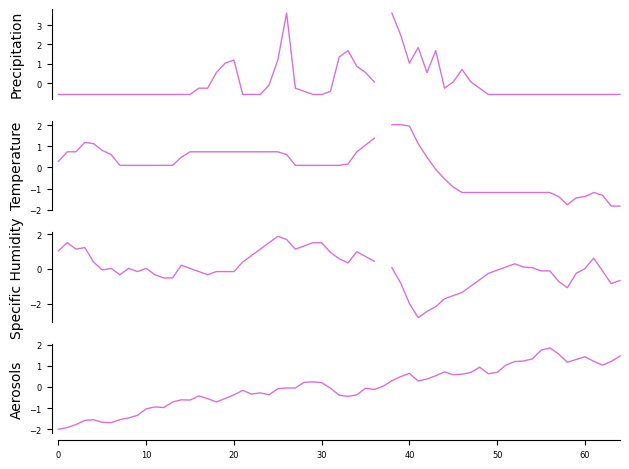

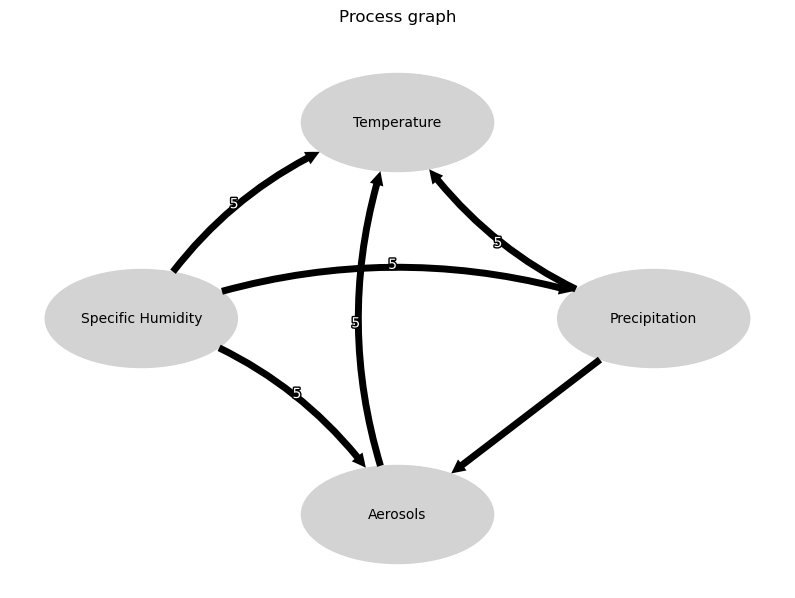

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


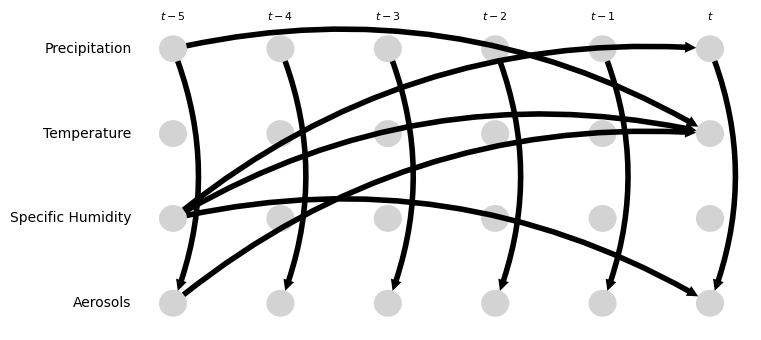

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.11, 0.13]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.15 [0.01, 0.40]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.41 [0.27, 0.58]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.19 [-0.28, -0.13]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.25 [0.11, 0.48]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.75 [-0.98, -0.61]
Negative precipitation values in event 48: 0


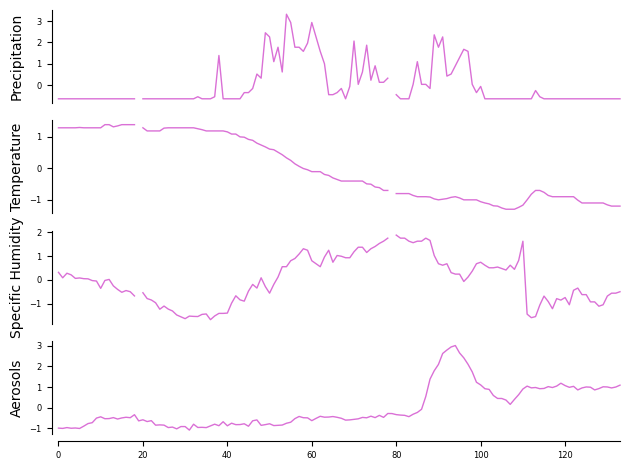

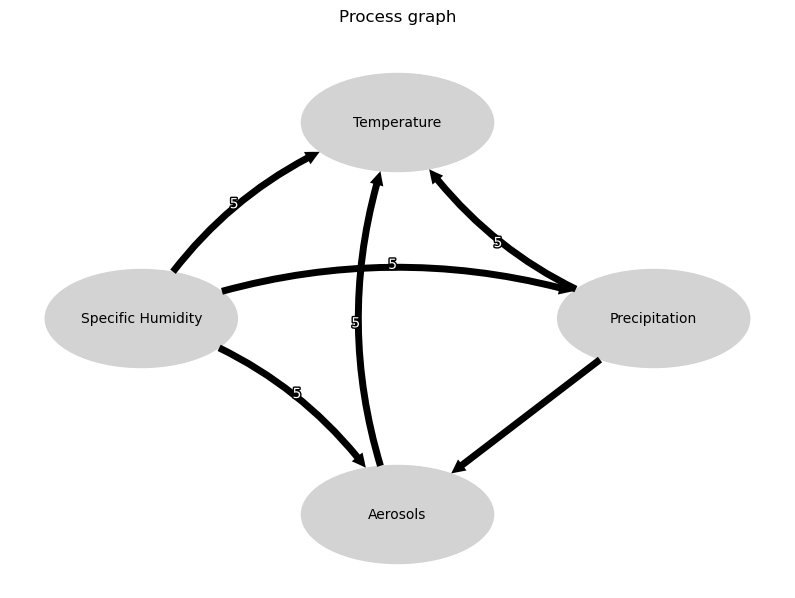

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


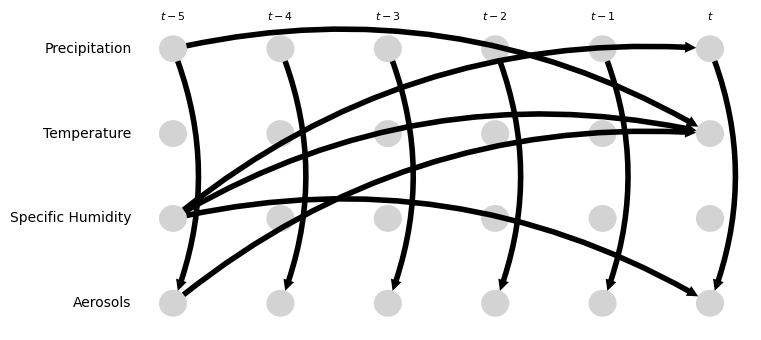

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.17, 0.15]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.05, 0.10]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.41 [-0.49, -0.36]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.32 [0.18, 0.47]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.32 [0.18, 0.45]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.62 [-0.75, -0.54]
Negative precipitation values in event 49: 0


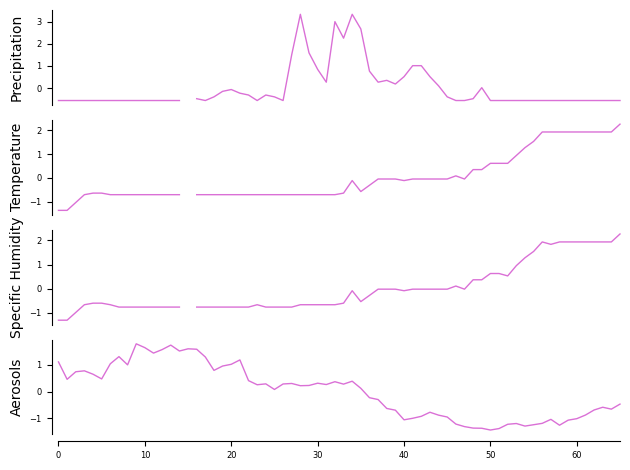

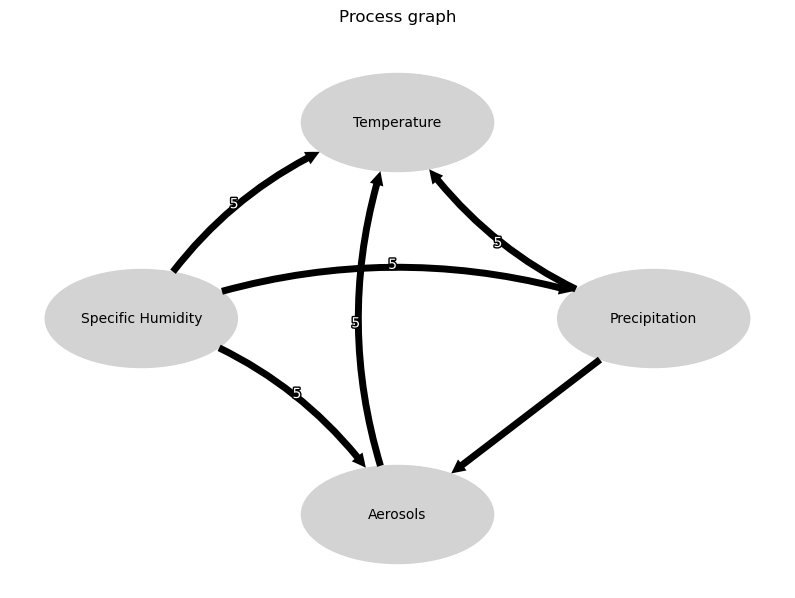

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


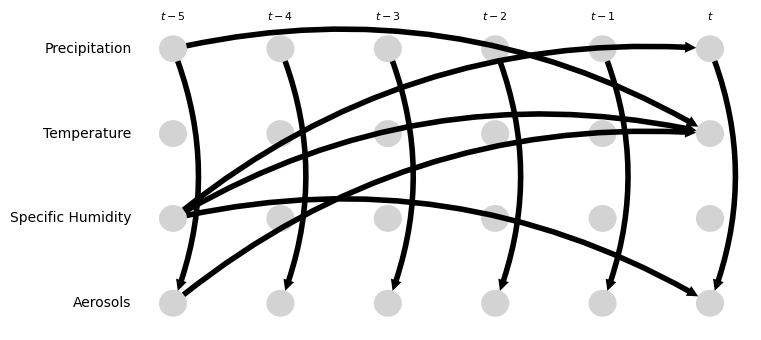

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.13 [-0.32, -0.06]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.02 [-0.08, 0.04]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.89 [0.79, 1.04]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.69 [-1.08, -0.53]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.47 [-0.72, -0.32]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.25 [-0.35, -0.14]
Negative precipitation values in event 50: 0


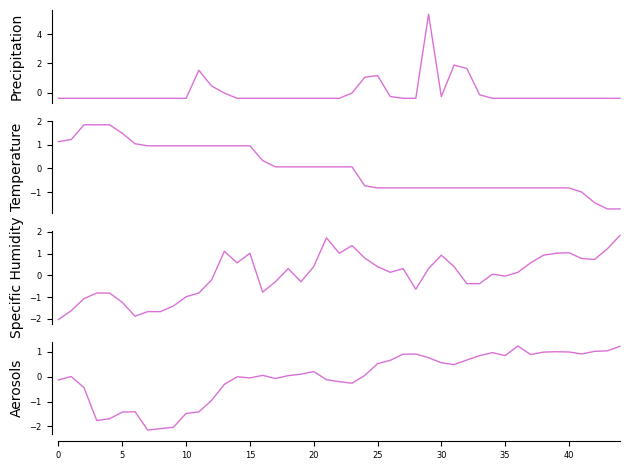

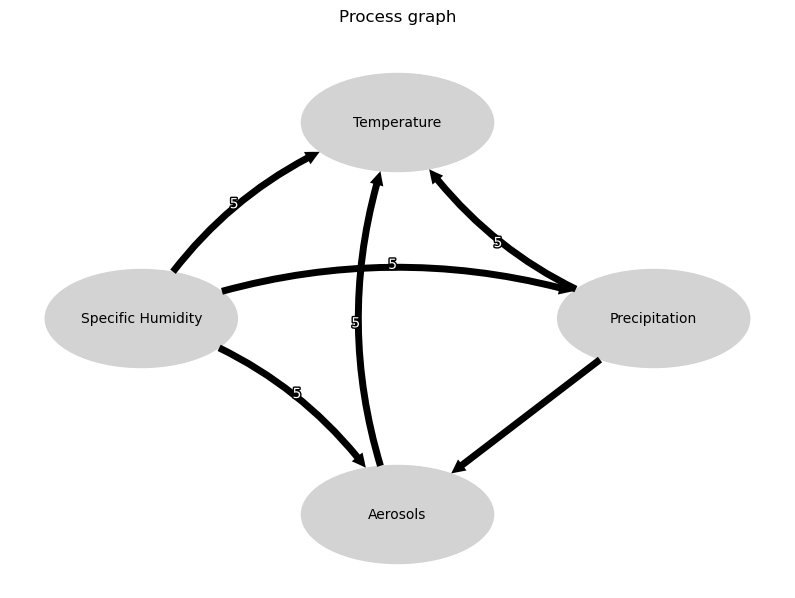

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


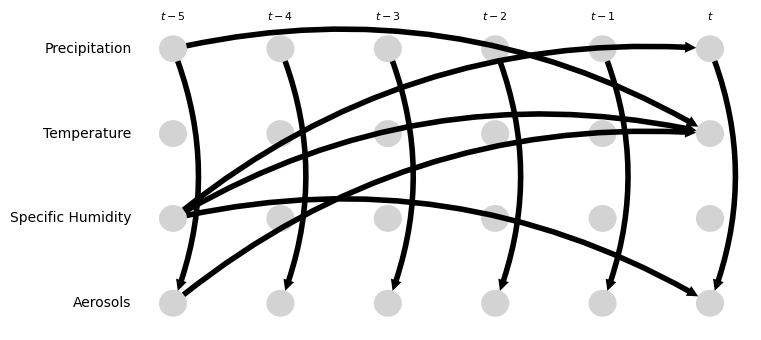

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.06, 0.12]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.02 [-0.14, 0.01]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-0.32, -0.05]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.51 [0.29, 0.63]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.00 [-0.23, 0.36]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.58 [-0.68, -0.50]
Negative precipitation values in event 51: 0


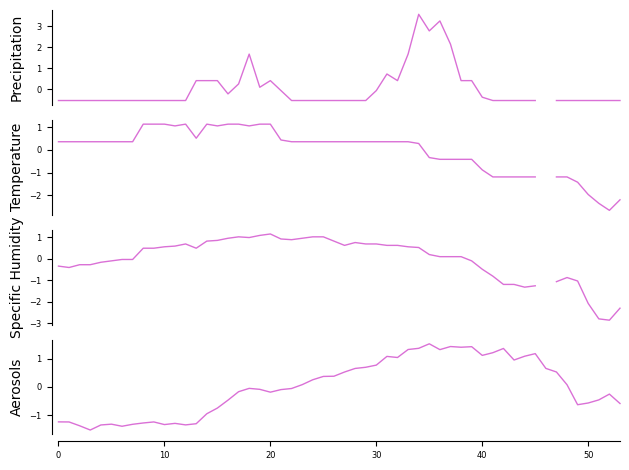

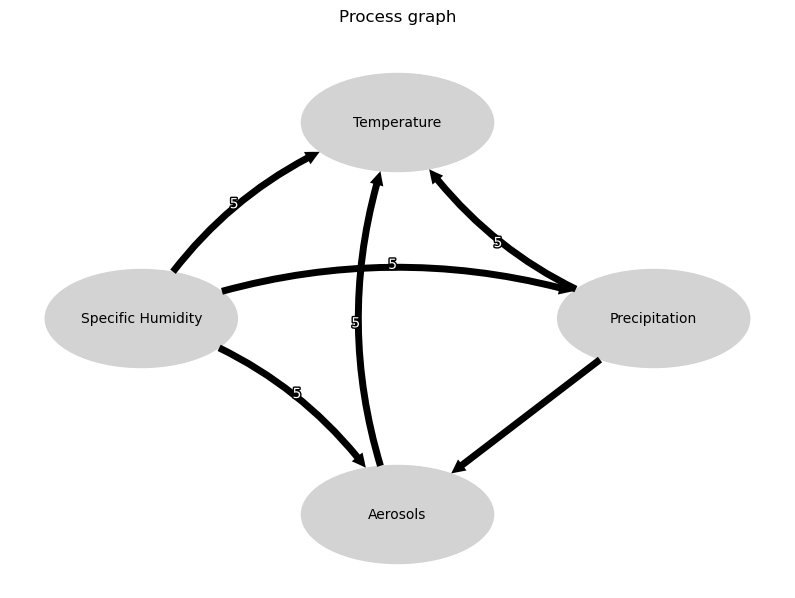

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


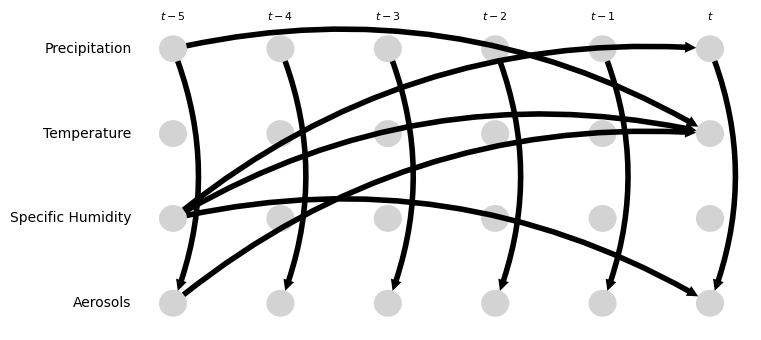

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.33 [0.22, 0.43]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.02 [-0.09, 0.05]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.74 [0.45, 0.90]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [-0.25, 0.32]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.45 [0.20, 0.71]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.62 [-0.73, -0.57]
Negative precipitation values in event 52: 0


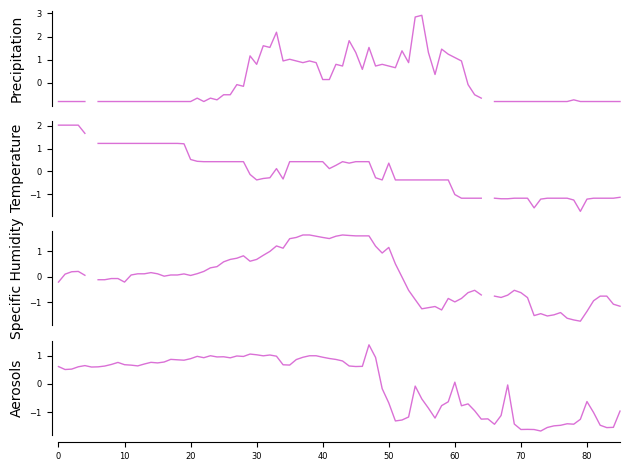

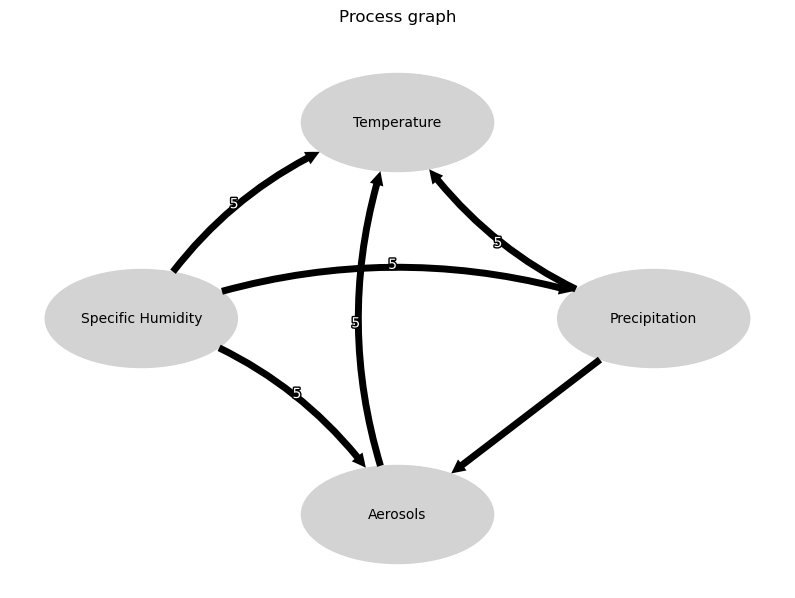

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


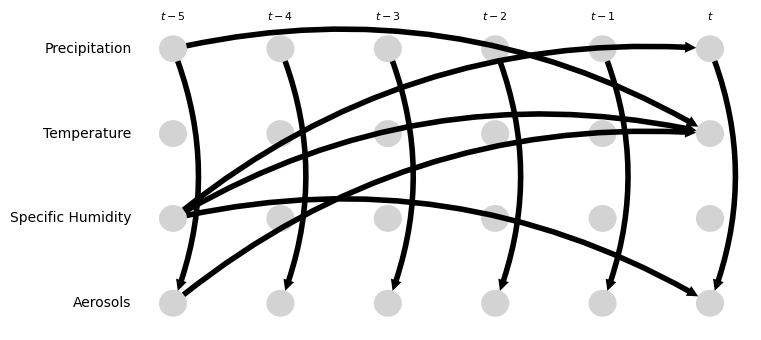

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.22 [-0.41, -0.07]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.16 [-0.25, -0.08]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.11, 0.14]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.70 [0.50, 0.91]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.62 [0.50, 0.76]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.68 [0.53, 0.82]
Negative precipitation values in event 53: 0


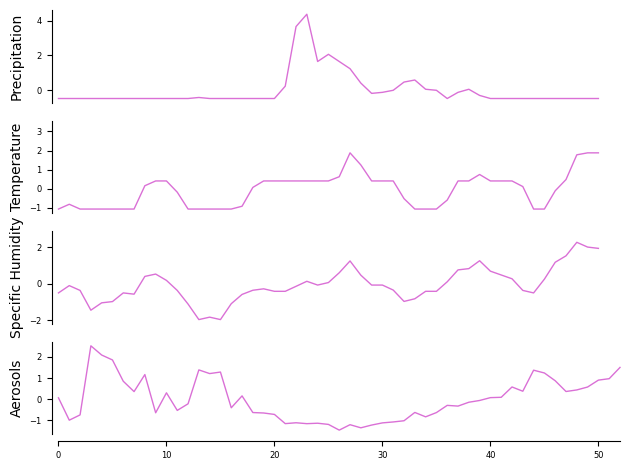

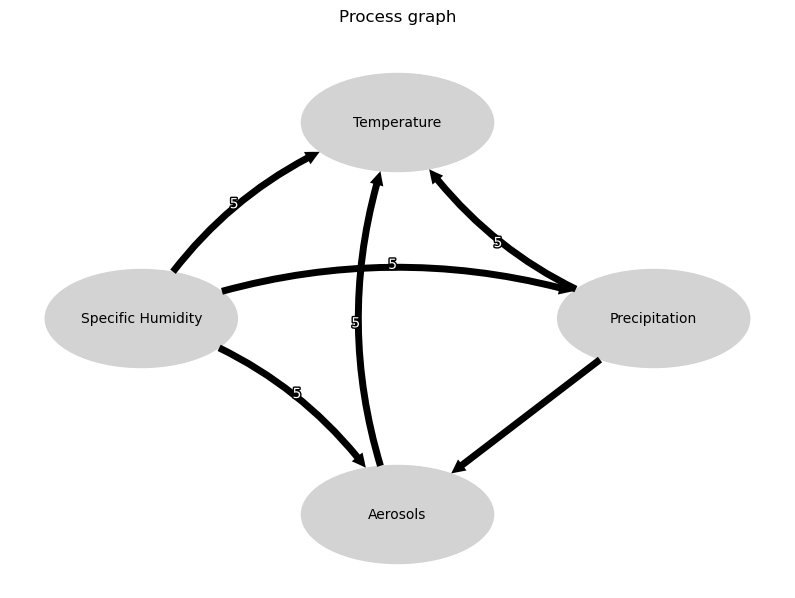

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


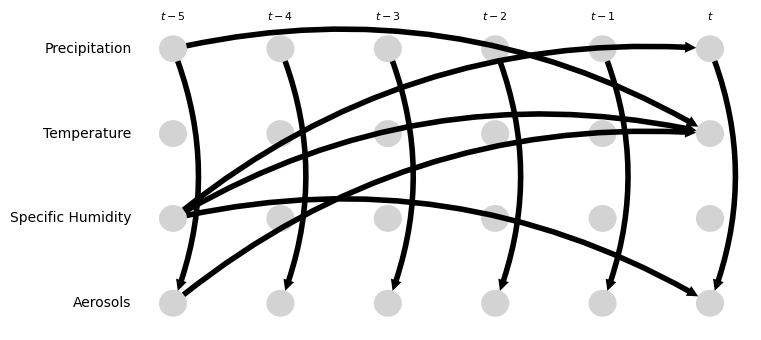

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.47 [-0.86, -0.37]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.43 [0.30, 0.61]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-0.48, 0.03]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.43 [0.18, 0.57]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.10 [-0.45, 0.14]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.48 [-0.02, 0.65]
Negative precipitation values in event 54: 0


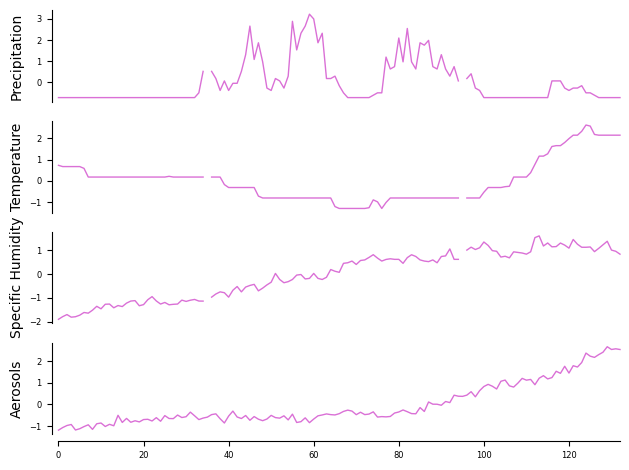

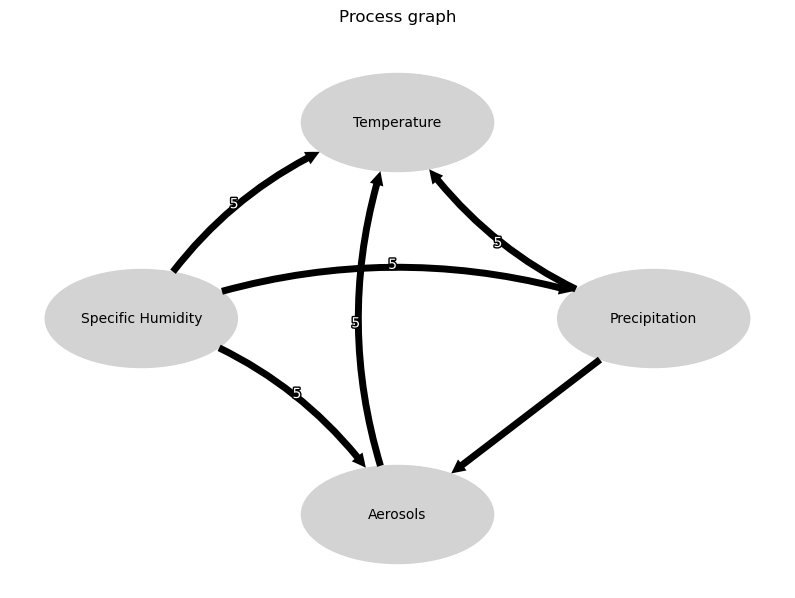

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


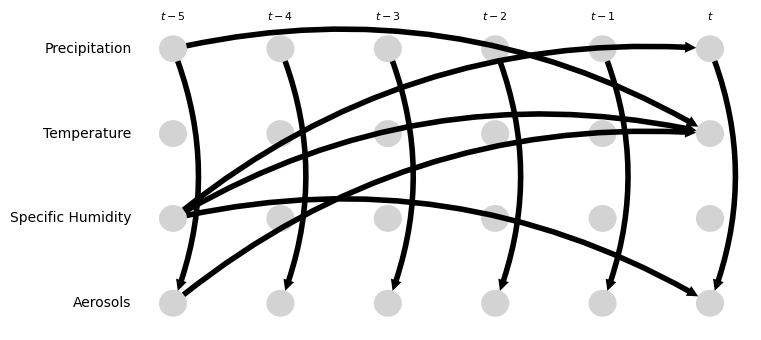

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.32 [-0.39, -0.25]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.12 [-0.18, -0.06]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.72 [-0.83, -0.65]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.83 [0.74, 0.90]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.09, 0.14]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.43 [1.34, 1.59]
Negative precipitation values in event 55: 0


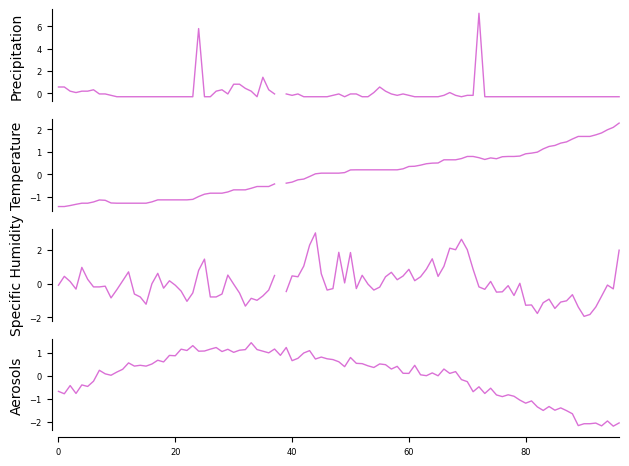

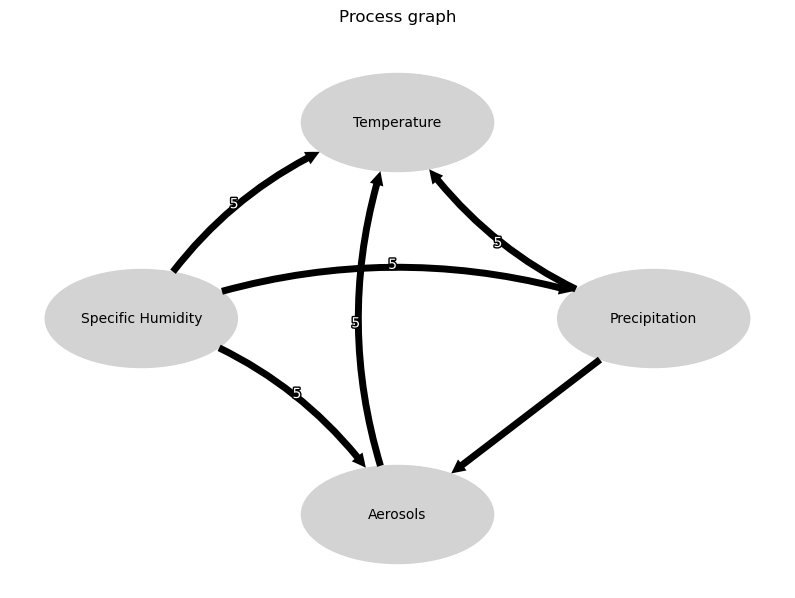

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


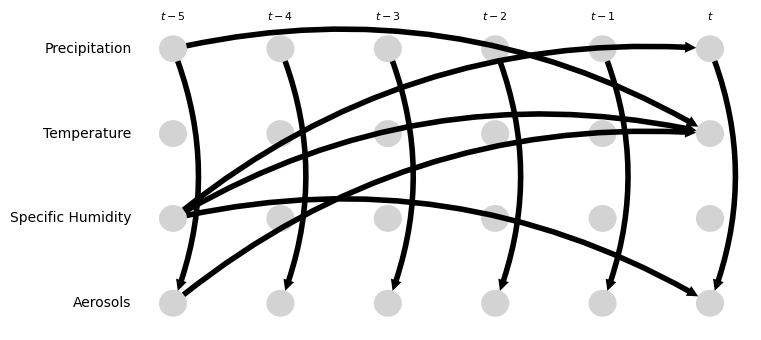

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.09 [-0.06, 1.23]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.00 [-0.06, 0.31]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [0.11, 0.26]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.25 [0.06, 0.42]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.20 [-0.03, 0.49]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.87 [-0.95, -0.78]
Negative precipitation values in event 56: 0


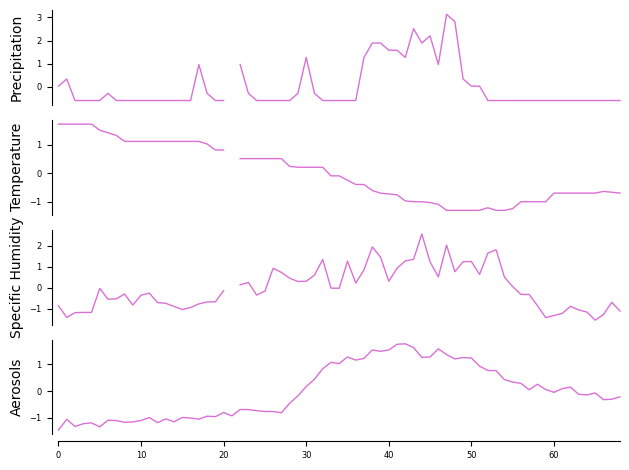

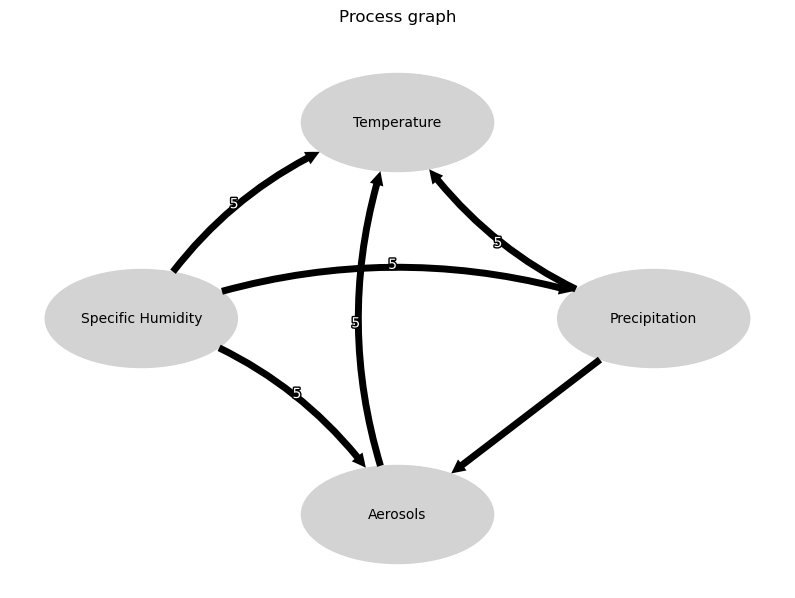

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


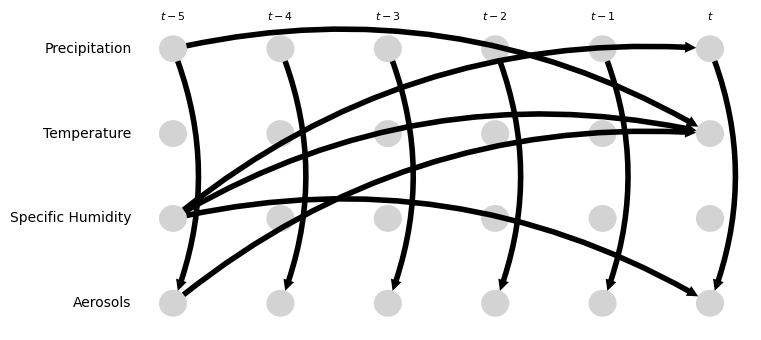

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.37 [0.26, 0.51]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-0.02, 0.11]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [-0.04, 0.16]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.51 [0.41, 0.69]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.41 [0.21, 0.68]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.85 [-0.93, -0.73]
Negative precipitation values in event 57: 0


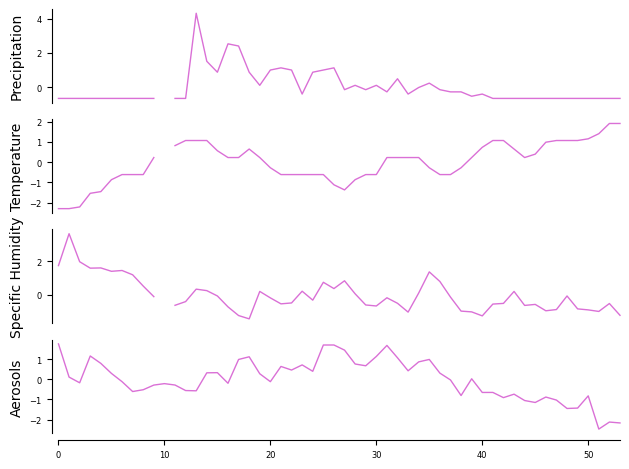

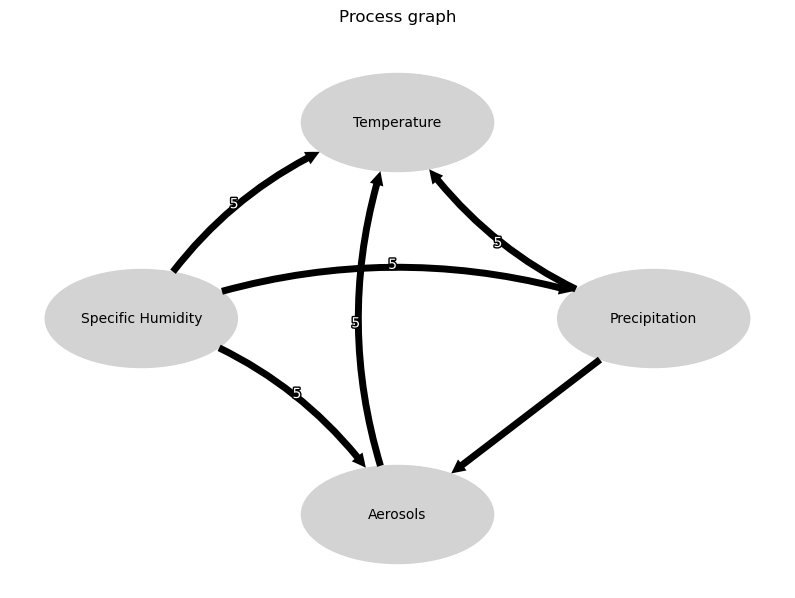

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


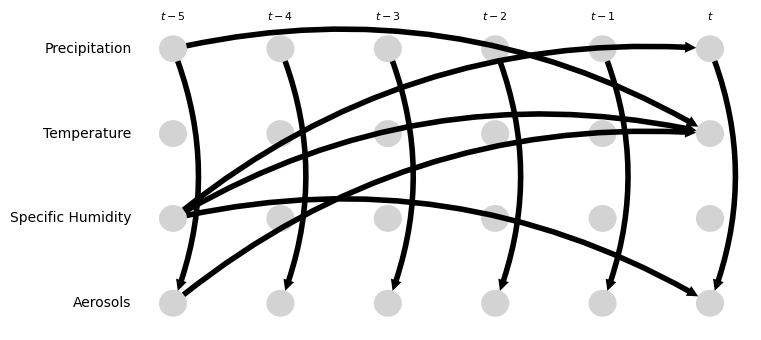

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.39 [0.13, 0.79]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.20 [-0.47, -0.12]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.35 [0.20, 0.50]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.20 [-0.05, 0.59]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [-0.22, 0.48]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.63 [-0.73, -0.43]
Negative precipitation values in event 58: 0


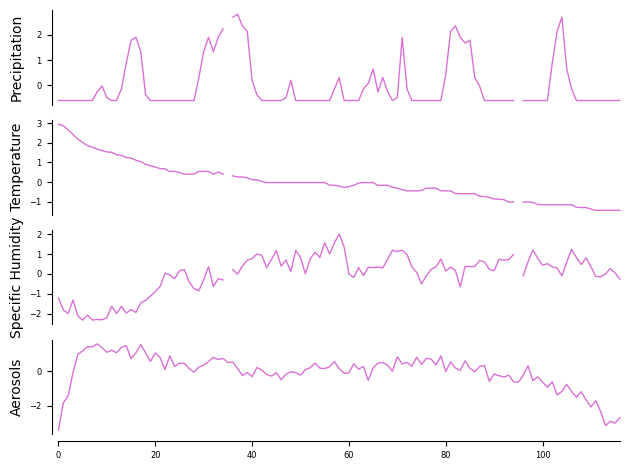

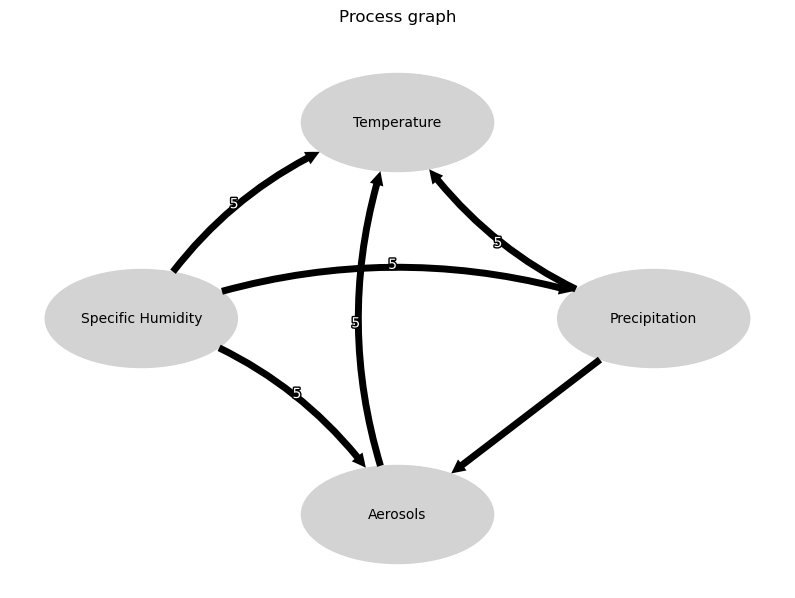

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


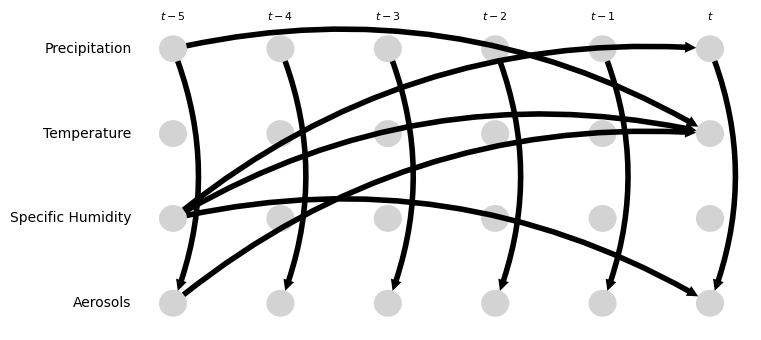

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [-0.04, 0.16]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.06 [-0.12, 0.01]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.27 [-0.36, -0.21]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.41 [-0.50, -0.32]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.16 [-0.38, -0.01]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.60 [0.49, 0.67]
Negative precipitation values in event 59: 0


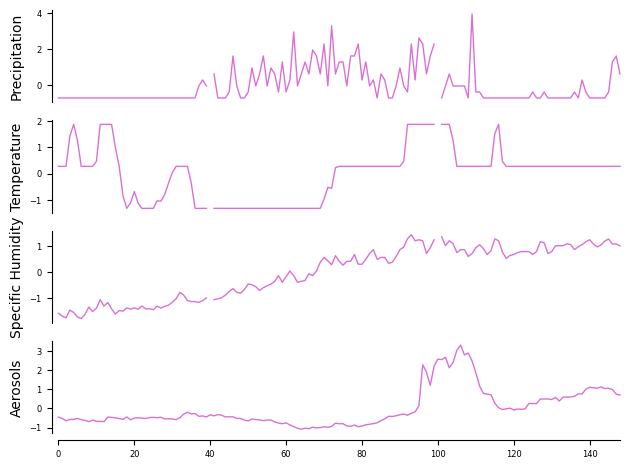

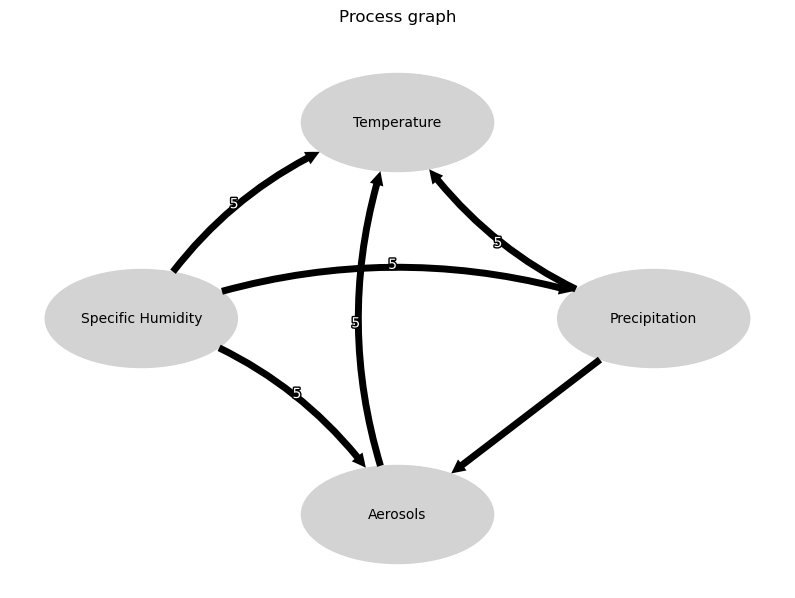

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


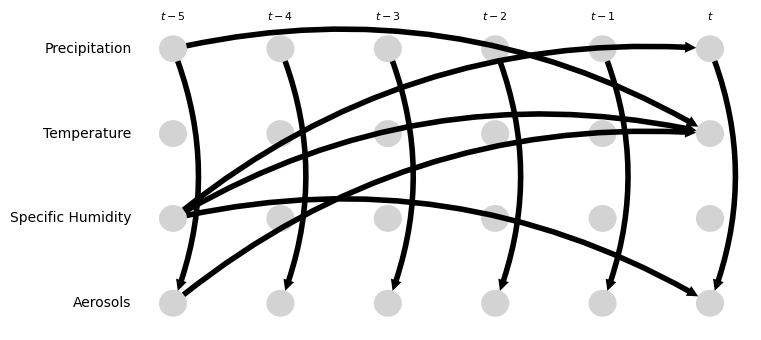

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.15 [-0.27, -0.02]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.14, 0.06]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.52 [0.32, 0.71]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.66 [0.56, 0.76]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.18 [0.06, 0.35]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [-0.03, 0.20]
Negative precipitation values in event 60: 0


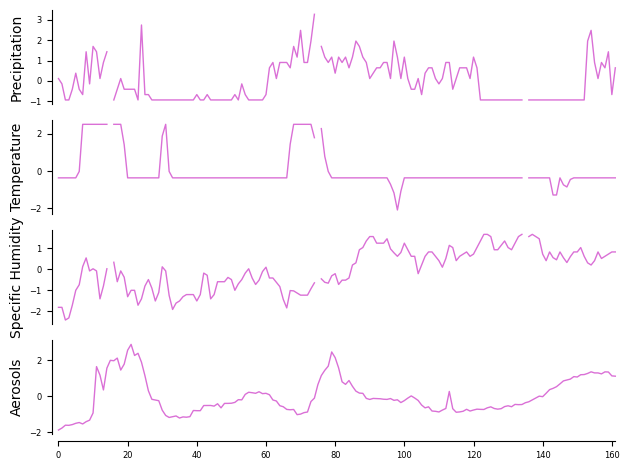

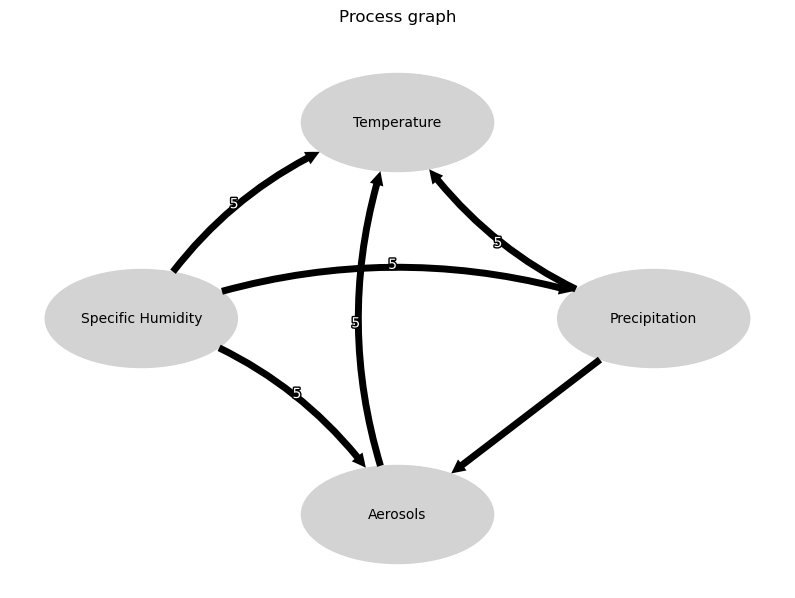

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


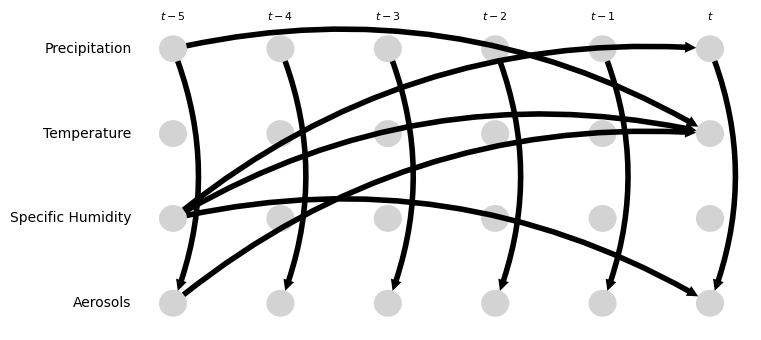

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.15 [0.06, 0.24]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.25 [0.15, 0.39]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.39 [-0.50, -0.27]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.10, 0.14]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.08 [-0.26, 0.07]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-0.35, -0.11]
Negative precipitation values in event 61: 0


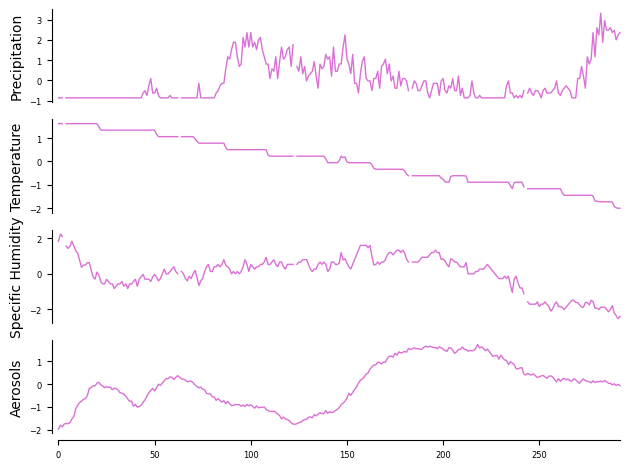

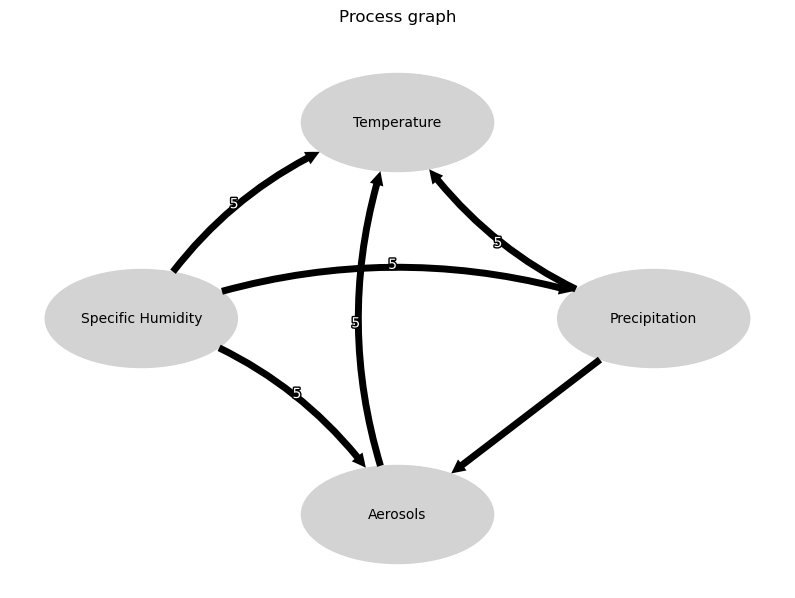

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


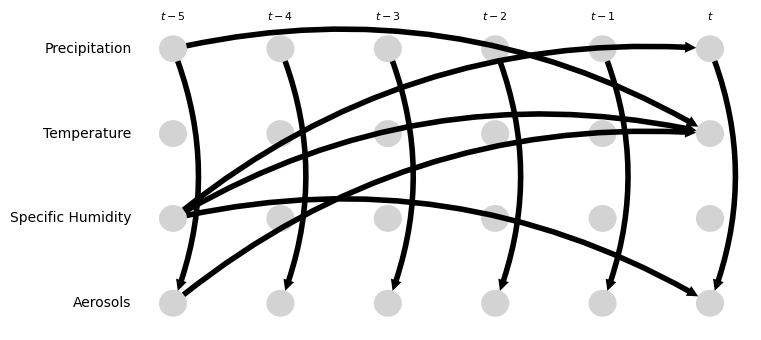

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.34 [-0.42, -0.27]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.50 [-0.56, -0.44]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.41 [0.36, 0.46]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.04 [-0.04, 0.13]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.10 [-0.20, 0.02]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.69 [-0.76, -0.62]
Negative precipitation values in event 62: 0


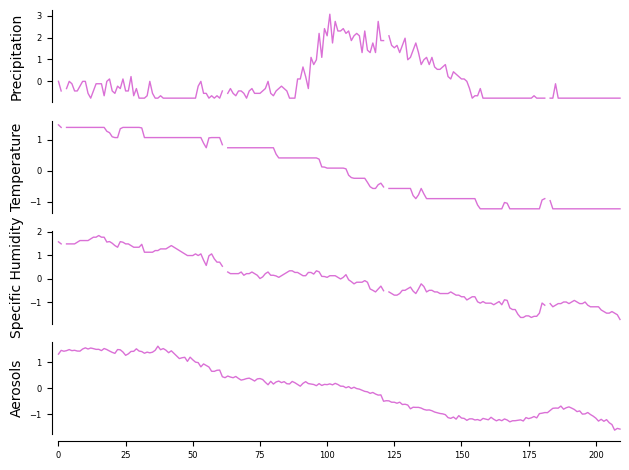

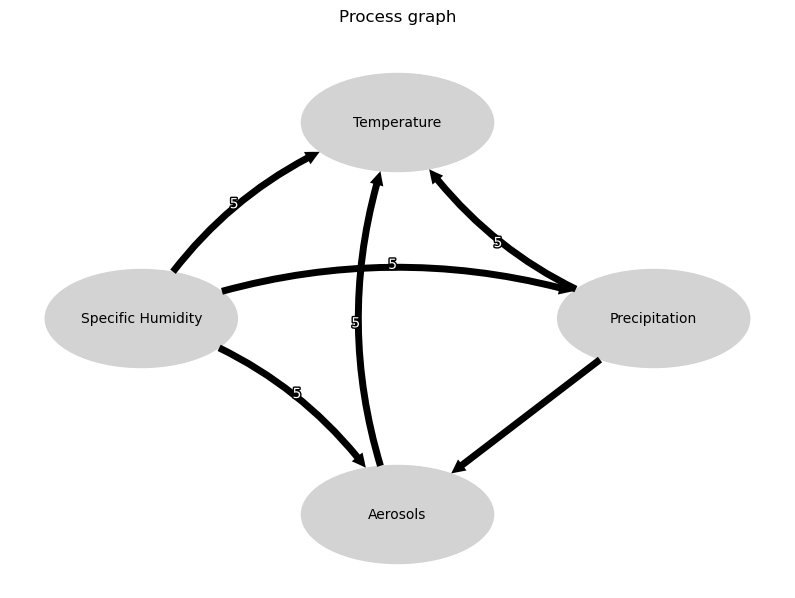

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


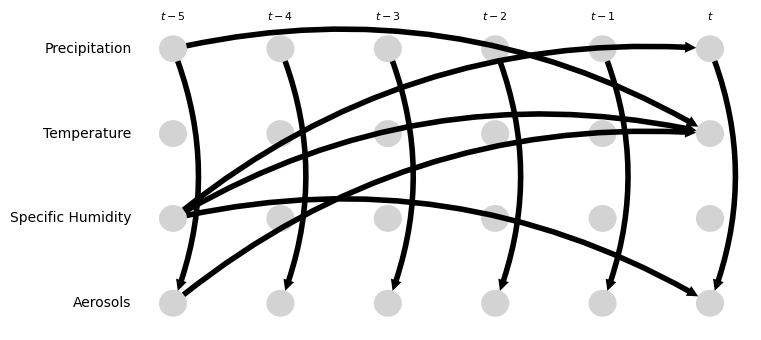

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.07, -0.02]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.06 [-0.07, -0.04]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.28 [0.17, 0.39]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.97 [0.94, 1.00]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.08, 0.05]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.70 [0.60, 0.81]
Negative precipitation values in event 63: 0


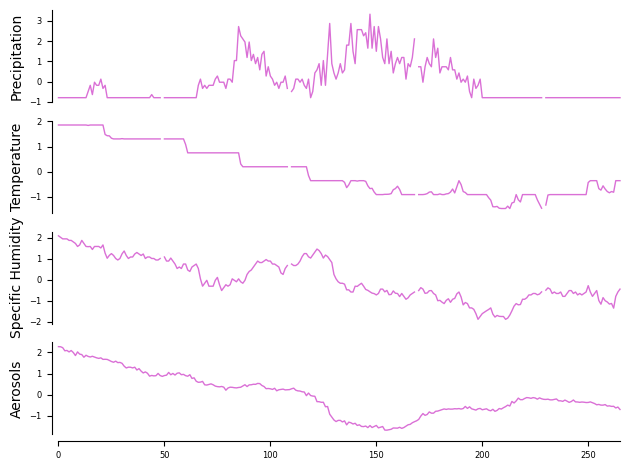

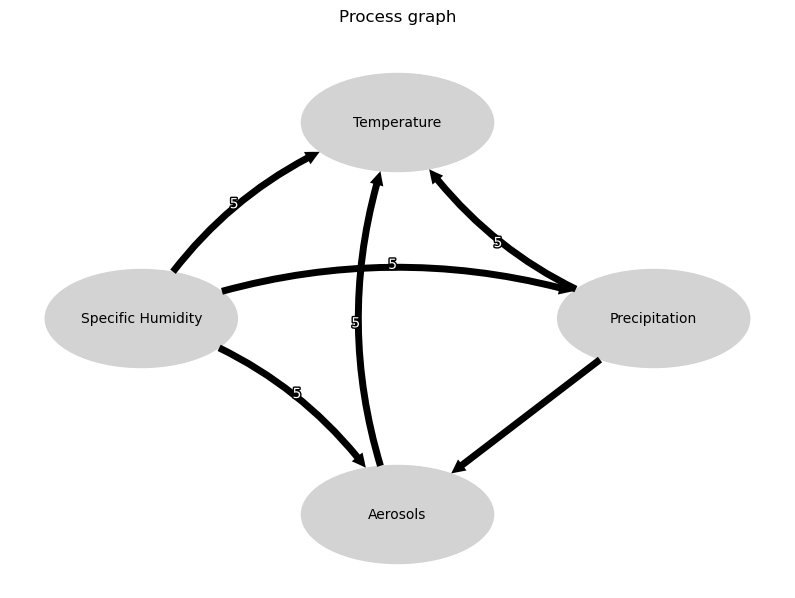

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


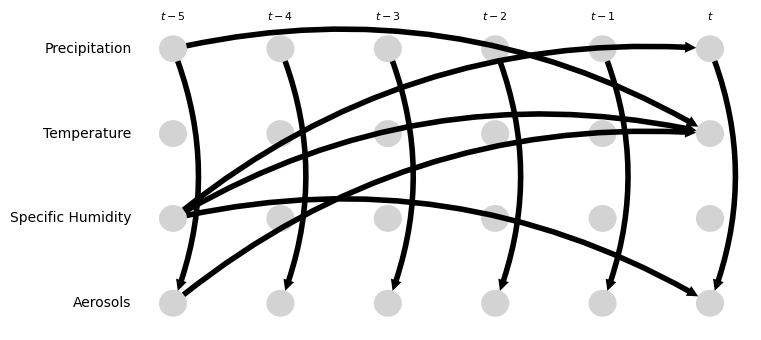

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.43 [-0.50, -0.36]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.15 [0.11, 0.22]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.29 [0.20, 0.38]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.62 [0.57, 0.68]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.06 [-0.14, -0.00]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.73 [0.65, 0.82]
Negative precipitation values in event 64: 0


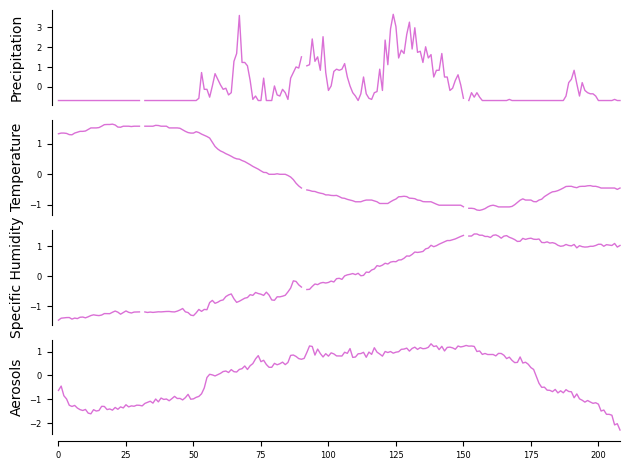

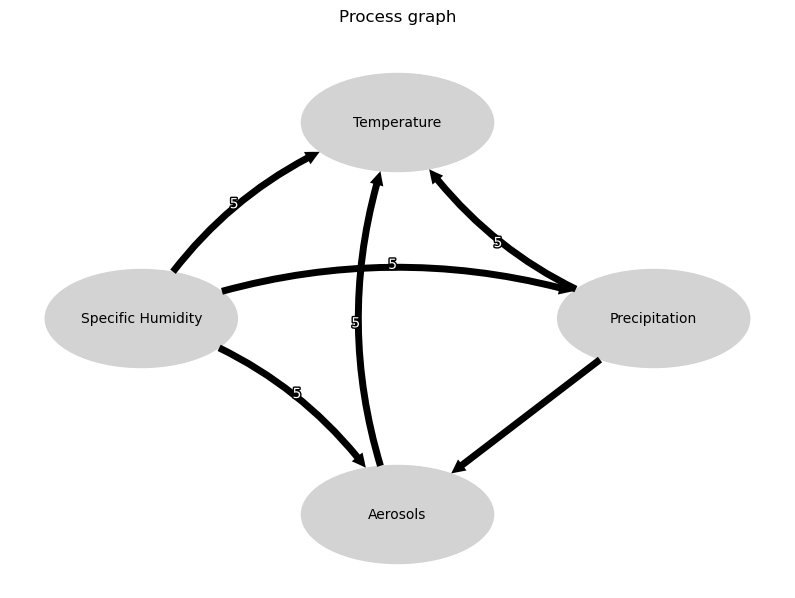

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


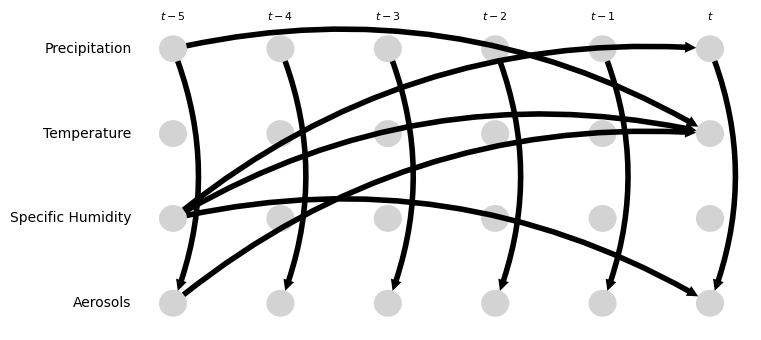

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.49 [0.40, 0.56]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.08, -0.01]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.60 [-0.62, -0.55]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.31 [0.22, 0.40]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.06 [-0.02, 0.16]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.49 [-0.55, -0.45]
Negative precipitation values in event 65: 0


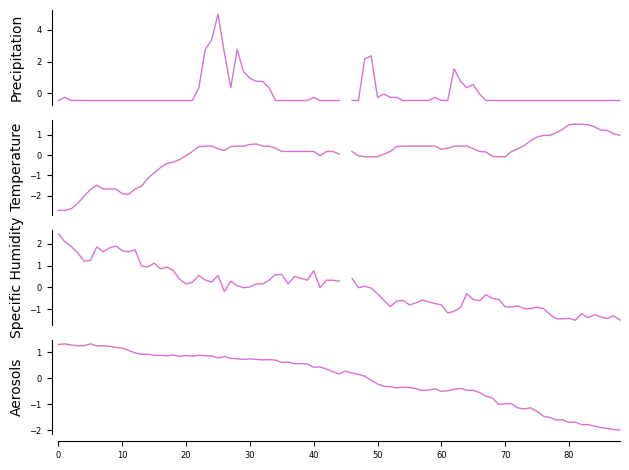

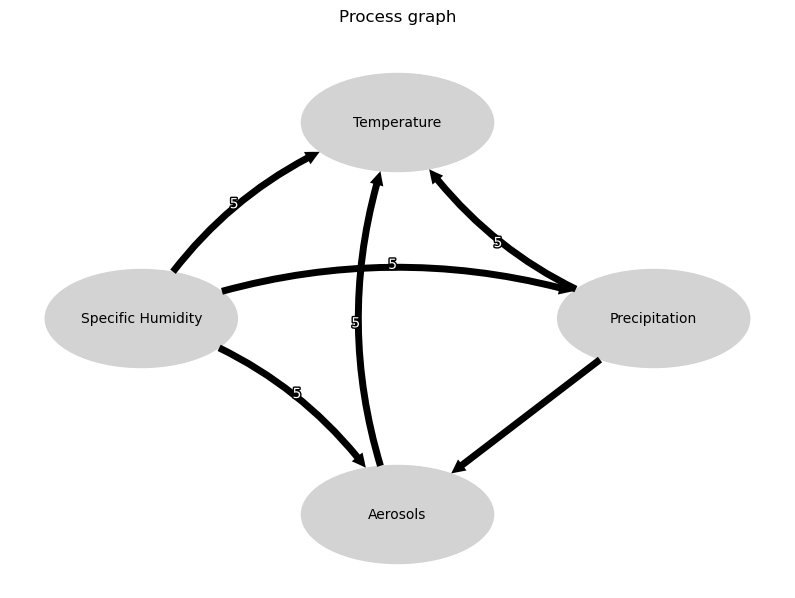

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


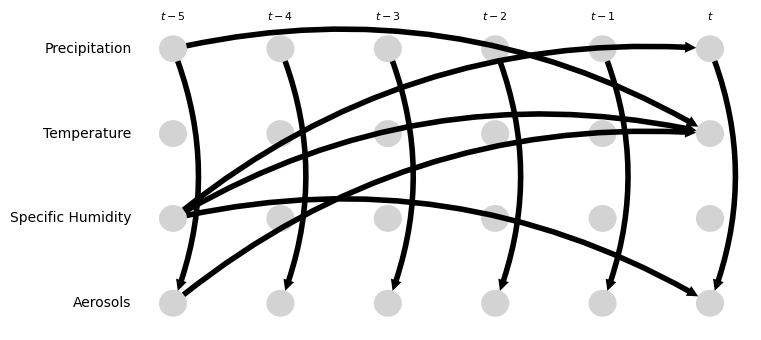

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.20 [0.15, 0.27]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.09 [0.01, 0.15]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.47 [-0.67, -0.15]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.92 [0.82, 1.03]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.14 [0.02, 0.38]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.18 [-0.44, 0.01]
Negative precipitation values in event 66: 0


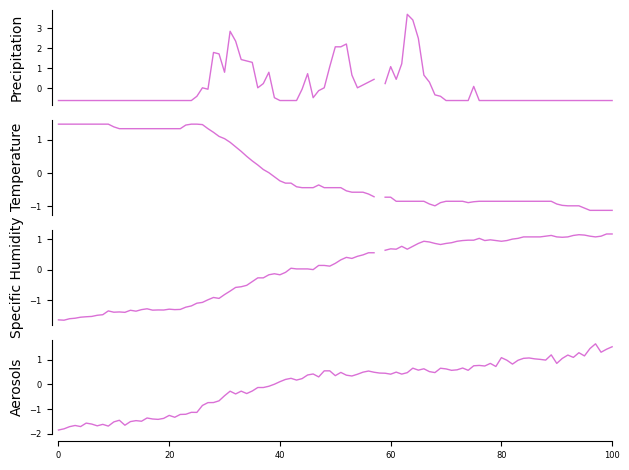

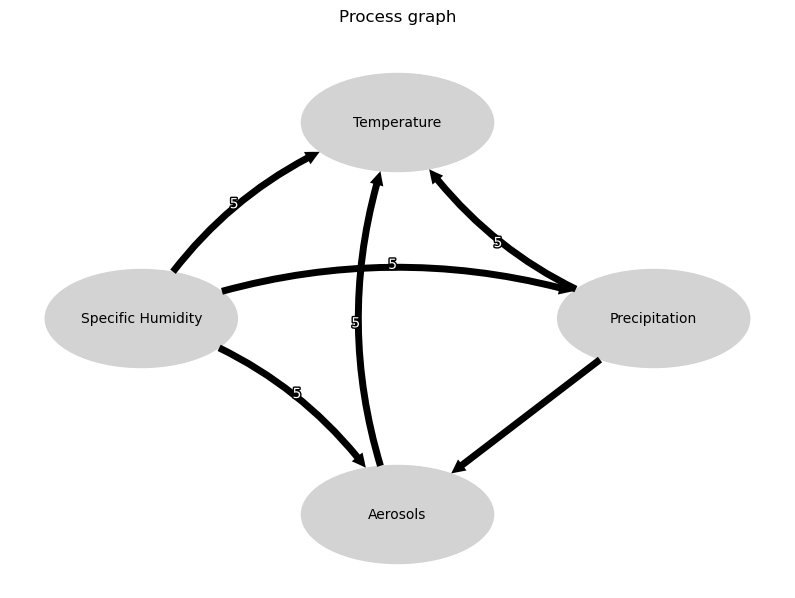

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


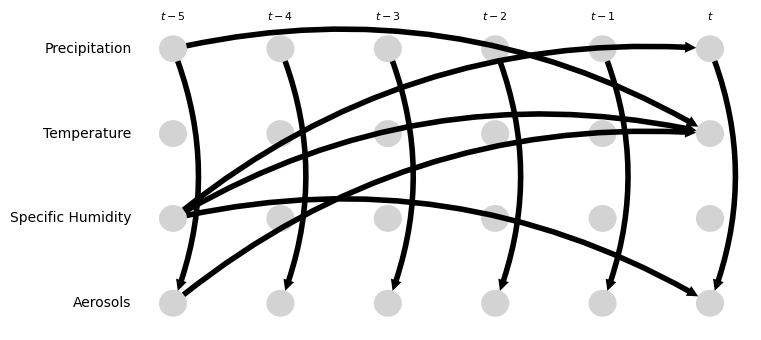

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.11 [0.06, 0.17]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-0.12, -0.06]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.34 [-0.45, -0.21]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.90 [0.85, 0.94]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.16 [-0.35, -0.01]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.63 [-0.76, -0.51]
Negative precipitation values in event 67: 0


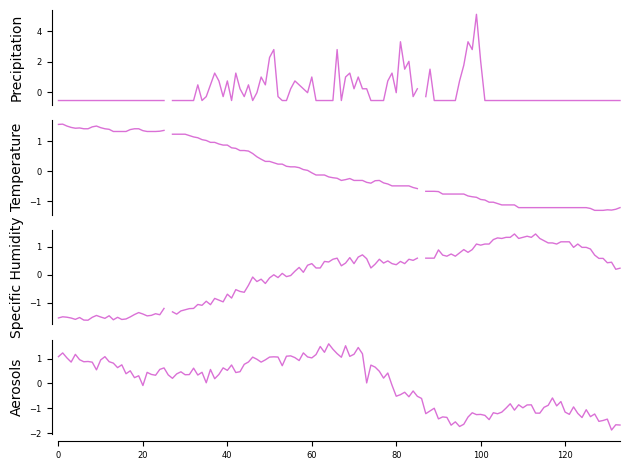

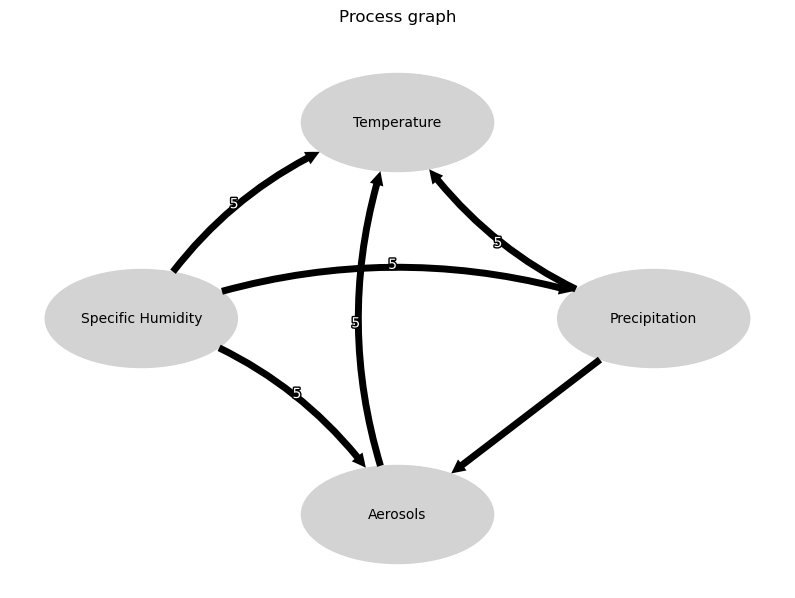

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


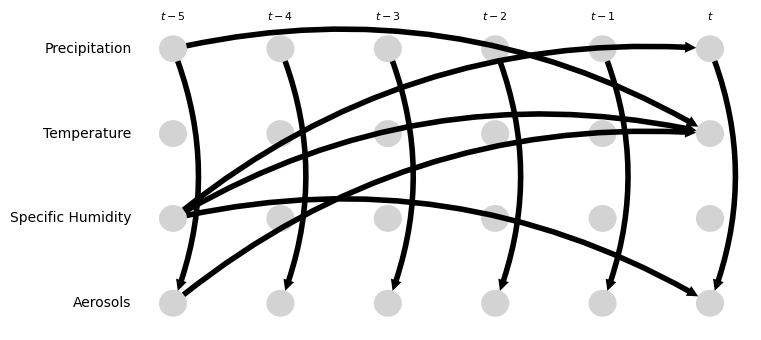

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [-0.06, 0.24]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.00 [-0.02, 0.02]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.87 [-0.89, -0.85]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.64 [-0.72, -0.57]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-0.06, 0.17]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.12 [0.09, 0.14]
Negative precipitation values in event 68: 0


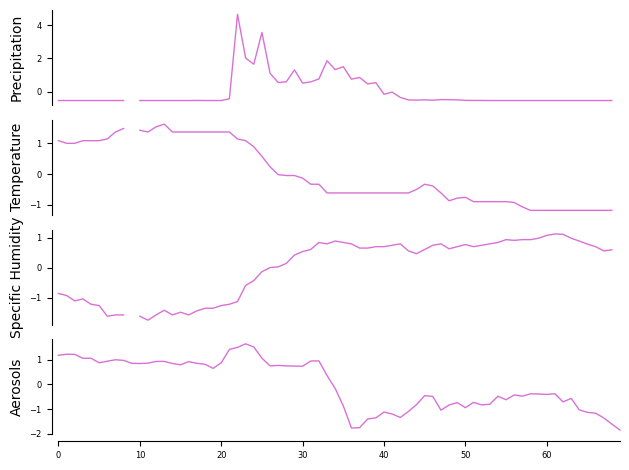

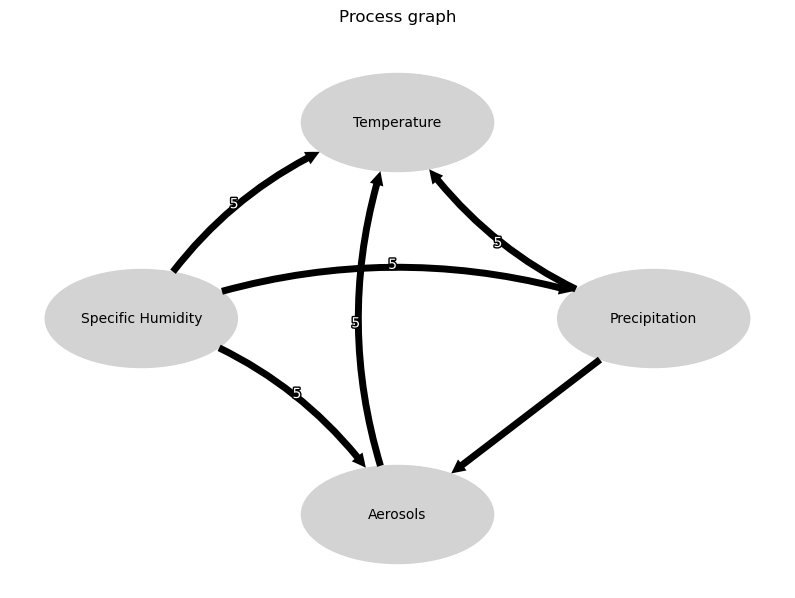

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


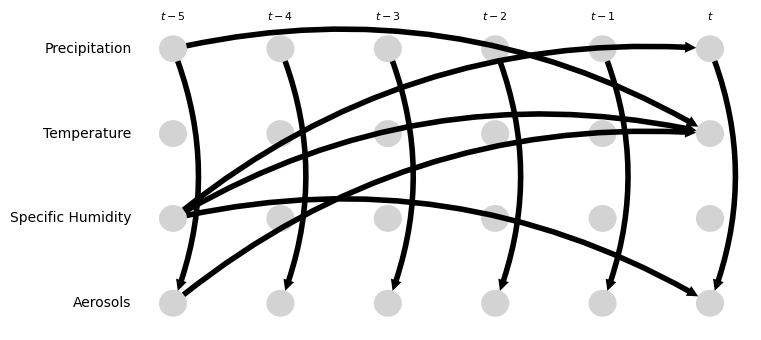

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.10 [0.02, 0.18]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.08, 0.11]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.98 [-1.08, -0.90]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.80 [-0.90, -0.73]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.30 [-0.61, -0.07]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.12 [-0.22, -0.03]
Negative precipitation values in event 69: 0


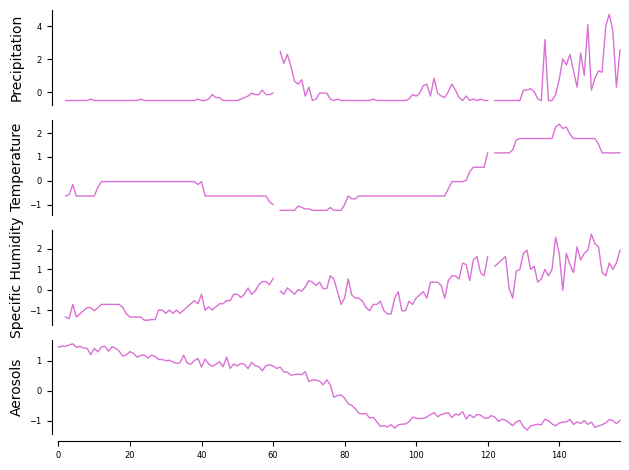

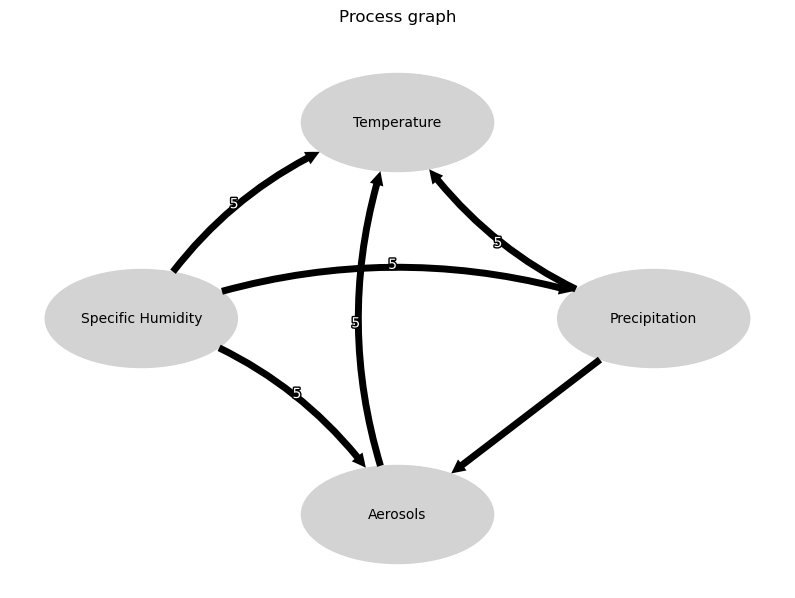

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


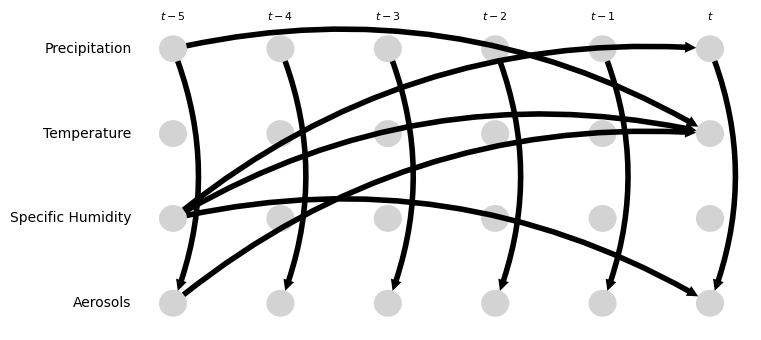

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [0.01, 0.18]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.06 [-0.25, 0.13]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.49 [0.33, 0.60]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.65 [-0.75, -0.54]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.57 [0.42, 0.77]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.25 [-0.40, -0.14]
Negative precipitation values in event 70: 0


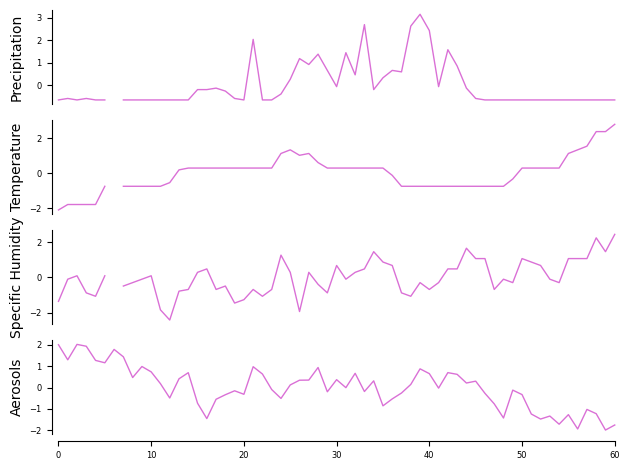

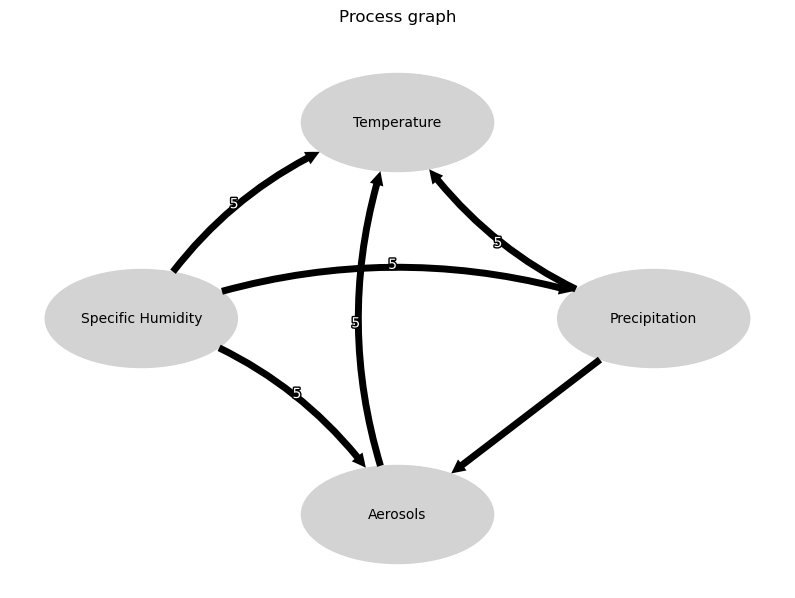

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


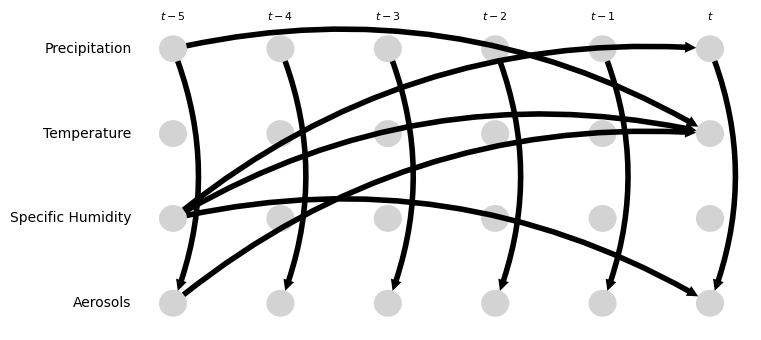

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.33 [0.19, 0.43]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.29 [-0.40, -0.17]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.15 [-0.33, -0.07]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.12 [-0.28, 0.04]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.21, 0.38]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.49 [-0.65, -0.09]
Negative precipitation values in event 71: 0


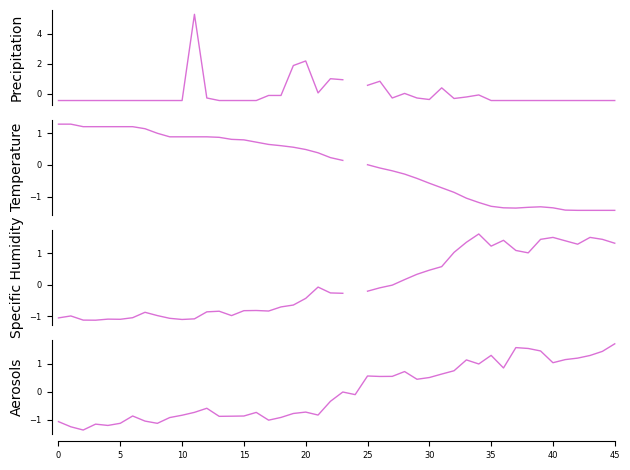

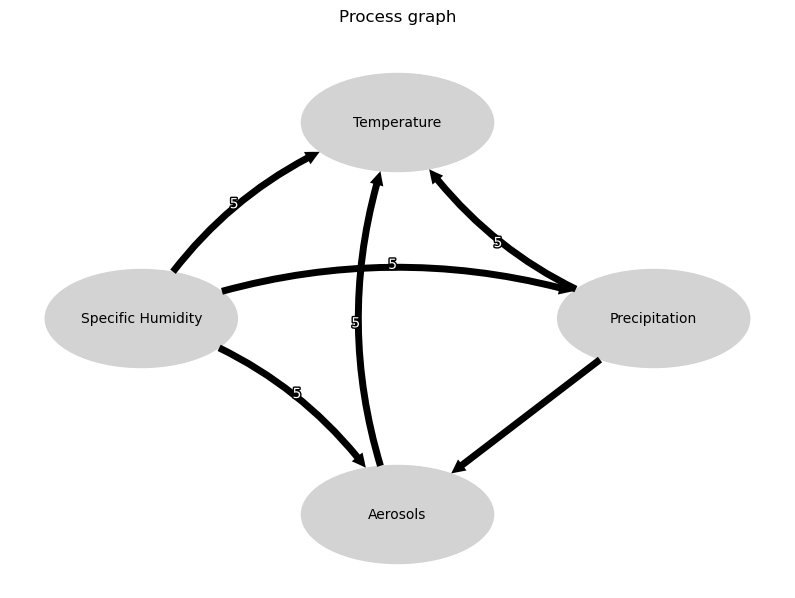

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


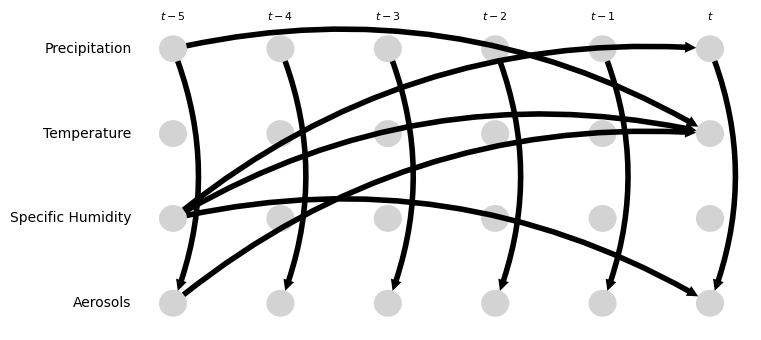

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.04 [0.00, 0.15]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.02 [-0.26, 0.01]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.47 [-0.67, -0.33]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.94 [0.85, 1.05]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.47 [-0.83, -0.20]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.50 [-0.67, -0.31]
Negative precipitation values in event 72: 0


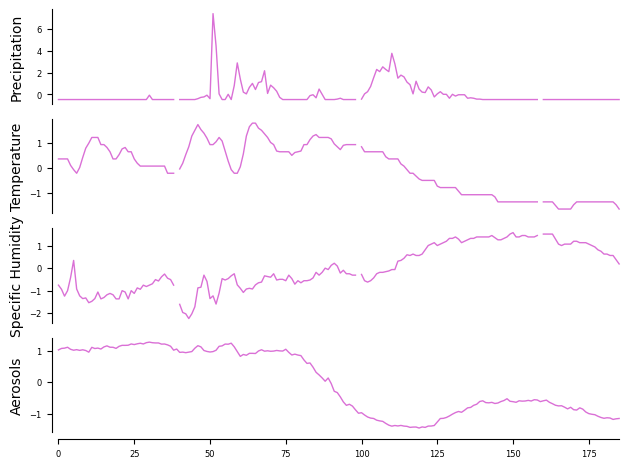

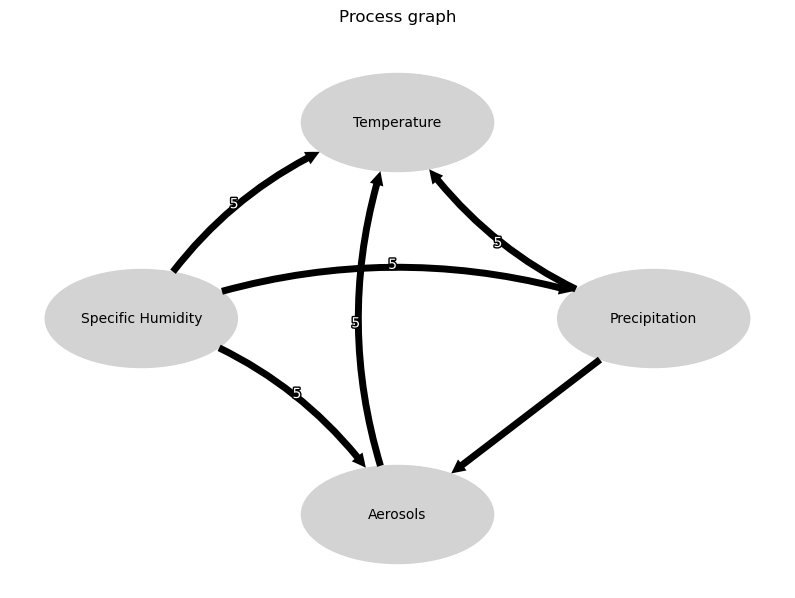

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


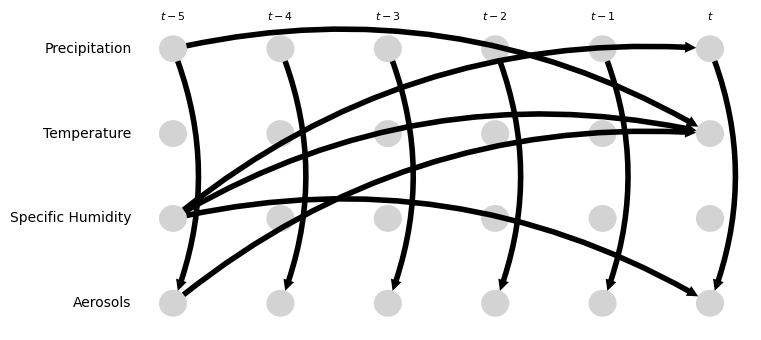

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.25 [-0.50, -0.11]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.05, 0.21]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.83 [-0.93, -0.70]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.79 [-0.82, -0.75]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.19 [-0.35, -0.11]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.04 [-0.06, 0.18]
Negative precipitation values in event 73: 0


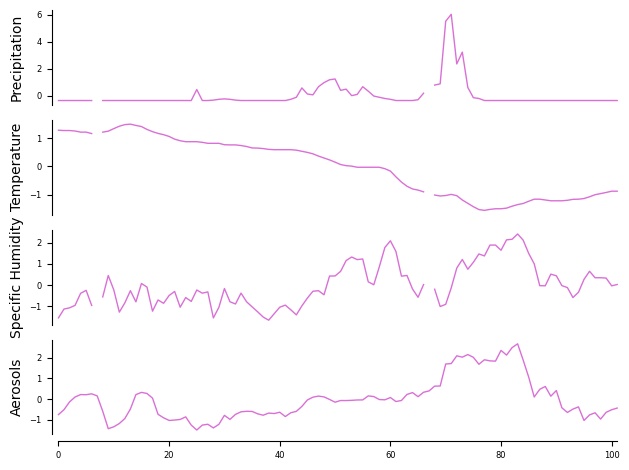

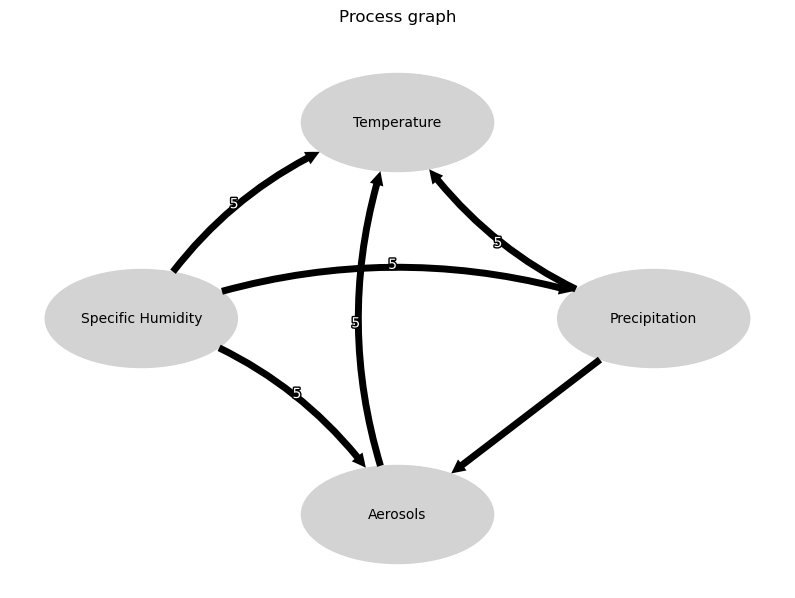

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


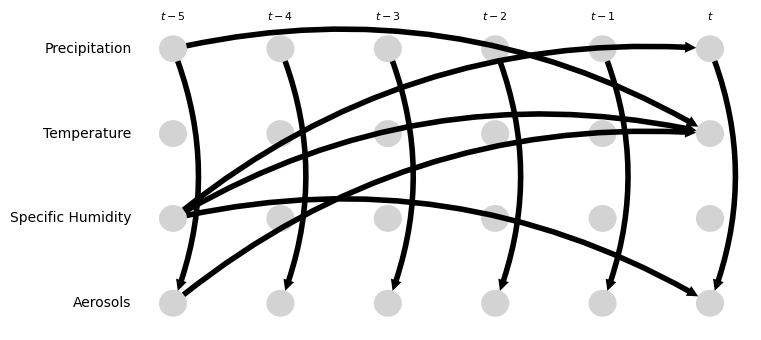

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.39 [0.31, 0.56]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.13 [-0.19, -0.05]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.28 [-0.43, -0.14]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.50 [0.37, 0.67]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.13 [-0.23, -0.07]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.44 [-0.62, -0.32]
Negative precipitation values in event 74: 0


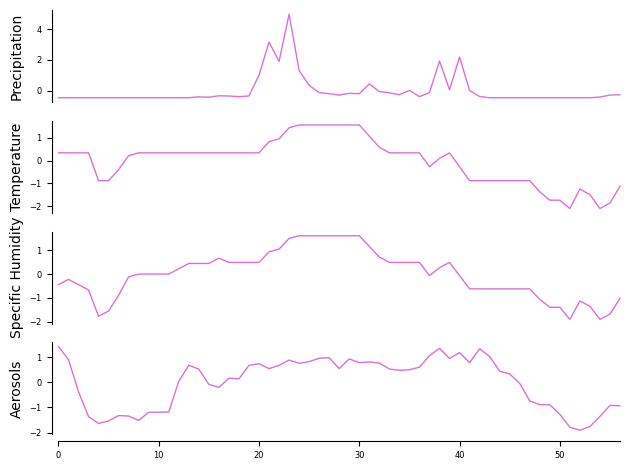

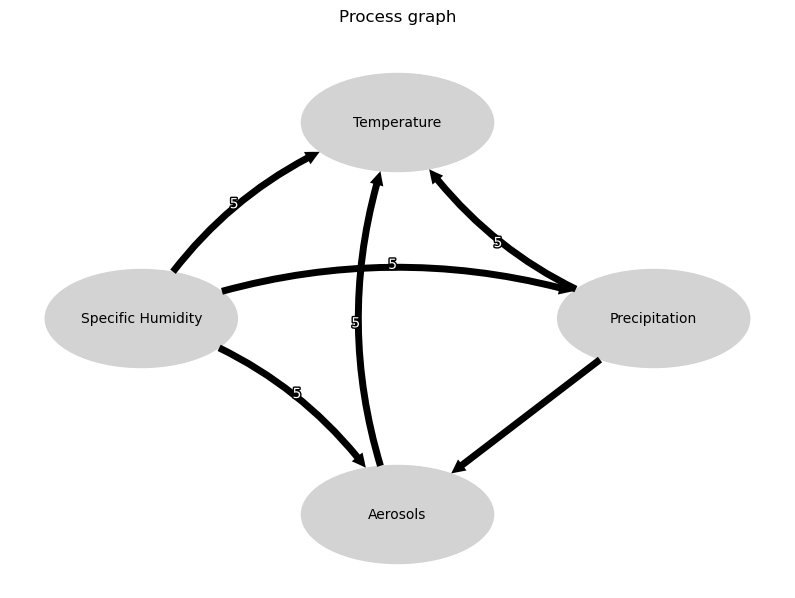

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


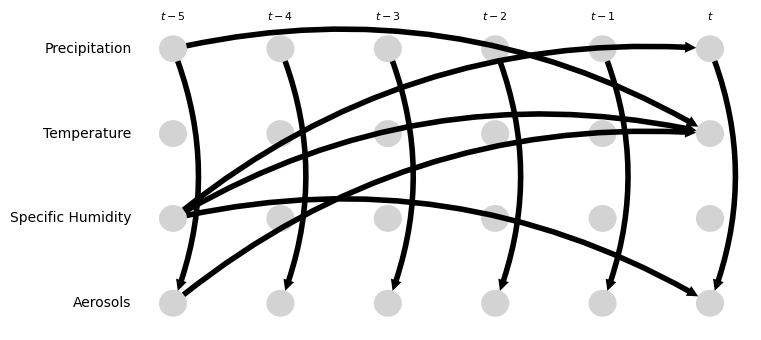

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.21 [0.12, 0.40]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.21 [0.08, 0.42]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.06 [0.89, 1.28]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.70 [0.57, 0.86]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.26 [0.16, 0.44]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.57 [-0.82, -0.41]
Negative precipitation values in event 75: 0


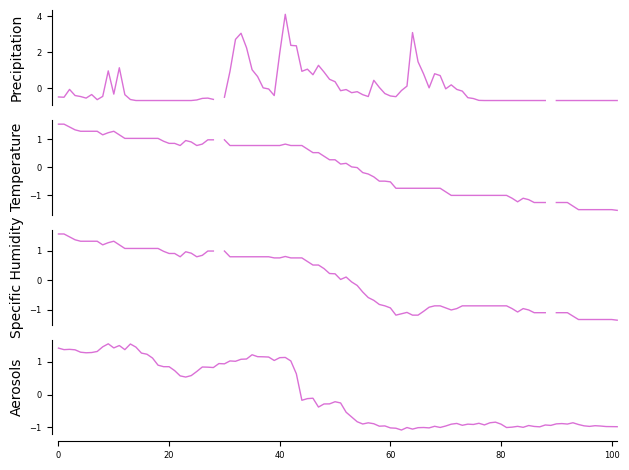

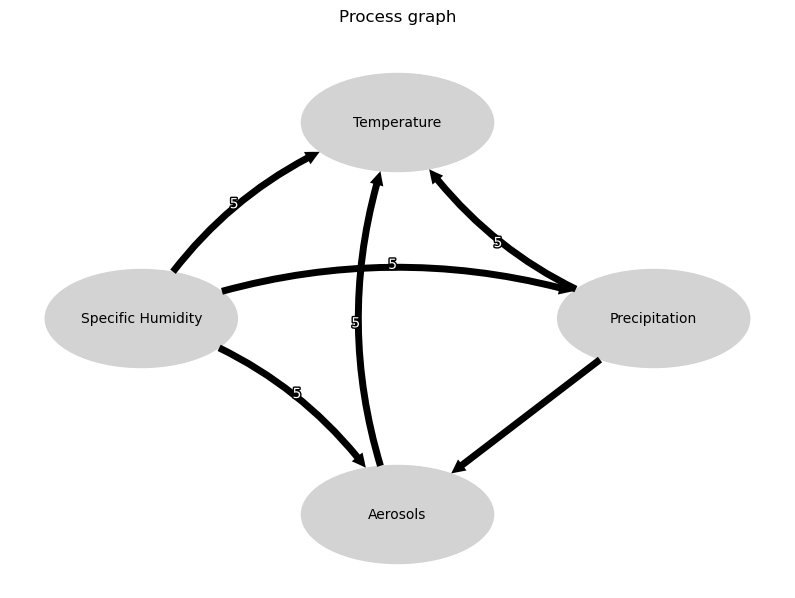

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


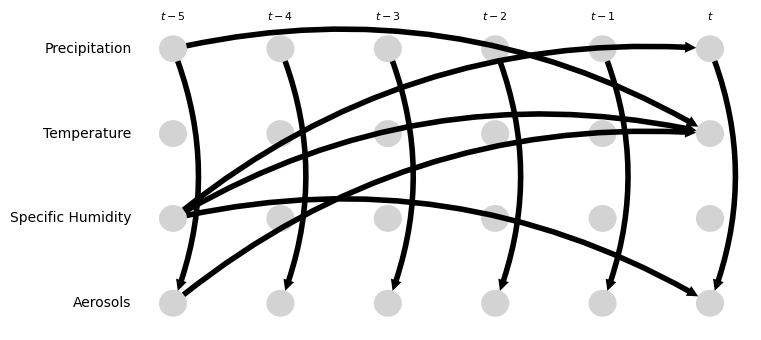

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.07, 0.07]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.01, 0.08]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.76 [0.66, 0.85]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.88 [0.83, 0.93]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.27 [0.11, 0.45]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.21 [0.14, 0.28]
Negative precipitation values in event 76: 0


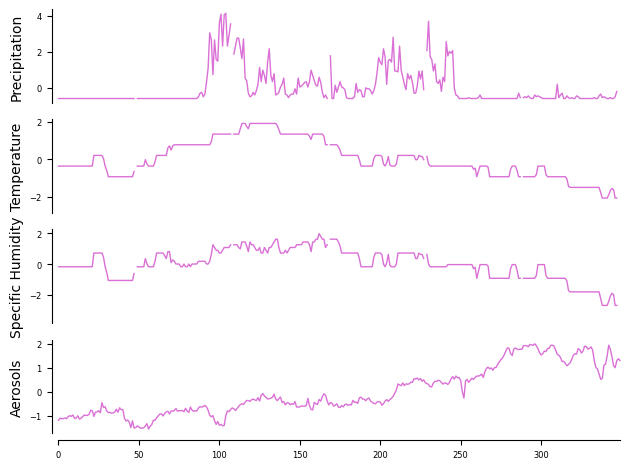

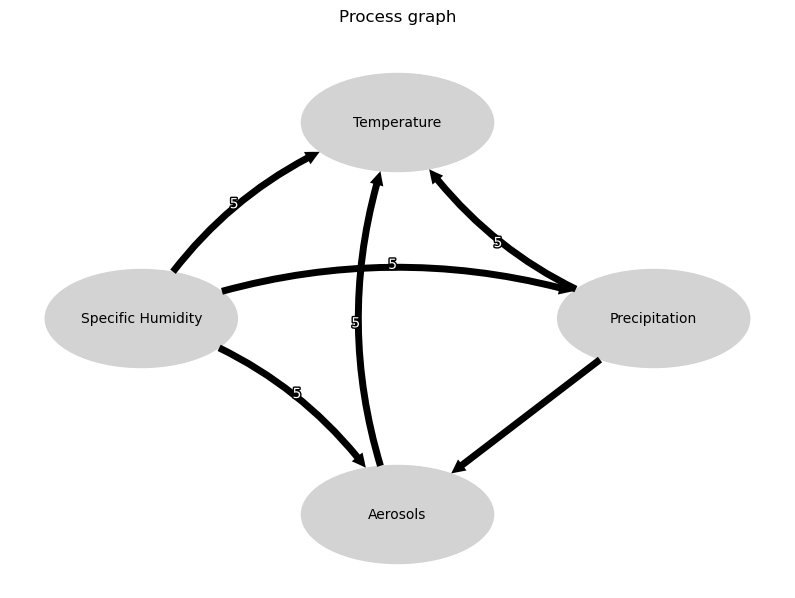

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


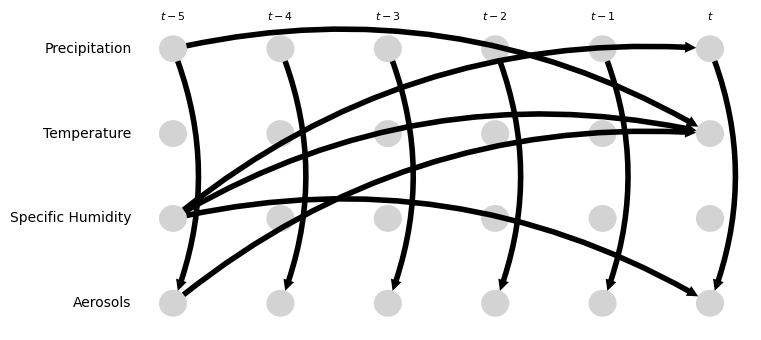

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.09, 0.04]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.13 [0.08, 0.18]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.69 [0.63, 0.74]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.53 [-0.60, -0.46]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.38 [0.32, 0.45]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.25, -0.16]
Negative precipitation values in event 77: 0


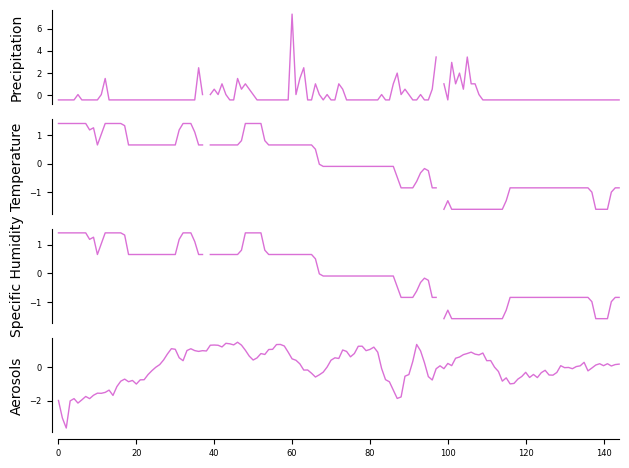

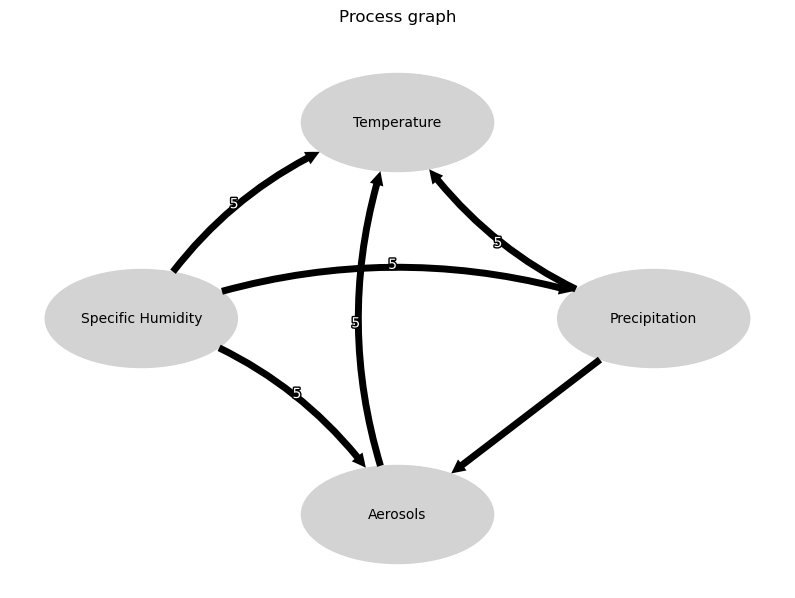

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


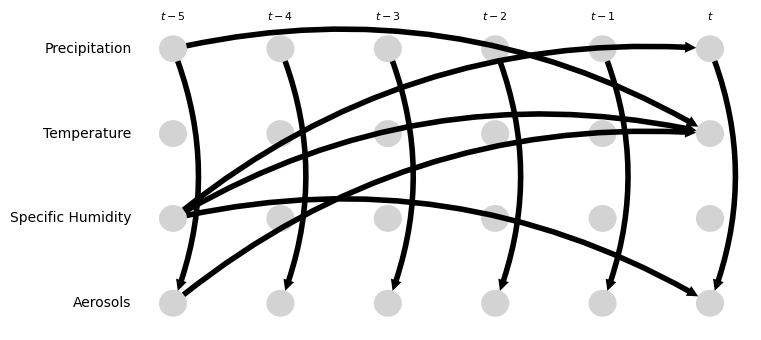

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.06 [-0.07, 0.14]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.11, 0.01]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.87 [0.80, 0.94]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [-0.05, 0.23]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.04 [-0.11, 0.16]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.09 [0.00, 0.16]
Negative precipitation values in event 78: 0


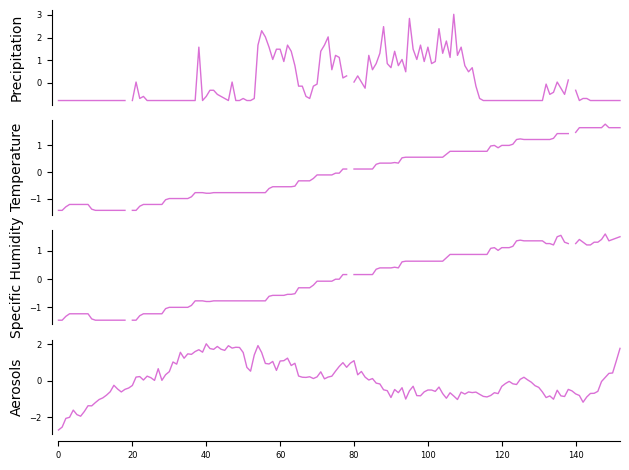

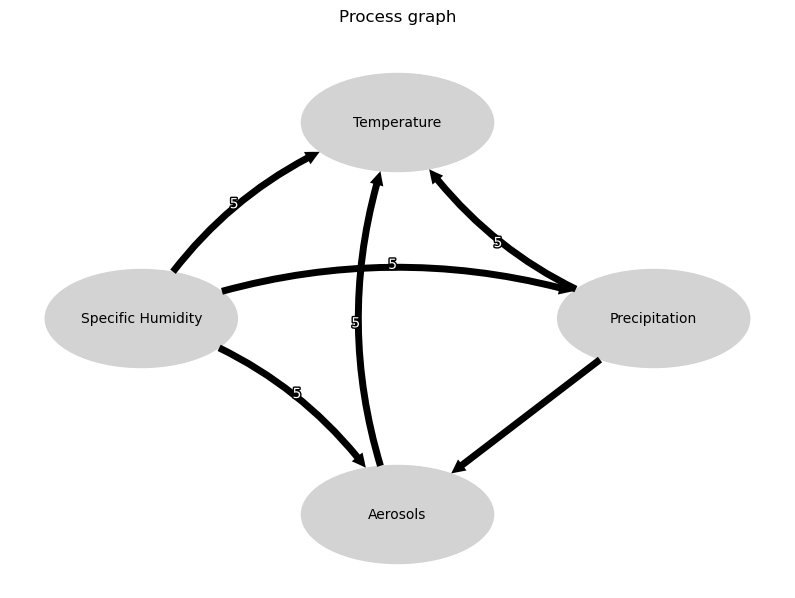

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


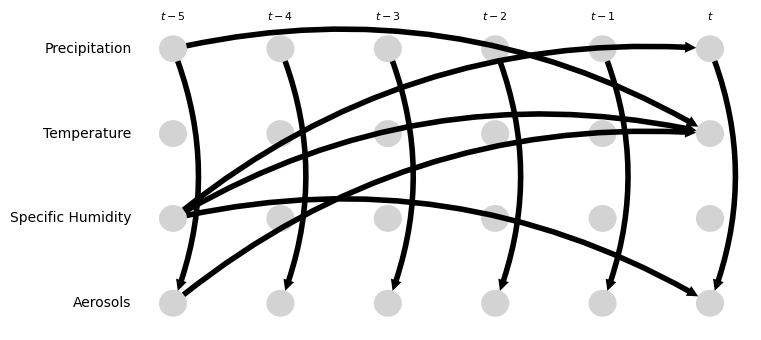

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.10, 0.13]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.03, 0.01]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.01 [0.98, 1.03]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.47 [-0.64, -0.41]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.06 [-0.09, 0.19]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.01, 0.04]
Negative precipitation values in event 79: 0


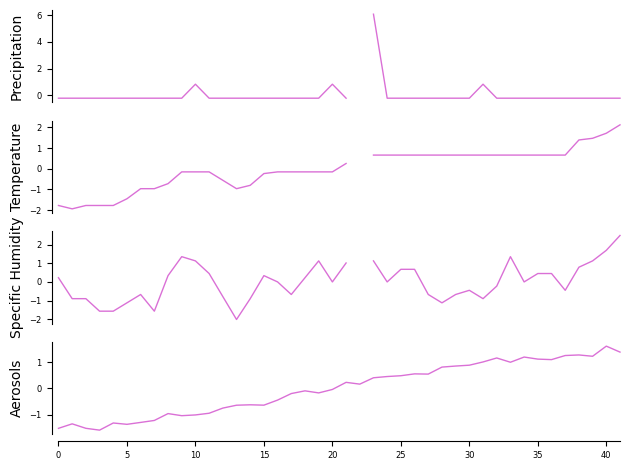

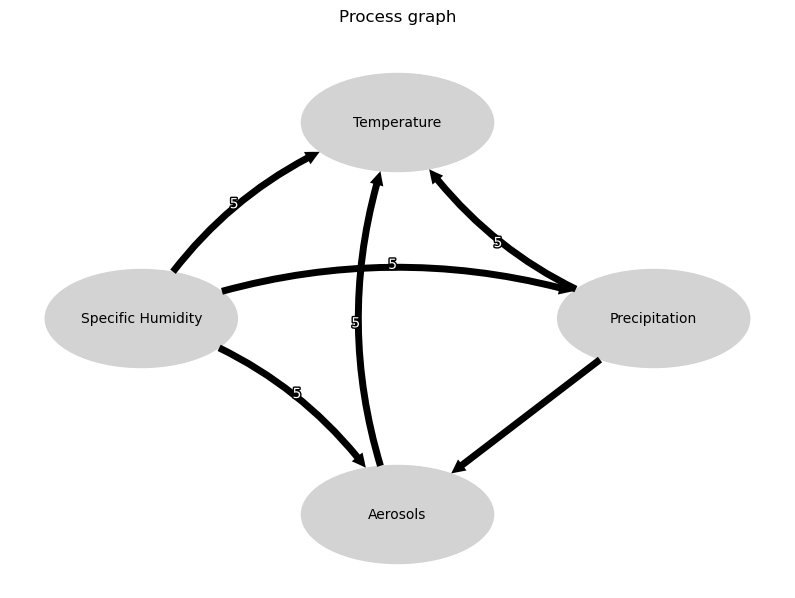

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


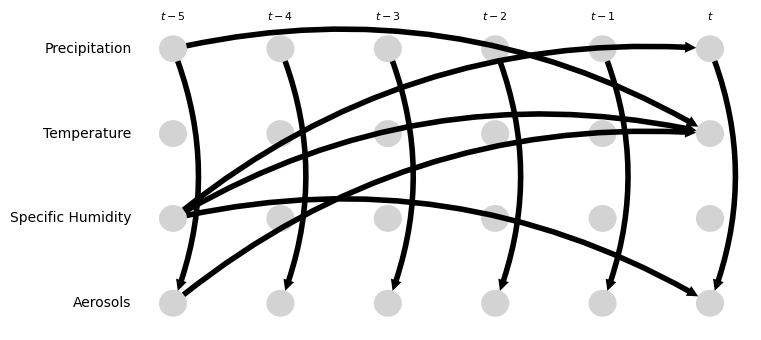

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.00 [-0.70, 0.29]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.02 [-0.18, 0.20]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.09 [-0.03, 0.18]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [-0.14, 0.37]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.06 [-0.08, 0.27]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.69 [0.51, 0.76]
Negative precipitation values in event 80: 0


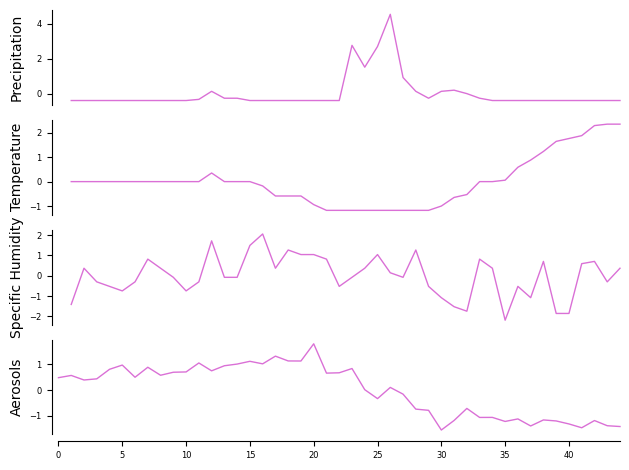

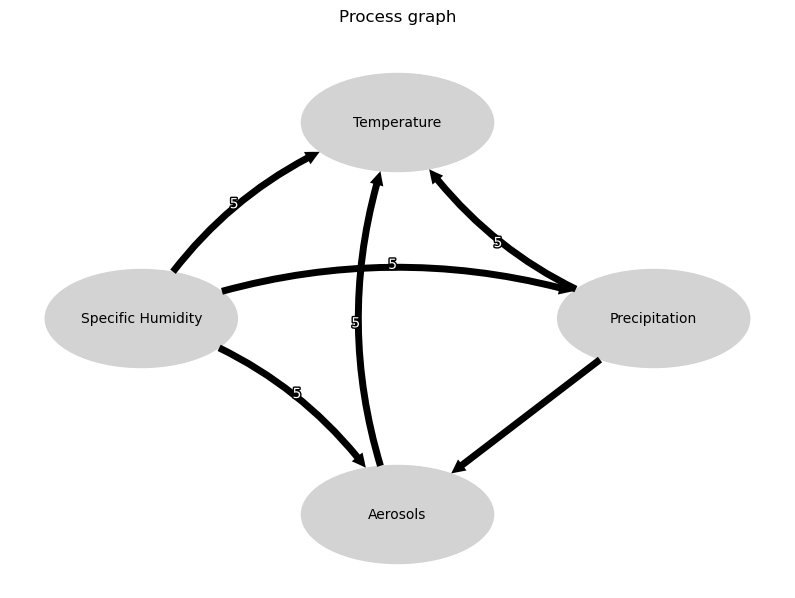

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


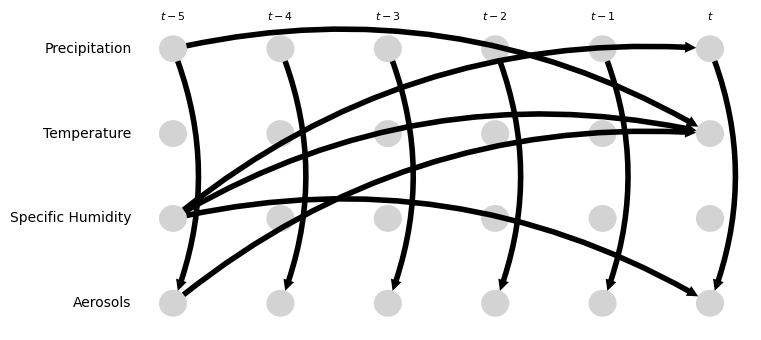

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.33, 0.10]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.32 [-0.64, -0.21]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.16 [-0.29, 0.05]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.41 [0.10, 0.62]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.35 [0.11, 0.64]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.82 [-1.02, -0.53]
Negative precipitation values in event 81: 0


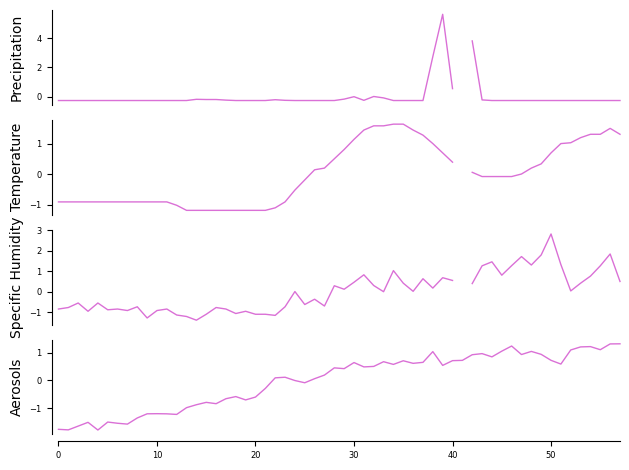

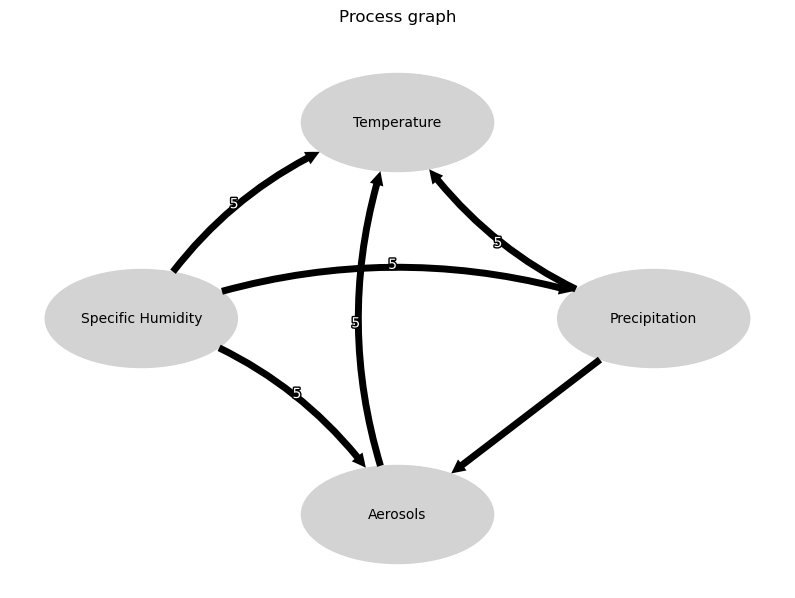

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


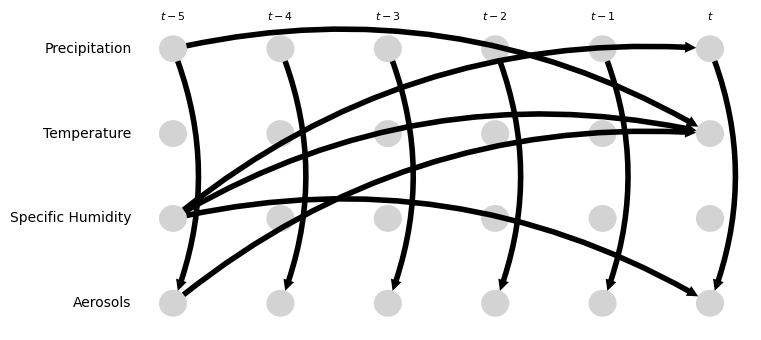

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-0.03, 0.38]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.24 [-0.64, -0.17]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.28, 0.15]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.57 [0.45, 0.73]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.18 [-0.01, 0.45]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.97 [0.81, 1.33]
Negative precipitation values in event 82: 0


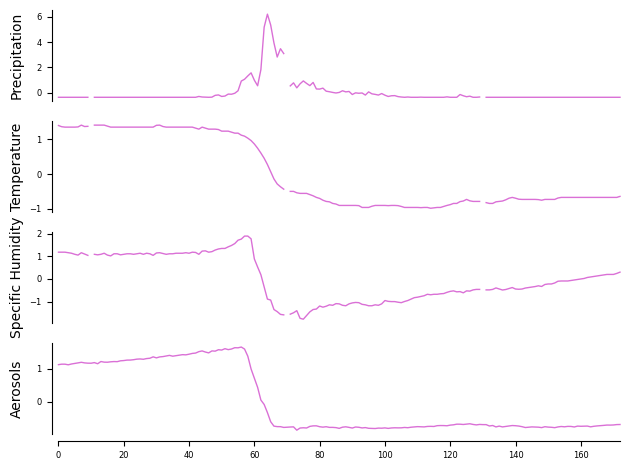

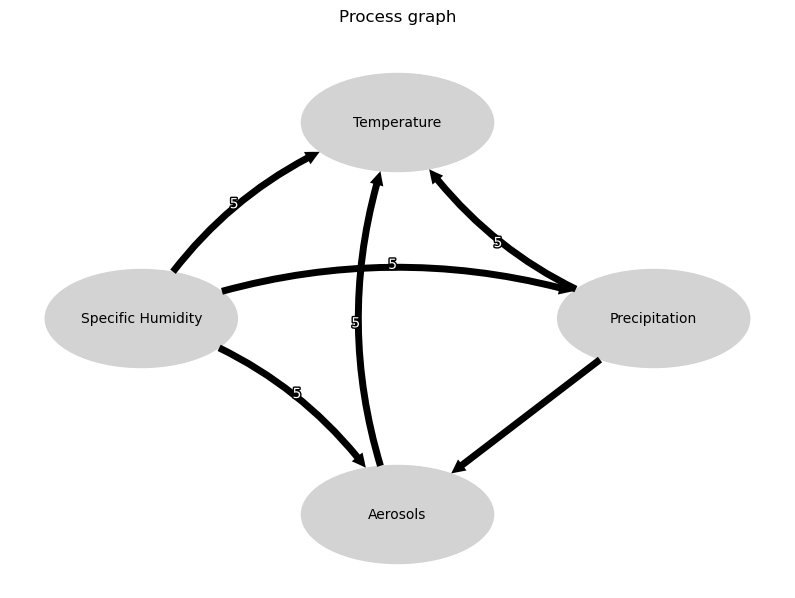

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


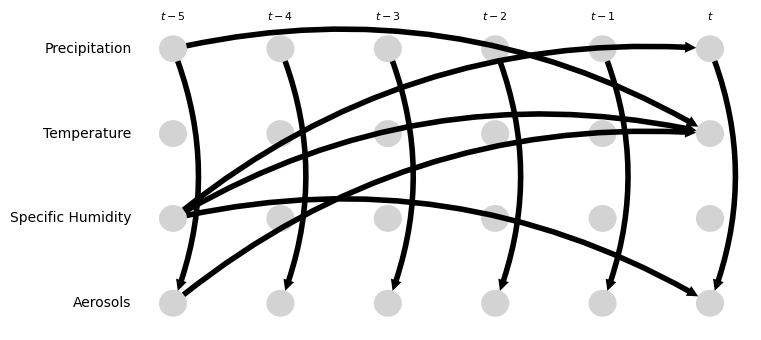

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.26, -0.10]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.11, 0.00]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.15, 0.02]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.87 [0.81, 0.93]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [0.00, 0.35]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.99 [0.92, 1.07]
Negative precipitation values in event 83: 0


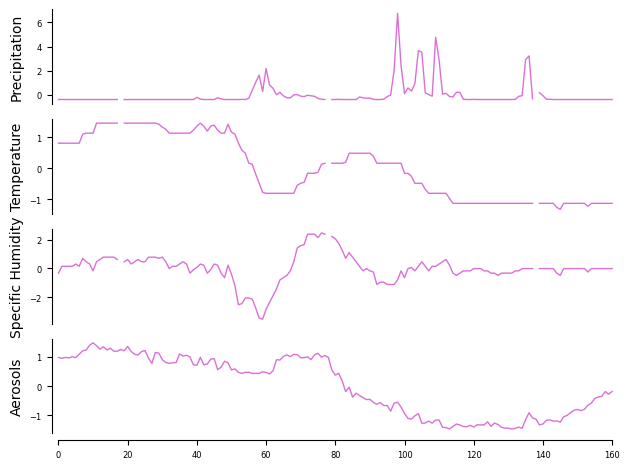

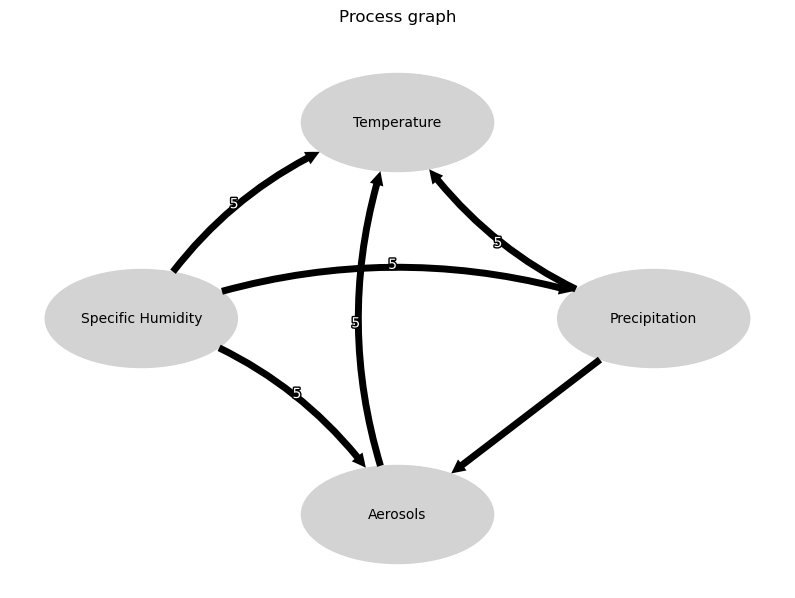

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


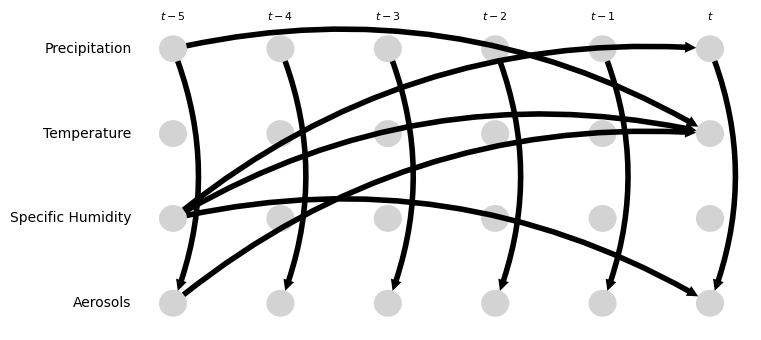

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.31, -0.12]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.15, -0.03]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [0.12, 0.28]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.08, 0.15]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.28 [-0.43, -0.18]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.77 [0.70, 0.84]
Negative precipitation values in event 84: 0


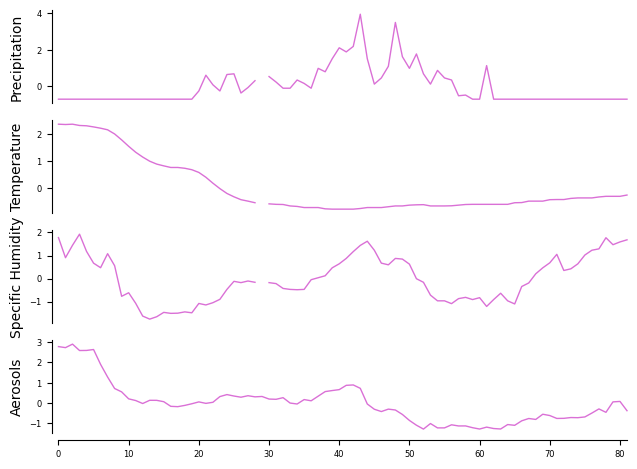

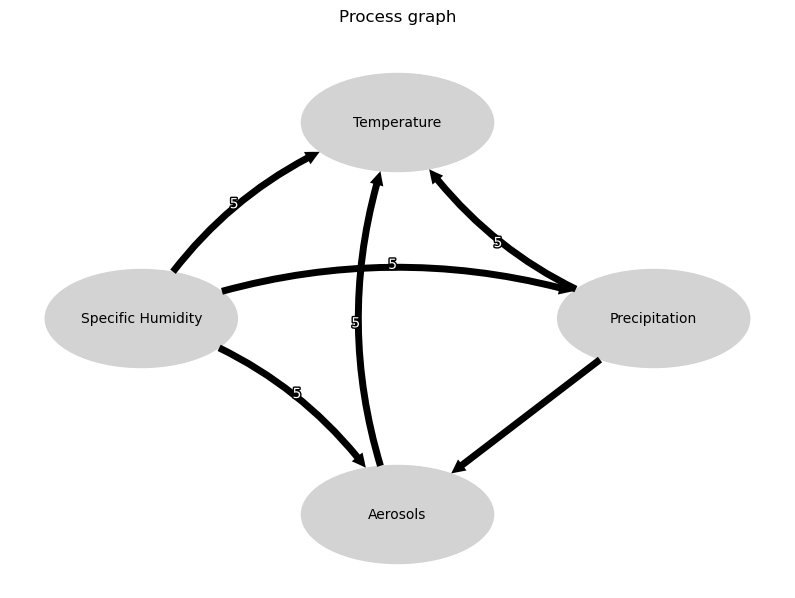

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


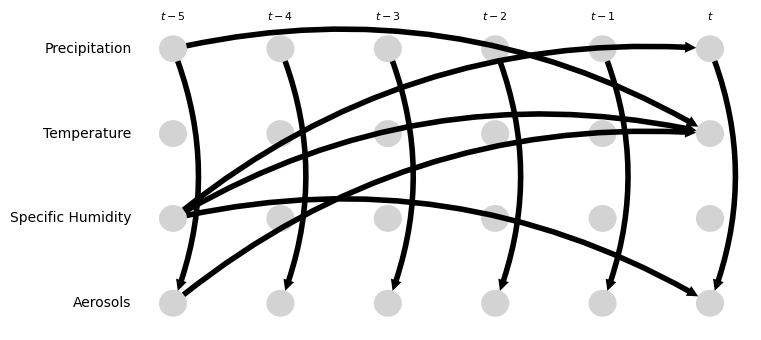

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [-0.04, 0.20]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.29 [-0.40, -0.18]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.08 [-0.18, 0.01]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.15 [-0.28, -0.06]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.32 [0.15, 0.61]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.44 [0.27, 0.51]
Negative precipitation values in event 85: 0


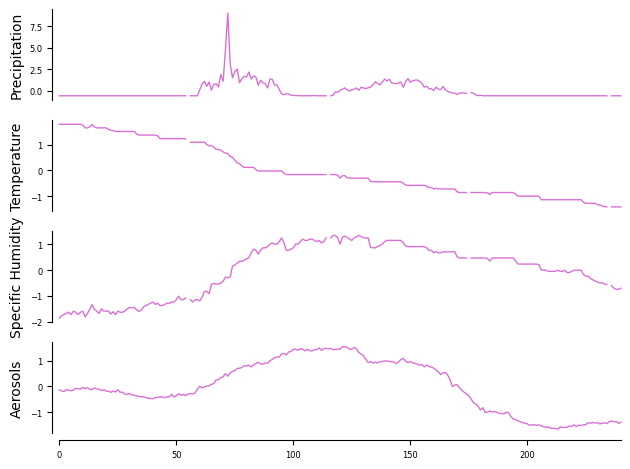

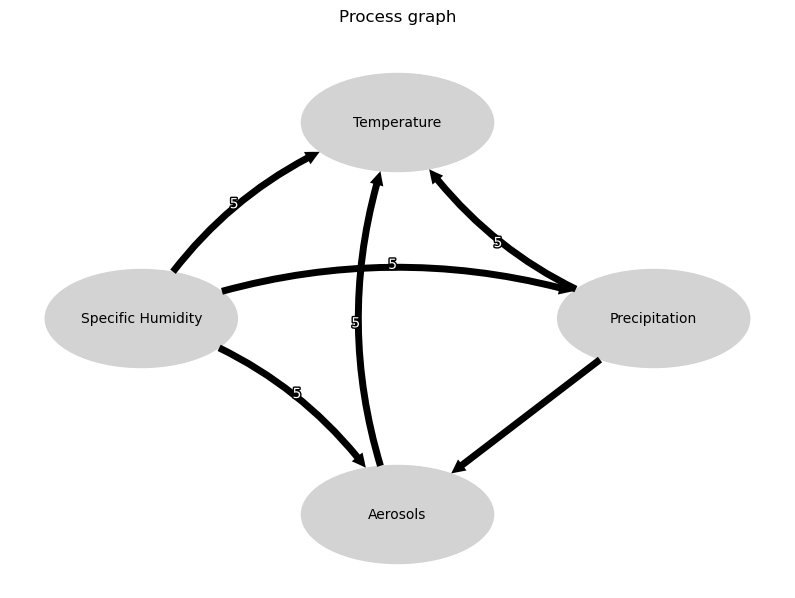

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


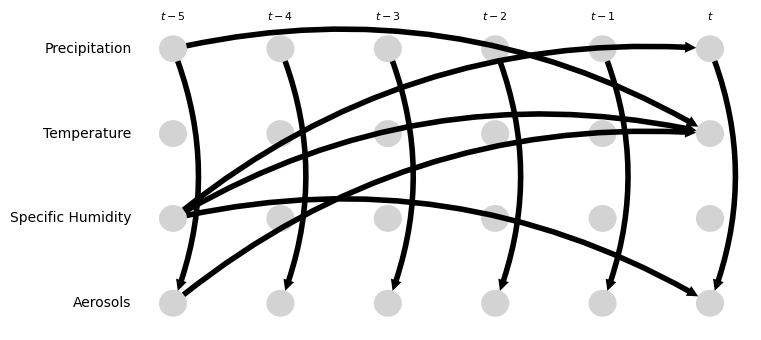

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.34 [0.24, 0.57]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.05 [-0.08, -0.04]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.04 [-1.06, -1.02]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.41 [0.31, 0.50]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.18 [0.11, 0.27]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.72 [0.69, 0.75]
Negative precipitation values in event 86: 0


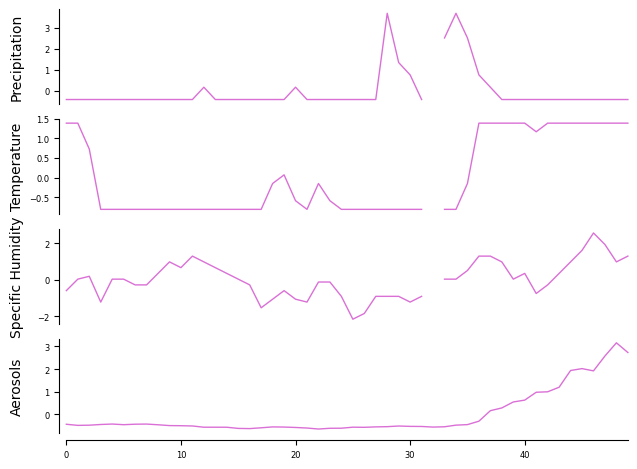

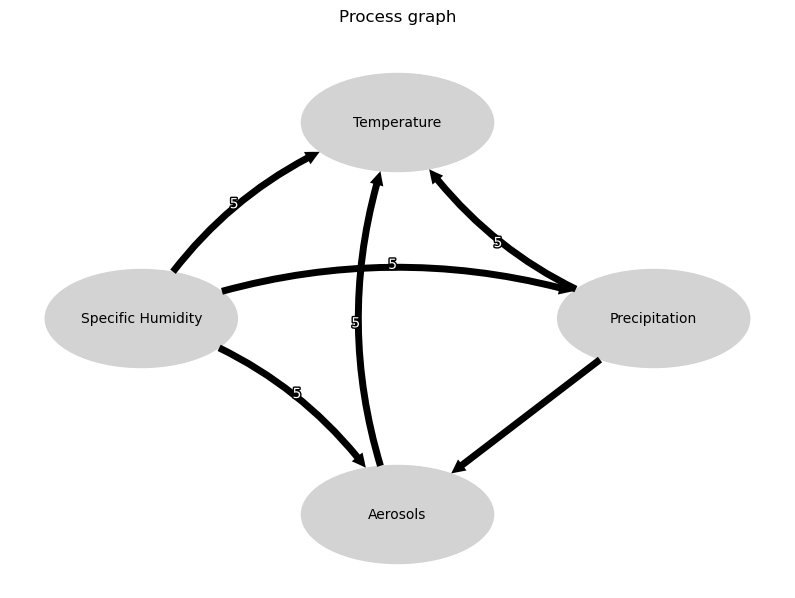

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


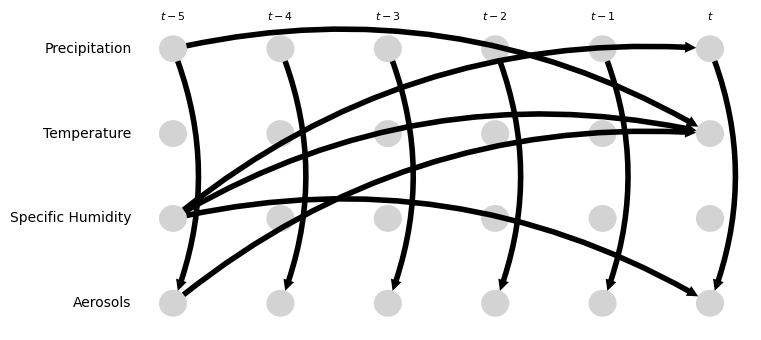

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.13 [-0.23, -0.03]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.32 [0.08, 0.56]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [-0.04, 0.35]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.34 [-0.05, 0.45]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.43 [-0.77, -0.19]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.13 [1.16, 1.76]
Negative precipitation values in event 87: 0


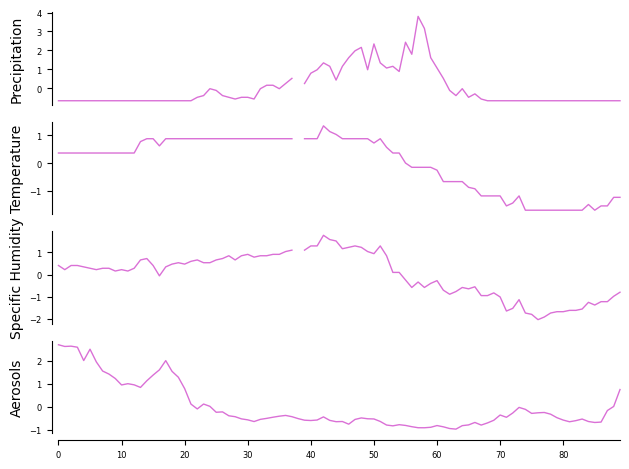

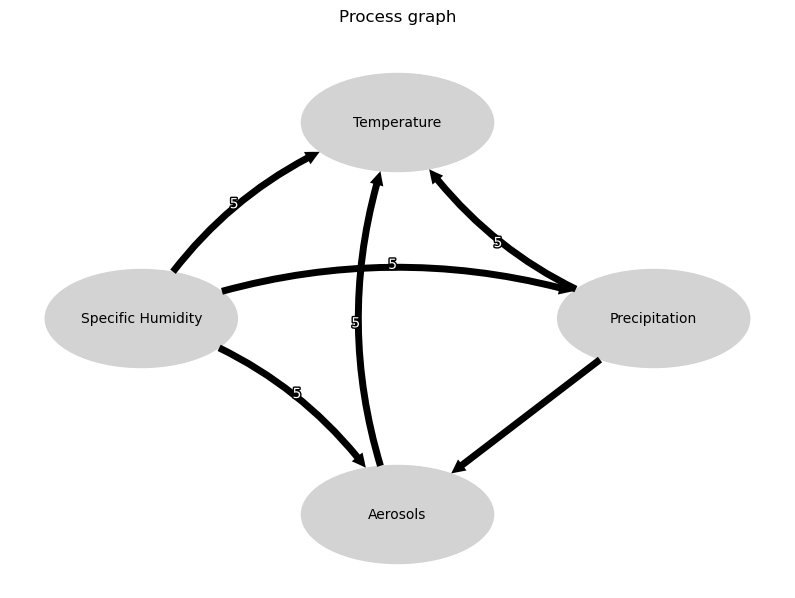

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


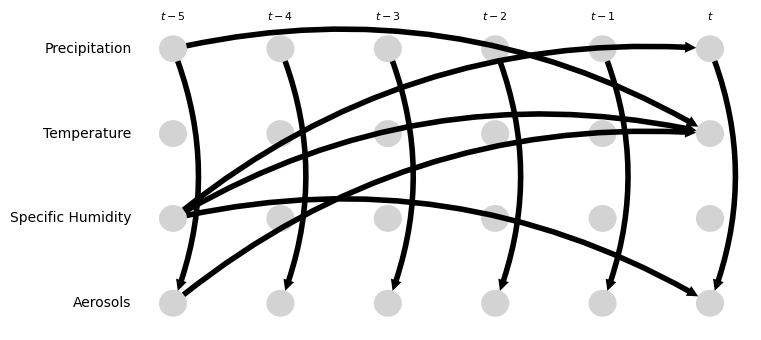

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.57 [-0.78, -0.42]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.10 [-0.21, -0.03]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.93 [0.87, 1.03]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.28 [0.18, 0.45]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.59 [0.51, 0.69]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.29 [0.20, 0.40]
Negative precipitation values in event 88: 0


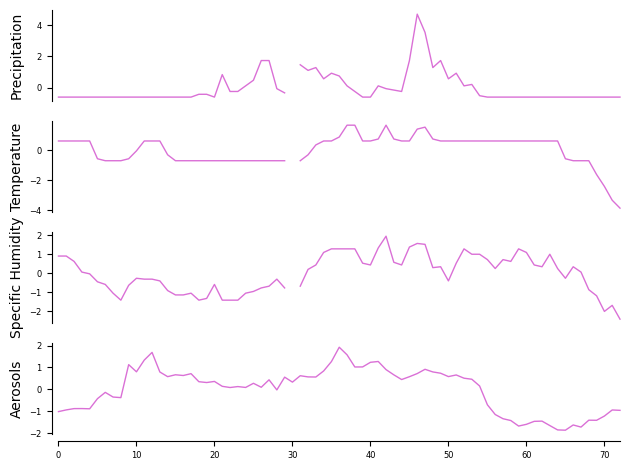

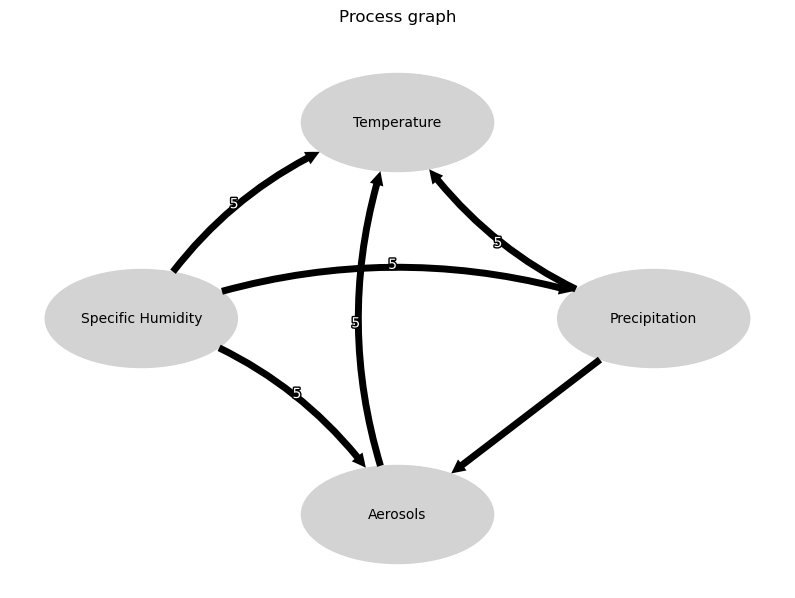

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


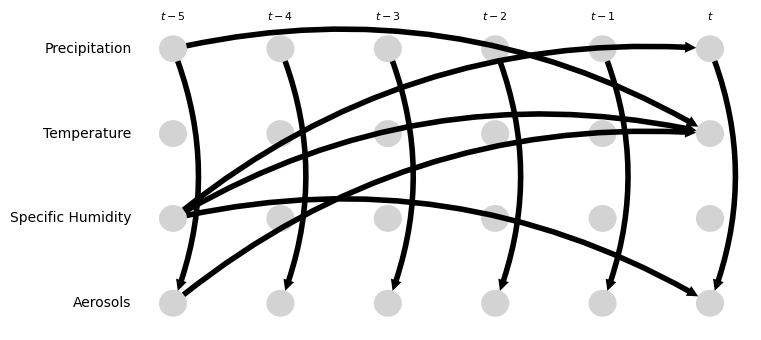

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.38 [0.28, 0.54]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.06 [-0.05, 0.22]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.43 [0.31, 0.55]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.29 [-0.49, -0.08]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.09 [-0.25, 0.37]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.48 [0.15, 0.61]
Negative precipitation values in event 89: 0


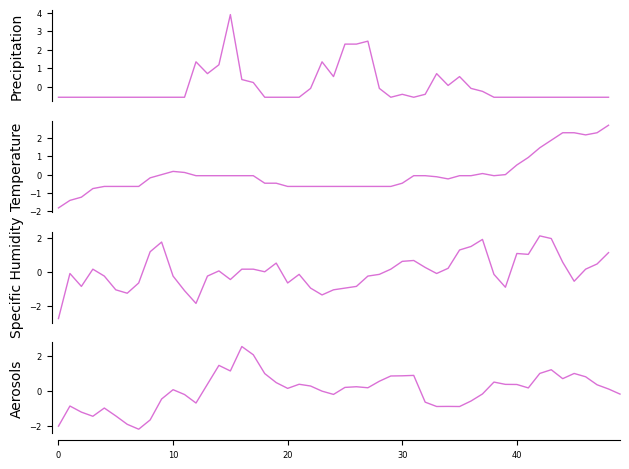

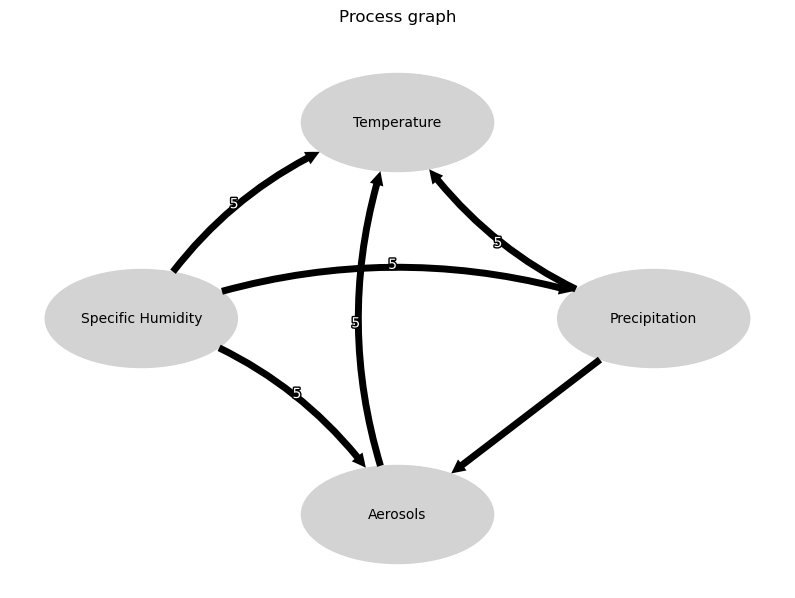

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


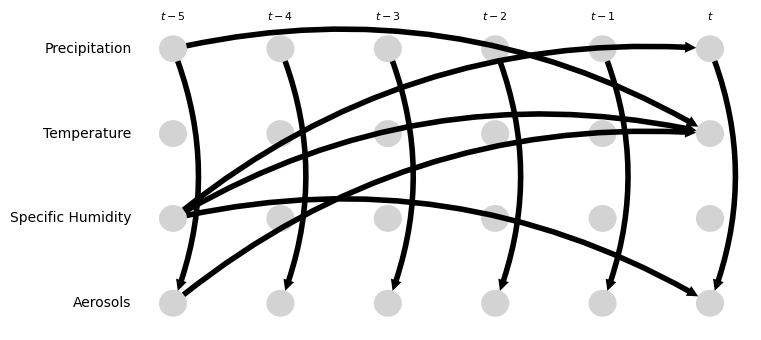

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.11 [-0.09, 0.23]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.16 [-0.33, 0.05]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.46 [0.18, 0.77]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.11 [-0.35, 0.09]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.16 [-0.37, -0.01]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.06 [-0.23, 0.13]
Negative precipitation values in event 90: 0


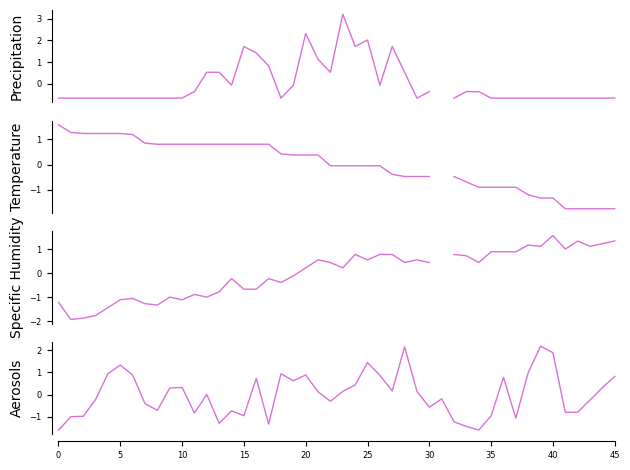

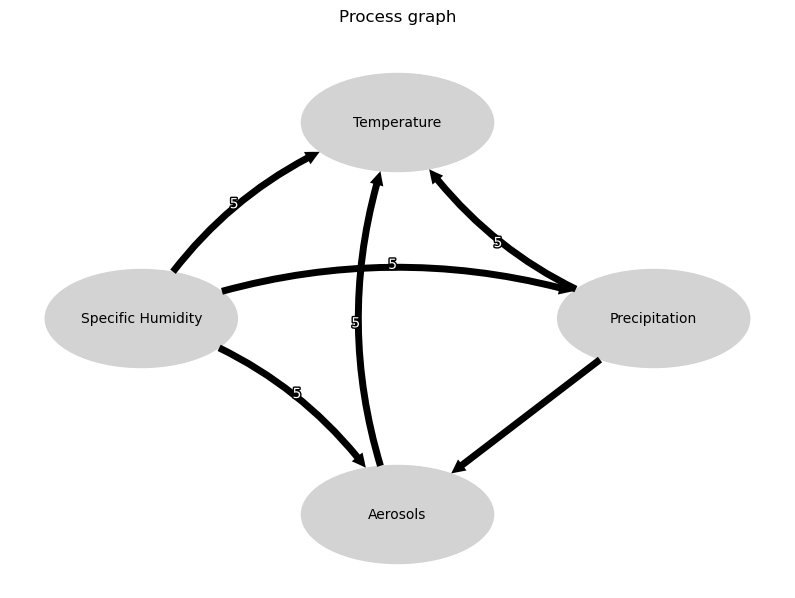

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


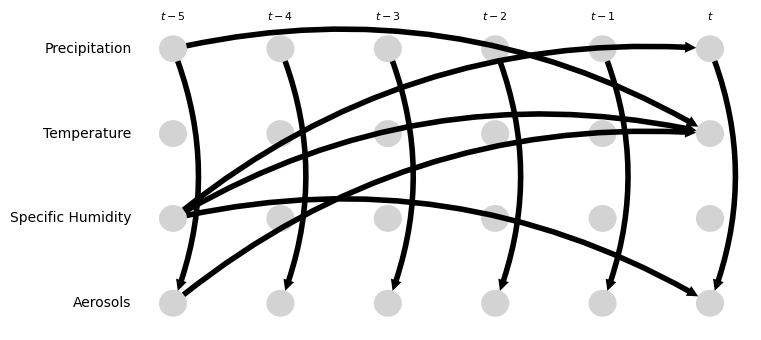

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.11 [-0.04, 0.34]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.17 [0.10, 0.28]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.03 [-1.12, -0.95]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.31 [-0.09, 0.59]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.61 [-0.91, -0.36]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.04 [-0.05, 0.10]
Negative precipitation values in event 91: 0


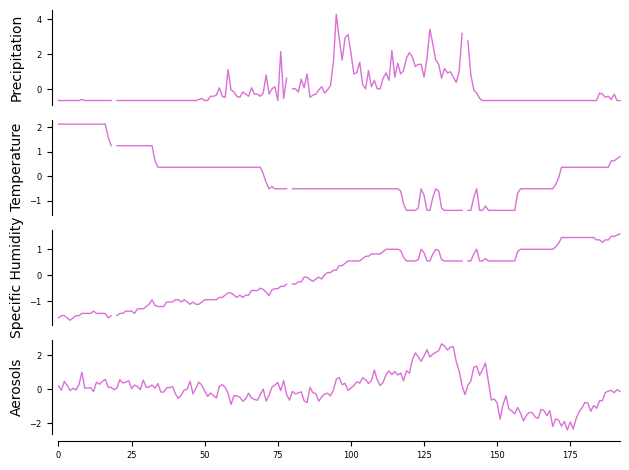

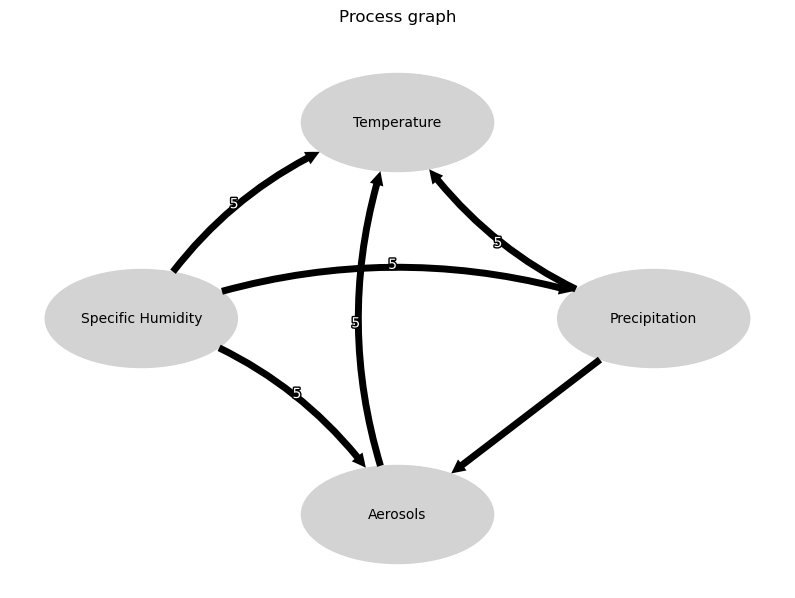

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


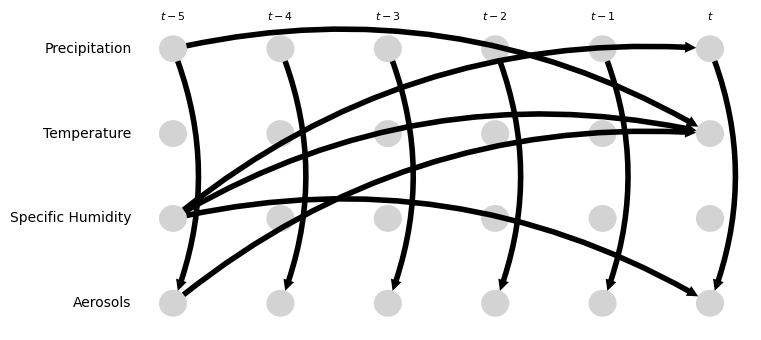

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.57 [0.47, 0.71]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.15 [-0.24, -0.08]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.54 [-0.64, -0.45]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.22 [-0.33, -0.14]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.25 [0.17, 0.34]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.27 [-0.33, -0.19]
Negative precipitation values in event 92: 0


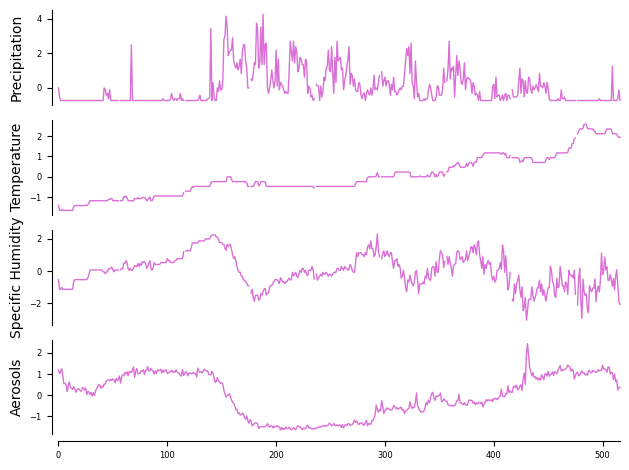

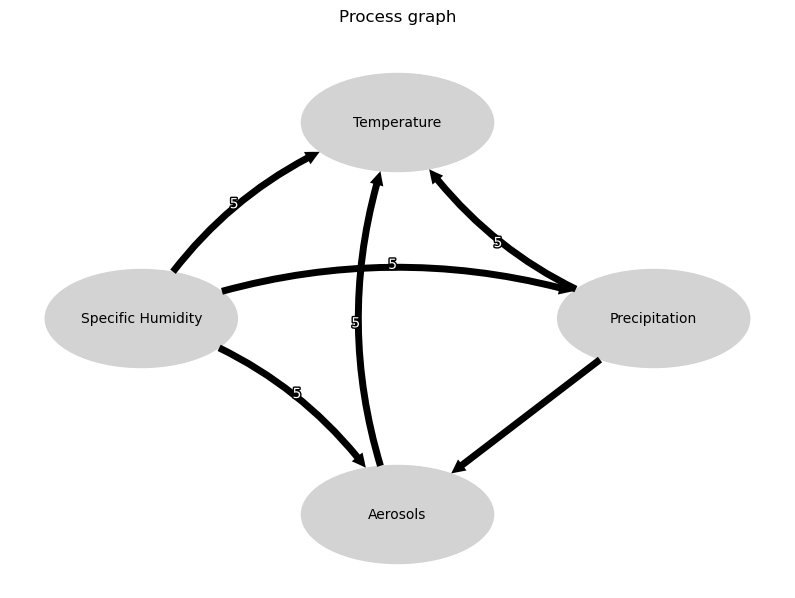

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


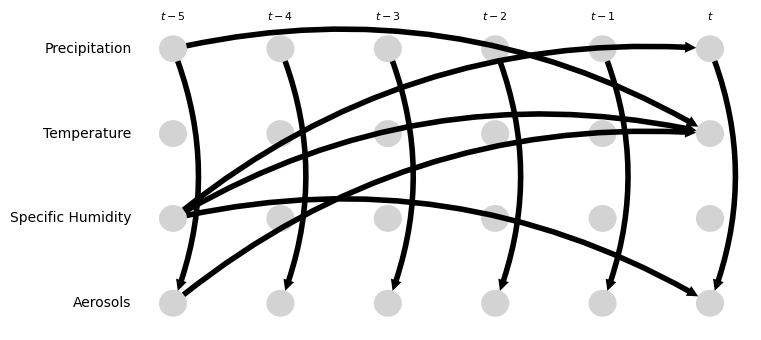

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.53 [-0.61, -0.47]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.04, 0.07]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-0.30, -0.17]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.00 [-0.06, 0.07]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.09, 0.10]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.22 [0.16, 0.28]
Negative precipitation values in event 93: 0


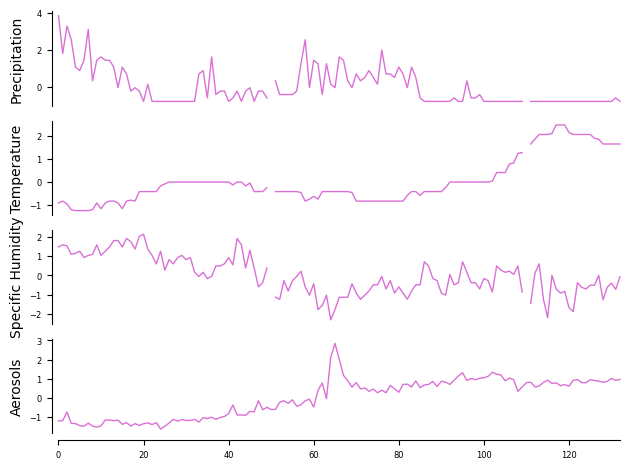

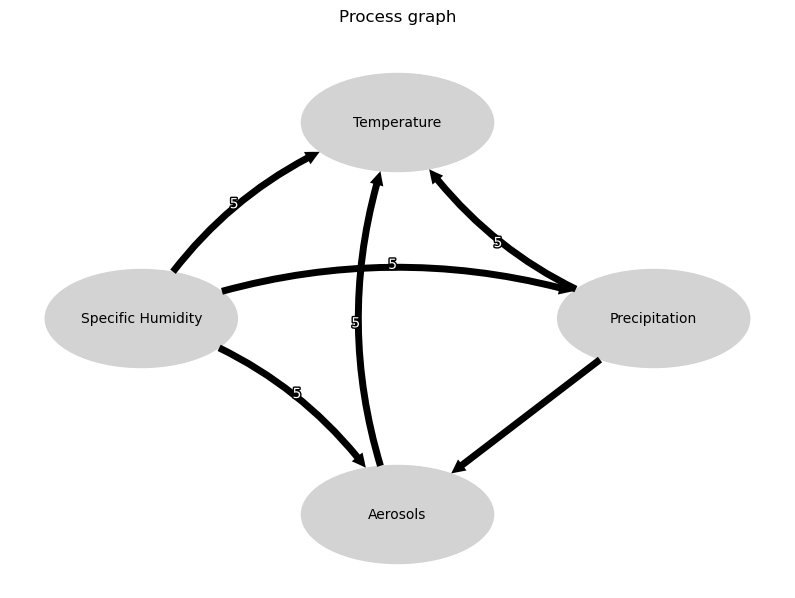

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


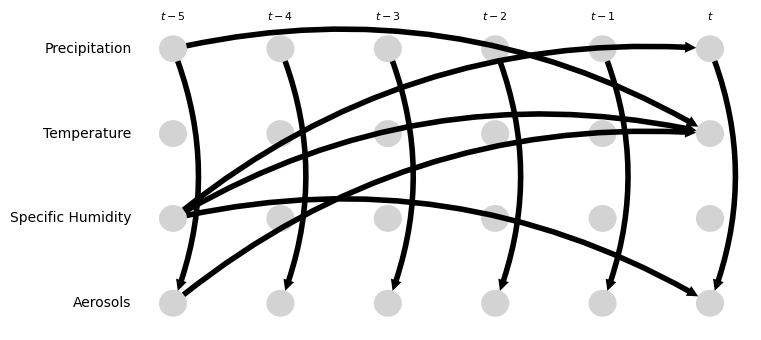

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.24 [-0.32, -0.15]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.57 [-0.74, -0.46]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.17, 0.14]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.72 [-0.81, -0.64]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.06 [-0.18, 0.05]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.26 [0.10, 0.37]
Negative precipitation values in event 94: 0


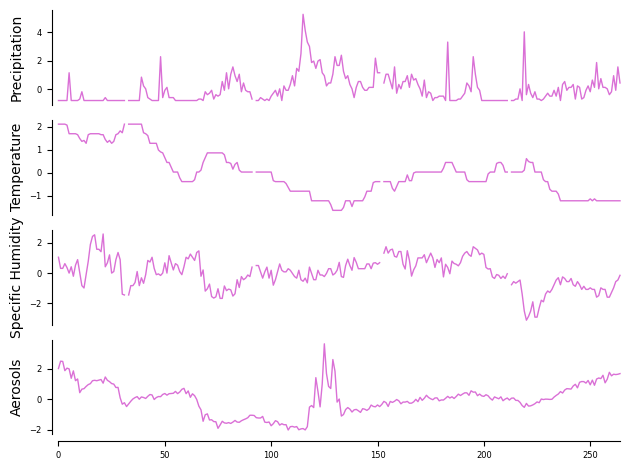

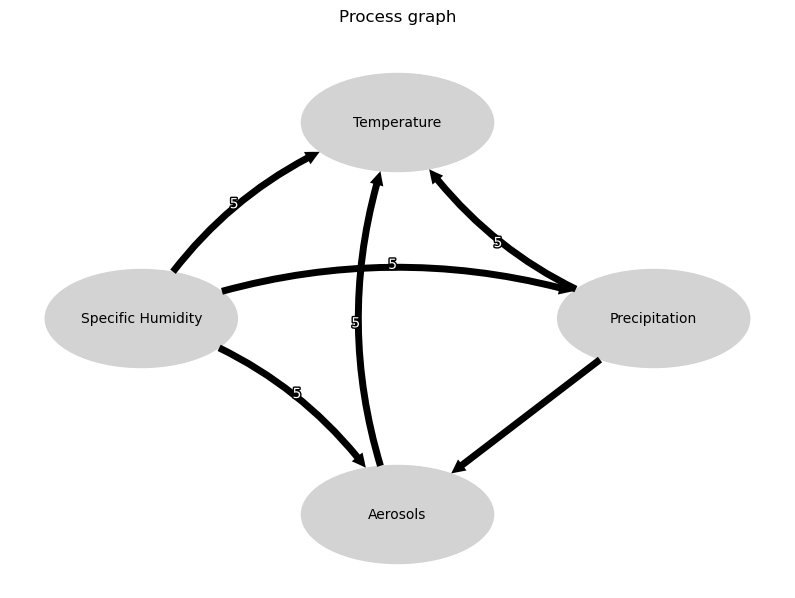

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


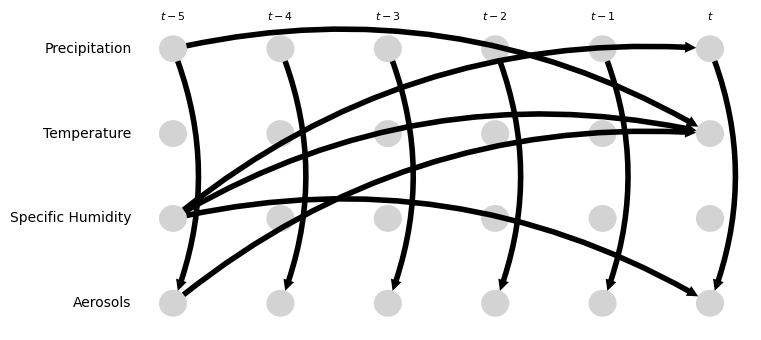

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.17 [-0.27, -0.07]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.41 [-0.53, -0.31]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.13 [0.03, 0.19]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.06, 0.11]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.14, 0.01]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.12, 0.05]
Negative precipitation values in event 95: 0


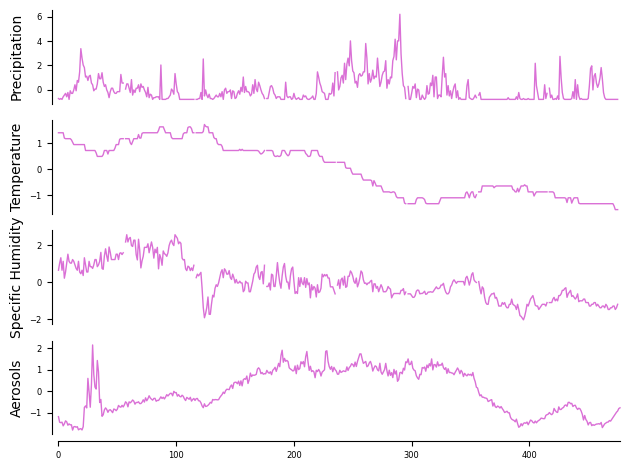

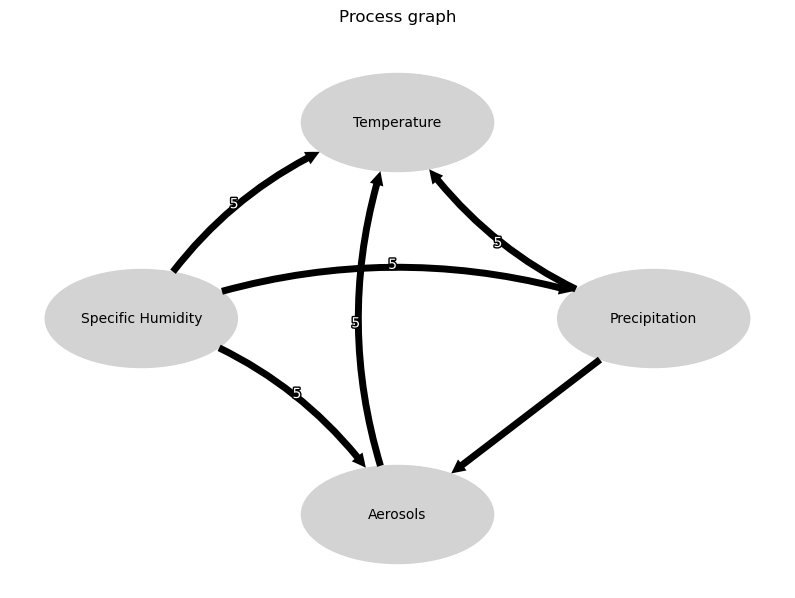

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


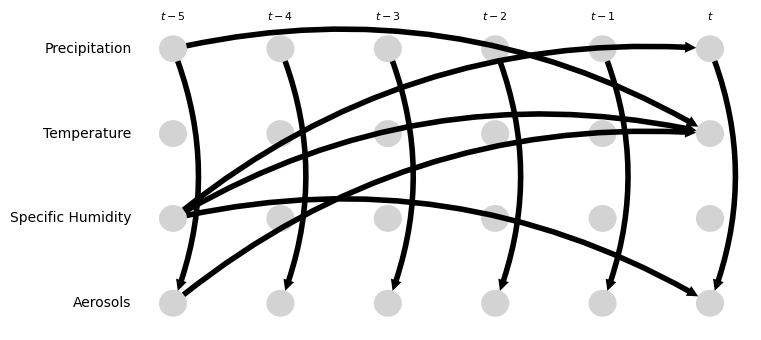

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [0.10, 0.27]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.19, -0.09]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.73 [0.69, 0.78]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.10 [0.04, 0.17]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [0.01, 0.14]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.11, -0.02]
Negative precipitation values in event 96: 0


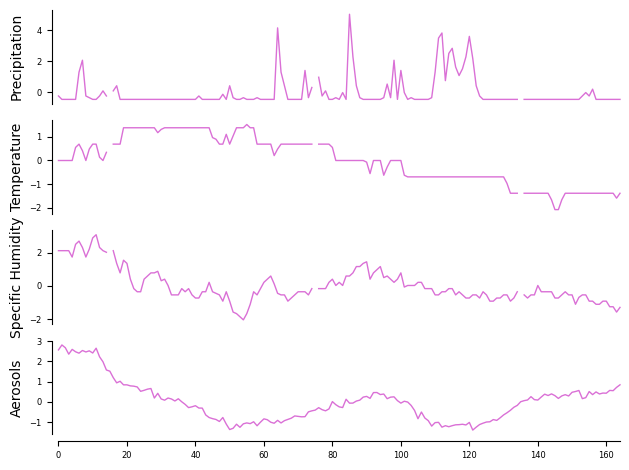

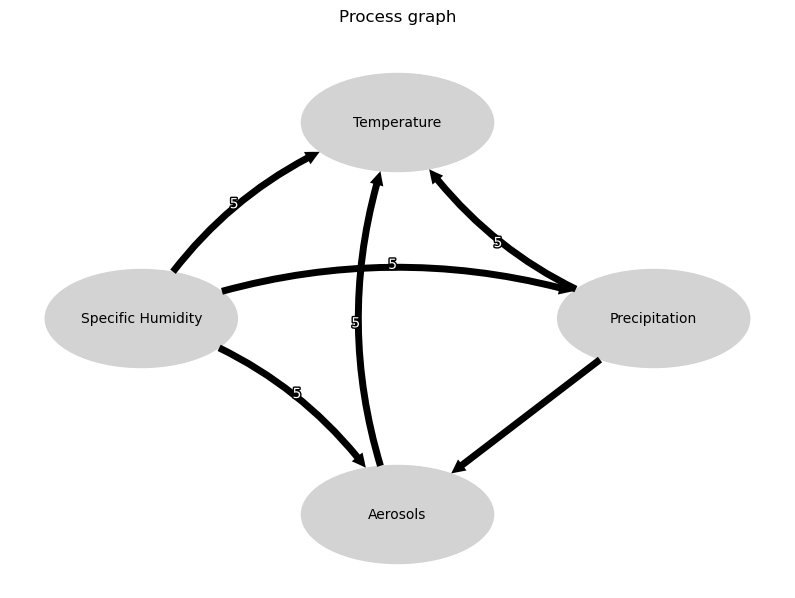

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


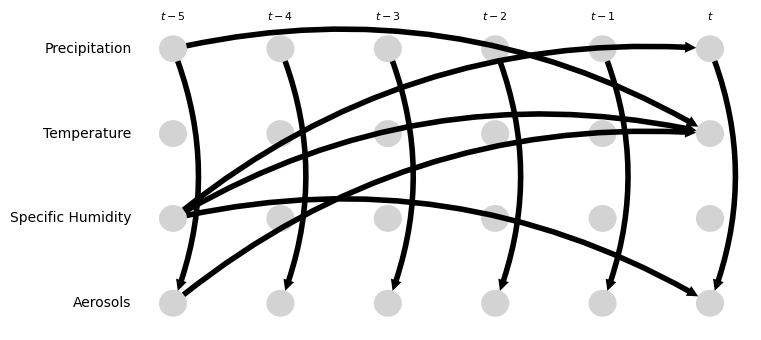

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.20 [-0.29, -0.13]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.18 [-0.26, -0.09]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.55 [0.30, 0.72]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.52 [0.42, 0.62]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.05, 0.14]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.35 [-0.53, -0.12]
Negative precipitation values in event 97: 0


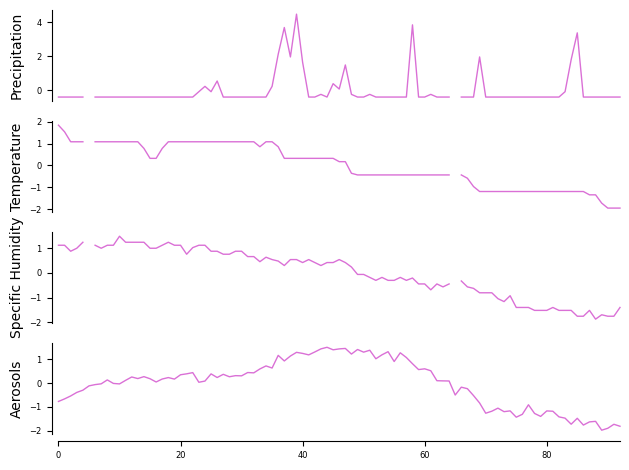

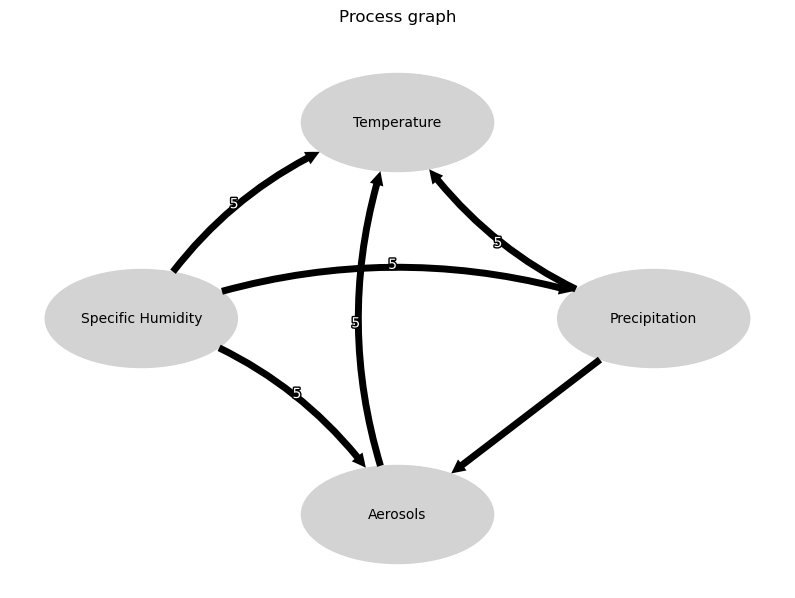

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


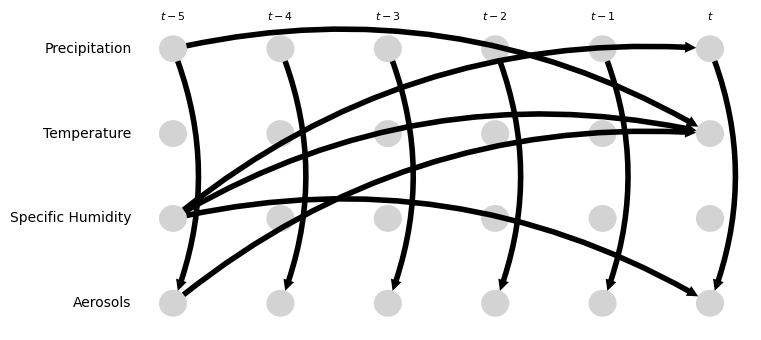

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [0.07, 0.25]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.00 [-0.04, 0.03]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.03 [0.97, 1.13]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.83 [0.68, 0.92]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.19, 0.21]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.13 [-0.23, -0.07]
Negative precipitation values in event 98: 0


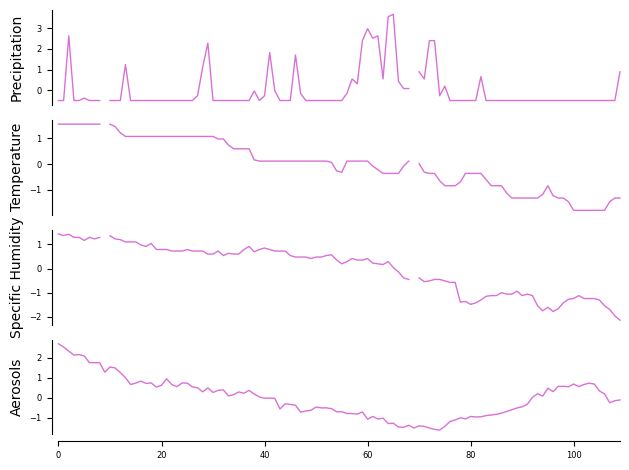

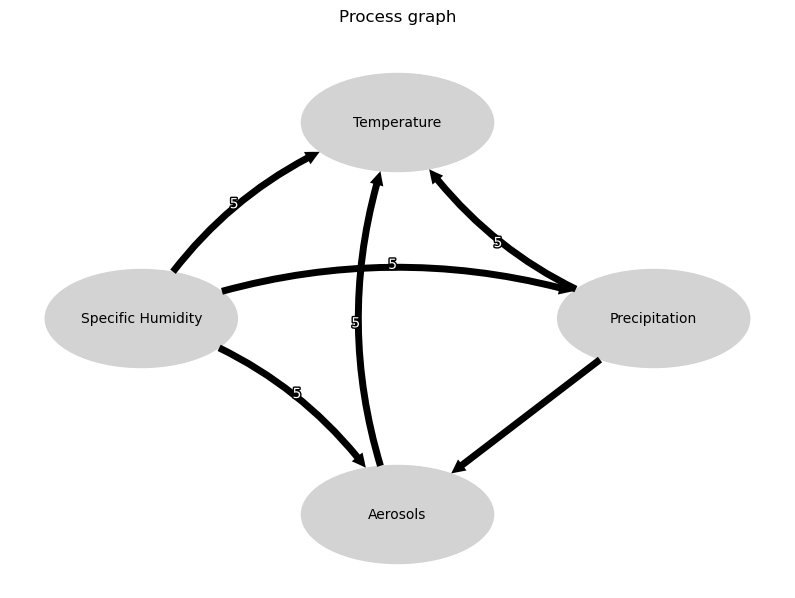

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


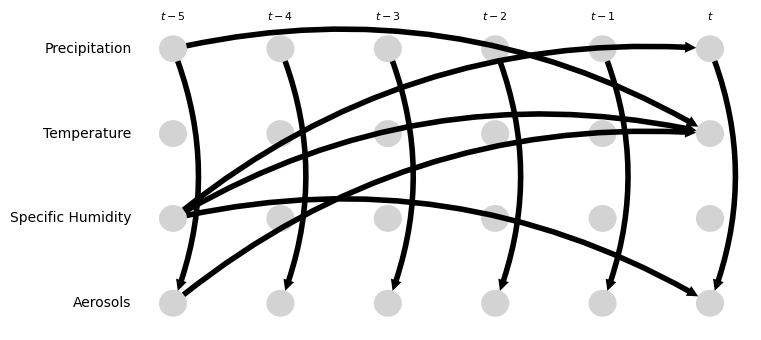

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.38 [-0.47, -0.30]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.05 [-0.12, 0.02]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.90 [0.83, 0.97]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.22 [0.09, 0.33]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [0.07, 0.31]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [-0.00, 0.13]
Negative precipitation values in event 99: 0


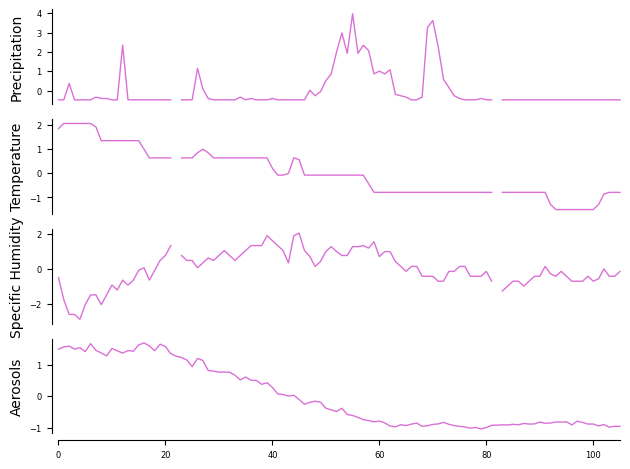

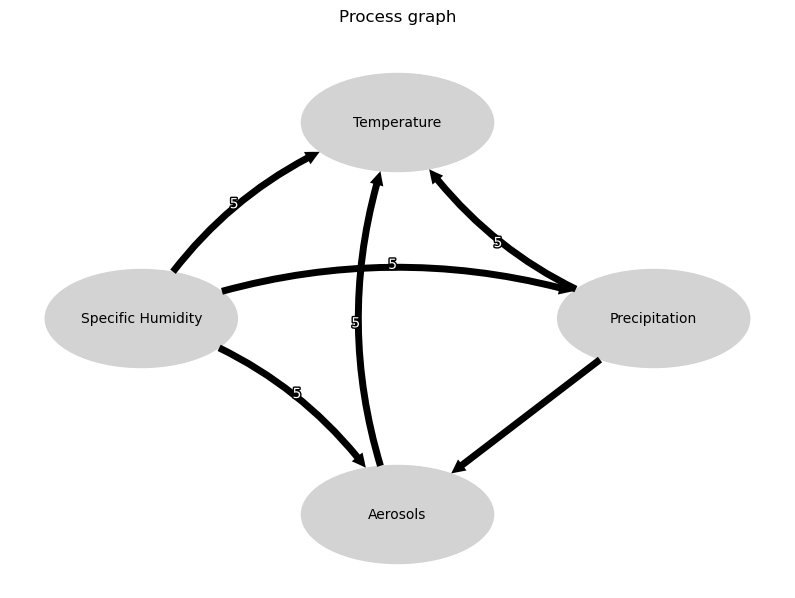

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


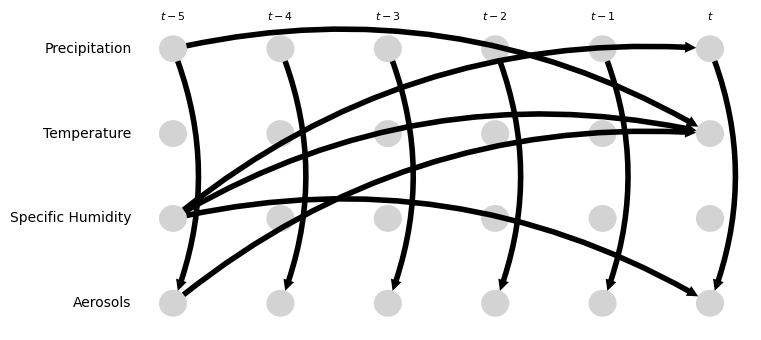

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.23, -0.05]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.01, 0.07]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.02, 0.11]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.12 [-0.28, 0.12]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.25 [0.10, 0.41]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.80 [0.74, 0.86]
Negative precipitation values in event 100: 0


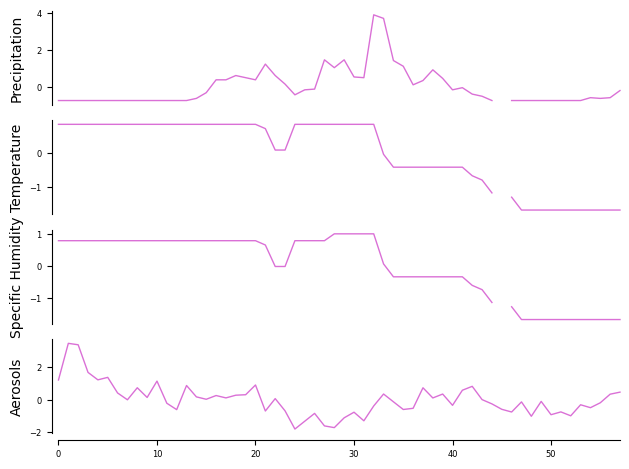

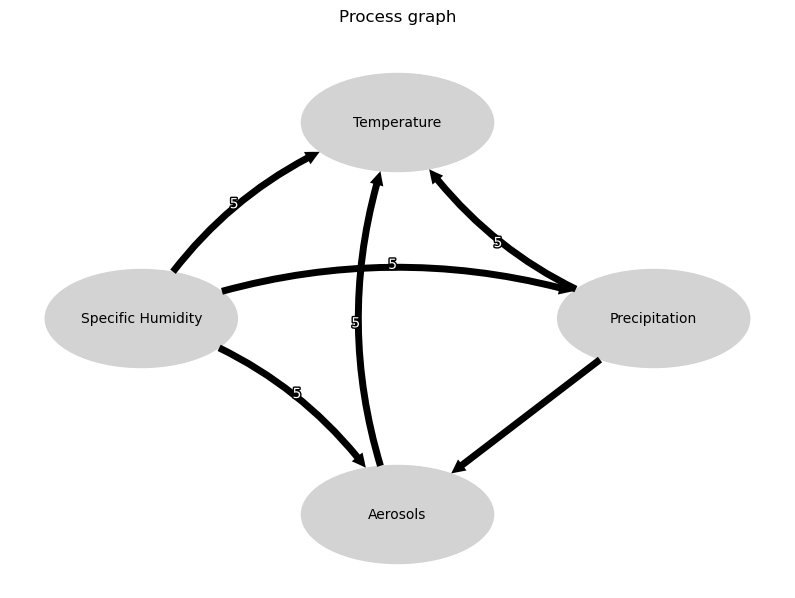

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


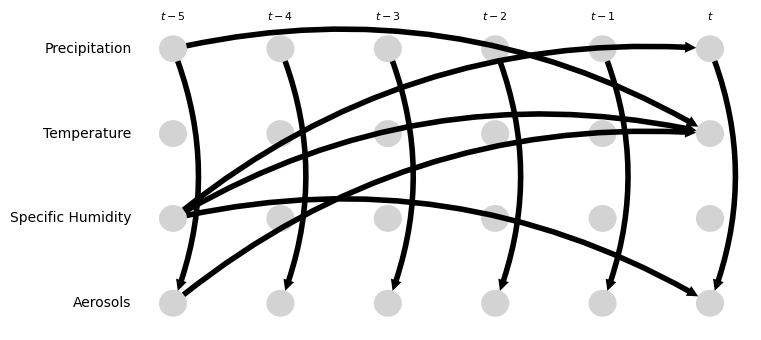

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.15 [-0.46, 0.01]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.19 [-0.32, -0.08]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.98 [0.90, 1.12]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-0.09, 0.32]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.51 [0.38, 0.73]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.14, 0.22]
Negative precipitation values in event 101: 0


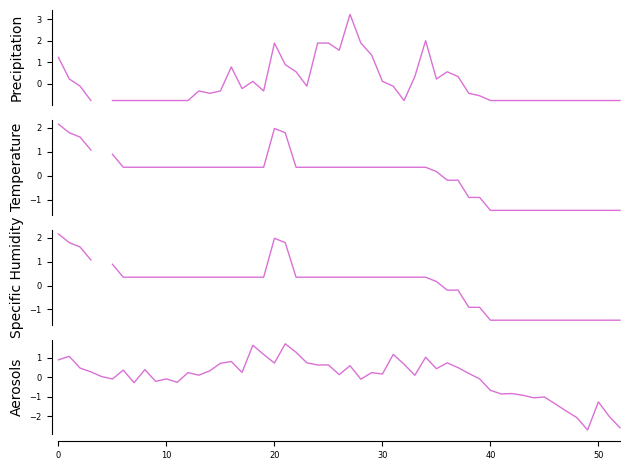

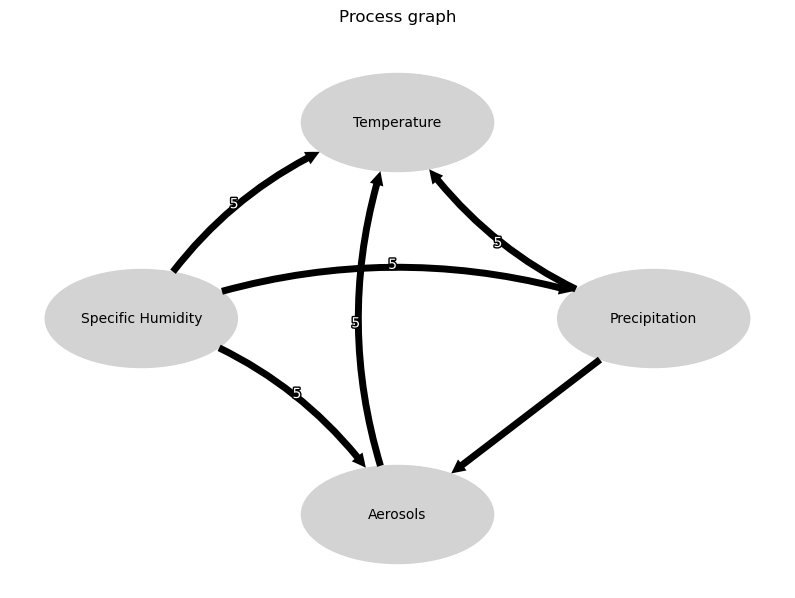

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


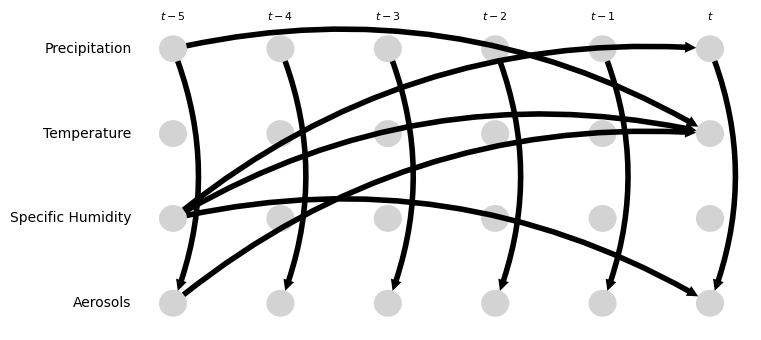

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.31 [0.16, 0.46]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.08 [-0.30, 0.05]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.89 [0.65, 1.24]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.92 [0.63, 1.15]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.68 [0.54, 0.82]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.03 [-0.31, 0.27]
Negative precipitation values in event 102: 0


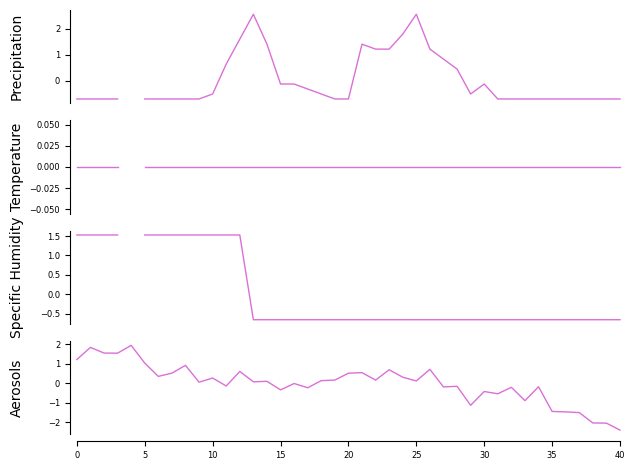

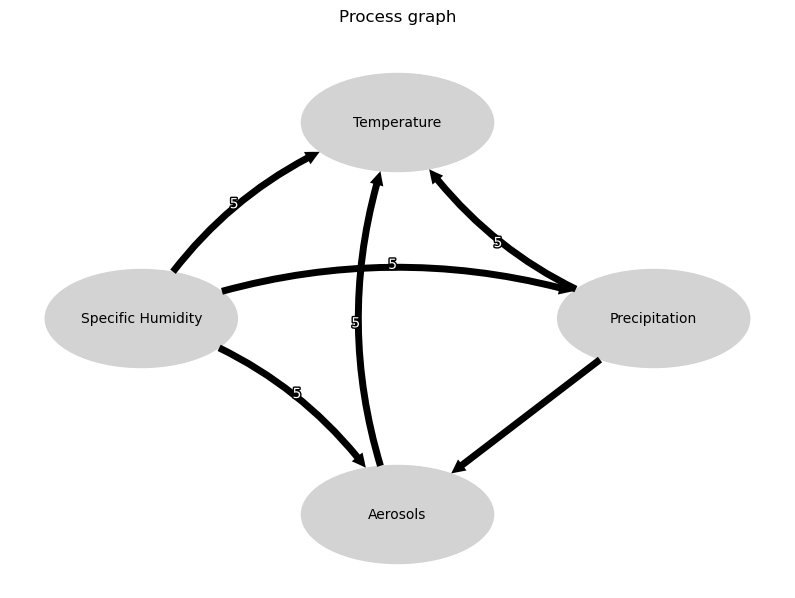

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


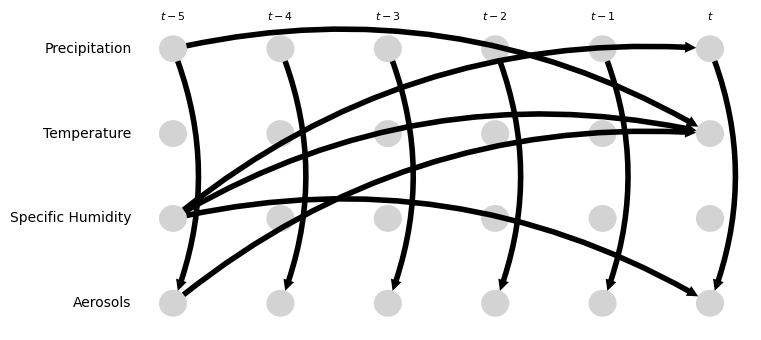

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.31 [0.11, 0.47]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.00 [0.00, 0.00]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.00 [0.00, 0.00]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.13 [-0.06, 0.23]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.27 [-0.01, 0.64]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.00 [0.00, 0.00]
Negative precipitation values in event 103: 0


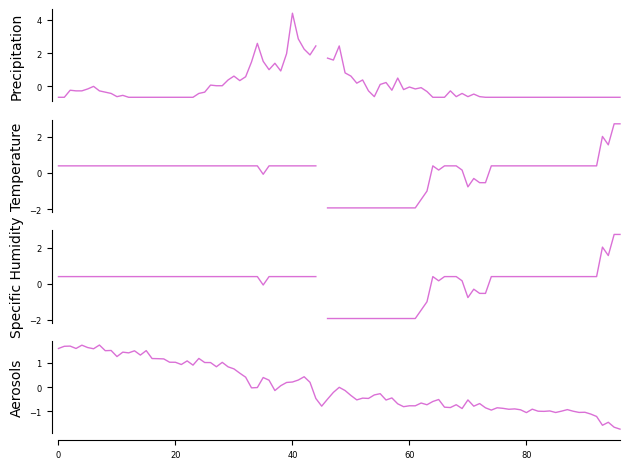

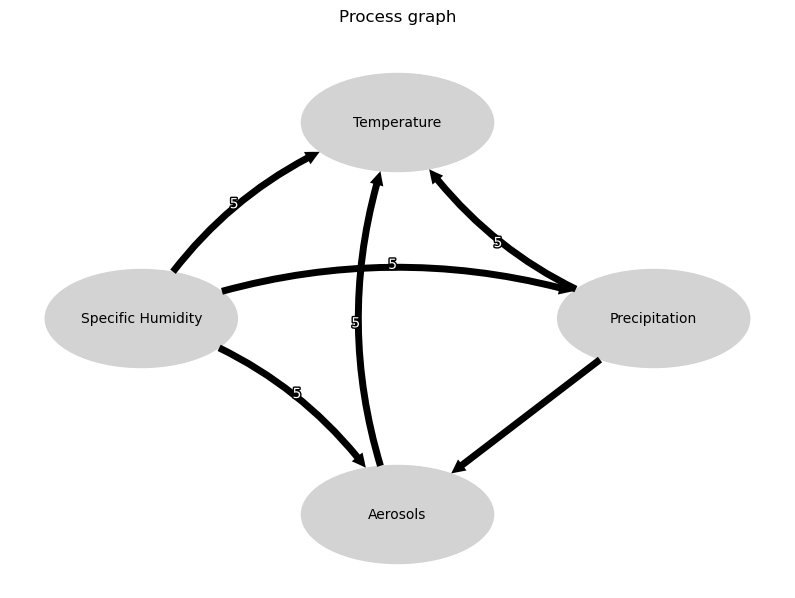

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


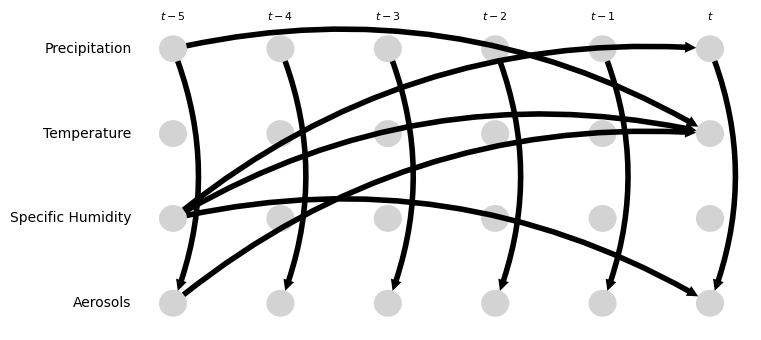

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [-0.03, 0.19]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.44 [-0.58, -0.25]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.63 [0.48, 0.78]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.27 [0.20, 0.37]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.12 [0.02, 0.24]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.11 [-0.20, 0.04]
Negative precipitation values in event 104: 0


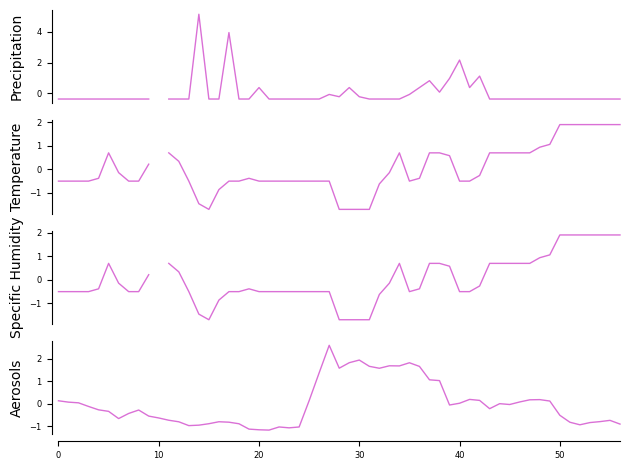

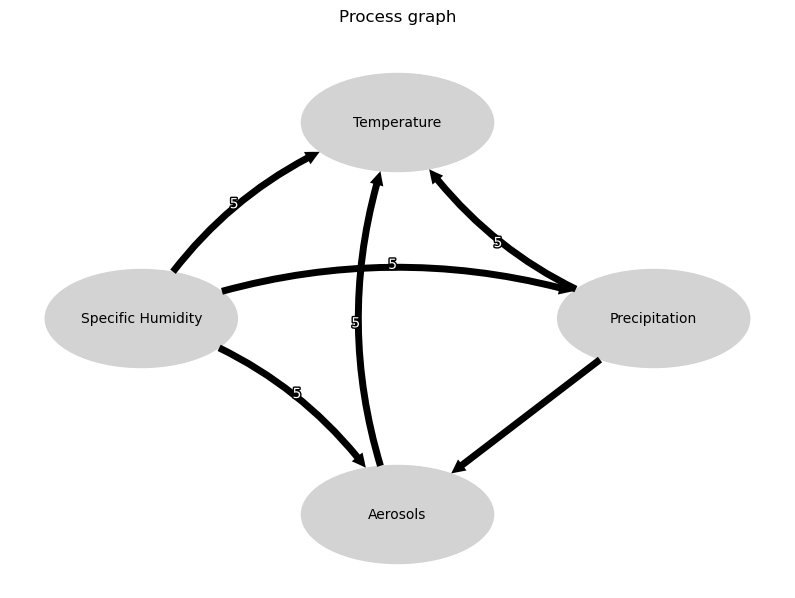

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


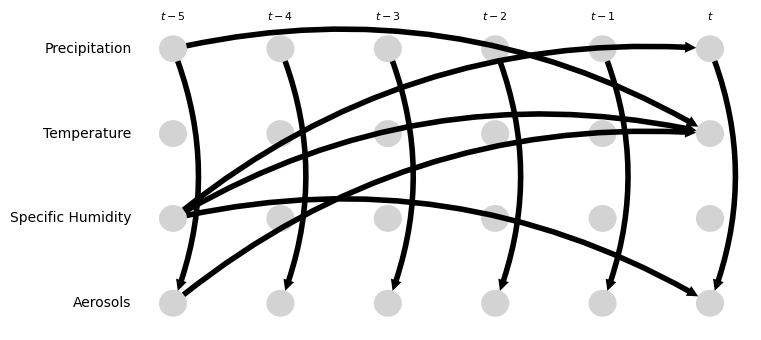

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.05 [-0.14, 0.32]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.11 [-0.06, 0.28]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.77 [0.54, 1.03]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.51 [-0.72, -0.18]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.06 [-0.09, 0.37]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.22 [0.06, 0.40]
Negative precipitation values in event 105: 0


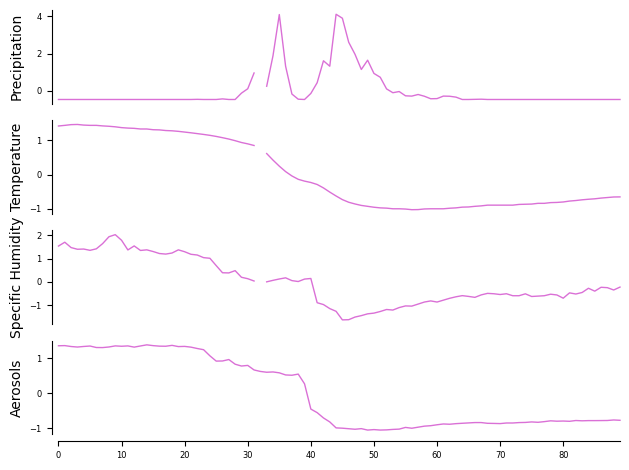

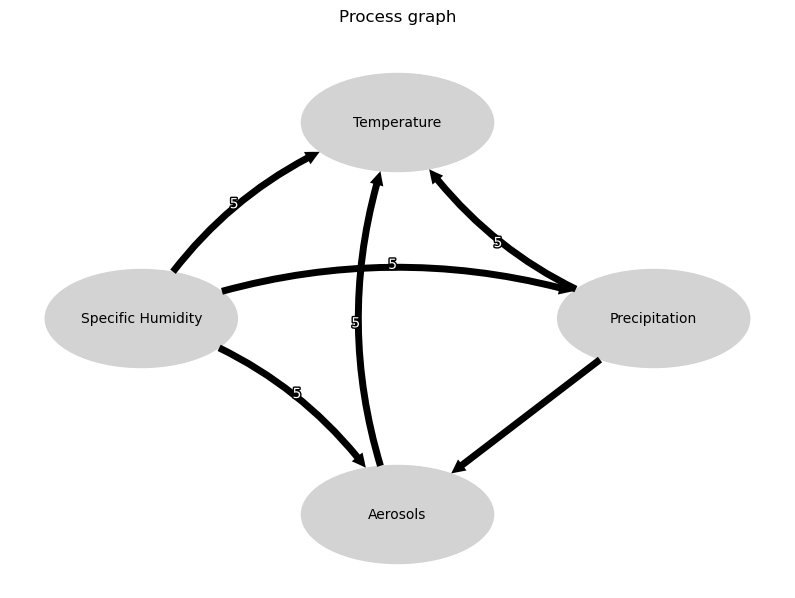

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


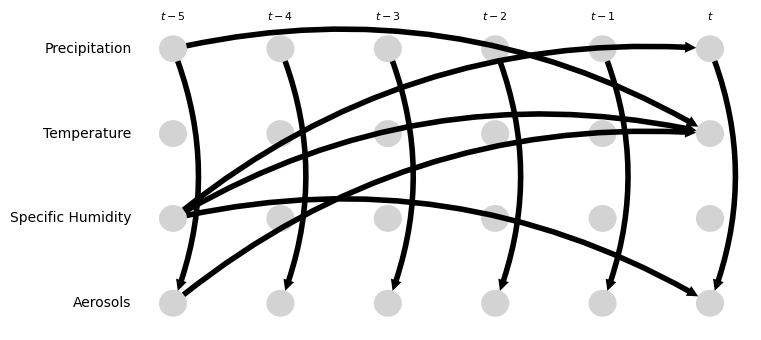

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.05 [-0.15, 0.07]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.06, 0.11]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.42 [0.22, 0.62]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.88 [0.83, 0.94]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.12 [-0.21, -0.01]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.50 [0.33, 0.69]
Negative precipitation values in event 106: 0


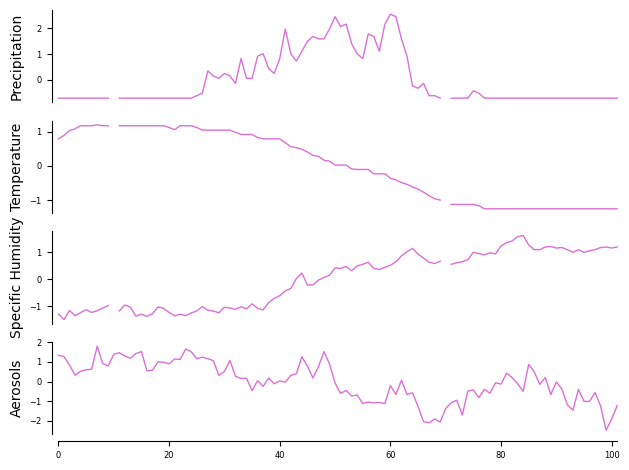

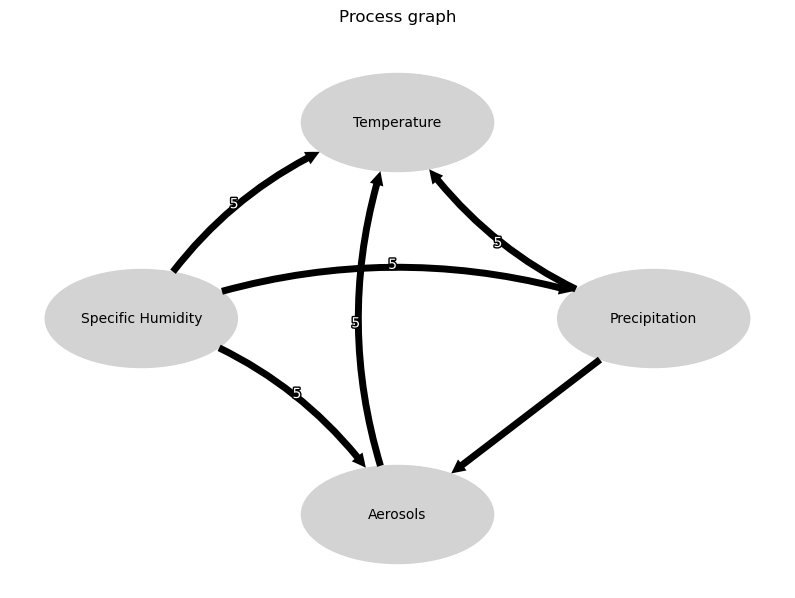

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


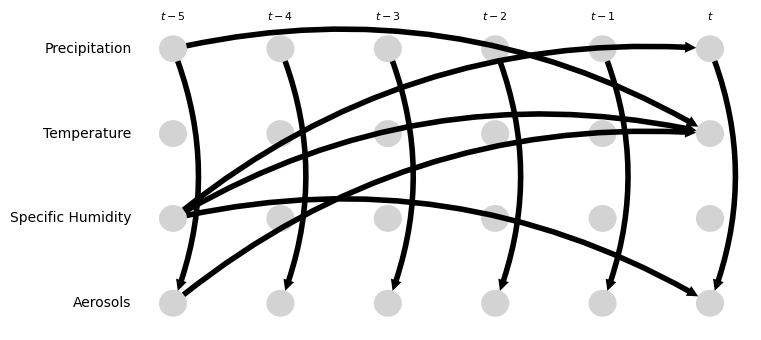

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.12 [-0.24, -0.02]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [0.04, 0.11]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.87 [-0.91, -0.83]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.70 [-0.82, -0.60]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.31, -0.08]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.17 [0.12, 0.22]
Negative precipitation values in event 107: 0


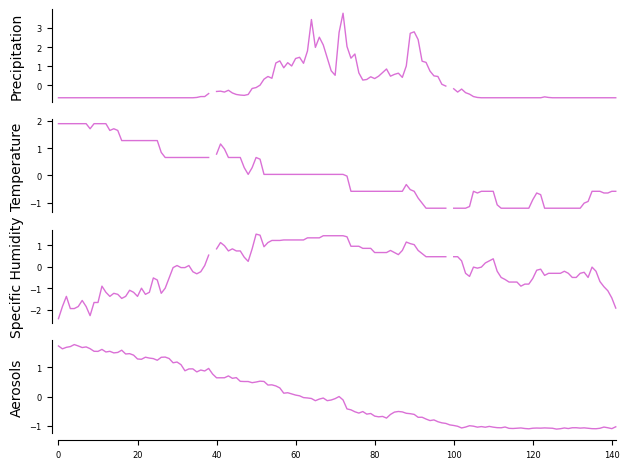

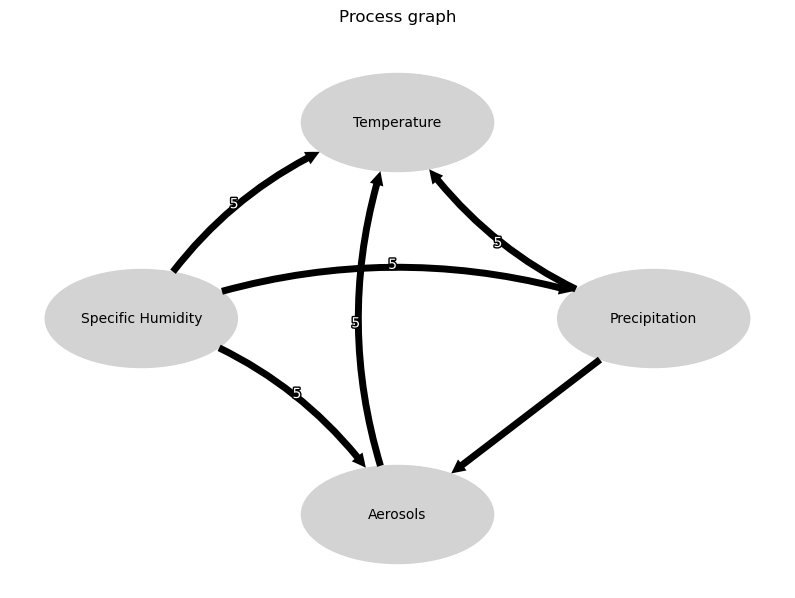

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


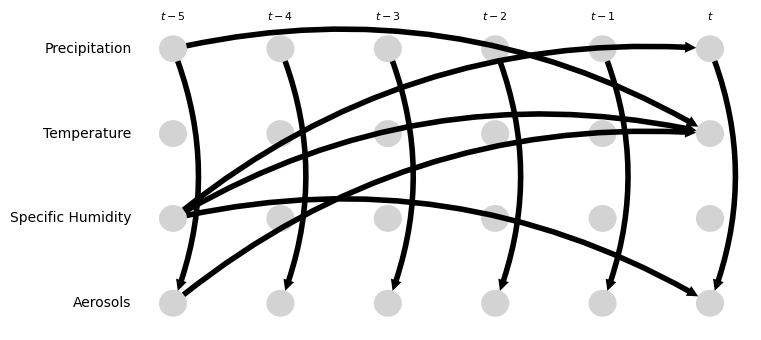

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.34 [0.18, 0.50]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.06, 0.05]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-0.15, -0.03]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.62 [-0.81, -0.42]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.78 [0.69, 0.90]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.84 [0.81, 0.89]
Negative precipitation values in event 108: 0


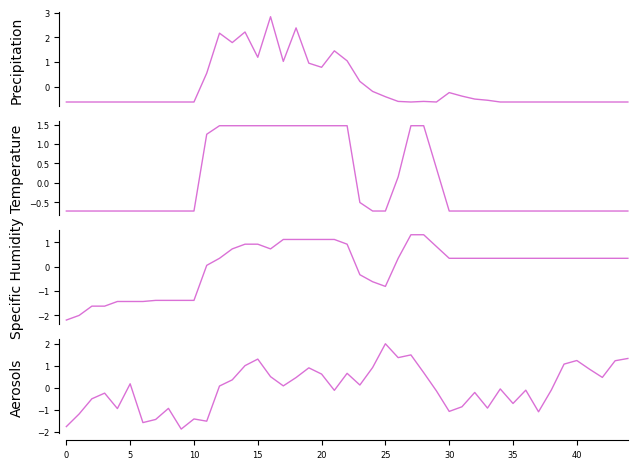

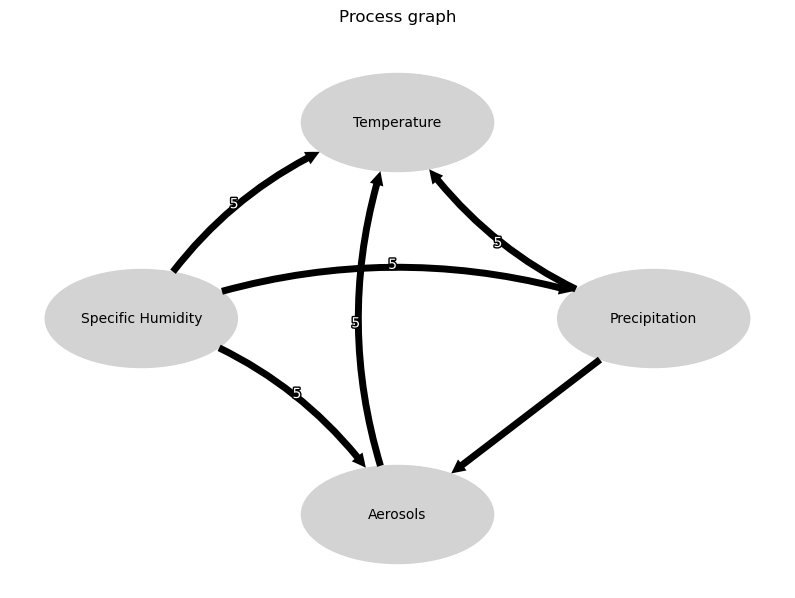

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


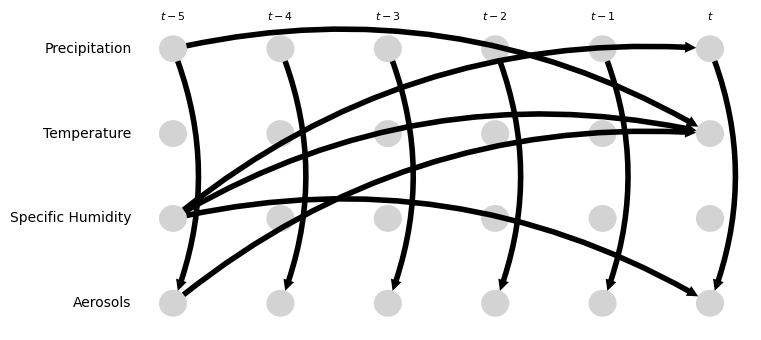

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.22 [0.09, 0.44]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.77 [0.61, 1.01]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.68 [-1.05, -0.47]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.34 [0.05, 0.58]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.39 [-0.56, -0.11]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.42, 0.13]
Negative precipitation values in event 109: 0


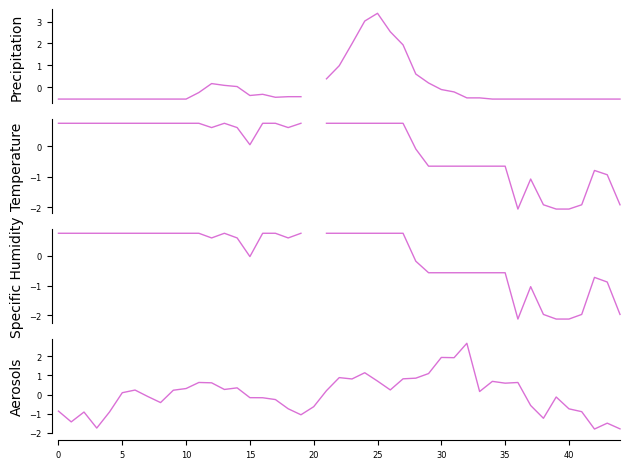

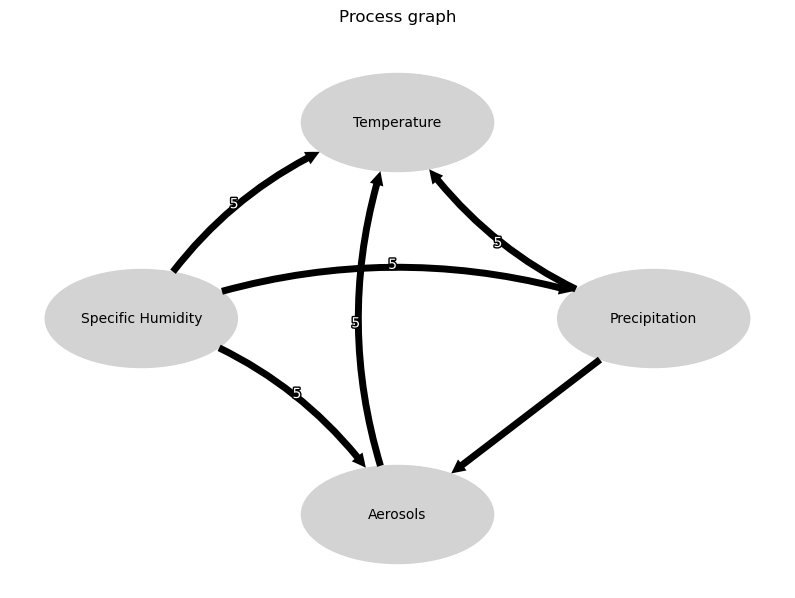

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


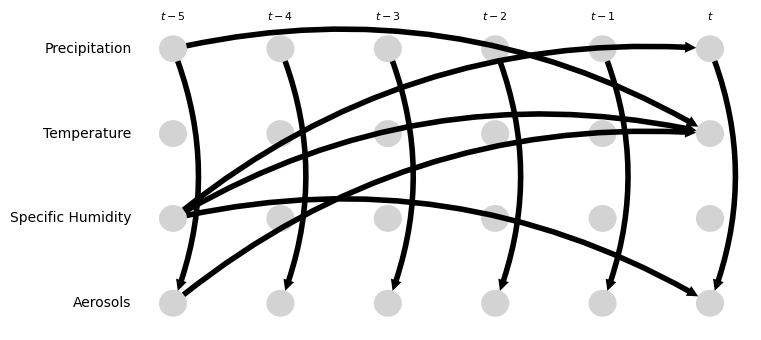

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.17 [-0.02, 0.36]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.25 [-0.41, -0.11]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.97 [0.85, 1.65]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.68 [0.31, 1.04]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.44 [0.28, 0.79]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.30 [-0.48, 0.03]
Negative precipitation values in event 110: 0


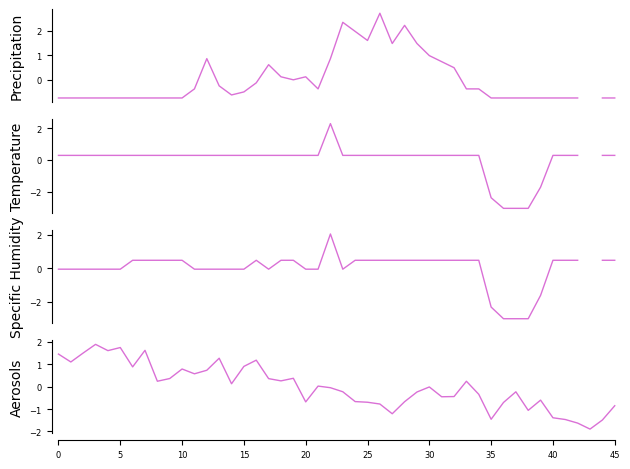

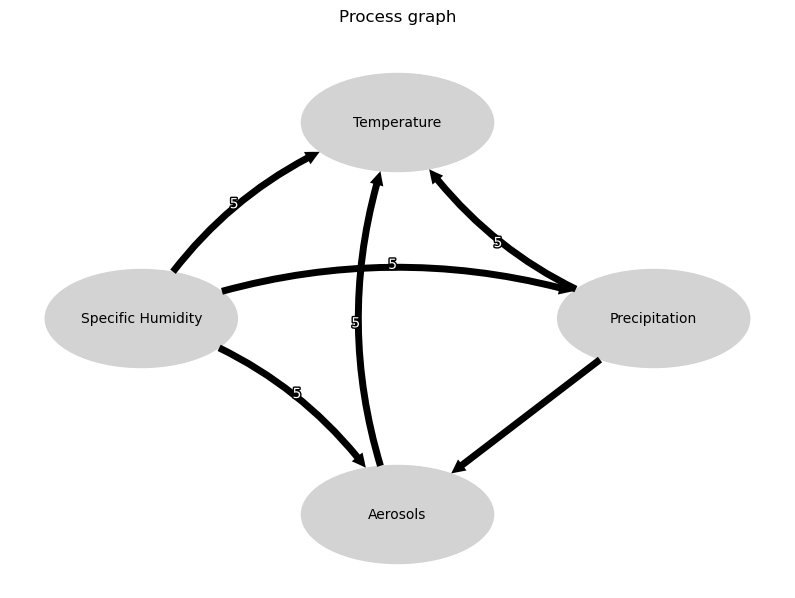

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


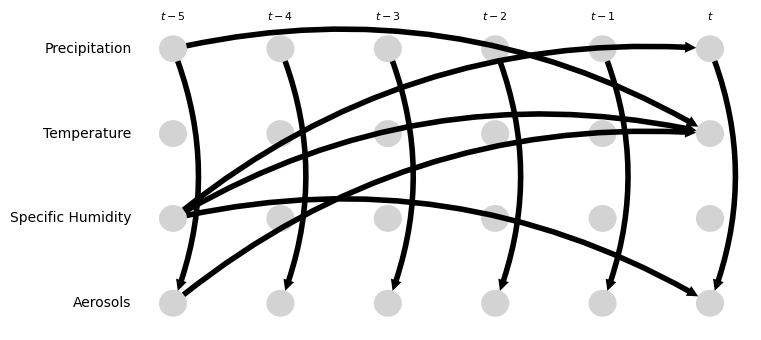

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.22 [-0.41, -0.09]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.20 [0.09, 0.73]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.33 [-0.99, -0.23]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.35 [0.12, 0.53]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.30 [0.17, 0.43]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.37 [0.28, 1.14]
Negative precipitation values in event 111: 0


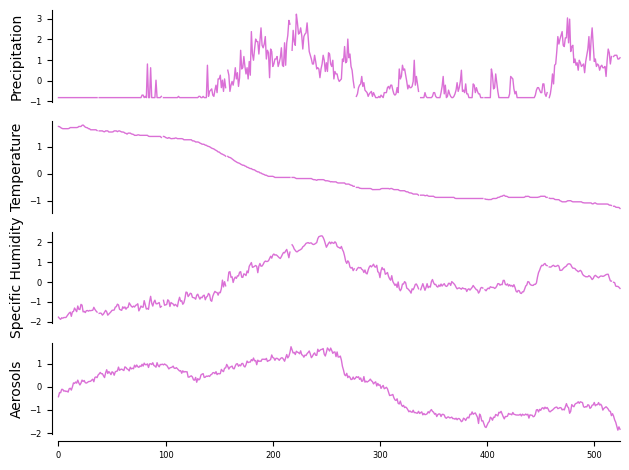

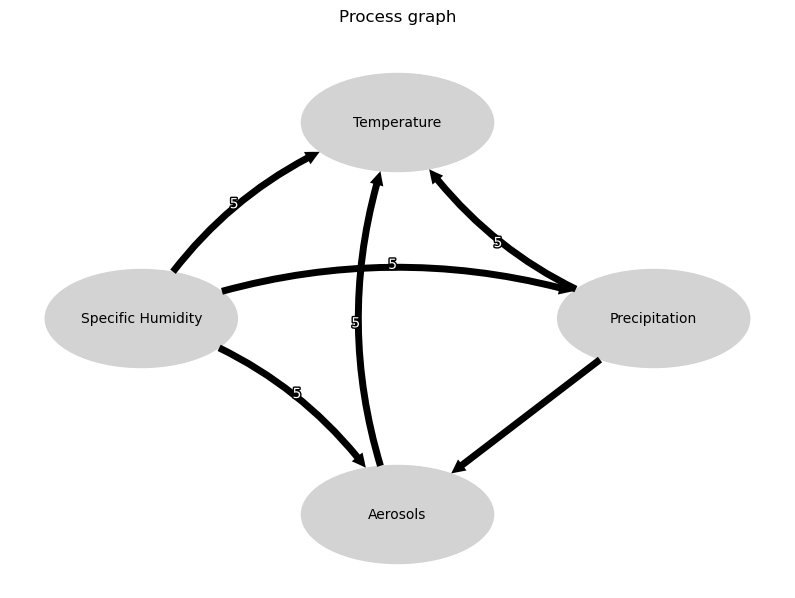

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


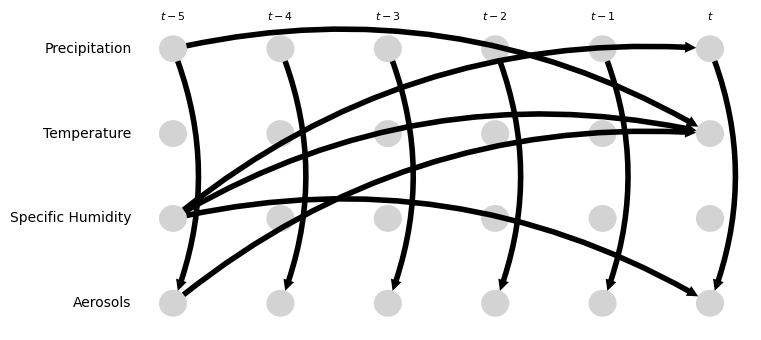

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.17 [0.09, 0.28]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.02 [-0.05, 0.00]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.75 [-0.79, -0.72]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [-0.03, 0.15]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.69 [0.64, 0.76]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.77 [0.76, 0.79]
Negative precipitation values in event 112: 0


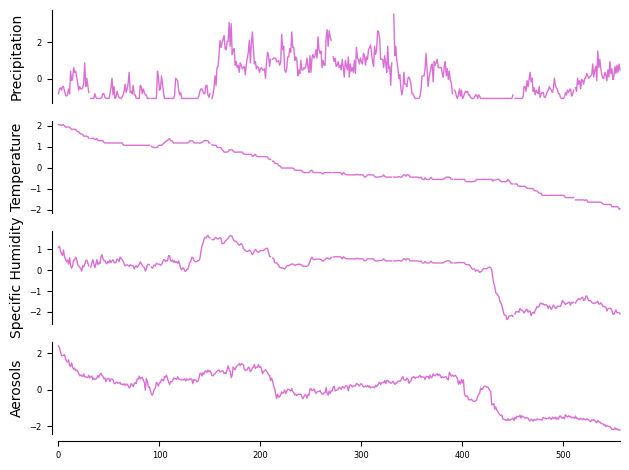

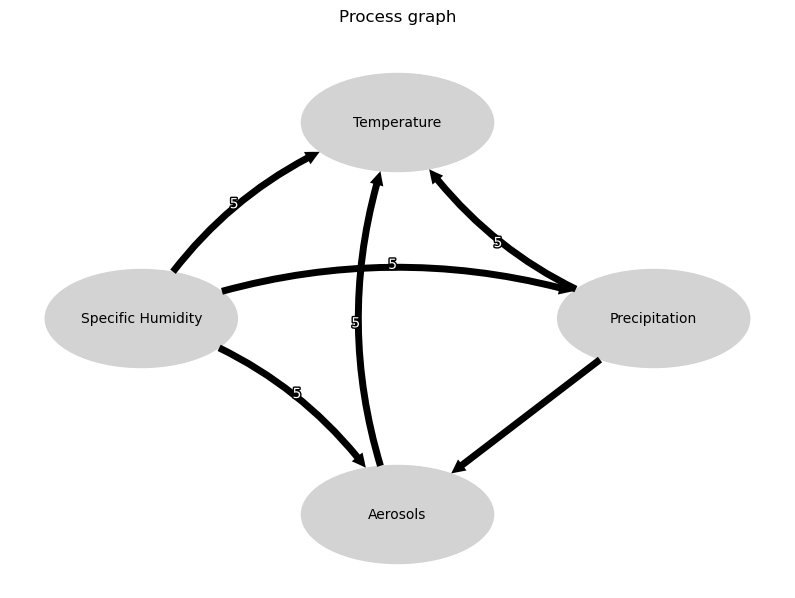

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


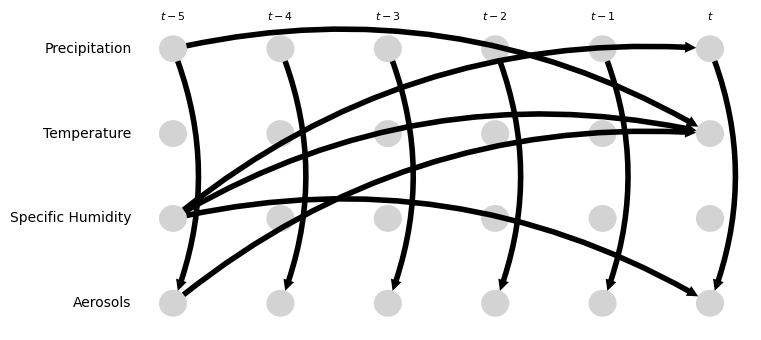

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.13 [-0.16, -0.11]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.26 [-0.30, -0.21]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [-0.03, 0.19]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.95 [0.93, 0.98]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.34 [0.29, 0.40]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.76 [0.63, 0.87]
Negative precipitation values in event 113: 0


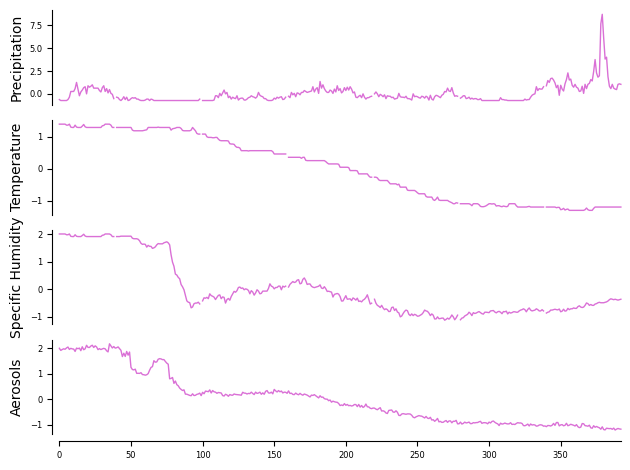

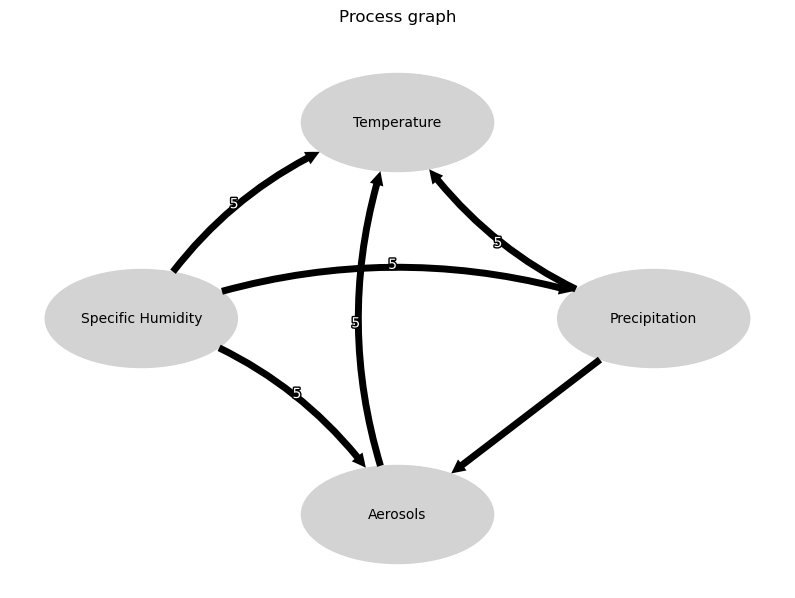

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


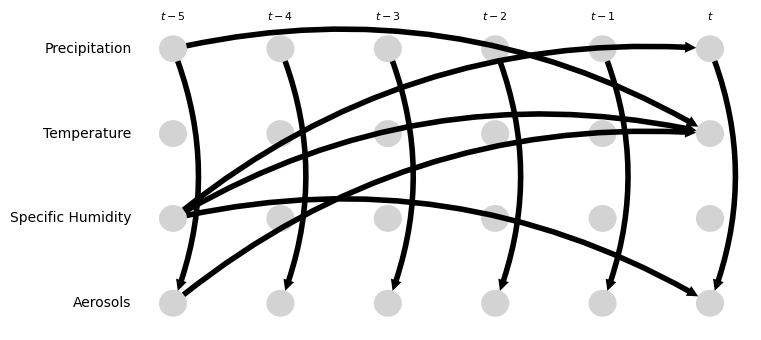

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.12 [-0.15, -0.10]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.08, -0.00]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.42 [-0.55, -0.30]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.90 [0.86, 0.93]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-0.15, -0.02]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.33 [1.20, 1.46]
Negative precipitation values in event 114: 0


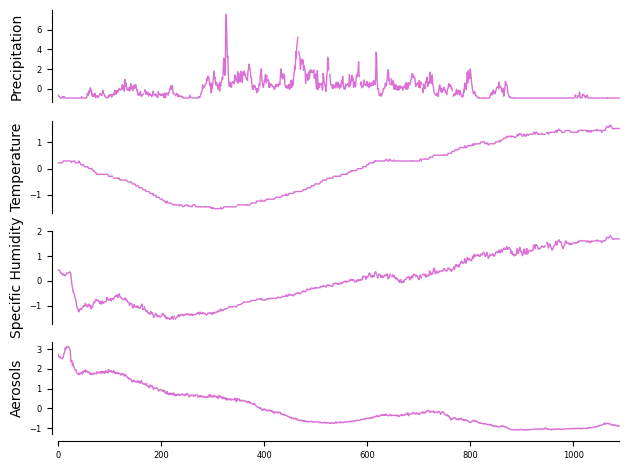

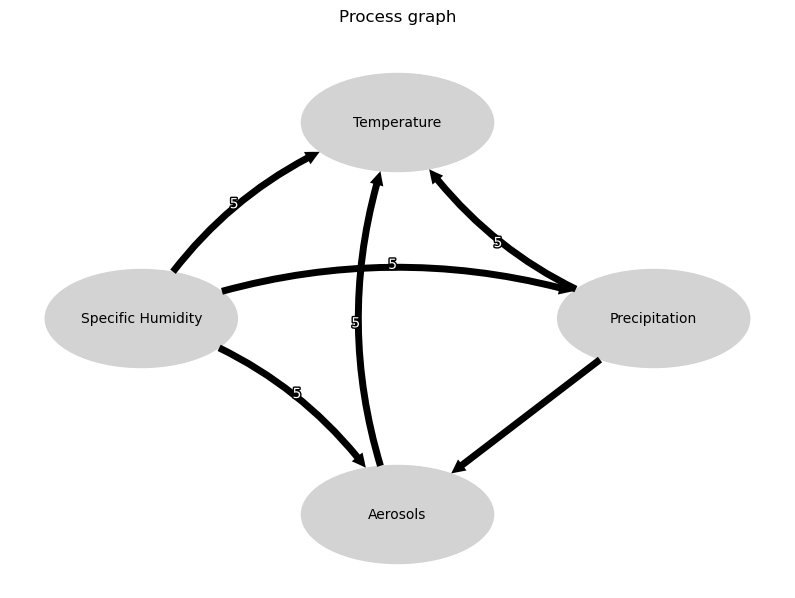

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


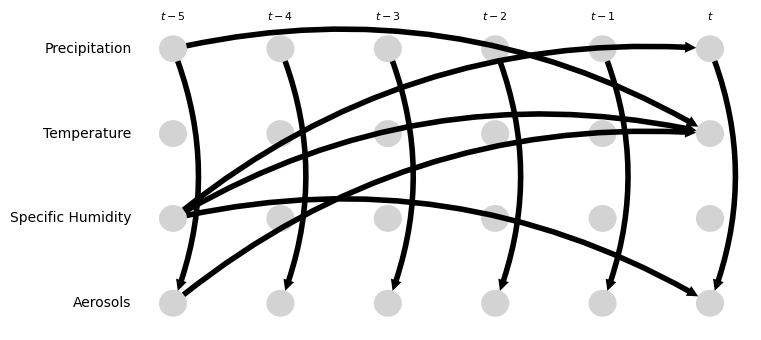

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.34 [-0.39, -0.29]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.08 [-0.10, -0.07]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.07 [1.04, 1.11]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.79 [-0.81, -0.76]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.33 [-0.37, -0.28]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.20 [0.16, 0.25]
Negative precipitation values in event 115: 0


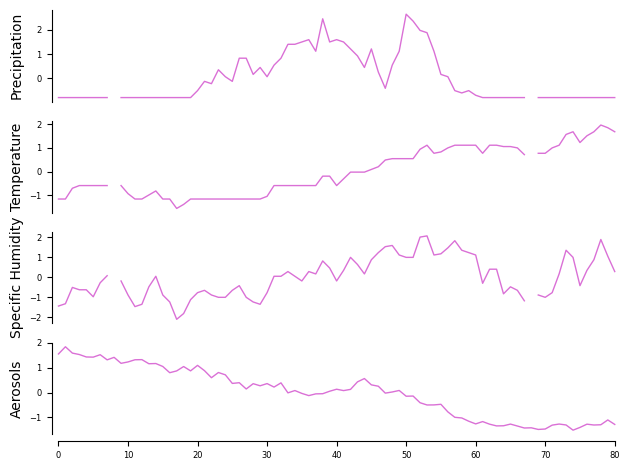

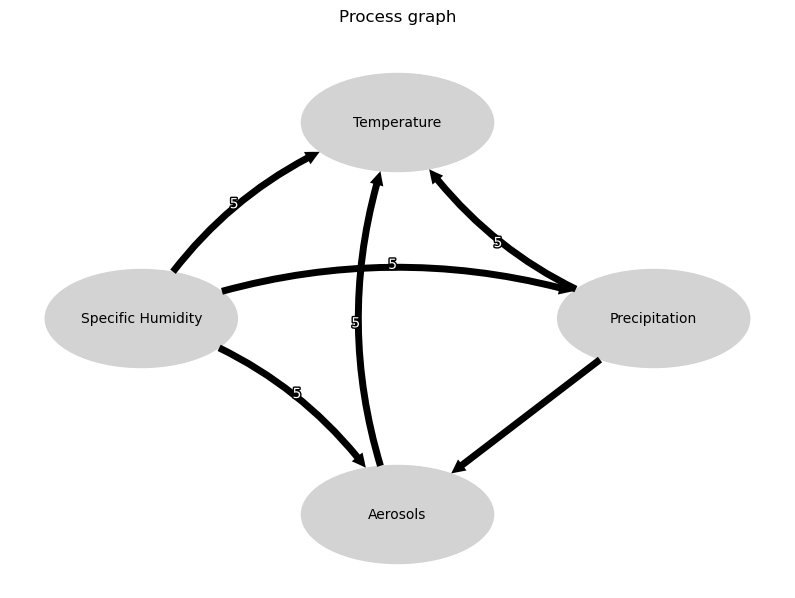

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


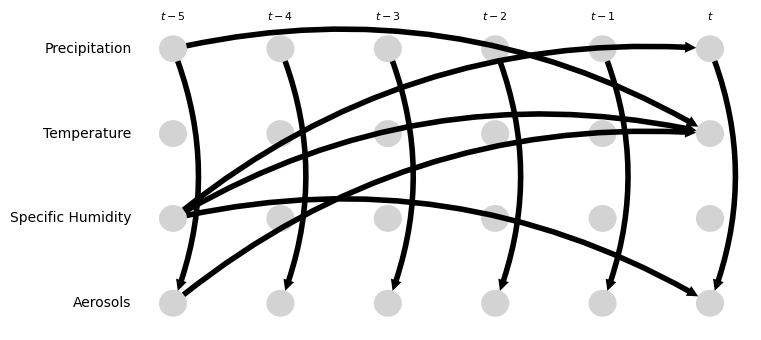

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.18 [0.03, 0.29]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.03 [-0.10, 0.06]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.35 [0.28, 0.46]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.40 [-0.51, -0.29]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [-0.10, 0.27]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.86 [-0.92, -0.75]
Negative precipitation values in event 116: 0


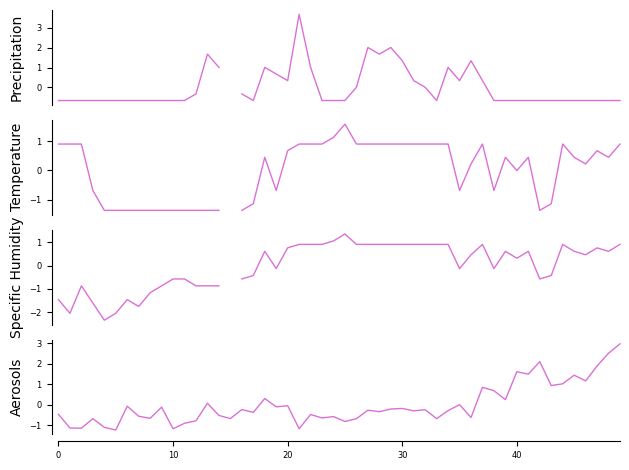

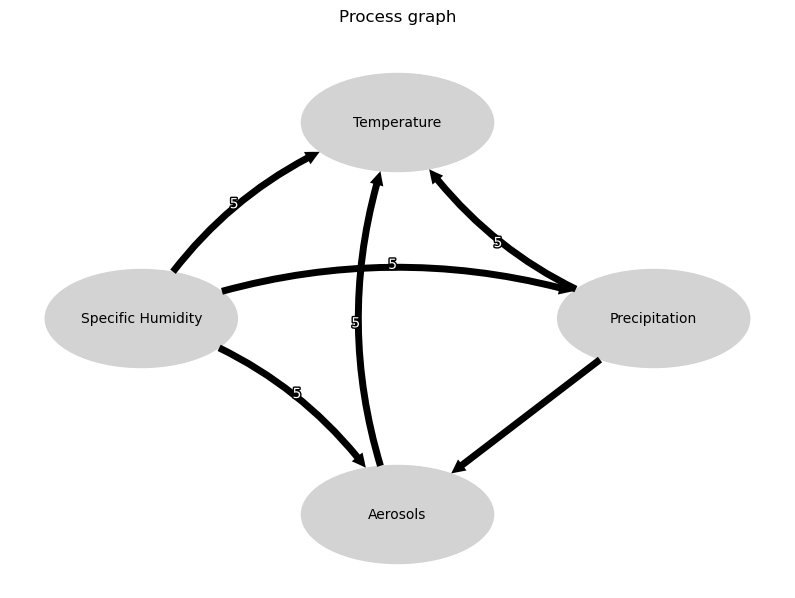

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


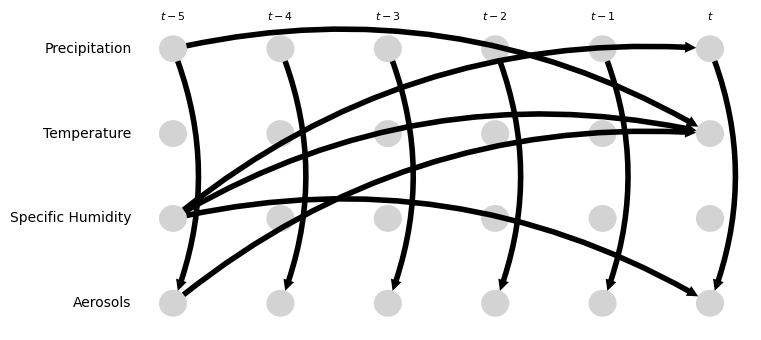

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.37 [-0.53, -0.17]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.15 [-0.05, 0.29]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.58 [0.42, 0.76]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.26 [-0.17, 0.40]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.06 [-0.30, 0.30]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.17 [-0.10, 0.42]
Negative precipitation values in event 117: 0


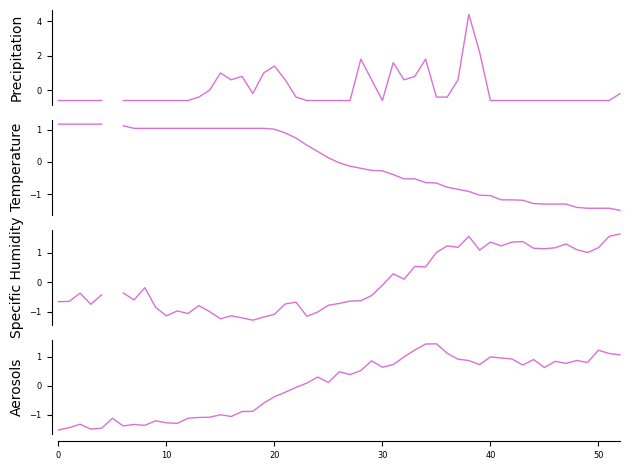

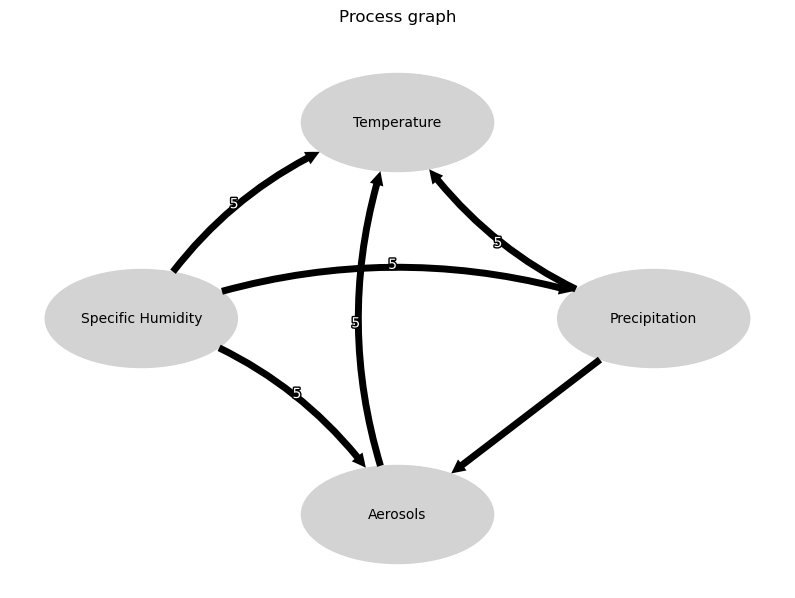

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


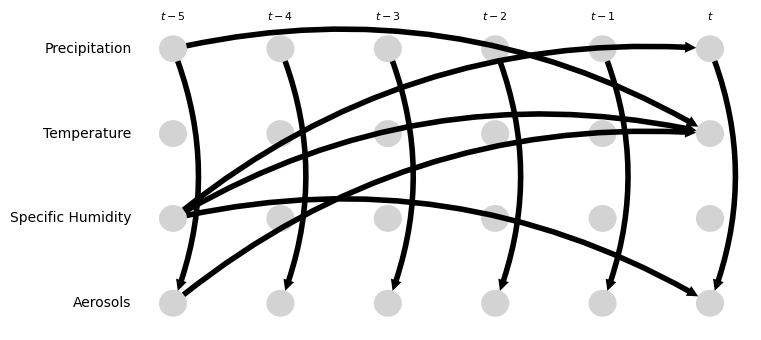

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.22 [0.10, 0.45]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.03, 0.08]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.26 [-0.32, -0.16]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.49 [0.38, 0.63]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.29 [-0.48, -0.13]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.76 [-0.85, -0.67]
Negative precipitation values in event 118: 0


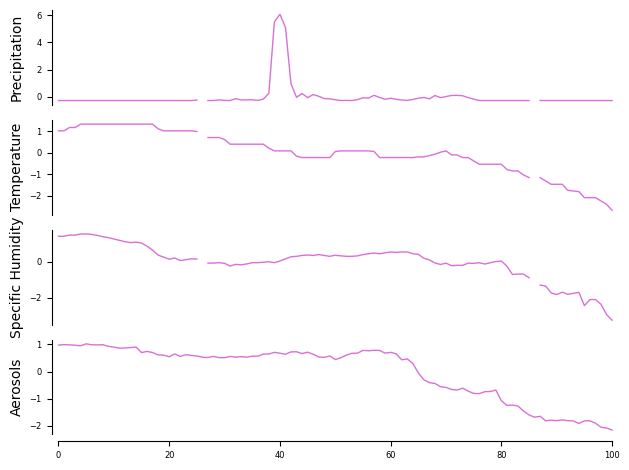

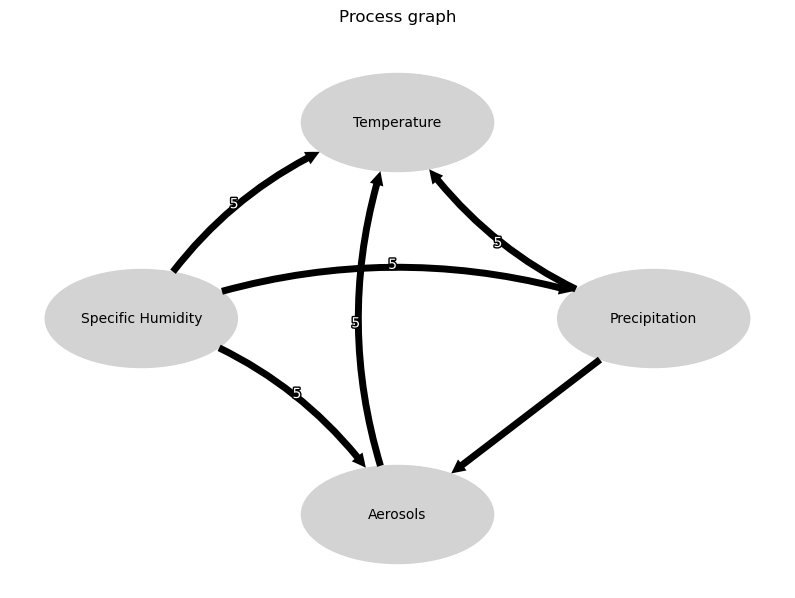

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


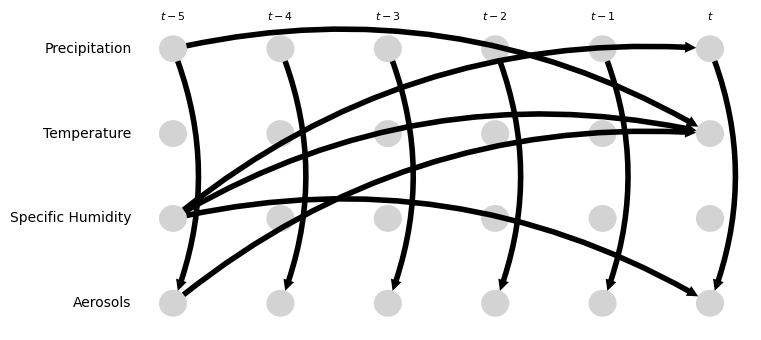

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [0.16, 0.76]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-0.46, -0.07]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.56 [0.39, 0.66]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.96 [0.92, 1.07]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.03 [-0.18, 0.02]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.53 [0.42, 0.67]
Negative precipitation values in event 119: 0


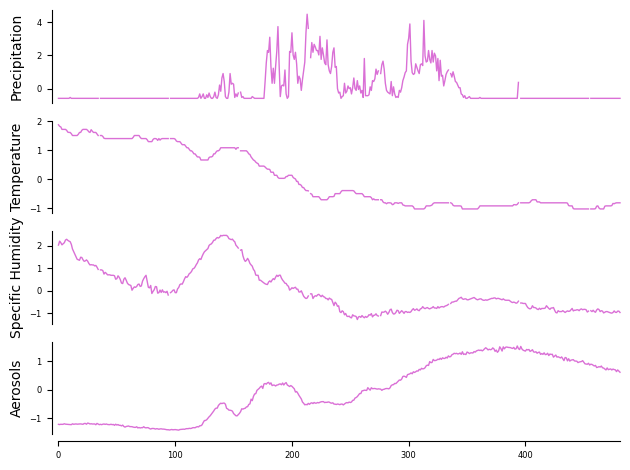

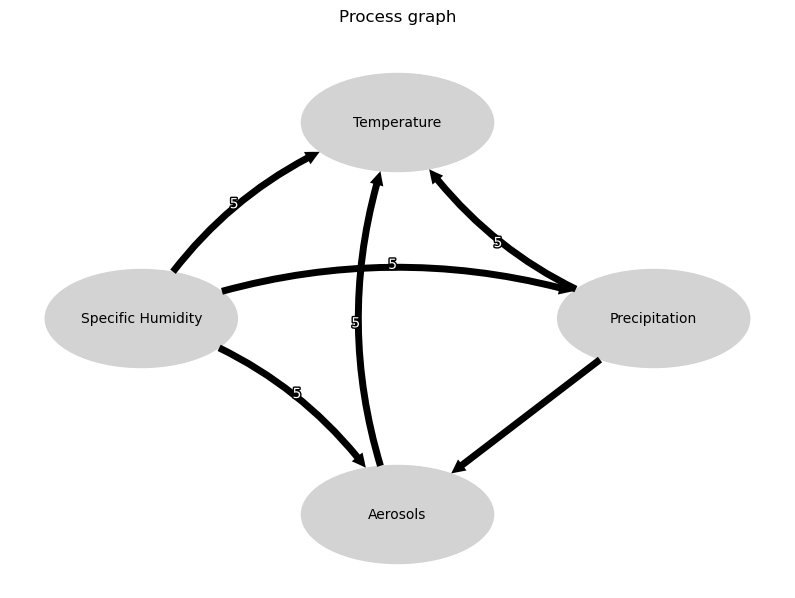

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


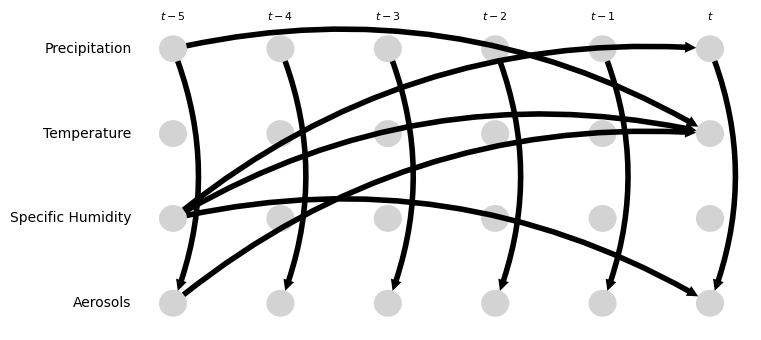

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.08, 0.01]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.17 [-0.19, -0.14]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.37 [0.34, 0.40]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.63 [-0.67, -0.57]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.18 [-0.23, -0.12]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.62 [-0.65, -0.59]
Negative precipitation values in event 120: 0


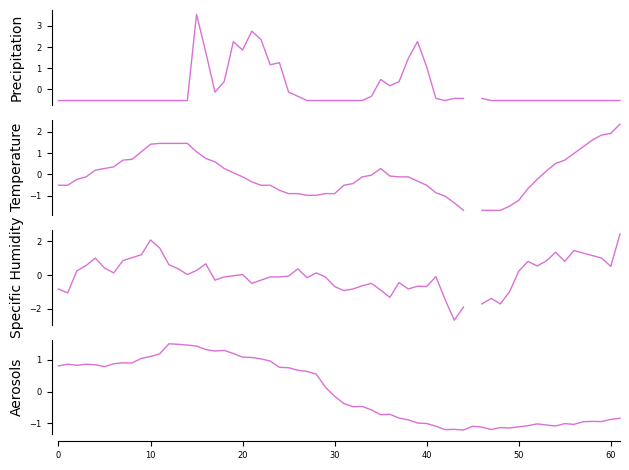

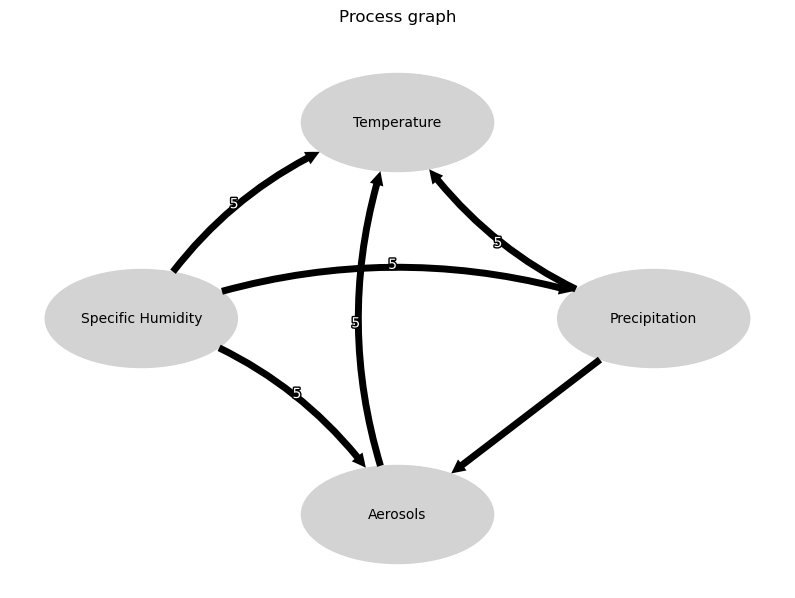

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


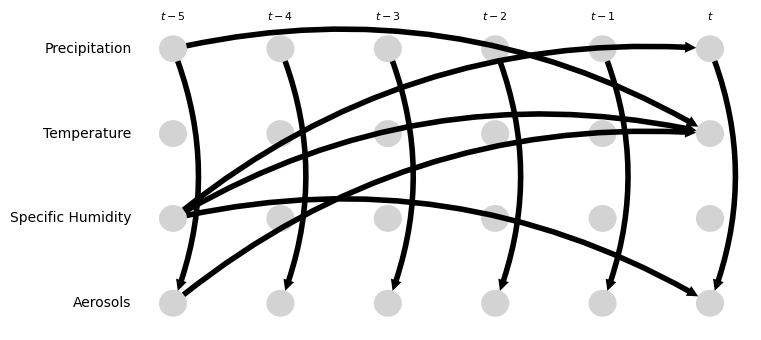

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.23 [0.04, 0.34]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.34 [-0.48, -0.22]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.83 [0.60, 0.96]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.49 [0.38, 0.73]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.25 [0.01, 0.64]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.17 [-0.29, 0.06]
Negative precipitation values in event 121: 0


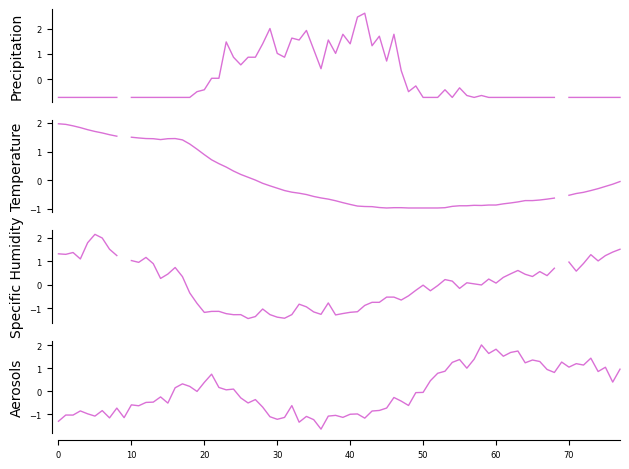

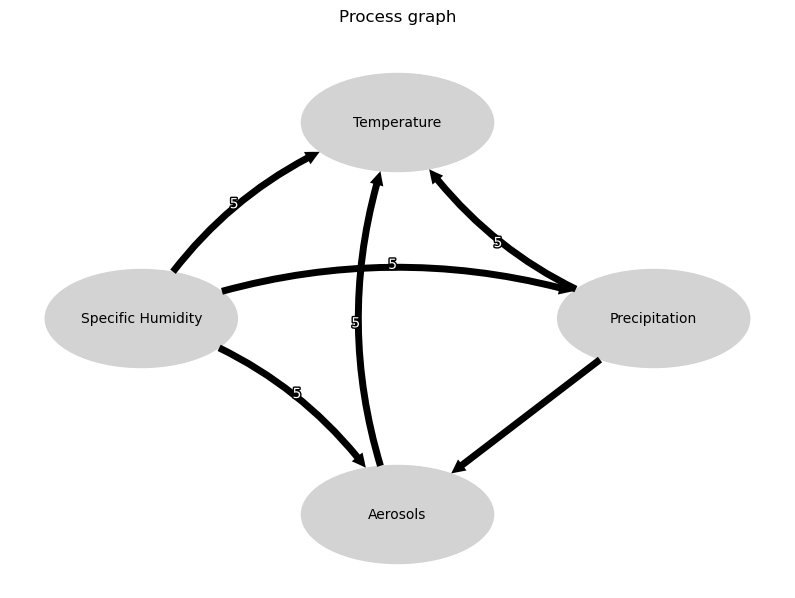

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


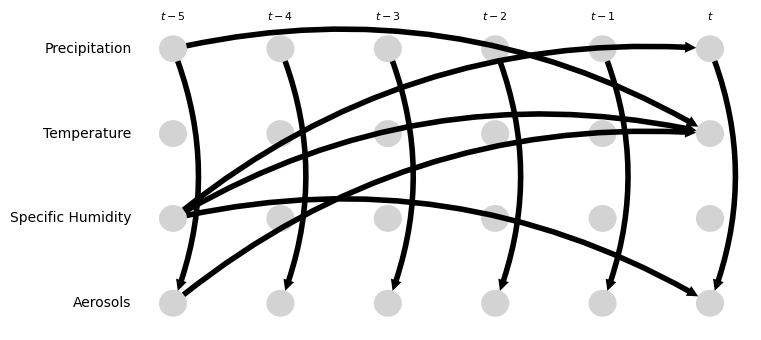

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.88 [-1.12, -0.65]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.40 [-0.64, -0.19]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.39 [0.18, 0.59]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.15 [-0.41, 0.23]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.84 [-1.02, -0.69]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.50 [-0.65, -0.35]
Negative precipitation values in event 122: 0


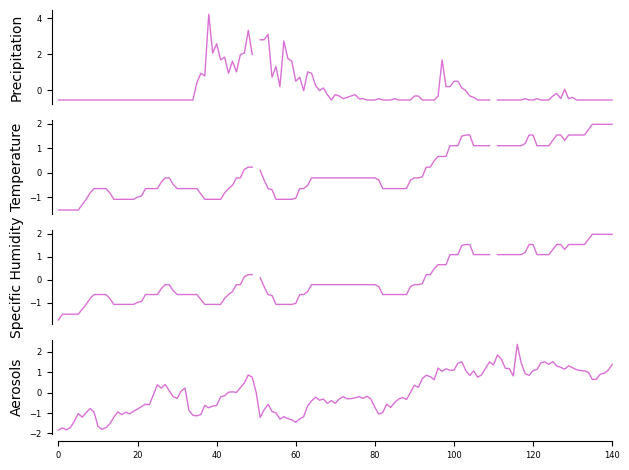

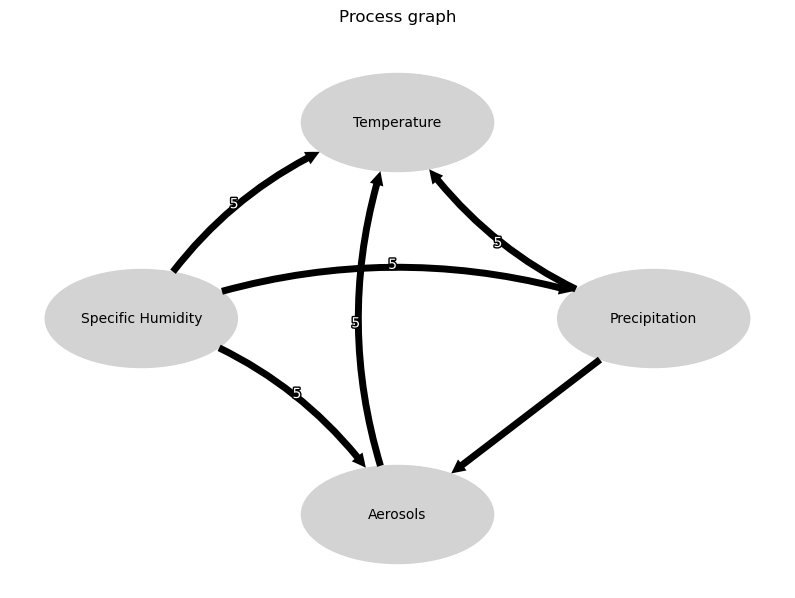

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


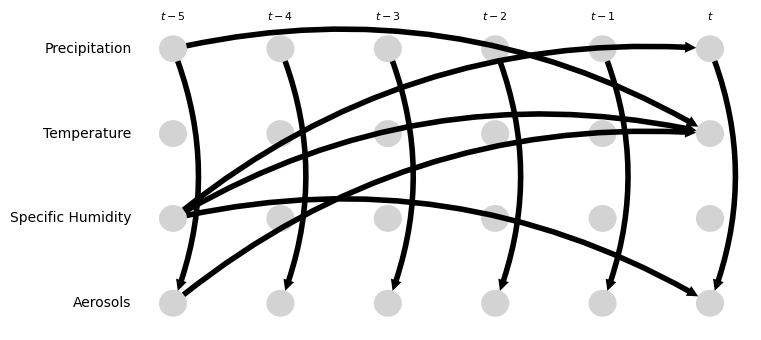

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.12, 0.11]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.03 [-0.12, 0.03]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.62 [0.45, 0.76]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.79 [0.70, 0.89]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.32 [-0.46, -0.23]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.33 [0.20, 0.49]
Negative precipitation values in event 123: 0


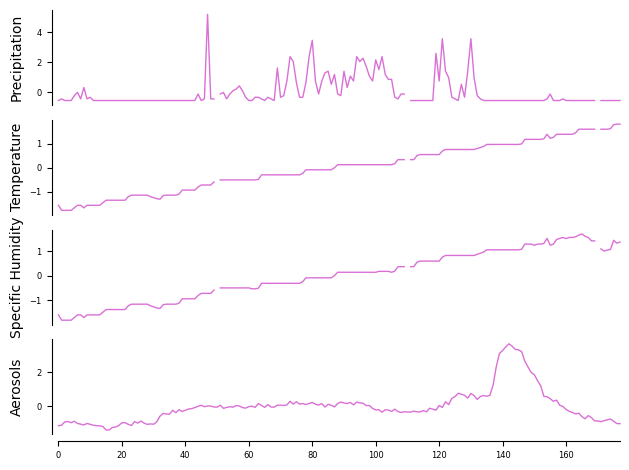

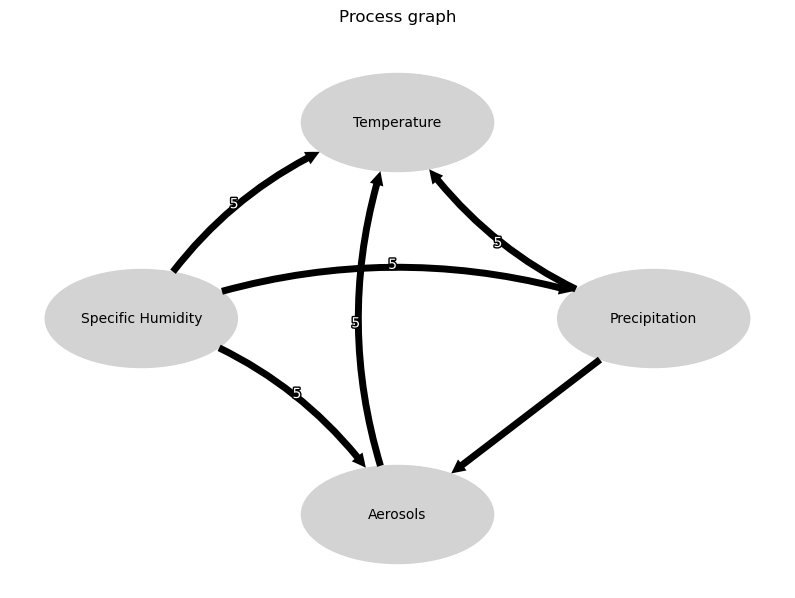

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


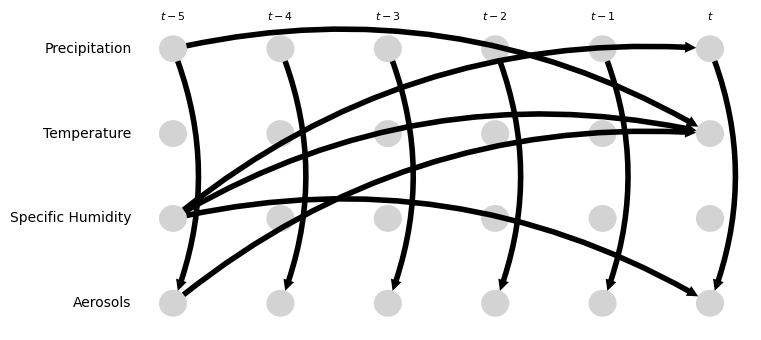

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.00 [-0.09, 0.07]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.00 [-0.02, 0.01]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.98 [0.95, 0.99]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.51 [0.38, 0.66]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.10, 0.11]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.02 [-0.04, 0.01]
Negative precipitation values in event 124: 0


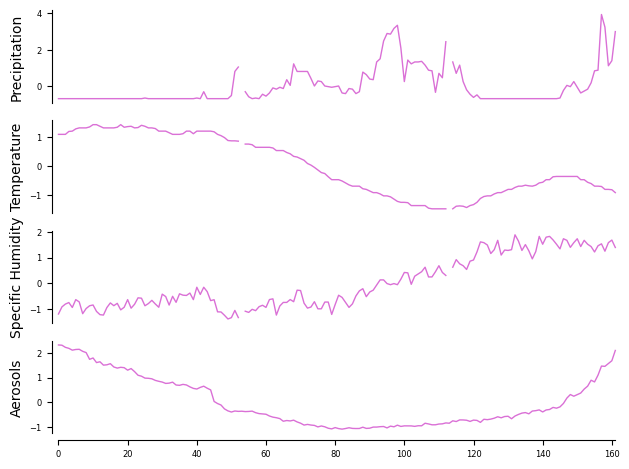

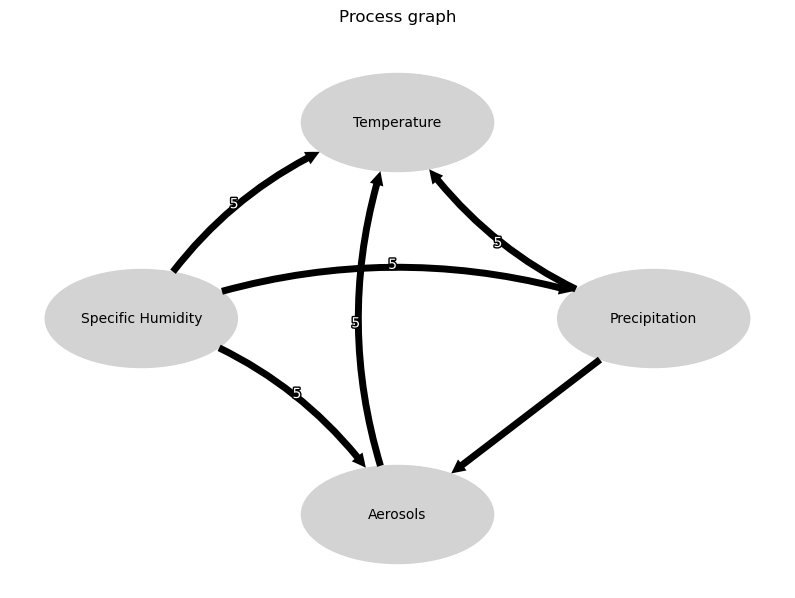

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


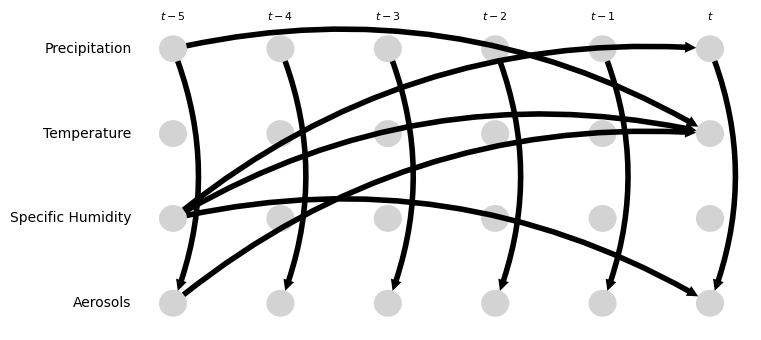

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-0.47, -0.16]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.35 [-0.40, -0.29]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.46 [-0.50, -0.41]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.15, 0.10]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.12 [-0.03, 0.18]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.58 [0.52, 0.68]
Negative precipitation values in event 125: 0


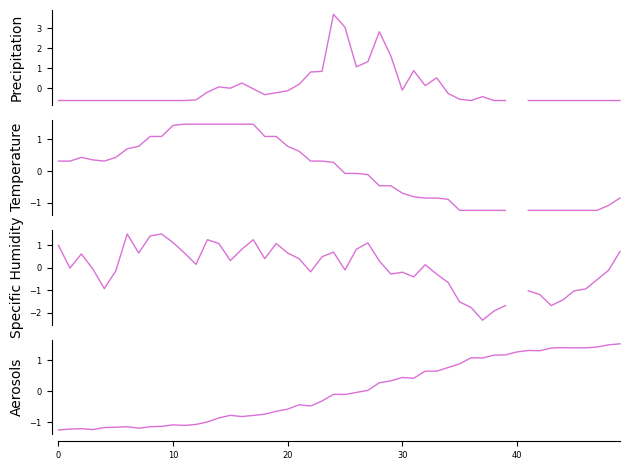

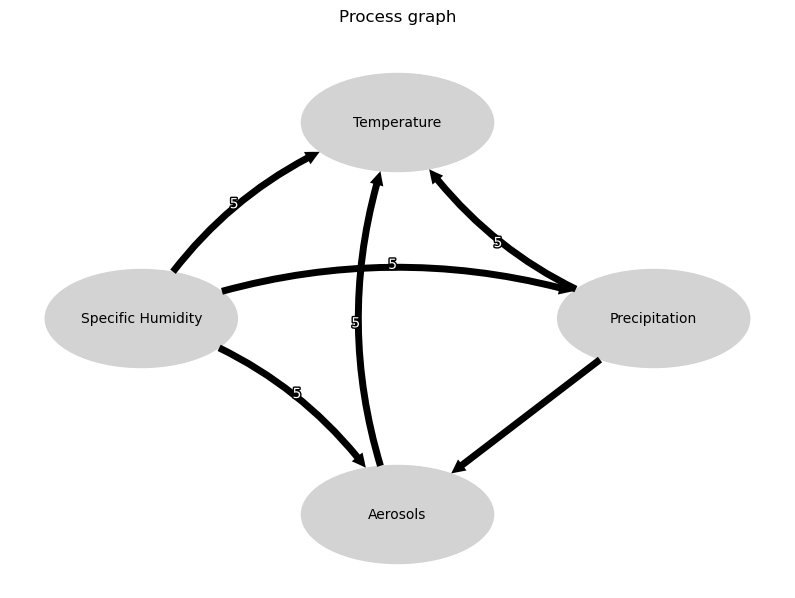

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


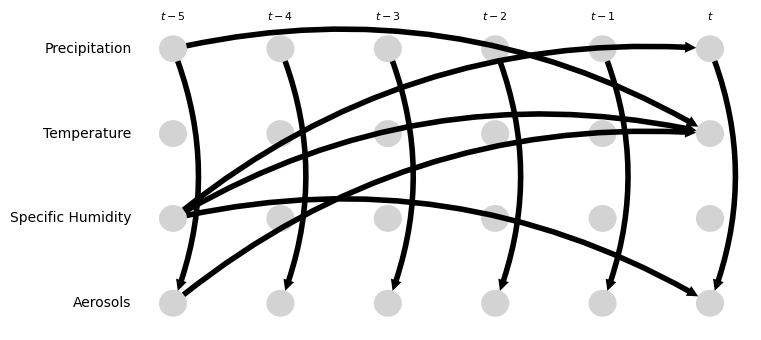

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.20 [0.10, 0.39]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.24 [-0.38, -0.14]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.31, -0.02]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.73 [-0.83, -0.60]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.43 [0.22, 0.67]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.23 [-1.47, -1.14]
Negative precipitation values in event 126: 0


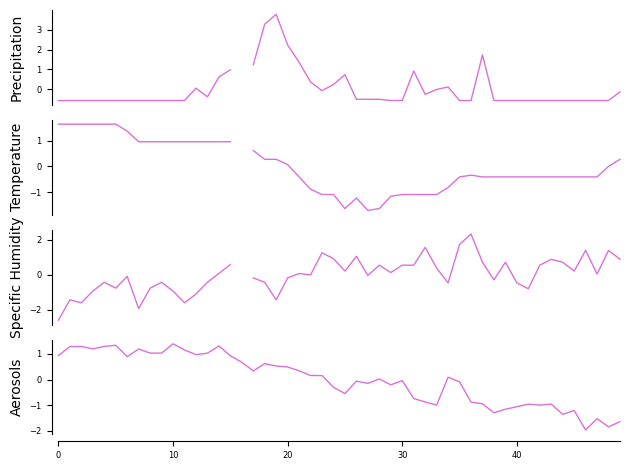

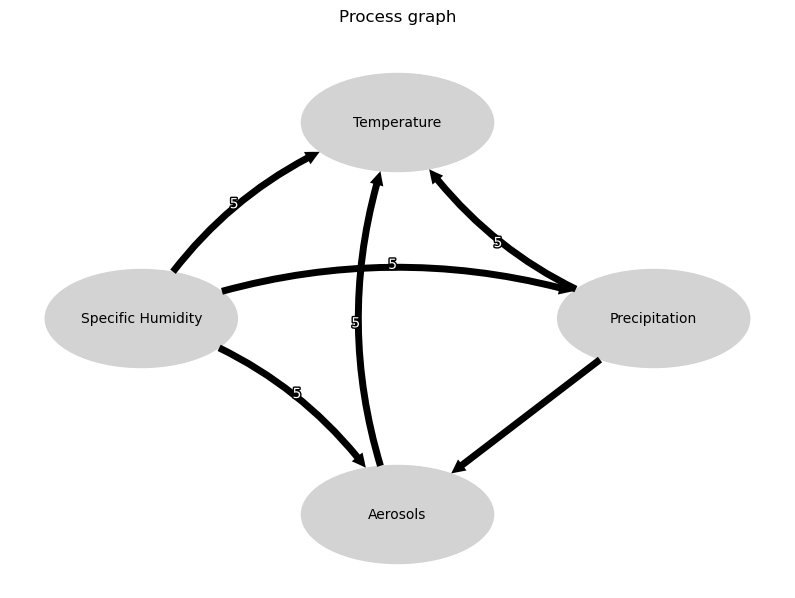

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


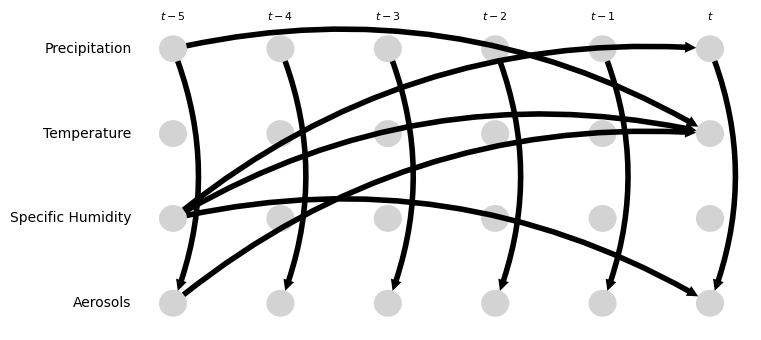

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.21 [0.10, 0.32]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.39 [-0.51, -0.27]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.26 [-0.42, -0.05]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.45 [-0.68, -0.22]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.36, 0.10]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.30 [0.17, 0.55]
Negative precipitation values in event 127: 0


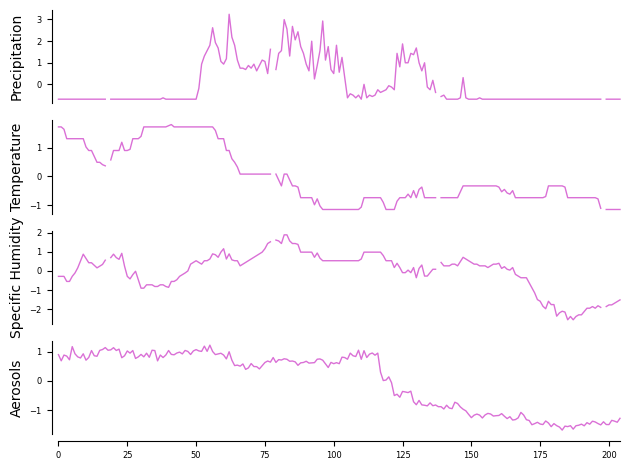

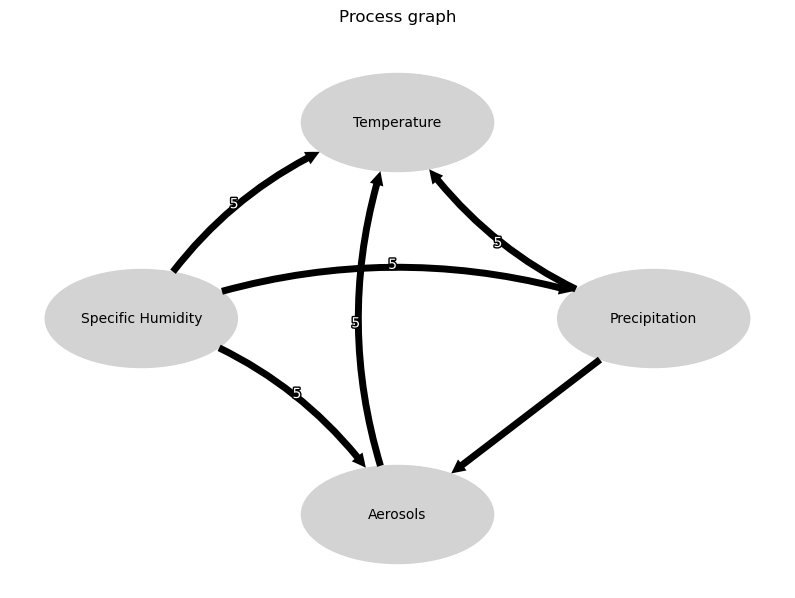

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


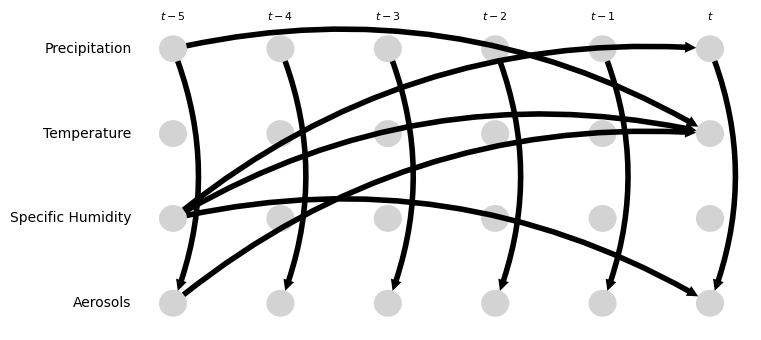

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [-0.03, 0.19]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.28 [-0.35, -0.18]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.36 [-0.48, -0.28]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.50 [0.42, 0.57]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.54 [0.46, 0.63]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.84 [0.74, 0.92]
Negative precipitation values in event 128: 0


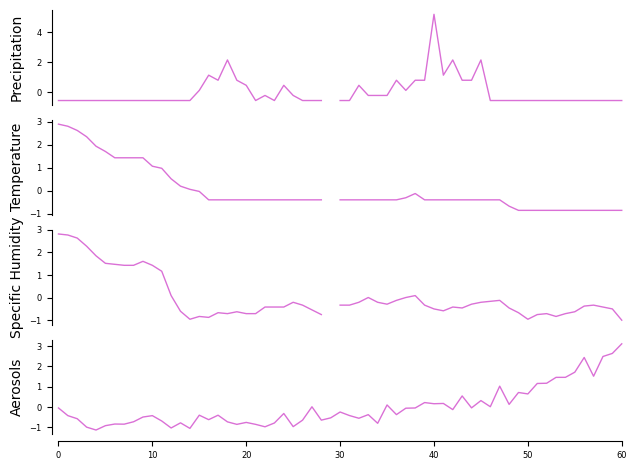

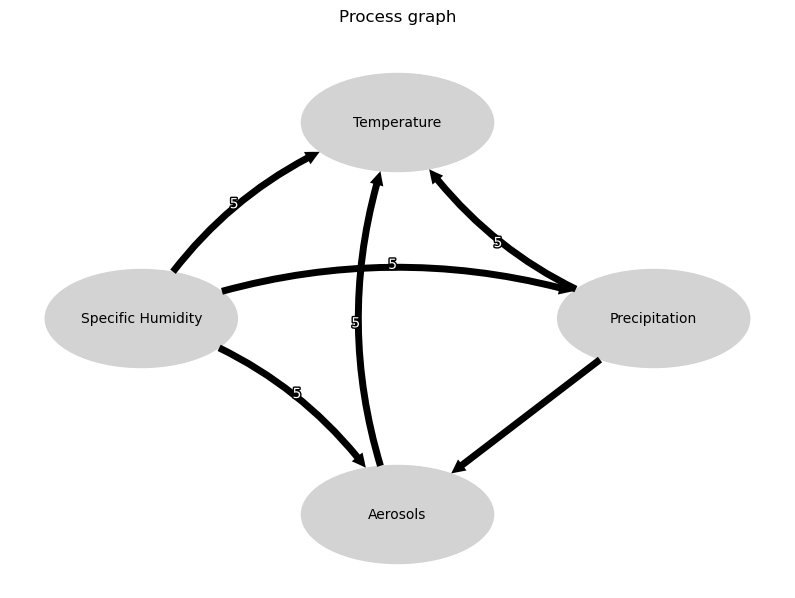

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


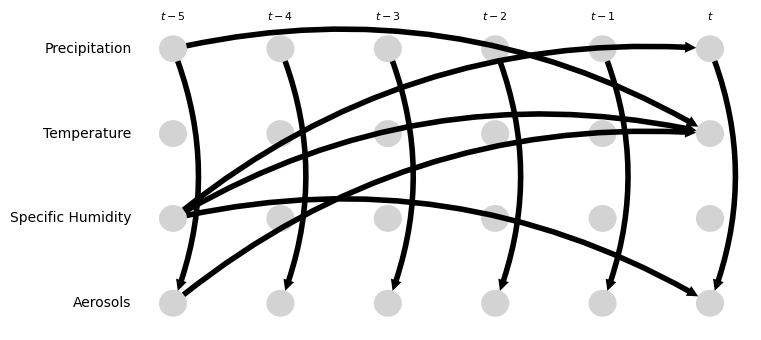

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.20 [-0.41, -0.03]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.03, 0.05]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.35 [0.20, 0.46]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.52 [-0.69, -0.19]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.25, 0.30]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-0.31, -0.19]
Negative precipitation values in event 129: 0


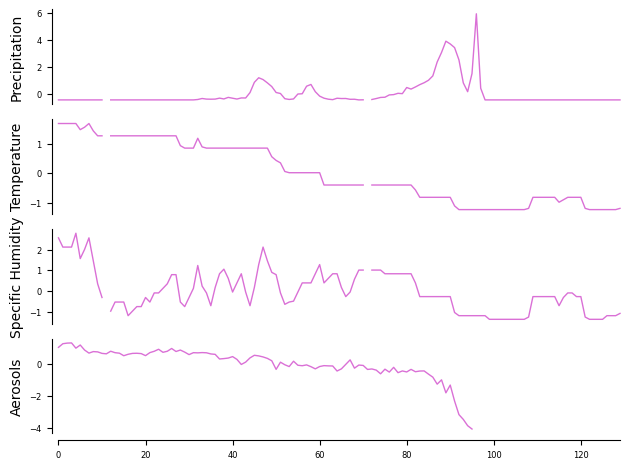

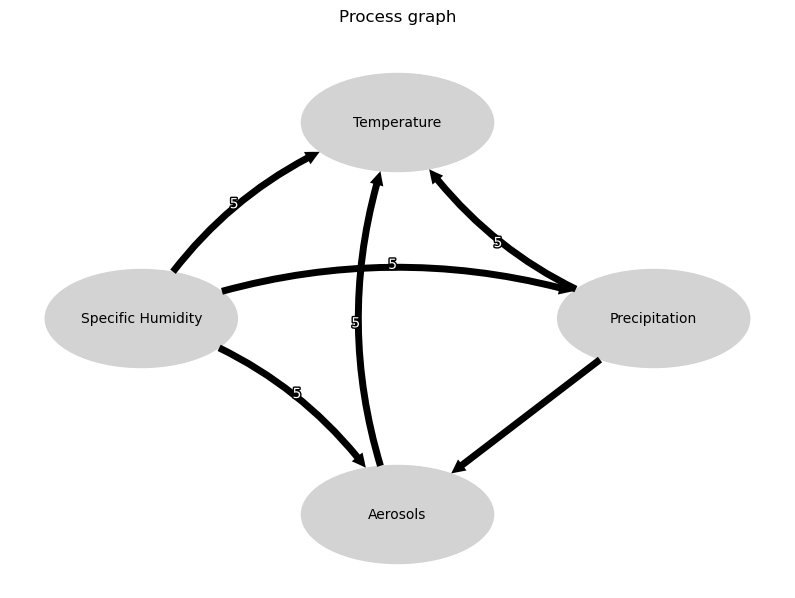

No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, -5)]
Y = [(3, 0)]
S = []
M = []



No causal path from X to Y exists!


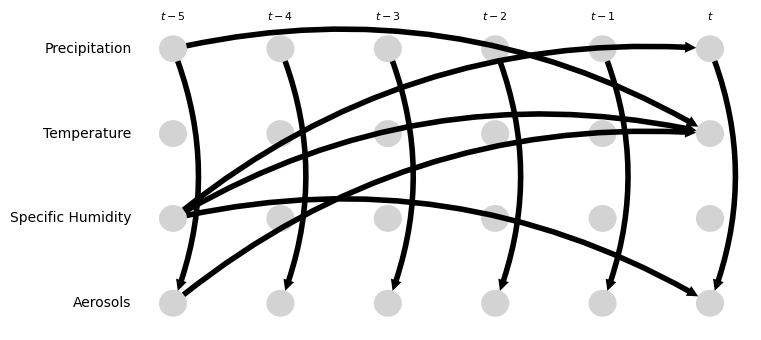

Consider pruning X = {(0, -5)} to X = set() since only these have causal path to Y
Consider pruning Y = {(3, 0)} to Y = set() since only these have causal path from X
[]
[]
Effect of Precipitation on Aerosol Concentrations


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.64 [-0.83, -0.50]
Effect of Precipitation on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.22 [-0.32, -0.10]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.28 [-0.40, -0.16]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-0.24, 0.06]
Effect of Specific Humidity on Precipitation


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.14, 0.14]
Effect of Aerosols on Temperature
Wright's path effect    = 0.62 [0.53, 0.82]


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_8591/3553577403.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


In [33]:
########################### 1 min : Aerosols ##################################

prediction_precip_temp_=[]
prediction_precip_aero_=[]
prediction_sh_temp_=[]
prediction_sh_aero_=[]
prediction_sh_precip_=[]
prediction_aero_temp_=[]

conf_interval_precip_temp_1_ = []
conf_interval_precip_aero_1_ = []
conf_interval_sh_temp_1_ = []
conf_interval_sh_aero_1_ = []
conf_interval_sh_precip_1_ = []
conf_interval_aero_temp_1_ = []

conf_interval_precip_temp_2_ = []
conf_interval_precip_aero_2_ = []
conf_interval_sh_temp_2_ = []
conf_interval_sh_aero_2_ = []
conf_interval_sh_precip_2_ = []
conf_interval_aero_temp_2_ = []

var_names = ['Precipitation','Temperature', "Specific Humidity", "Aerosols"]

a=0
for rain in morning_events:

    data = pd.read_csv(path + f"{site}_minute_meteorological_with_aerosols_data_wxt.csv")
    data['time'] = pd.to_datetime(data['time'])
    data['temperature_f'] = ((data['temperature'] * 9) / 5) + 32

    data.set_index('time', inplace=True)

    # Rango del evento (sin resample)
    start_time, end_time = rain
    data_event = data[start_time:end_time]

    ##############################################################################################

    # Validation
    if data_event.empty:
        print(f"⚠️ Skipping event {a} ({start_time} to {end_time}) → no data in this window.")
        continue

    # Variables of interest
    numeric = data_event[["precipitation", 
                          "temperature", 
                          "specific humidity", 
                          "total_N_conc"]]

    # Maksing
    negative_precip_mask = numeric["precipitation"] < 0
    print(f"Negative precipitation values in event {a}: {negative_precip_mask.sum()}")

    # Numpy Array
    data_array = numeric.to_numpy()
    
    # Scale
    scaler = StandardScaler()
    scaled_array = scaler.fit_transform(data_array)
    
    # Replace values
    scaled_array[negative_precip_mask.to_numpy(), :] = 999999

    scaled_array[np.isnan(scaled_array)] = 999999

#     data_array[negative_precip_mask.to_numpy(), :] = 999999  
#     data_array[np.isnan(data_array)] = 999999

    T, N = data_array.shape  # <-- Asegúrate de hacerlo aquí

    # DataFrame
    dataframe = pp.DataFrame(scaled_array, var_names=var_names, missing_flag=999999)

    ######################################## PLOTTING  #############################################

    fig, axes = tp.plot_timeseries(dataframe=dataframe, color='orchid')

    # Change font size of y-labels
    for ax in axes:
        ax.set_ylabel(ax.get_ylabel(), fontsize=10) 

    # Align y-axis labels
    fig.align_ylabels(axes)
    plt.show()

   
    ##########################################################################################
    
    var_names = ['Precipitation','Temperature', "Specific Humidity", 'Aerosols']
    

    #############################################################################################
    
    # Given Dag made with conclusions from causal discovery process
    hypothesis_graph = np.full((4, 4, 6), '', dtype='<U3')

    
    Precipitation_inst = [(0, 0)]
    Precipitation_5_lag = [(0, -5)]
    
    Temperature_inst  = [(1, 0)]
    Temperature_5_lag = [(1, -5)]
    
    Specific_Humidity_inst = [(2, 0)]
    Specific_Humidity_5_lag = [(2, -5)]
    
    Aerosols_inst = [(3, 0)]
    Aerosols_5_lag = [(3, -5)]

    hypothesis_graph[0, 1, 5] = "-->"  # Precipitation_{t-5} → Temperature_t
    hypothesis_graph[2, 0, 5] = "-->"  # Special_Humidity_{t-5} → Temperature
    hypothesis_graph[2, 1, 5] = "-->"  # Special_Humidity_{t-5} → Temperature
    hypothesis_graph[2, 3, 5] = "-->"  # Special_Humidity_{t-5} → Aerosols
    hypothesis_graph[3, 1, 5] = "-->"  # Aerosols_{t-5} → Temperature
    
    hypothesis_graph[0, 3, 0] = "-->"  # Precipitation_{t-5} → Aerosols
    hypothesis_graph[3, 0, 0] = "<--"     

    ##########################################################################################

    
    fig, ax = plt.subplots(figsize=(10, 7))  # Solo un eje

    tp.plot_graph(
        fig_ax=(fig, ax),
        graph=hypothesis_graph,
        arrow_linewidth=5,
        node_size=0.5,
        node_aspect=1.5,
        var_names=var_names,
        tick_label_size=6,
    )
    ax.set_title('Process graph', pad=20)
    plt.show()

    ###########################################################################################

    causal_effects = CausalEffects(hypothesis_graph, graph_type='stationary_dag', 
                                   X=Precipitation_5_lag, 
                                   Y=Aerosols_inst, 
                                   S=None, 
                                   hidden_variables=None, #[(1, -1)], 
                                   verbosity=1)
    
    tp.plot_time_series_graph(graph = hypothesis_graph,
    var_names=var_names, 
    figsize = (8, 4),
    ); plt.show()
    
    newX, newY = causal_effects.check_XYS_paths()

    print(newX)
    print(newY)
    
    # Optional data transform
    data_transform = None  # sklearn.preprocessing.StandardScaler()

    # Confidence interval range
    conf_lev = 0.9
 
    ################################################################################
  
    #Effect of Precipitation on Aerosol Concentrations
    print('Effect of Precipitation on Aerosol Concentrations')
    prediction_precip_aero, conf_interval_precip_aero_1, conf_interval_precip_aero_2 = get_path_effect(hypothesis_graph, 
                                                                                                                   X=Precipitation_inst, 
                                                                                                                   Y=Aerosols_inst, 
                                                                                                                   mediation="direct", 
                                                                                                                   conf_lev=0.9)
    
    #Effect of Precipitation on Temperature
    print('Effect of Precipitation on Temperature')
    prediction_precip_temp, conf_interval_precip_temp_1, conf_interval_precip_temp_2 = get_path_effect(hypothesis_graph,
                                                                                                       X=Precipitation_5_lag,
                                                                                                       Y=Temperature_inst,
                                                                                                       mediation="direct",
                                                                                                       conf_lev=0.9)
    #Effect of Specific Humidity on Temperature
    print('Effect of Specific Humidity on Temperature')
    prediction_sh_temp,conf_interval_sh_temp_1, conf_interval_sh_temp_2 = get_path_effect(hypothesis_graph, 
                                                                                          X=Specific_Humidity_5_lag, 
                                                                                          Y=Temperature_inst, 
                                                                                          mediation="direct", 
                                                                                          conf_lev=0.9)
    
    #Effect of Specific Humidity on Aerosol Concentrations
    print('Effect of Specific Humidity on Aerosols')
    prediction_sh_aero,conf_interval_sh_aero_1, conf_interval_sh_aero_2 = get_path_effect(hypothesis_graph, 
                                                                                          X=Specific_Humidity_5_lag, 
                                                                                          Y=Aerosols_inst, 
                                                                                          mediation="direct", 
                                                                                          conf_lev=0.9)
    
    #Effect of Specific Humidity on Precipitation
    print('Effect of Specific Humidity on Precipitation')
    prediction_sh_precip,conf_interval_sh_precip_1, conf_interval_sh_precip_2 = get_path_effect(hypothesis_graph, 
                                                                                          X=Specific_Humidity_5_lag, 
                                                                                          Y=Precipitation_inst, 
                                                                                          mediation="direct", 
                                                                                          conf_lev=0.9)
    
    #Effect of Aerosols on Temperature
    print('Effect of Aerosols on Temperature')
    prediction_aero_temp,conf_interval_aero_temp_1, conf_interval_aero_temp_2 = get_path_effect(hypothesis_graph, 
                                                                                          X=Aerosols_5_lag, 
                                                                                          Y=Temperature_inst, 
                                                                                          mediation="direct", 
                                                                                          conf_lev=0.9)
    
    
    #############################################################################################################
    
    prediction_precip_aero_.append(prediction_precip_aero)
    prediction_precip_temp_.append(prediction_precip_temp)
    prediction_sh_temp_.append(prediction_sh_temp)
    prediction_sh_aero_.append(prediction_sh_aero)
    prediction_sh_precip_.append(prediction_sh_precip)
    prediction_aero_temp_.append(prediction_aero_temp)

    conf_interval_precip_aero_1_.append(conf_interval_precip_aero_1)
    conf_interval_precip_temp_1_.append(conf_interval_precip_temp_1)
    conf_interval_sh_temp_1_.append(conf_interval_sh_temp_1)
    conf_interval_sh_aero_1_.append(conf_interval_sh_aero_1)
    conf_interval_sh_precip_1_.append(conf_interval_sh_precip_1)
    conf_interval_aero_temp_1_.append(conf_interval_aero_temp_1)
    
    conf_interval_precip_aero_2_.append(conf_interval_precip_aero_2)
    conf_interval_precip_temp_2_.append(conf_interval_precip_temp_2)
    conf_interval_sh_temp_2_.append(conf_interval_sh_temp_2)
    conf_interval_sh_aero_2_.append(conf_interval_sh_aero_2)
    conf_interval_sh_precip_2_.append(conf_interval_sh_precip_2)
    conf_interval_aero_temp_2_.append(conf_interval_aero_temp_2)

    ##############################################################################################################

    a=a+1

# 30_min_data
# data = {
#     'CO2 on Temperature':prediction_CO2_temp_,
#     'Aerosols on Temperature':prediction_aero_temp_,
#     'Specific Humidity on Temperature':prediction_sh_temp_,
#     'Specific Humidity on Aerosols': prediction_sh_aero_,
#     'CO2 on Temperature interval 1' :conf_interval_CO2_temp_1_,
#     'Aerosols on Temperature interval 1':conf_interval_aero_temp_1_,
#     'Specific Humidity on Temperature interval 1':conf_interval_sh_temp_1_,
#     'Specific Humidity on Aerosols: interval 1':conf_interval_sh_aero_1_,
#     'CO2 on Temperature interval 2' :conf_interval_CO2_temp_2_,
#     'Aerosols on Temperature interval 2':conf_interval_aero_temp_2_,
#     'Specific Humidity on Temperature interval 2': conf_interval_sh_temp_2_,
#     'Specific Humidity on Aerosols: interval 2': conf_interval_sh_aero_2_
# }

data = {
    'Precipitation on Aerosols'         : prediction_precip_aero_,
    'Precipitation on Temperature'      : prediction_precip_temp_,
    'Specific Humidity on Temperature'  : prediction_sh_temp_,
    'Specific Humidity on Aerosols'     : prediction_sh_aero_,
    'Specific Humidity on Precipitation': prediction_sh_precip_,
    'Aerosols on Temperature'           : prediction_aero_temp_,
    
    'Precipitation on Aerosols interval 1'          : conf_interval_precip_aero_1_,
    'Precipitation on Temperature interval 1'       : conf_interval_precip_temp_1_,
    'Specific Humidity on Temperature interval 1'   : conf_interval_sh_temp_1_,
    'Specific Humidity on Aerosols interval 1'      : conf_interval_sh_aero_1_,
    'Specific Humidity on Precipitation interval 1' : conf_interval_sh_precip_1_,
    'Aerosols on Temperature interval 1'            : conf_interval_aero_temp_1_, 
    
    'Precipitation on Aerosols interval 2'          : conf_interval_precip_aero_2_,
    'Precipitation on Temperature interval 2'       : conf_interval_precip_temp_2_,
    'Specific Humidity on Temperature interval 2'   : conf_interval_sh_temp_2_,
    'Specific Humidity on Aerosols interval 2'      : conf_interval_sh_aero_2_,
    'Specific Humidity on Precipitation interval 2' : conf_interval_sh_precip_2_,
    'Aerosols on Temperature interval 2'            : conf_interval_aero_temp_2_, 

    

}

# # Crear DataFrame
# df_effects = pd.DataFrame(data)

# # Mostrar tabla
# print(df_effects)

# #Wright Path Coefficients
# df_effects.to_csv(f'WPC_{site}_rain_event_table.csv', index=False)



In [34]:
data = {
    'Precipitation on Aerosols'         : prediction_precip_aero_,
    'Precipitation on Temperature'      : prediction_precip_temp_,
    'Specific Humidity on Temperature'  : prediction_sh_temp_,
    'Specific Humidity on Aerosols'     : prediction_sh_aero_,
    'Specific Humidity on Precipitation': prediction_sh_precip_,
    'Aerosols on Temperature'           : prediction_aero_temp_,
    
    'Precipitation on Aerosols interval 1'          : conf_interval_precip_aero_1_,
    'Precipitation on Temperature interval 1'       : conf_interval_precip_temp_1_,
    'Specific Humidity on Temperature interval 1'   : conf_interval_sh_temp_1_,
    'Specific Humidity on Aerosols interval 1'      : conf_interval_sh_aero_1_,
    'Specific Humidity on Precipitation interval 1' : conf_interval_sh_precip_1_,
    'Aerosols on Temperature interval 1'            : conf_interval_aero_temp_1_, 
    
    'Precipitation on Aerosols interval 2'          : conf_interval_precip_aero_2_,
    'Precipitation on Temperature interval 2'       : conf_interval_precip_temp_2_,
    'Specific Humidity on Temperature interval 2'   : conf_interval_sh_temp_2_,
    'Specific Humidity on Aerosols interval 2'      : conf_interval_sh_aero_2_,
    'Specific Humidity on Precipitation interval 2' : conf_interval_sh_precip_2_,
    'Aerosols on Temperature interval 2'            : conf_interval_aero_temp_2_, 

    

}

# Crear DataFrame
df_effects = pd.DataFrame(data)

# Mostrar tabla
print(df_effects)

#Wright Path Coefficients
df_effects.to_csv(f'WPC_{site}_rain_event_table_new.csv', index=False)



    Precipitation on Aerosols Precipitation on Temperature  \
0        [-0.566543924052804]        [0.19613340379711117]   
1      [-0.29466479106253507]         [0.9498343012211757]   
2      [-0.45371139670814226]          [0.737686899649601]   
3      [-0.16172268097811957]       [-0.04086328782813925]   
4        [-1.739704833459008]         [0.6220750920846438]   
..                        ...                          ...   
125     [0.19793397447928746]       [-0.23524081516780407]   
126      [0.2094123951718507]        [-0.3924948304507747]   
127     [0.08084256790605854]        [-0.2778090284214826]   
128    [-0.20275346182930665]       [0.017338713756779894]   
129     [-0.6376528381016529]       [-0.21647700872698394]   

    Specific Humidity on Temperature Specific Humidity on Aerosols  \
0               [0.6210337786842288]          [0.6452797714089272]   
1              [0.17459028842996394]         [0.14433625168514608]   
2              [0.23759507141972813]         

In [22]:

# Crear un diccionario con los datos
data = {
    'CO2 on Temperature':prediction_CO2_temp_,
    'Aerosols on Temperature':prediction_aero_temp_,
    'Specific Humidity on Temperature':prediction_sh_temp_,
    'Specific Humidity on Aerosols': prediction_sh_aero_,
    'CO2 on Temperature interval 1' :conf_interval_CO2_temp_1_,
    'Aerosols on Temperature interval 1':conf_interval_aero_temp_1_,
    'Specific Humidity on Temperature interval 1':conf_interval_sh_temp_1_,
    'Specific Humidity on Aerosols: interval 1':conf_interval_sh_aero_1_,
    'CO2 on Temperature interval 2' :conf_interval_CO2_temp_2_,
    'Aerosols on Temperature interval 2':conf_interval_aero_temp_2_,
    'Specific Humidity on Temperature interval 2': conf_interval_sh_temp_2_,
    'Specific Humidity on Aerosols: interval 2': conf_interval_sh_aero_2_
}

# Crear DataFrame
df_effects = pd.DataFrame(data)

# Mostrar tabla
print(df_effects)

#Wright Path Coefficients
df_effects.to_csv(f'WPC_{site}_morning_table.csv', index=False)


        CO2 on Temperature   Aerosols on Temperature  \
0      [7.163029207109503]    [0.013835160200316495]   
1      [3.269096707459539]     [0.01004230389930249]   
2     [0.7244426919050966]   [0.0005263388695337562]   
3      [5.329482495921411]    [0.003703633130022595]   
4    [-1.1197905480585177]   [-0.001054395750753324]   
..                     ...                       ...   
171  [-0.7955903781227107]   [-0.006121564996379483]   
172   [0.4218146329348542]   [-0.025646296534897823]   
173  [-0.2603549822911191]   [-0.019385831146849424]   
174  [-0.5425979135594616]   [0.0016958916010478338]   
175  [-0.9233641166147564]  [-0.0016242946920123963]   

    Specific Humidity on Temperature Specific Humidity on Aerosols  \
0              [-14981.304843115968]          [159986.75319433783]   
1               [-52497.84607774581]          [2014741.7073926763]   
2               [-1449.106417398967]          [-250340.3199467877]   
3               [-2022.624858579965]          [